In [1]:
import os
import numpy as np
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import seaborn as sns

from tqdm import tqdm
from conf_ensemble import ConfEnsemble, ConfEnsembleLibrary
from rdkit.Chem.rdMolDescriptors import CalcNumRotatableBonds
from collections import defaultdict

In [2]:
root = '../hdd/conf_ranking/data/'
cel_df_path = os.path.join(root, 'pdb_conf_ensembles/ensemble_names.csv')
cel_df = pd.read_csv(cel_df_path)

In [3]:
figure_dir = '/home/bb596/hdd/conf_ranking/figures/'
sns.set_theme(style="whitegrid")
sns.set_context('talk', font_scale=1)

In [4]:
palette = sns.color_palette("colorblind")

In [5]:
palette

[(0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844),
 (0.792156862745098, 0.5686274509803921, 0.3803921568627451),
 (0.984313725490196, 0.6862745098039216, 0.8941176470588236),
 (0.5803921568627451, 0.5803921568627451, 0.5803921568627451),
 (0.9254901960784314, 0.8823529411764706, 0.2),
 (0.33725490196078434, 0.7058823529411765, 0.9137254901960784)]

In [6]:
clean_ranker_names = {'SchNetModel': 'SchNet',
                      'SchNetModel_lr1e3': 'SchNet_1e3',
                      'ComENetModel': 'ComENet',
                      'DimeNetModel': 'DimeNet++',
                     'shuffle': 'Random order',
                     'CCDC_generation_order': 'CSD Probability',
                     'MMFF94s_energy': 'MMFF94s energy',
                     'Shuffle': 'Random order',
                     'NoRanking': 'Generation order'}

clean_test_set_names = {'random': 'Random',
                        'scaffold': 'Scaffold'}

clean_label_names = {'bioactive_like': 'Bioactive-like',
                    'non_bioactive': 'Non-bioactive'}

In [7]:
rankers = ['Shuffle', 
           'CCDC_generation_order', 
           'MMFF94s_energy', 
           'SASA',
           'RGyr',
           'SchNetModel',
           'DimeNetModel',
           'ComENetModel',
          'TFD2RefMCS']

for ranker in rankers:
    if not ranker in clean_ranker_names:
        clean_ranker_names[ranker] = ranker

In [8]:
hue_order = ['Random order',
            'Generation order',
            'MMFF94s energy',
            'SASA',
            'RGyr',
            'SchNet',
            'DimeNet++',
            'ComENet',
            'TFD2RefMCS']

hue2palette = {hue: color for hue, color in zip(hue_order, palette)}

In [9]:
split_types = ['random', 'scaffold']
split_is = range(5)

In [10]:
results_dir = '../hdd/conf_ranking/results/'
fractions = np.around(np.arange(0.01, 1, 0.01), 2)

In [11]:
def get_evaluation_name(split_type, split_i):
    return f'{split_type}_split_{split_i}'

In [12]:
def get_mol_results(ranker_dir):
    mol_results_path = os.path.join(ranker_dir, 'ranker_mol_results.p')
    with open(mol_results_path, 'rb') as f:
        all_mol_results = pickle.load(f)
    return all_mol_results

def get_conf_results(ranker_dir):
    conf_results_path = os.path.join(ranker_dir, 'ranker_conf_results.p')
    with open(conf_results_path, 'rb') as f:
        all_conf_results = pickle.load(f)
    return all_conf_results

In [13]:
regression_rows = []
for split_type in split_types:
    for split_i in range(5):
        evaluation_name = get_evaluation_name(split_type, split_i)
        evaluation_dir = os.path.join(results_dir, evaluation_name)
        
        for ranker_name in rankers :
            ranker_dir = os.path.join(evaluation_dir, ranker_name)
            
            all_mol_results = get_mol_results(ranker_dir)
            all_conf_results = get_conf_results(ranker_dir)
                
            for name, results in tqdm(all_mol_results.items()):
                conf_results = all_conf_results[name]
                if 'regression' in results:
                    regression_results = conf_results['regression']
                    if len(regression_results['targets']) > 1:
                        for target, pred in zip(regression_results['targets'], regression_results['preds']):
                            regression_row = {}
                            regression_row['Test set'] = clean_test_set_names[split_type]
                            regression_row['Iteration'] = split_i
                            regression_row['Model'] = clean_ranker_names[ranker_name]
                            regression_row['PDB ID'] = name
                            regression_row['ARMSD'] = target
                            regression_row['Prediction'] = pred
                            regression_rows.append(regression_row)
                            
regression_df = pd.DataFrame(regression_rows)
del(regression_rows)

100%|██████████████████████████████████| 1322/1322 [00:00<00:00, 1927309.66it/s]


In [15]:
rows = []
for split_type in split_types:
    
    for split_i in range(5):
        
        evaluation_name = get_evaluation_name(split_type, split_i)
        evaluation_dir = os.path.join(results_dir, evaluation_name)
        
        for ranker_name in rankers :
        
            ranker_dir = os.path.join(evaluation_dir, ranker_name)
            
            all_mol_results = get_mol_results(ranker_dir)
            all_conf_results = get_conf_results(ranker_dir)
                
            for name, results in tqdm(all_mol_results.items()):
                conf_results = all_conf_results[name]
                row = {}
                row['Test set'] = clean_test_set_names[split_type]
                row['Iteration'] = split_i
                row['Ranker'] = clean_ranker_names[ranker_name]
                row['PDB ID'] = name

                if 'regression' in results:
                    regression_results = conf_results['regression']
                    row['MAE'] = results['regression']['mae']
                    row['RMSE'] = results['regression']['rmse']
                    if len(regression_results['targets']) > 1:
                        row['R\u00b2'] = results['regression']['r2']
                
                if 'bioactive' in results:
                    row['Normalized first bioactive rank'] = results['bioactive']['normalized_first_rank']
                    row['Number of bioactive conformations'] = results['bioactive']['n_masked']

                if 'bioactive_like' in results:
                    row['Number of generated conformations'] = results['bioactive_like']['n_confs']
                    row['Number of bioactive-like conformations'] = results['bioactive_like']['n_masked']
                    row['Normalized rank of first bioactive-like conformation'] = results['bioactive_like']['normalized_first_rank']
                    if 'bedroc' in results['bioactive_like']:
                        row['BEDROC of bioactive-like conformations'] = results['bioactive_like']['bedroc']

                if 'non_bioactive' in results:
                    row['Number of non-bioactive conformations'] = results['non_bioactive']['n_masked']
                    row['Normalized rank of first non-bioactive conformation'] = results['non_bioactive']['normalized_first_rank']
                    if 'bedroc' in results['non_bioactive']:
                        row['BEDROC of non-bioactive conformations'] = results['non_bioactive']['bedroc']
                    
                if 'MCS_smarts' in results:
                    row['MCS to training smarts'] = results['MCS_smarts']
                    row['MCS to training size'] = results['MCS_size']
                    
                rows.append(row)
            
results_df = pd.DataFrame(rows)

100%|███████████████████████████████████| 1322/1322 [00:00<00:00, 555375.59it/s]


In [16]:
results_df['Test set'].value_counts()

Random      61555
Scaffold    60012
Name: Test set, dtype: int64

In [17]:
regression_df['ARMSD'] = regression_df['ARMSD'].apply(lambda t: t.item())
regression_df['SE'] = np.square(regression_df['ARMSD'] - regression_df['Prediction'])
regression_df['AE'] = np.abs(regression_df['ARMSD'] - regression_df['Prediction'])

In [19]:
pdbbind_df = pd.read_csv('../hdd/conf_ranking/data/pdb_conf_ensembles/pdb_df.csv')
pdbbind_df = pdbbind_df.rename({'ligand_name': 'Ligand name',
                               'pdb_id': 'PDB ID'}, axis=1)
regression_df = regression_df.merge(pdbbind_df, on='PDB ID')
results_df = results_df.merge(pdbbind_df, on='PDB ID')

In [20]:
results_df['Ratio of bioactive-like conformations'] = results_df['Number of bioactive-like conformations'] / results_df['Number of generated conformations']
results_df['Ratio of non-bioactive conformations'] = results_df['Number of non-bioactive conformations'] / results_df['Number of generated conformations']
results_df['Bioactive-like conformation is first'] = results_df['Normalized rank of first bioactive-like conformation'] == 0

In [21]:
def rename_axe_labels(axe,
                     axis=1,
                           n_bins=10) :
    try:
        delta = 1 / n_bins
        if axis == 1:
            ticks_labels = axe.get_yticklabels()
            ticks_map = {label : f"""[{np.around(float(label.get_text().replace('−', '-')) - delta, 1)}, {np.around(float(label.get_text().replace('−', '-')), 1)}]""" 
                        for label in ticks_labels}
            new_ticks_labels = [ticks_map[label] 
                                    for label in ticks_labels]
            axe.set_yticklabels(new_ticks_labels)
        else:
            ticks_labels = axe.get_xticklabels()
            ticks_map = {label : f"""[{np.around(float(label.get_text().replace('−', '-')) - delta, 1)},\n {np.around(float(label.get_text().replace('−', '-')), 1)}]""" 
                        for label in ticks_labels}
            new_ticks_labels = [ticks_map[label] 
                                    for label in ticks_labels]
            axe.set_xticklabels(new_ticks_labels)
    except Exception as e:
        print(e)
        import pdb;pdb.set_trace()

def rename_similarity_label(plot,
                            axis=1,
                           n_bins=10) :
    for axes in plot.axes :
        for axe in axes:
            rename_axe_labels(axe, axis=axis, n_bins=n_bins)

In [22]:
def custom_agg(series) :
    result = ''
    
    mean = series.mean()
    if not np.isnan(mean) :
        result = result + str(mean.round(2))
        
    std = series.std().round(2)
    if not np.isnan(std) :
        result = result + ' ± ' + str(std.round(2))
    
    if result == '' :
        result = 'NA'
    return result

In [23]:
results_df_bio_250 = results_df[(results_df['Ratio of bioactive-like conformations'] < 0.05)
                           & (results_df['Number of generated conformations'] == 250)]

In [24]:
results_df_bio_250['Ligand name'].value_counts()

ADP    1350
SAM     342
ATP     324
SAH     243
BB2      90
       ... 
SM2       8
BX6       8
TPX       6
PZ2       6
5KH       6
Name: Ligand name, Length: 1475, dtype: int64

In [ ]:
r1 = results_df.pivot_table(index=['Test set', 'Iteration', 'PDB ID'], 
                            columns='Ranker', 
                            values='BEDROC of bioactive-like conformations')
r1 = r1.reset_index().dropna()

In [ ]:
r1

In [ ]:
results_df = results_df.merge(r1[['Test set', 'Iteration', 'PDB ID']])

In [ ]:
results_df

# Regression

In [46]:
regression_gen_df = regression_df[(regression_df['ARMSD'] != 0)]

(0.0, 12.0)

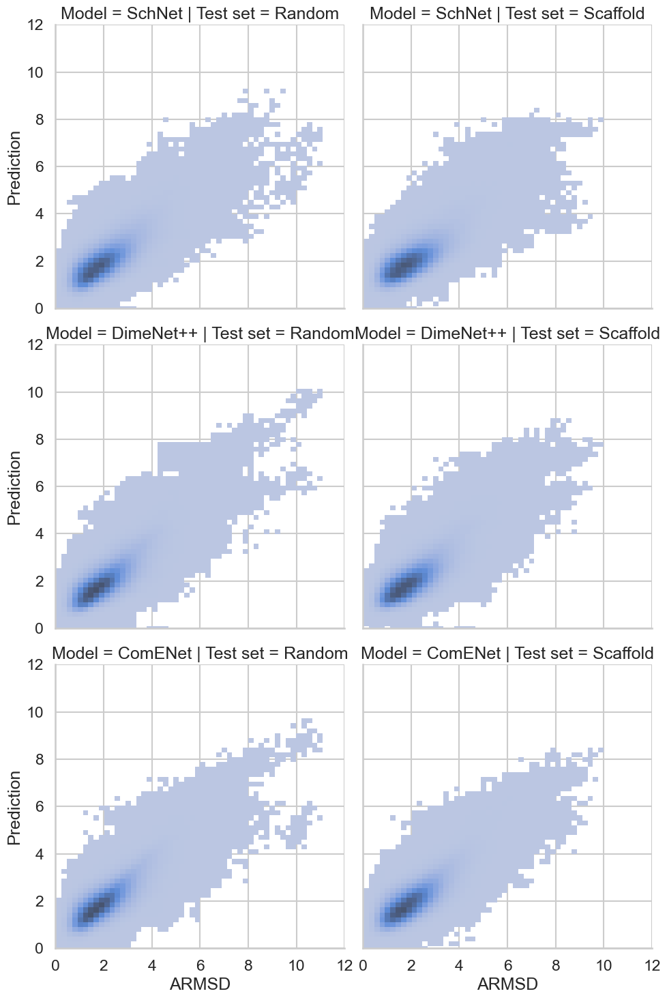

In [47]:
sns.displot(data=regression_gen_df,
            x='ARMSD',
            y='Prediction',
           col='Test set',
           row='Model',
           kind='hist',
           bins=50)
plt.xlim(0, 12)
plt.ylim(0, 12)

In [48]:
from sklearn.metrics import mean_squared_error, r2_score

av_reg_rows = []
for split_type in ['Random', 'Scaffold']:
    
    for split_i in range(5):
        
        for model in ['SchNet', 'DimeNet++', 'ComENet']:
        
            try:
                subset_df = regression_gen_df[(regression_gen_df['Test set'] == split_type)
                                             & (regression_gen_df['Iteration'] == split_i)
                                             & (regression_gen_df['Model'] == model)]
                targets = subset_df['ARMSD']
                preds = subset_df['Prediction']
                rmse = mean_squared_error(targets, preds, squared=False)
                r2 = r2_score(targets, preds)
                row = {}
                row['Test set'] = split_type
                row['Iteration'] = split_i
                row['Model'] = model
                row['RMSE'] = rmse
                row['R\u00b2'] = r2
                av_reg_rows.append(row)
            except Exception as e:
                print(split_type, split_i, model)
                print(e)
        
av_reg_df = pd.DataFrame(av_reg_rows)

In [49]:
av_reg_df.groupby(['Test set', 'Model'], sort=False).agg({'RMSE': custom_agg,
                                  'R\u00b2': custom_agg})

RMSE           R²
Test set Model                              
Random   SchNet     0.64 ± 0.02  0.53 ± 0.02
         DimeNet++  0.61 ± 0.03  0.57 ± 0.02
         ComENet     0.6 ± 0.03  0.59 ± 0.02
Scaffold SchNet     0.63 ± 0.03  0.52 ± 0.04
         DimeNet++  0.61 ± 0.03  0.56 ± 0.04
         ComENet     0.6 ± 0.03  0.57 ± 0.03

In [50]:
figure_dir

'/home/bb596/hdd/pdbbind_bioactive/figures/'

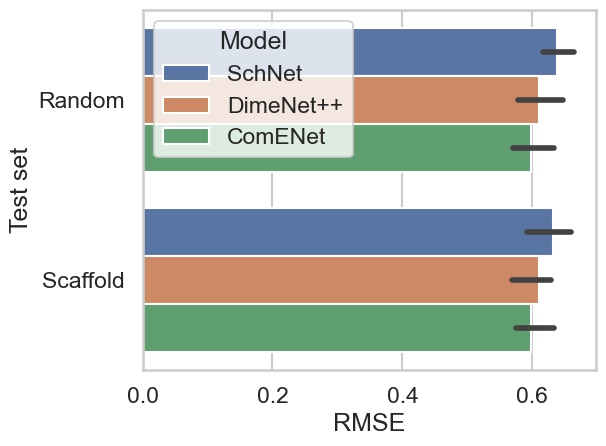

In [51]:
sns.barplot(data=av_reg_df,
           y='Test set',
           x='RMSE',
           hue='Model',
           errorbar=('pi', 100))
plt.tight_layout()
plt.savefig(os.path.join(figure_dir, 'Regression_RMSE.png'), dpi=300)

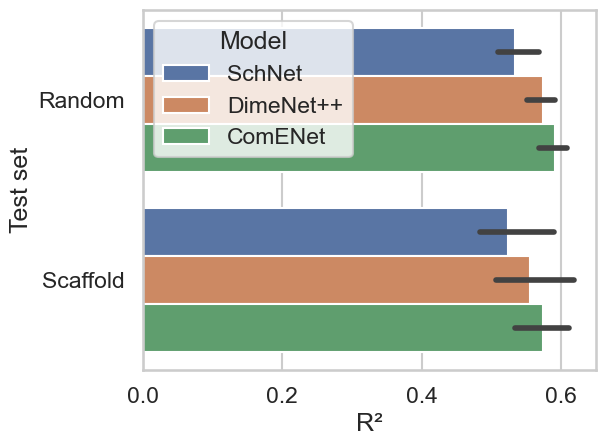

In [52]:
sns.barplot(data=av_reg_df,
           y='Test set',
           x='R\u00b2',
           hue='Model',
           errorbar=('pi', 100))
plt.tight_layout()
plt.savefig(os.path.join(figure_dir, 'Regression_R2.png'), dpi=300)

# Ranks

In [25]:
grouped_median_df = results_df.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).median()
grouped_median_df = grouped_median_df.reset_index()

In [26]:
def get_stats(results_df,
              metric='Normalized rank of first bioactive-like conformation'):
    
    results_df[metric] = results_df[metric].round(3)
    ecdf_dfs = []
    fractions = np.around(np.arange(0, 251) / 250, 3)
    results_df[metric] = results_df[metric].round(3)
    for fraction in np.flip(fractions):
        fraction_results_df = results_df[results_df[metric] <= fraction]

        grouped_fraction_results_df = fraction_results_df.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).count()
        ecdf_df = grouped_fraction_results_df[metric].reset_index()
        ecdf_df['Fraction'] = fraction
        ecdf_dfs.append(ecdf_df)

    count_df = results_df.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).count()
    count_df = count_df[metric].reset_index()
    count_df = count_df.rename({metric:'Total'}, axis=1)

    grouped_ecdf_df = pd.concat(ecdf_dfs)
    grouped_ecdf_df = grouped_ecdf_df.merge(count_df, on=['Test set', 'Ranker', 'Iteration'])

    grouped_ecdf_df['Proportion'] = grouped_ecdf_df[metric] / grouped_ecdf_df['Total']

    rs = []
    for d in [0.25, 0.50, 0.75]:
        unique_fraction = grouped_ecdf_df[grouped_ecdf_df['Proportion'] >= d]
        grouped_fraction = unique_fraction.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).min()
        grouped_fraction = grouped_fraction.reset_index()
        grouped_fraction['Fraction'] = grouped_fraction['Fraction'] * 100
        r = grouped_fraction.groupby(['Test set', 'Ranker'], sort=False).agg(custom_agg)['Fraction']
        r.name = d
        rs.append(r)

    summary_table = pd.DataFrame(rs).transpose()
        
    return grouped_ecdf_df, summary_table

In [35]:
grouped_ecdf_df, summary_table = get_stats(results_df,
              metric='Normalized rank of first bioactive-like conformation')

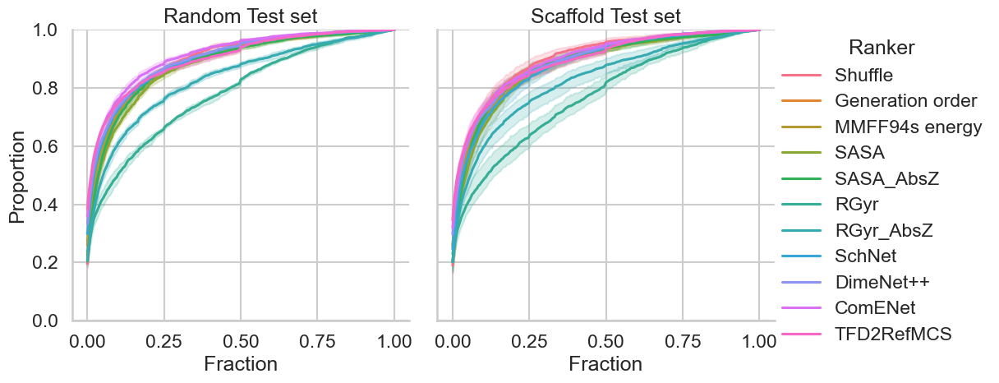

In [33]:
plot = sns.relplot(data=grouped_ecdf_df,
            x='Fraction',
            y='Proportion',
            hue='Ranker',
           kind='line',
           col='Test set')
plot.set_titles('{col_name} {col_var}')
plt.ylim(0, 1)
plt.savefig(os.path.join(figure_dir, 'Bio_ranks.png'), 
            dpi=300,
           bbox_inches='tight')

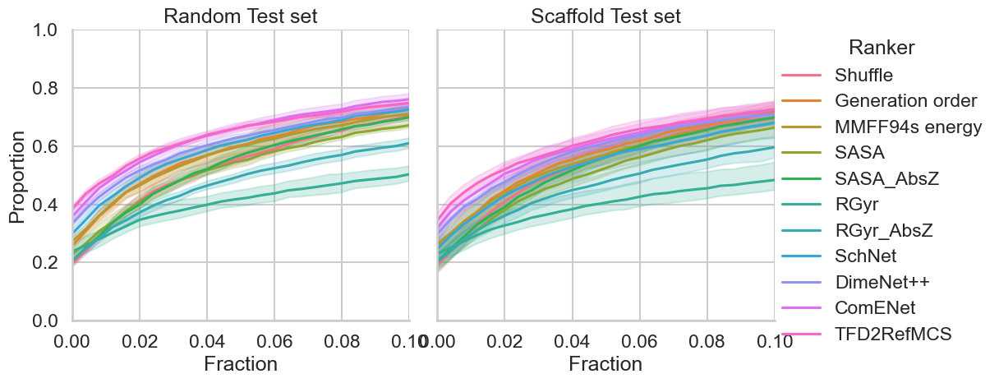

In [34]:
plot = sns.relplot(data=grouped_ecdf_df,
            x='Fraction',
            y='Proportion',
            hue='Ranker',
           kind='line',
           col='Test set')
plot.set_titles('{col_name} {col_var}')
plt.ylim(0, 1)
plt.xlim(0, 0.1)
plt.savefig(os.path.join(figure_dir, 'Bio_ranks_zoomed.png'), 
            dpi=300,
           bbox_inches='tight')

In [23]:
summary_table

0.25          0.50          0.75
Test set Ranker                                                   
Random   Shuffle           0.64 ± 0.22    3.6 ± 0.63  13.12 ± 1.37
         Generation order  0.16 ± 0.22   2.72 ± 0.52  12.08 ± 1.71
         MMFF94s energy      0.0 ± 0.0    2.8 ± 0.57  13.28 ± 1.78
         SASA                0.4 ± 0.4   3.76 ± 0.61  15.52 ± 0.77
         RGyr              0.56 ± 0.46   9.84 ± 2.09   37.6 ± 3.31
         SchNet              0.0 ± 0.0   2.32 ± 0.33  11.84 ± 1.08
         DimeNet++           0.0 ± 0.0   1.92 ± 0.33  11.52 ± 0.72
         ComENet             0.0 ± 0.0   1.52 ± 0.33   9.52 ± 1.63
         TFD2RefMCS          0.0 ± 0.0   1.44 ± 0.22  10.24 ± 0.46
Scaffold Shuffle           0.72 ± 0.18    3.6 ± 0.75  12.16 ± 2.79
         Generation order  0.32 ± 0.33   3.04 ± 0.67   12.8 ± 2.28
         MMFF94s energy    0.24 ± 0.36   3.28 ± 0.87  14.08 ± 2.23
         SASA              0.64 ± 0.46   4.48 ± 1.04  15.76 ± 2.17
         RGyr               0.8 ± 0.49  11.76 ± 4.02   40.8 ± 6.25
         SchNet            0.32 ± 0.33   3.68 ± 1.37  14.96 ± 3.63
         DimeNet++           0.0 ± 0.0   2.56 ± 0.36  13.28 ± 1.78
         ComENet           0.08 ± 0.18   2.24 ± 0.83  11.92 ± 2.49
         TFD2RefMCS          0.0 ± 0.0    2.0 ± 0.94  12.56 ± 2.75

In [37]:
a = results_df.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).mean().reset_index()
a['Fraction of molecules with a top-ranked bioactive-like conformation (%)'] = a['Bioactive-like conformation is first'] * 100
b = a.groupby(['Test set', 'Ranker'], sort=False).agg(custom_agg)[['Fraction of molecules with a top-ranked bioactive-like conformation (%)']]
b

Fraction of molecules with a top-ranked bioactive-like conformation (%)
Test set Ranker                                                                                  
Random   Random order                                           13.78 ± 1.28                     
         Generation order                                       18.17 ± 1.34                     
         MMFF94s energy                                         19.11 ± 1.68                     
         SASA                                                   16.01 ± 2.39                     
         RGyr                                                   16.83 ± 2.67                     
         SchNet                                                 21.06 ± 1.68                     
         DimeNet++                                              23.49 ± 1.18                     
         ComENet                                                25.26 ± 1.86                     
         TFD2RefMCS                                             27.07 ± 1.46                     
Scaffold Random order                                           13.37 ± 2.13                     
         Generation order                                       17.91 ± 2.02                     
         MMFF94s energy                                          18.33 ± 2.8                     
         SASA                                                   14.43 ± 1.88                     
         RGyr                                                   16.09 ± 2.74                     
         SchNet                                                 17.35 ± 3.04                     
         DimeNet++                                              21.02 ± 2.12                     
         ComENet                                                22.59 ± 3.83                     
         TFD2RefMCS                                             24.36 ± 3.39

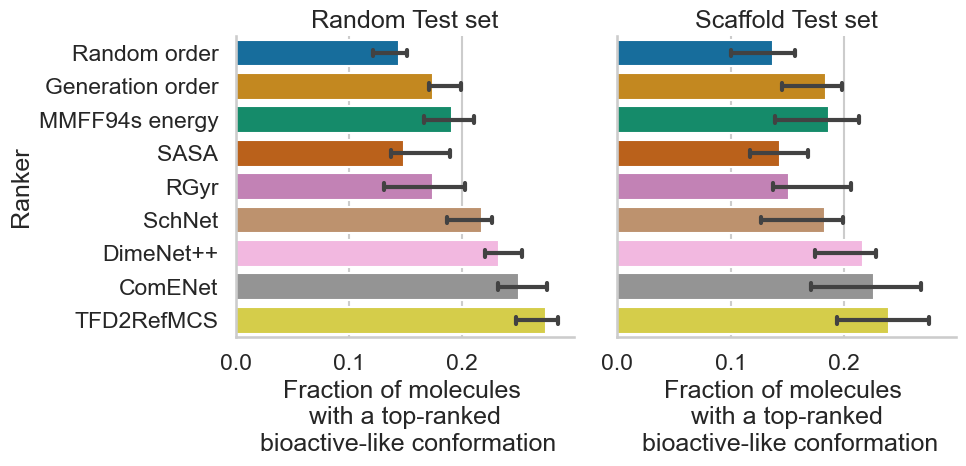

In [38]:
plot = sns.catplot(data=a, 
                y='Ranker', 
                x='Bioactive-like conformation is first', 
                # order=ranker_order,
                col='Test set',
                kind='bar',
                  errorbar=('pi', 100),
                 errwidth=3,
                 capsize=0.20,
                 estimator='median',
                  palette=hue2palette)
plot.set_xlabels('Fraction of molecules \n with a top-ranked \n bioactive-like conformation')
plt.xlim(0)
plt.tight_layout()
plot.set_titles('{col_name} {col_var}')
plt.savefig(os.path.join(figure_dir, 'Bio_first.png'), dpi=300)

In [47]:
grouped_ecdf, summary_table = get_stats(results_df,
                                        metric='BEDROC of bioactive-like conformations')

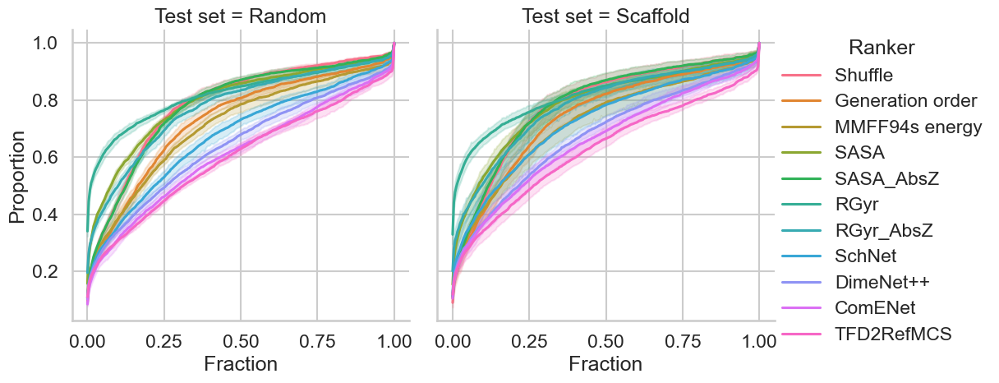

In [39]:
sns.relplot(data=grouped_ecdf,
            x='Fraction',
            y='Proportion',
            hue='Ranker',
           kind='line',
           col='Test set')

In [48]:
summary_table

0.25          0.50           0.75
Test set Ranker                                                    
Random   Shuffle           2.56 ± 0.46  12.32 ± 1.07   27.12 ± 1.63
         Generation order  3.44 ± 1.22  16.88 ± 1.99   38.24 ± 3.89
         MMFF94s energy    2.88 ± 0.87   18.0 ± 1.62   44.88 ± 6.14
         SASA              0.56 ± 0.22   7.84 ± 0.92   27.92 ± 2.11
         RGyr                0.0 ± 0.0   1.28 ± 0.33    22.0 ± 2.73
         SchNet             3.2 ± 0.49  22.24 ± 2.79   54.24 ± 6.47
         DimeNet++         3.92 ± 0.52   25.6 ± 2.08   62.72 ± 4.59
         ComENet           5.52 ± 2.14   29.6 ± 2.51   70.24 ± 2.92
         TFD2RefMCS        4.88 ± 0.44  31.44 ± 1.66   72.96 ± 5.08
Scaffold Shuffle           3.12 ± 1.58  12.64 ± 2.51   28.16 ± 5.79
         Generation order  3.04 ± 1.08  15.92 ± 3.41   36.56 ± 6.43
         MMFF94s energy    2.48 ± 1.04  16.32 ± 3.88  43.92 ± 10.02
         SASA              0.88 ± 0.44   8.88 ± 2.42   29.44 ± 7.08
         RGyr                0.0 ± 0.0   1.68 ± 0.87    23.76 ± 5.3
         SchNet            1.92 ± 0.87  15.76 ± 5.26   44.32 ± 9.29
         DimeNet++         2.72 ± 0.66   21.6 ± 2.02   55.12 ± 4.94
         ComENet            3.2 ± 1.13  23.04 ± 4.62   59.84 ± 6.61
         TFD2RefMCS        3.84 ± 1.89  26.72 ± 4.72    65.76 ± 7.4

In [28]:
grouped_ecdf_df, summary_table = get_stats(results_df,
              metric='Normalized rank of first non-bioactive conformation')

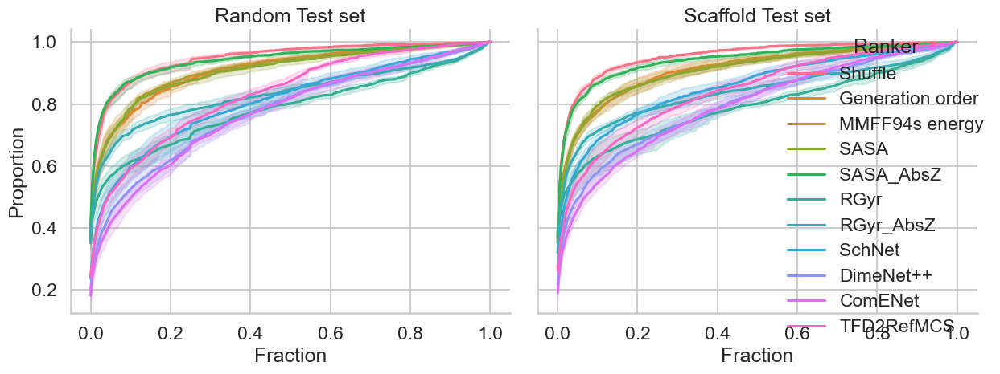

In [42]:
plot = sns.relplot(data=grouped_ecdf_df,
            x='Fraction',
            y='Proportion',
            hue='Ranker',
           kind='line',
           col='Test set')
plt.tight_layout()
plot.set_titles('{col_name} {col_var}')
plt.savefig(os.path.join(figure_dir, 'Non-bio_ranks.png'), dpi=300)

In [29]:
summary_table

0.25          0.50          0.75
Test set Ranker                                                   
Random   Shuffle             0.0 ± 0.0   0.64 ± 0.22   3.12 ± 0.44
         Generation order    0.0 ± 0.0   0.96 ± 0.22   8.96 ± 2.55
         MMFF94s energy      0.0 ± 0.0    1.2 ± 0.63   8.16 ± 2.59
         SASA                0.0 ± 0.0   0.96 ± 0.22   8.08 ± 1.18
         RGyr                0.0 ± 0.0   2.32 ± 1.68  35.04 ± 4.84
         SchNet            0.32 ± 0.33   4.88 ± 2.54  28.24 ± 8.68
         DimeNet++         0.64 ± 0.36   8.88 ± 3.14  35.36 ± 5.34
         ComENet             0.8 ± 0.4  10.48 ± 3.03   36.4 ± 3.71
         TFD2RefMCS        0.24 ± 0.36   5.04 ± 1.71   26.4 ± 4.66
Scaffold Shuffle             0.0 ± 0.0   0.64 ± 0.22   2.96 ± 0.46
         Generation order    0.0 ± 0.0   1.04 ± 0.36   7.68 ± 1.45
         MMFF94s energy      0.0 ± 0.0   0.96 ± 0.22   8.08 ± 1.53
         SASA                0.0 ± 0.0   1.04 ± 0.22   7.36 ± 1.22
         RGyr                0.0 ± 0.0   2.64 ± 3.01  32.88 ± 5.84
         SchNet              0.0 ± 0.0   2.56 ± 0.67  18.08 ± 3.05
         DimeNet++           0.4 ± 0.0    5.6 ± 1.94   33.6 ± 4.91
         ComENet           0.56 ± 0.22   7.28 ± 1.68  34.08 ± 3.43
         TFD2RefMCS        0.16 ± 0.22   3.68 ± 0.91   23.6 ± 5.29

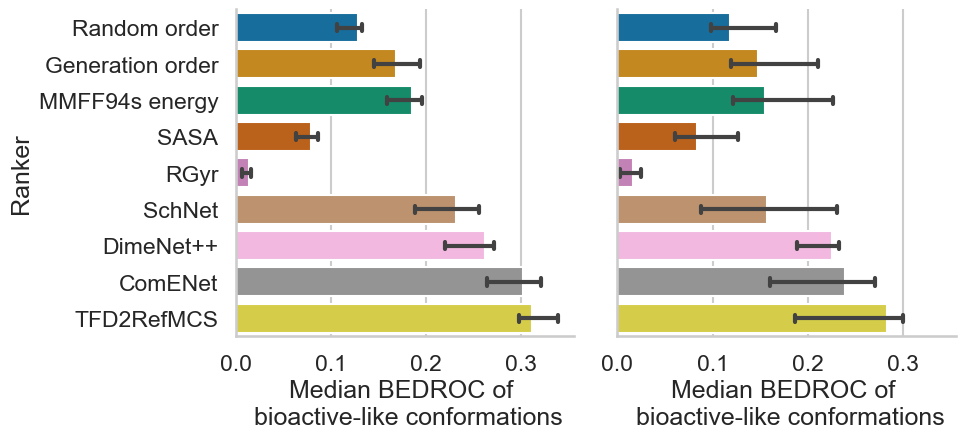

In [27]:
plot = sns.catplot(data=grouped_median_df, 
            y='Ranker', 
            x='BEDROC of bioactive-like conformations', 
            # order=ranker_order,
            col='Test set',
            kind='bar',
                  errorbar=('pi', 100),
                         errwidth=3,
                         capsize=0.20,
                         estimator='median',
                  palette=hue2palette)
plot.set_xlabels('Median BEDROC of \n bioactive-like conformations')
plt.tight_layout()
# plot.set_titles('{col_name} {col_var}')
plot.set_titles('')
plt.savefig(os.path.join(figure_dir, 'BEDROC_bio.png'), dpi=300)

In [25]:
a = results_df.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).median().reset_index()
b = a.groupby(['Test set', 'Ranker'], sort=False).agg(custom_agg)[['BEDROC of bioactive-like conformations']]
b

BEDROC of bioactive-like conformations
Test set Ranker                                                 
Random   Random order                                0.12 ± 0.01
         Generation order                            0.17 ± 0.02
         MMFF94s energy                              0.18 ± 0.02
         SASA                                        0.08 ± 0.01
         RGyr                                         0.01 ± 0.0
         SchNet                                      0.22 ± 0.03
         DimeNet++                                   0.25 ± 0.02
         ComENet                                     0.29 ± 0.02
         TFD2RefMCS                                  0.31 ± 0.02
Scaffold Random order                                0.13 ± 0.03
         Generation order                            0.16 ± 0.03
         MMFF94s energy                              0.16 ± 0.04
         SASA                                        0.09 ± 0.02
         RGyr                                        0.02 ± 0.01
         SchNet                                      0.16 ± 0.05
         DimeNet++                                   0.21 ± 0.02
         ComENet                                     0.23 ± 0.05
         TFD2RefMCS                                  0.27 ± 0.05

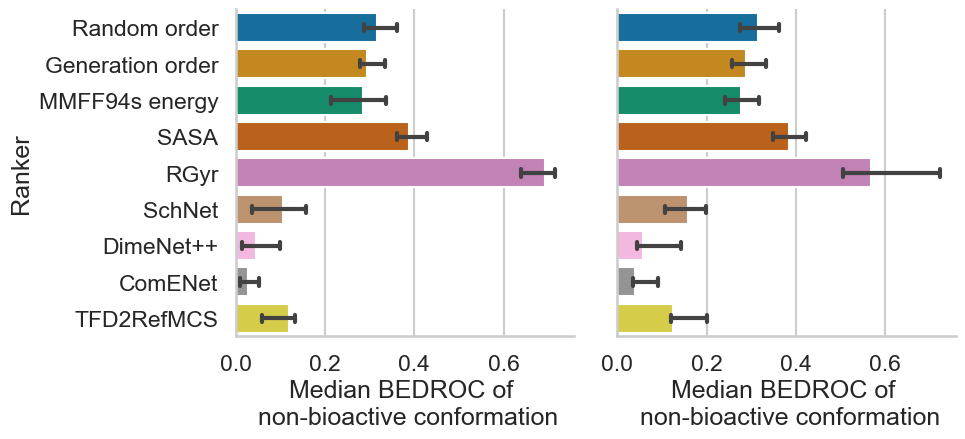

In [40]:
plot = sns.catplot(data=grouped_median_df, 
            y='Ranker', 
            x='BEDROC of non-bioactive conformations', 
            # order=ranker_order,
            col='Test set',
            kind='bar',
                  errorbar=('pi', 100),
                         errwidth=3,
                         capsize=0.20,
                         estimator='median',
                  palette=hue2palette)
plot.set_xlabels('Median BEDROC of \n non-bioactive conformation')
plt.xlim(0)
plt.tight_layout()
# plot.set_titles('{col_name} {col_var}')
plot.set_titles('')
plt.savefig(os.path.join(figure_dir, 'BEDROC_non-bio.png'), dpi=300)

In [26]:
a = results_df.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).median().reset_index()
b = a.groupby(['Test set', 'Ranker'], sort=False).agg(custom_agg)[['BEDROC of non-bioactive conformations']]
b

BEDROC of non-bioactive conformations
Test set Ranker                                                
Random   Random order                               0.32 ± 0.03
         Generation order                            0.3 ± 0.02
         MMFF94s energy                             0.28 ± 0.05
         SASA                                       0.39 ± 0.03
         RGyr                                       0.68 ± 0.03
         SchNet                                     0.09 ± 0.05
         DimeNet++                                  0.05 ± 0.03
         ComENet                                    0.03 ± 0.02
         TFD2RefMCS                                 0.11 ± 0.03
Scaffold Random order                               0.31 ± 0.03
         Generation order                            0.3 ± 0.04
         MMFF94s energy                             0.28 ± 0.03
         SASA                                       0.38 ± 0.03
         RGyr                                        0.61 ± 0.1
         SchNet                                     0.15 ± 0.03
         DimeNet++                                  0.08 ± 0.04
         ComENet                                    0.05 ± 0.02
         TFD2RefMCS                                 0.14 ± 0.03

# BIO250

In [41]:
grouped_ecdf_df, summary_table = get_stats(results_df_bio_250,
              metric='Normalized rank of first bioactive-like conformation')

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


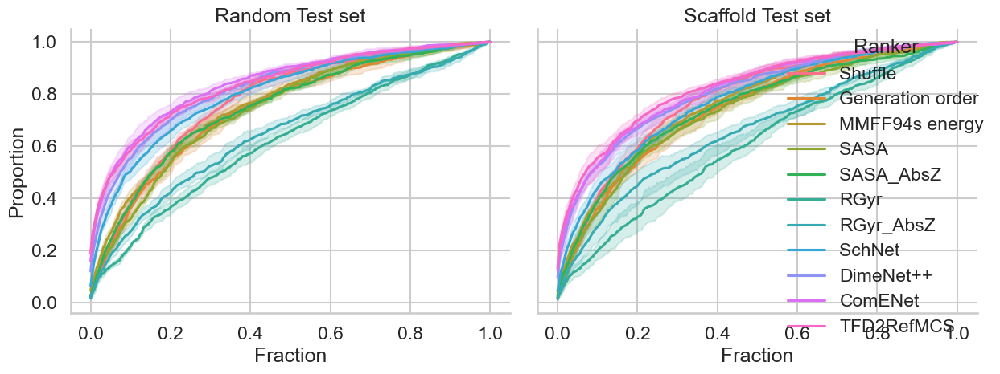

In [48]:
plot = sns.relplot(data=grouped_ecdf_df,
            x='Fraction',
            y='Proportion',
            hue='Ranker',
           kind='line',
           col='Test set')
plt.tight_layout()
plot.set_titles('{col_name} {col_var}')
plt.savefig(os.path.join(figure_dir, 'Bio_ranks_250.png'), dpi=300)

In [34]:
summary_table

0.25          0.50          0.75
Test set Ranker                                                    
Random   Shuffle            5.92 ± 0.72  15.68 ± 2.36  32.56 ± 2.92
         Generation order   6.48 ± 1.18   17.6 ± 3.26  38.08 ± 3.45
         MMFF94s energy     4.64 ± 0.92   16.0 ± 1.94  37.92 ± 3.75
         SASA                 6.8 ± 0.8  18.32 ± 1.31   40.56 ± 1.8
         RGyr              12.24 ± 0.67   32.4 ± 3.91  61.76 ± 3.71
         SchNet             2.48 ± 0.18  10.24 ± 1.85  29.92 ± 5.23
         DimeNet++          1.52 ± 0.33     7.6 ± 2.0  25.12 ± 4.36
         ComENet            0.88 ± 0.33   5.84 ± 1.89  21.68 ± 4.69
         TFD2RefMCS         0.64 ± 0.36   6.16 ± 1.61  23.52 ± 2.46
Scaffold Shuffle            5.92 ± 0.77  15.12 ± 3.03  31.28 ± 3.83
         Generation order   6.32 ± 0.52   17.92 ± 2.3  39.92 ± 4.45
         MMFF94s energy      5.2 ± 0.28  16.08 ± 0.95  38.08 ± 5.56
         SASA               6.24 ± 1.28  17.44 ± 1.08  41.44 ± 3.77
         RGyr              14.32 ± 4.07    34.8 ± 7.5   62.8 ± 5.08
         SchNet             3.84 ± 1.25  14.32 ± 4.11  35.44 ± 3.18
         DimeNet++          1.84 ± 0.61    9.04 ± 2.2  30.32 ± 3.69
         ComENet             1.6 ± 0.85   9.04 ± 2.36  28.48 ± 4.68
         TFD2RefMCS         1.12 ± 0.77   7.52 ± 3.24  25.44 ± 3.09

In [42]:
a = results_df_bio_250.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).mean().reset_index()
a['percentage_bio_like_first'] = a['Bioactive-like conformation is first'] * 100
b = a.groupby(['Test set', 'Ranker'], sort=False).agg(custom_agg)[['percentage_bio_like_first']]
b

percentage_bio_like_first
Test set Ranker                                    
Random   Random order                   2.01 ± 0.26
         Generation order               2.55 ± 1.17
         MMFF94s energy                 4.73 ± 1.58
         SASA                            2.6 ± 0.51
         RGyr                           2.26 ± 0.92
         SchNet                         6.32 ± 3.02
         DimeNet++                      12.02 ± 2.0
         ComENet                       15.99 ± 5.02
         TFD2RefMCS                    18.92 ± 3.14
Scaffold Random order                    2.0 ± 0.26
         Generation order               1.63 ± 0.69
         MMFF94s energy                 4.21 ± 1.13
         SASA                           3.16 ± 1.37
         RGyr                           1.82 ± 1.21
         SchNet                         4.72 ± 1.41
         DimeNet++                      9.74 ± 3.67
         ComENet                       12.44 ± 4.09
         TFD2RefMCS                    13.37 ± 4.59

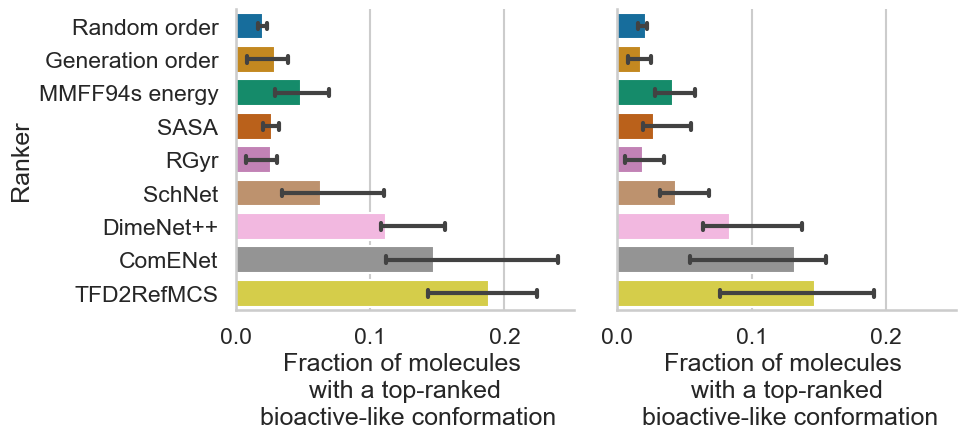

In [43]:
plot = sns.catplot(data=a, 
            y='Ranker', 
            x='Bioactive-like conformation is first', 
            # order=ranker_order,
            col='Test set',
            kind='bar',
                  errorbar=('pi', 100),
                         errwidth=3,
                         capsize=0.20,
                         estimator='median',
                  palette=hue2palette)
plot.set_xlabels('Fraction of molecules \n with a top-ranked \n bioactive-like conformation')
plt.xlim(0)
plt.tight_layout()
# plot.set_titles('{col_name} {col_var}')
plot.set_titles('')
plt.savefig(os.path.join(figure_dir, 'Bio_first_250.png'), dpi=300)

In [37]:
grouped_ecdf, summary_table = get_stats(results_df_bio_250,
                                        metric='BEDROC of bioactive-like conformations')

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


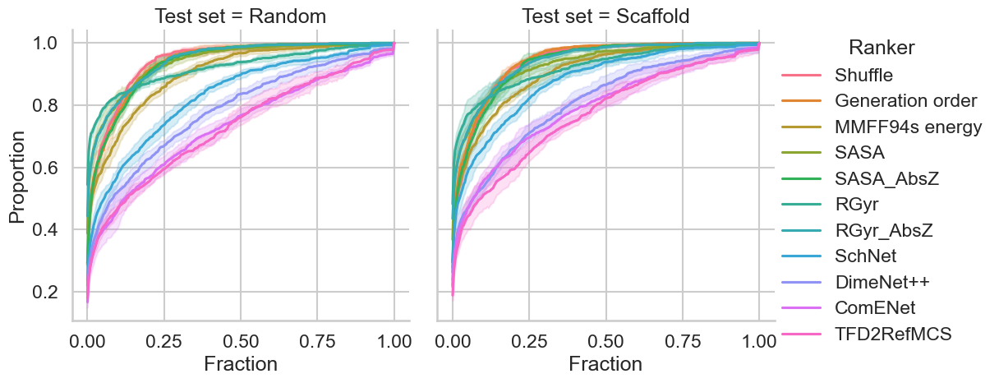

In [53]:
sns.relplot(data=grouped_ecdf,
            x='Fraction',
            y='Proportion',
            hue='Ranker',
           kind='line',
           col='Test set')

In [38]:
summary_table

0.25          0.50          0.75
Test set Ranker                                                   
Random   Shuffle           0.32 ± 0.18   1.36 ± 0.46   8.32 ± 1.31
         Generation order  0.08 ± 0.18   1.36 ± 0.61   9.04 ± 1.66
         MMFF94s energy      0.0 ± 0.0   1.76 ± 0.78  13.28 ± 2.09
         SASA                0.0 ± 0.0   0.48 ± 0.18   6.48 ± 2.83
         RGyr                0.0 ± 0.0   0.08 ± 0.18   3.28 ± 0.72
         SchNet             0.4 ± 0.28   5.36 ± 2.09  26.16 ± 4.04
         DimeNet++         0.48 ± 0.18    8.72 ± 3.2  36.16 ± 3.33
         ComENet            0.8 ± 0.49   12.0 ± 4.01  46.64 ± 4.57
         TFD2RefMCS        0.64 ± 0.22  13.28 ± 2.69  49.44 ± 4.84
Scaffold Shuffle           0.32 ± 0.18   1.84 ± 0.61   8.24 ± 0.96
         Generation order    0.0 ± 0.0   1.12 ± 0.44    8.16 ± 1.0
         MMFF94s energy    0.08 ± 0.18    1.6 ± 0.28  11.76 ± 0.83
         SASA                0.0 ± 0.0   0.64 ± 0.22   7.28 ± 2.27
         RGyr                0.0 ± 0.0   0.32 ± 0.18    4.8 ± 2.23
         SchNet            0.08 ± 0.18     2.8 ± 1.1  18.16 ± 3.99
         DimeNet++         0.32 ± 0.18   6.72 ± 1.88  30.72 ± 4.11
         ComENet           0.32 ± 0.18   6.88 ± 1.97  34.08 ± 8.39
         TFD2RefMCS        0.48 ± 0.18  10.32 ± 4.57  39.44 ± 5.02

In [39]:
grouped_ecdf_df, summary_table = get_stats(results_df_bio_250,
              metric='Normalized rank of first non-bioactive conformation')

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


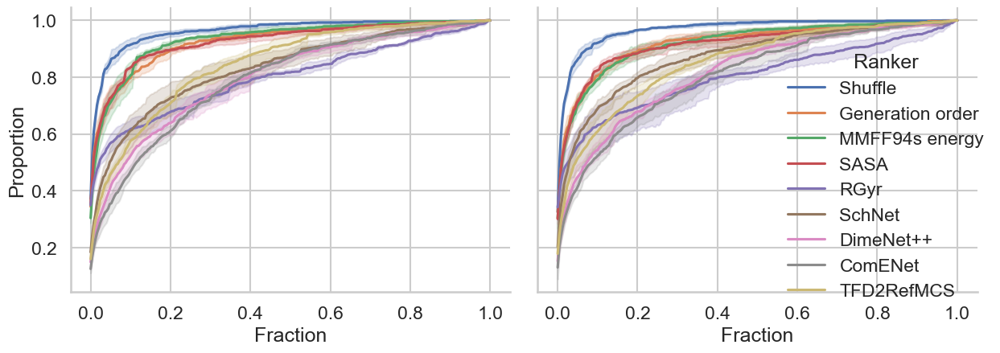

In [40]:
plot = sns.relplot(data=grouped_ecdf_df,
            x='Fraction',
            y='Proportion',
            hue='Ranker',
           kind='line',
           col='Test set')
plt.tight_layout()
# plot.set_titles('{col_name} {col_var}')
plot.set_titles('')
plt.savefig(os.path.join(figure_dir, 'Non-bio_ranks_250.png'), dpi=300)

In [41]:
summary_table

0.25          0.50           0.75
Test set Ranker                                                    
Random   Shuffle             0.0 ± 0.0   0.48 ± 0.18    2.72 ± 0.33
         Generation order    0.0 ± 0.0   0.88 ± 0.18      6.4 ± 2.3
         MMFF94s energy      0.0 ± 0.0   1.36 ± 0.61    7.28 ± 3.23
         SASA                0.0 ± 0.0   0.88 ± 0.18    5.76 ± 1.51
         RGyr                0.0 ± 0.0    2.56 ± 1.0   32.48 ± 4.53
         SchNet            0.64 ± 0.22   5.68 ± 2.57  24.96 ± 11.49
         DimeNet++          1.6 ± 0.85   9.28 ± 3.48   31.84 ± 5.53
         ComENet           2.16 ± 0.83  11.84 ± 1.82   32.72 ± 2.32
         TFD2RefMCS        1.04 ± 0.36   7.12 ± 1.71   23.52 ± 4.88
Scaffold Shuffle             0.0 ± 0.0   0.72 ± 0.18     2.4 ± 0.28
         Generation order    0.0 ± 0.0   1.28 ± 0.33     6.48 ± 1.4
         MMFF94s energy      0.0 ± 0.0   1.28 ± 0.52     7.6 ± 1.88
         SASA                0.0 ± 0.0   1.28 ± 0.18    6.32 ± 0.52
         RGyr                0.0 ± 0.0   4.48 ± 6.05  27.04 ± 10.43
         SchNet             0.4 ± 0.28   3.12 ± 1.18   14.96 ± 3.01
         DimeNet++         0.96 ± 0.54   7.52 ± 2.37    30.0 ± 3.94
         ComENet           1.12 ± 0.52   8.96 ± 2.38    30.8 ± 5.51
         TFD2RefMCS        0.72 ± 0.52   5.28 ± 2.03   20.48 ± 5.05

In [45]:
grouped_median_df_bio_250 = results_df_bio_250.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).median()
grouped_median_df_bio_250 = grouped_median_df_bio_250.reset_index()

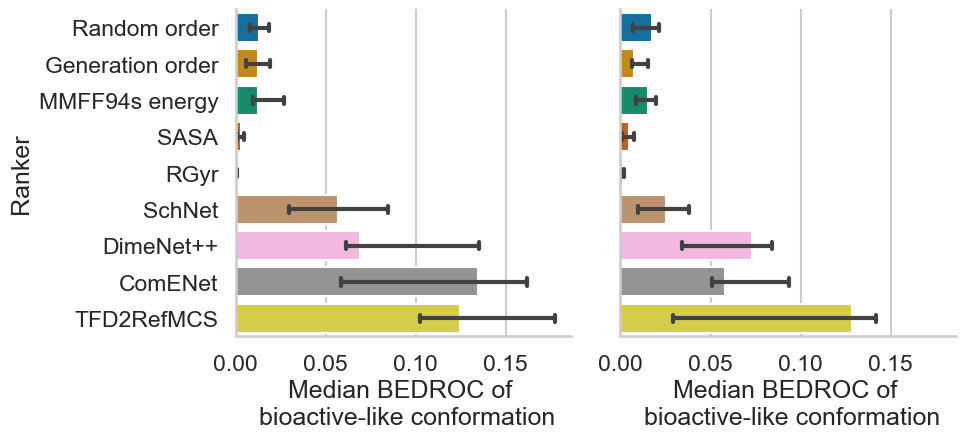

In [46]:
plot = sns.catplot(data=grouped_median_df_bio_250, 
            y='Ranker', 
            x='BEDROC of bioactive-like conformations', 
            # order=ranker_order,
            col='Test set',
            kind='bar',
                  errorbar=('pi', 100),
                         errwidth=3,
                         capsize=0.20,
                         estimator='median',
                  palette=hue2palette)
plot.set_xlabels('Median BEDROC of \n bioactive-like conformation')
plt.xlim(0)
plt.tight_layout()
# plot.set_titles('{col_name} {col_var}')
plot.set_titles('')
plt.savefig(os.path.join(figure_dir, 'BEDROC_bio_250.png'), dpi=300)

In [27]:
a = results_df_bio_250.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).median().reset_index()
b = a.groupby(['Test set', 'Ranker'], sort=False).agg(custom_agg)[['BEDROC of bioactive-like conformations']]
b

BEDROC of bioactive-like conformations
Test set Ranker                                                 
Random   Random order                                 0.01 ± 0.0
         Generation order                            0.01 ± 0.01
         MMFF94s energy                              0.02 ± 0.01
         SASA                                          0.0 ± 0.0
         RGyr                                          0.0 ± 0.0
         SchNet                                      0.05 ± 0.02
         DimeNet++                                   0.09 ± 0.03
         ComENet                                     0.12 ± 0.04
         TFD2RefMCS                                  0.13 ± 0.03
Scaffold Random order                                0.02 ± 0.01
         Generation order                             0.01 ± 0.0
         MMFF94s energy                               0.01 ± 0.0
         SASA                                          0.0 ± 0.0
         RGyr                                          0.0 ± 0.0
         SchNet                                      0.03 ± 0.01
         DimeNet++                                   0.07 ± 0.02
         ComENet                                     0.07 ± 0.02
         TFD2RefMCS                                   0.1 ± 0.05

In [28]:
0.29/0.18

1.6111111111111112

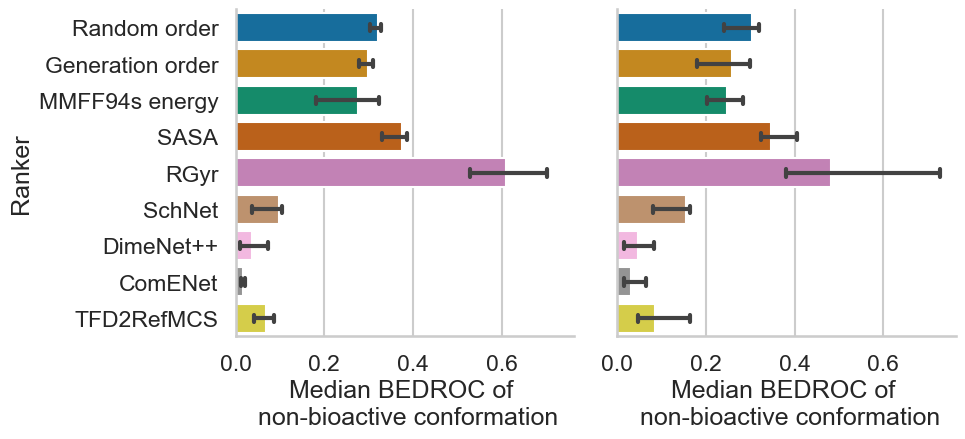

In [47]:
plot = sns.catplot(data=grouped_median_df_bio_250, 
            y='Ranker', 
            x='BEDROC of non-bioactive conformations', 
            # order=ranker_order,
            col='Test set',
            kind='bar',
                  errorbar=('pi', 100),
                         errwidth=3,
                         capsize=0.20,
                         estimator='median',
                  palette=hue2palette)
plot.set_xlabels('Median BEDROC of \n non-bioactive conformation')
plt.xlim(0)
plt.tight_layout()
# plot.set_titles('{col_name} {col_var}')
plot.set_titles('')
plt.savefig(os.path.join(figure_dir, 'BEDROC_non-bio_250.png'), dpi=300)

In [46]:
a = results_df_bio_250.groupby(['Test set', 'Ranker', 'Iteration'], sort=False).median().reset_index()
b = a.groupby(['Test set', 'Ranker'], sort=False).agg(custom_agg)[['BEDROC of non-bioactive conformations']]
b

BEDROC of non-bioactive conformations
Test set Ranker                                                
Random   Shuffle                                    0.32 ± 0.01
         Generation order                           0.29 ± 0.01
         MMFF94s energy                             0.26 ± 0.07
         SASA                                       0.37 ± 0.02
         RGyr                                       0.61 ± 0.06
         SchNet                                     0.08 ± 0.03
         DimeNet++                                  0.04 ± 0.02
         ComENet                                     0.02 ± 0.0
         TFD2RefMCS                                 0.07 ± 0.02
Scaffold Shuffle                                    0.29 ± 0.03
         Generation order                           0.25 ± 0.04
         MMFF94s energy                             0.24 ± 0.03
         SASA                                       0.36 ± 0.03
         RGyr                                       0.51 ± 0.13
         SchNet                                     0.13 ± 0.04
         DimeNet++                                  0.05 ± 0.03
         ComENet                                    0.04 ± 0.02
         TFD2RefMCS                                  0.1 ± 0.04

# Class-dependant results

In [29]:
def add_bar_counts(fig, counts):
    axes = fig.axes[0]
    for ax in axes:
        middle_i = round(len(ax.containers) / 2)
        ax.bar_label(ax.containers[0], counts, padding=75)

In [30]:
sns.set_context('talk')
def show_plots(target_results_df, value_counts, figname=None):
    # value_counts = target_results_df.drop_duplicates(['PDB ID'])[level_str].value_counts()
    target_names = value_counts.index
    step_size=10
    for i in range(int(len(value_counts) / step_size) + 1) :
        # plt.figure(figsize=(4, 2*step_size))
        current_slice = slice(i * step_size, (i + 1) * step_size)
        subset_value_counts = value_counts[current_slice]
        subset_names = subset_value_counts.index
        subset_counts = subset_value_counts.values
        clean_counts = [f'n = {count}' for count in subset_counts]
        fig = sns.catplot(data=grouped_target_results_df, 
                    y=level_str, 
                    x='BEDROC of bioactive-like conformations', 
                    col='Test set',
                    # hue_order=hue_order,
                    order=subset_names,
                    hue='Ranker',
                    kind='bar',
                    errorbar=('pi', 100),
                         aspect=5/10, 
                         height=10,
                         errwidth=2,
                         capsize=0.05,
                         estimator='median',
                  palette=hue2palette)
        fig.set_yticklabels([f'{name} (n={count})' for name, count in zip(subset_names, subset_counts)])
        # add_bar_counts(fig, clean_counts)
        
        # plt.legend(bbox_to_anchor=(1,1))

        plt.xlim(0,1)
        fig.set_xlabels('Median BEDROC of \n bioactive-like \n conformations')
        # plt.tight_layout()
        fig.set_titles('{col_name} {col_var}')
        plt.xlim(0,1)
        fig.set_ylabels('Enzyme class')
        plt.savefig(os.path.join(figure_dir, f'{figname}_{i}_bio.png'), dpi=300, bbox_inches='tight')
        
        # return fig, subset_names, subset_counts
    
        plt.show()

        fig = sns.catplot(data=grouped_target_results_df, 
                    y=level_str, 
                    x='BEDROC of non-bioactive conformations', 
                    col='Test set',
                    order=subset_names,
                    # hue_order=hue_order,
                    hue='Ranker',
                    kind='bar',
                    errorbar=('pi', 100),
                         aspect=5/10, 
                         height=10,
                         errwidth=2,
                         capsize=0.05,
                         estimator='median')
        # add_bar_counts(fig, clean_counts)
        fig.set_yticklabels([f'{name} (n={count})' for name, count in zip(subset_names, subset_counts)])
        # plt.legend(bbox_to_anchor=(1,1))
        fig.set_xlabels('Median BEDROC of \n non-bioactive \n conformations')
        plt.xlim(0,1)
        fig.set_titles('{col_name} {col_var}')
        fig.set_ylabels('Enzyme class')
        plt.savefig(os.path.join(figure_dir, f'{figname}_{i}_non_bio.png'), dpi=300, bbox_inches='tight')
        # plt.tight_layout()
        plt.show()

In [31]:
from data.utils.chembl_connector import ChEMBLConnector
cc = ChEMBLConnector()
level = 1
level_str = f'level{level}'
chembl_target_df = cc.get_target_table(level=level)
chembl_target_df.head()

,accession,component_synonym,protein_class_desc,level1,gene_symbol_lowercase
0,O09028,Gabrp,ion channel lgic gabaa,ion channel,gabrp
1,P02708,CHRNA1,ion channel lgic ach chrn alpha,ion channel,chrna1
2,P04637,TP53,transcription factor,transcription factor,tp53
3,P04757,Chrna3,ion channel lgic ach chrn alpha,ion channel,chrna3
4,P05106,ITGB3,membrane receptor,membrane receptor,itgb3


In [32]:
pdb_df = pd.read_csv(os.path.join(root, 'pdb_conf_ensembles', 'pdb_df.csv'))

In [33]:
from data.utils.pdbbind import PDBbindMetadataProcessor
pmp = PDBbindMetadataProcessor(root='../hdd/PDBbind')
pdbbind_table = pmp.get_master_dataframe()
pdbbind_table = pdbbind_table[pdbbind_table['PDB code'].isin(pdb_df['pdb_id'])]
pdbbind_table = pdbbind_table.merge(chembl_target_df, left_on='Uniprot ID', right_on='accession')

In [34]:
vc = pdbbind_table[level_str].value_counts()

In [35]:
target_results_df = results_df.merge(pdbbind_table, left_on='PDB ID', right_on='PDB code')

In [36]:
grouped_target_results_df = target_results_df.groupby(['Test set', 'Ranker', 'Iteration', level_str], 
                                                      sort=False).median().reset_index().sort_values(level_str, kind='stable')

In [40]:
grouped_target_results_df[grouped_target_results_df['level1'] == 'enzyme'].groupby(['Test set', 'Ranker']).agg(custom_agg)

Iteration Number of generated conformations  \
Test set Ranker                                                           
Random   ComENet           2.0 ± 1.58                       250.0 ± 0.0   
         DimeNet++         2.0 ± 1.58                       250.0 ± 0.0   
         Generation order  2.0 ± 1.58                       250.0 ± 0.0   
         MMFF94s energy    2.0 ± 1.58                       250.0 ± 0.0   
         RGyr              2.0 ± 1.58                       250.0 ± 0.0   
         Random order      2.0 ± 1.58                       250.0 ± 0.0   
         SASA              2.0 ± 1.58                       250.0 ± 0.0   
         SchNet            2.0 ± 1.58                       250.0 ± 0.0   
         TFD2RefMCS        2.0 ± 1.58                       250.0 ± 0.0   
Scaffold ComENet           2.0 ± 1.58                       250.0 ± 0.0   
         DimeNet++         2.0 ± 1.58                       250.0 ± 0.0   
         Generation order  2.0 ± 1.58                       250.0 ± 0.0   
         MMFF94s energy    2.0 ± 1.58                       250.0 ± 0.0   
         RGyr              2.0 ± 1.58                       250.0 ± 0.0   
         Random order      2.0 ± 1.58                       250.0 ± 0.0   
         SASA              2.0 ± 1.58                       250.0 ± 0.0   
         SchNet            2.0 ± 1.58                       250.0 ± 0.0   
         TFD2RefMCS        2.0 ± 1.58                       250.0 ± 0.0   

                          Number of bioactive-like conformations  \
Test set Ranker                                                    
Random   ComENet                                     14.0 ± 0.71   
         DimeNet++                                   14.0 ± 0.71   
         Generation order                            14.0 ± 0.71   
         MMFF94s energy                              14.0 ± 0.71   
         RGyr                                        14.0 ± 0.71   
         Random order                                14.0 ± 0.71   
         SASA                                        14.0 ± 0.71   
         SchNet                                      14.0 ± 0.71   
         TFD2RefMCS                                  14.0 ± 0.71   
Scaffold ComENet                                     13.6 ± 1.34   
         DimeNet++                                   13.6 ± 1.34   
         Generation order                            13.6 ± 1.34   
         MMFF94s energy                              13.5 ± 1.41   
         RGyr                                        13.6 ± 1.34   
         Random order                                13.6 ± 1.34   
         SASA                                        13.6 ± 1.34   
         SchNet                                      13.6 ± 1.34   
         TFD2RefMCS                                  13.6 ± 1.34   

                          Normalized rank of first bioactive-like conformation  \
Test set Ranker                                                                  
Random   ComENet                                                  0.01 ± 0.0     
         DimeNet++                                                0.02 ± 0.0     
         Generation order                                         0.03 ± 0.0     
         MMFF94s energy                                           0.03 ± 0.0     
         RGyr                                                    0.13 ± 0.03     
         Random order                                            0.04 ± 0.01     
         SASA                                                     0.04 ± 0.0     
         SchNet                                                   0.02 ± 0.0     
         TFD2RefMCS                                               0.01 ± 0.0     
Scaffold ComENet                                                 0.02 ± 0.01     
         DimeNet++                                                0.03 ± 0.0     
         Generation order                                         0.03 ± 0.0     
         MMFF94s e

In [41]:
grouped_target_results_df[grouped_target_results_df['level1'] == 'transcription factor'].groupby(['Test set', 'Ranker']).agg(custom_agg)

Iteration Number of generated conformations  \
Test set Ranker                                                           
Random   ComENet           2.0 ± 1.58                       250.0 ± 0.0   
         DimeNet++         2.0 ± 1.58                       250.0 ± 0.0   
         Generation order  2.0 ± 1.58                       250.0 ± 0.0   
         MMFF94s energy    2.0 ± 1.58                       250.0 ± 0.0   
         RGyr              2.0 ± 1.58                       250.0 ± 0.0   
         Random order      2.0 ± 1.58                       250.0 ± 0.0   
         SASA              2.0 ± 1.58                       250.0 ± 0.0   
         SchNet            2.0 ± 1.58                       250.0 ± 0.0   
         TFD2RefMCS        2.0 ± 1.58                       250.0 ± 0.0   
Scaffold ComENet           2.0 ± 1.58                       250.0 ± 0.0   
         DimeNet++         2.0 ± 1.58                       250.0 ± 0.0   
         Generation order  2.0 ± 1.58                       250.0 ± 0.0   
         MMFF94s energy    2.0 ± 1.58                       250.0 ± 0.0   
         RGyr              2.0 ± 1.58                       250.0 ± 0.0   
         Random order      2.0 ± 1.58                       250.0 ± 0.0   
         SASA              2.0 ± 1.58                       250.0 ± 0.0   
         SchNet            2.0 ± 1.58                       250.0 ± 0.0   
         TFD2RefMCS        2.0 ± 1.58                       250.0 ± 0.0   

                          Number of bioactive-like conformations  \
Test set Ranker                                                    
Random   ComENet                                     13.1 ± 3.01   
         DimeNet++                                   13.1 ± 3.01   
         Generation order                            13.1 ± 3.01   
         MMFF94s energy                              13.1 ± 3.01   
         RGyr                                        13.1 ± 3.01   
         Random order                                13.1 ± 3.01   
         SASA                                        13.1 ± 3.01   
         SchNet                                      13.1 ± 3.01   
         TFD2RefMCS                                  13.1 ± 3.01   
Scaffold ComENet                                     16.9 ± 6.93   
         DimeNet++                                   16.9 ± 6.93   
         Generation order                            16.9 ± 6.93   
         MMFF94s energy                              16.9 ± 6.93   
         RGyr                                        16.9 ± 6.93   
         Random order                                16.9 ± 6.93   
         SASA                                        16.9 ± 6.93   
         SchNet                                      16.9 ± 6.93   
         TFD2RefMCS                                  16.9 ± 6.93   

                          Normalized rank of first bioactive-like conformation  \
Test set Ranker                                                                  
Random   ComENet                                                 0.03 ± 0.02     
         DimeNet++                                               0.03 ± 0.02     
         Generation order                                        0.06 ± 0.02     
         MMFF94s energy                                          0.03 ± 0.01     
         RGyr                                                    0.18 ± 0.06     
         Random order                                            0.05 ± 0.01     
         SASA                                                    0.04 ± 0.01     
         SchNet                                                  0.07 ± 0.03     
         TFD2RefMCS                                              0.03 ± 0.01     
Scaffold ComENet                                                 0.03 ± 0.02     
         DimeNet++                                               0.03 ± 0.02     
         Generation order                                        0.04 ± 0.03     
         MMFF94s e

In [6]:
runtimes

{1: 0.26941847801208496,
 2: 0.253115177154541,
 3: 0.2682516574859619,
 4: 0.2570958137512207,
 5: 0.26164937019348145,
 6: 0.26247143745422363,
 7: 0.295945405960083,
 8: 0.28373265266418457,
 9: 0.273639440536499,
 10: 0.26042890548706055,
 11: 0.2700924873352051,
 12: 0.26489734649658203,
 13: 0.26684069633483887,
 14: 0.2527179718017578,
 15: 0.29155468940734863,
 16: 0.27440404891967773,
 17: 0.2801079750061035,
 18: 0.2746250629425049,
 19: 0.2628359794616699,
 20: 0.282336950302124,
 21: 0.271559476852417,
 22: 0.2700533866882324,
 23: 0.26981663703918457,
 24: 0.2609424591064453,
 25: 0.2576143741607666,
 26: 0.26892971992492676,
 27: 0.2672865390777588,
 28: 0.28389739990234375,
 29: 0.2681248188018799,
 30: 0.28375911712646484,
 31: 0.27468442916870117,
 32: 0.2588515281677246,
 33: 0.2630326747894287,
 34: 0.2715163230895996,
 35: 0.2731161117553711,
 36: 0.26761960983276367,
 37: 0.2736358642578125,
 38: 0.2829475402832031,
 39: 0.28533053398132324,
 40: 0.2812376022338867

In [57]:
test = grouped_target_results_df.groupby(['Test set', 'Ranker', level_str],
                                                 sort=False).agg(custom_agg).reset_index()
vc = target_results_df.drop_duplicates('PDB ID').value_counts(level_str)
order = ['Random order',
    'Generation order',
      'MMFF94s energy',
              'SchNet',
           'DimeNet++',
             'ComENet',
         'TFD2RefMCS']
test2 = test.pivot_table(index=['Test set', 'level1'], 
               columns='Ranker',
               values='BEDROC of bioactive-like conformations',
                aggfunc='first')[order]

test3 = test2.reset_index().merge(pd.DataFrame(vc), on='level1').sort_values(0, ascending=False)

In [62]:
pd.DataFrame(vc)

,level1
enzyme,7322
epigenetic regulator,814
transcription factor,466
cytosolic other,366
unclassified,325
ion channel,175
membrane receptor,122
secreted,116
nuclear other,76
auxiliary transport protein,52


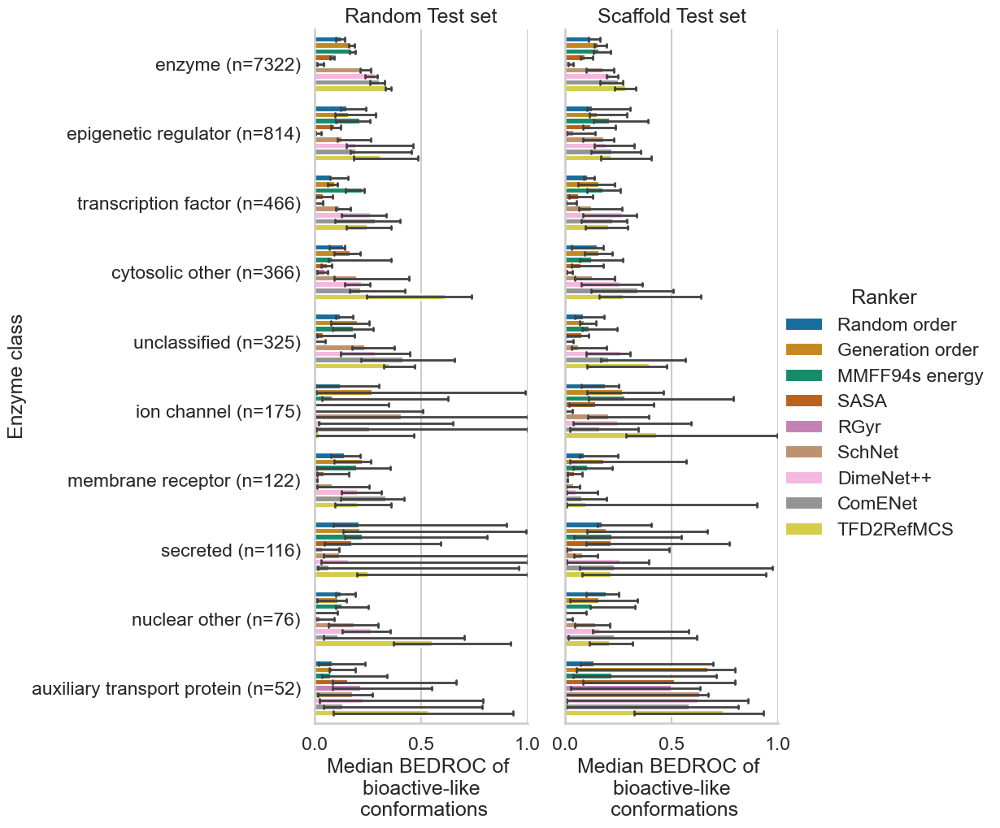

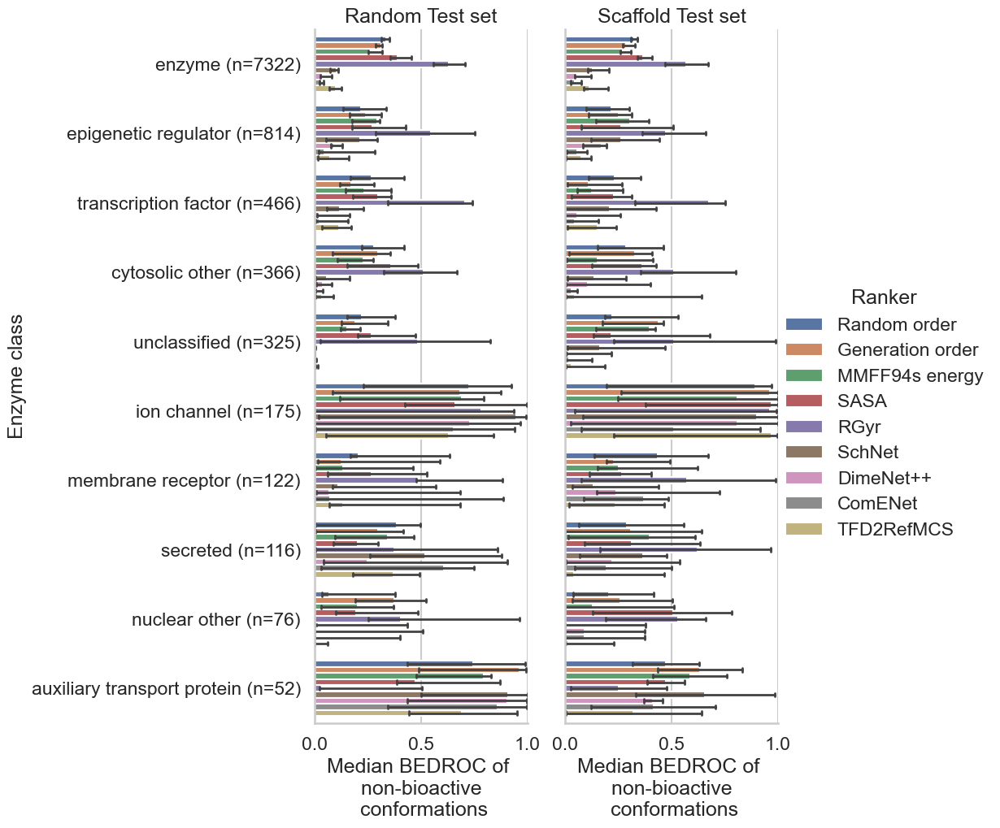

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

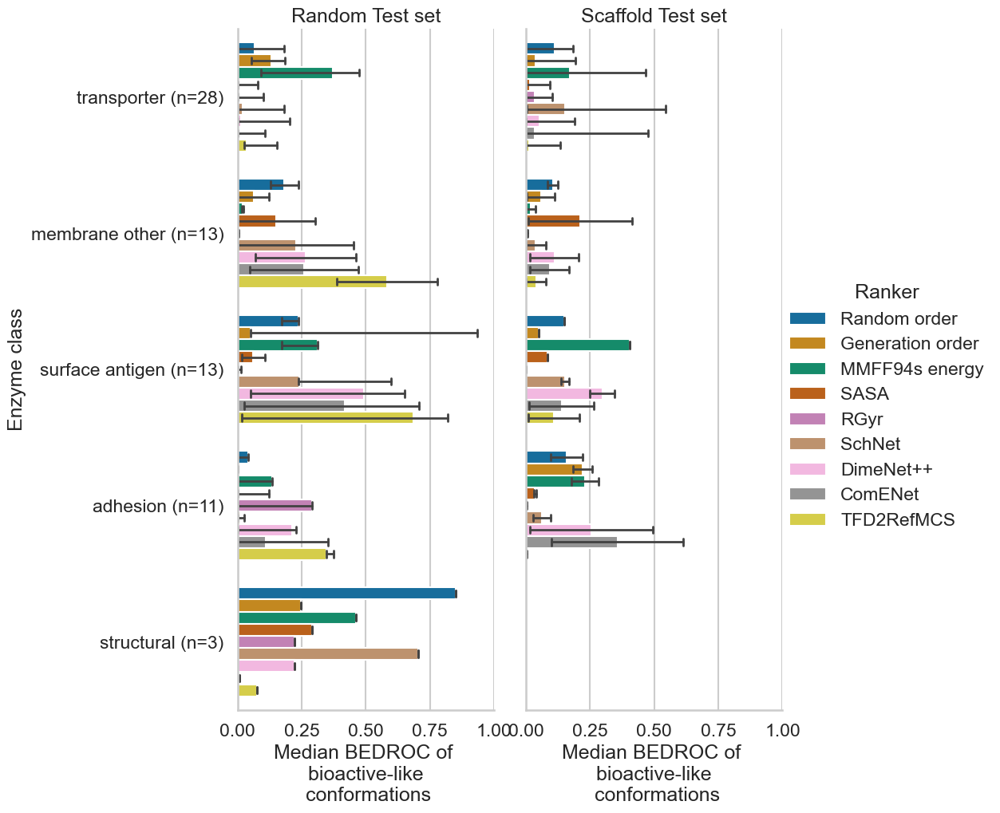

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

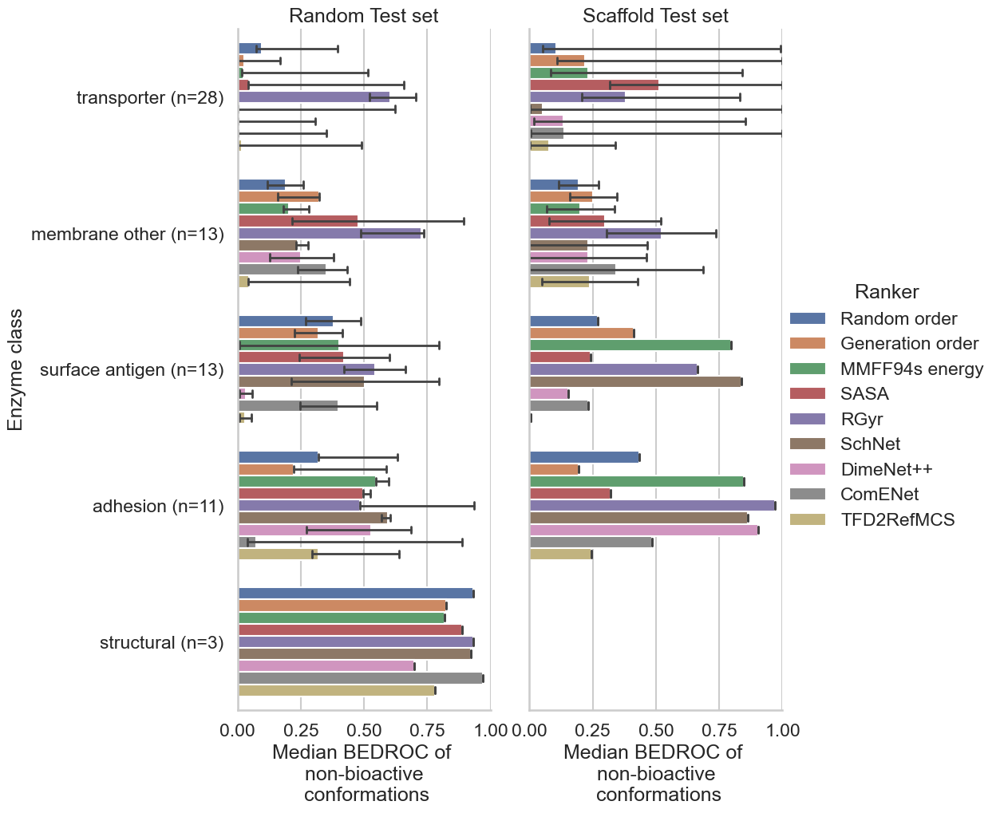

In [63]:
show_plots(target_results_df, vc, figname='protein_class')

In [ ]:
from data.utils.enzyme_connector import ENZYMEConnector
ec = ENZYMEConnector()
enzyme_table = ec.get_table()

In [ ]:
from data.utils.pdbbind import PDBbindMetadataProcessor
pmp = PDBbindMetadataProcessor(root='../hdd/PDBbind')
pdbbind_table = pmp.get_master_dataframe()
pdbbind_table = pdbbind_table[pdbbind_table['PDB code'].isin(pdb_df['pdb_id'])]
pdbbind_table = pdbbind_table.merge(enzyme_table, left_on='Uniprot ID', right_on='uniprot_id')

In [69]:
target_results_df = results_df.merge(pdbbind_table, left_on='PDB ID', right_on='PDB code')

In [47]:
level_str = 'level_1_combined'
grouped_target_results_df = target_results_df.groupby(['Test set', 'Ranker', 'Iteration', level_str], sort=False).median().reset_index().sort_values(level_str, kind='stable')

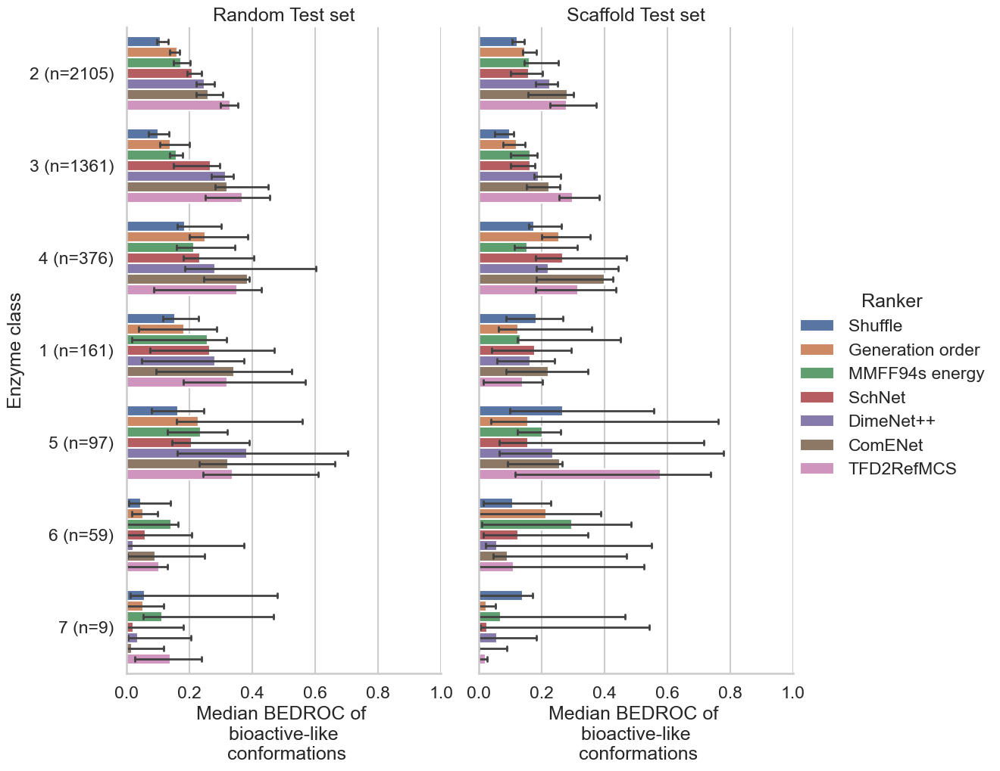

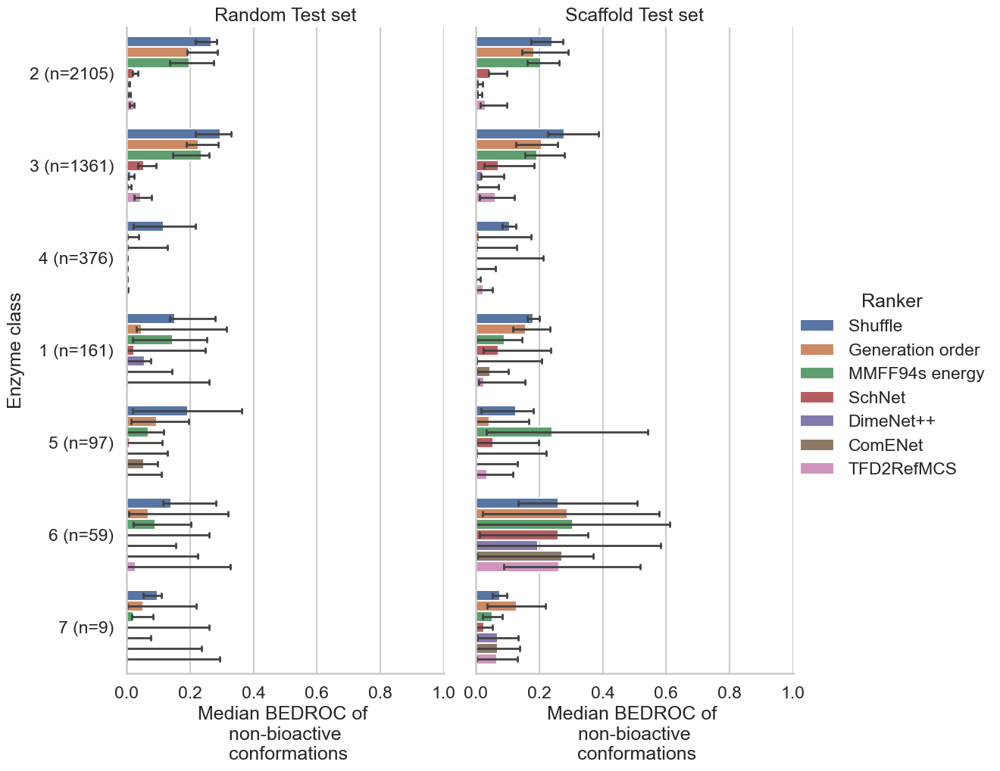

In [95]:
show_plots(target_results_df)

In [50]:
level_str = 'level_2_combined'
# target_results_df = results_df.merge(pdbbind_table, left_on='PDB ID', right_on='PDB code')
# target_results_df = target_results_df[target_results_df['level_1'].isin(['2', '3'])]
grouped_target_results_df = target_results_df.groupby(['Test set', 'Ranker', 'Iteration', level_str], 
                                                      sort=False).median().reset_index().sort_values(level_str, kind='stable')

In [65]:
vc = pdbbind_table[level_str].value_counts()

In [66]:
vc

2.7.11     1691
2.7.7       890
4.2.1       886
2.7.10      773
3.4.21      744
           ... 
1.14.14       1
4.99.1        1
1.20.4        1
7.1.2         1
2.1.4         1
Name: level_3_combined, Length: 134, dtype: int64

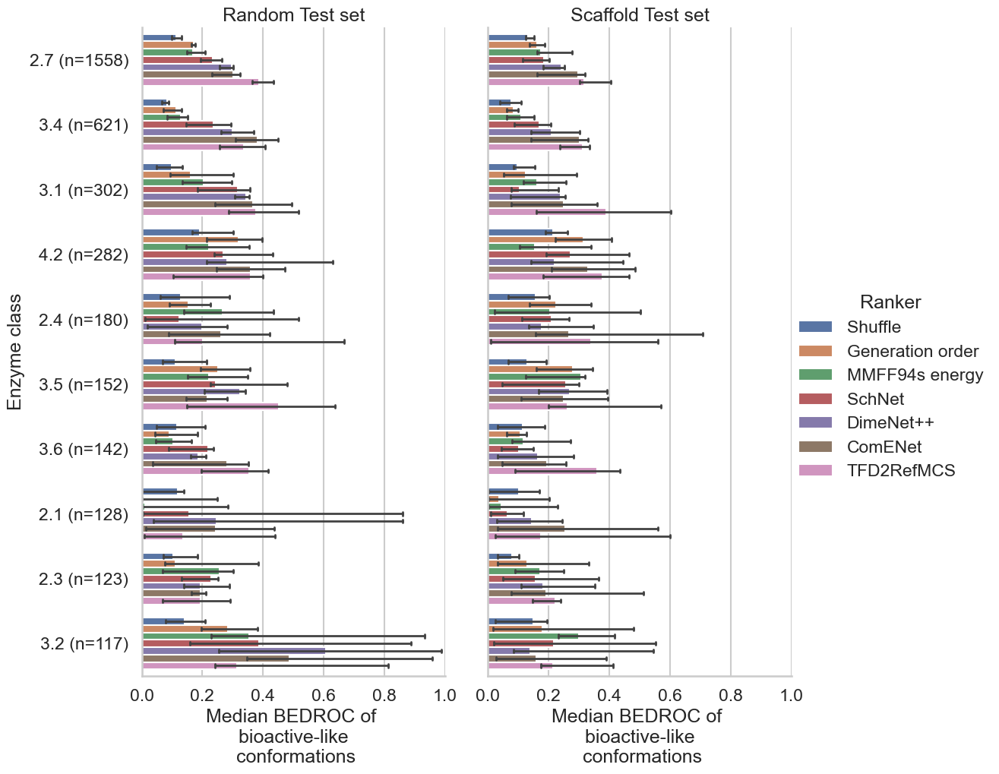

KeyboardInterrupt: 

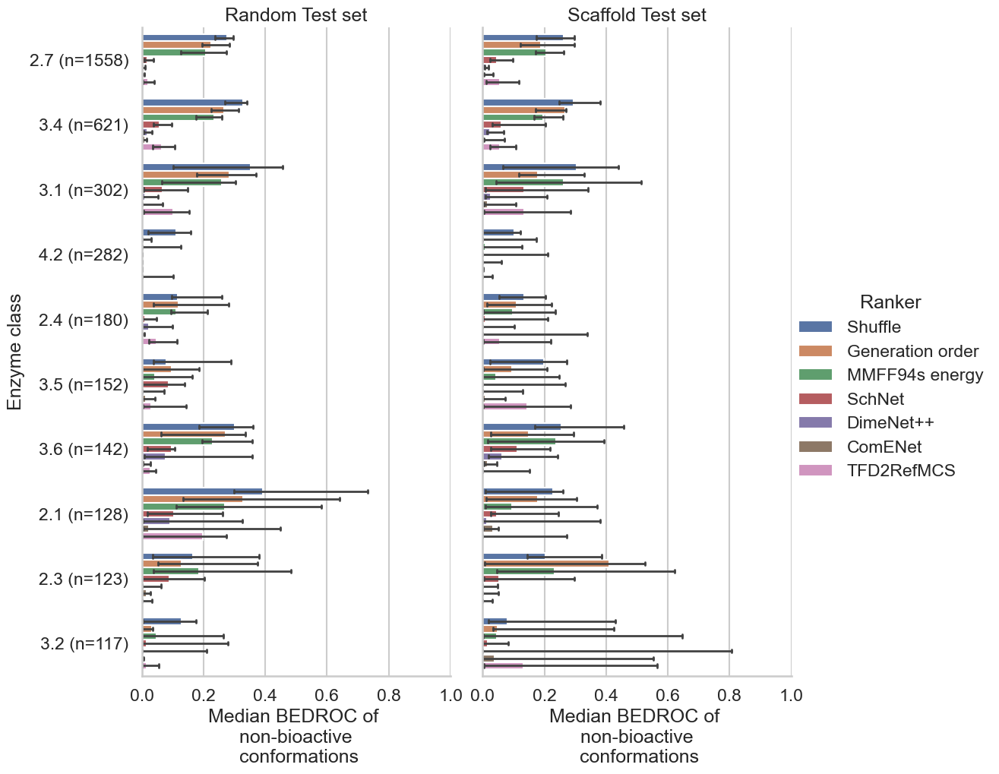

In [222]:
show_plots(target_results_df, figname='enzyme_l2')

In [267]:
level_str

'level_2_combined'

In [274]:
from scipy.stats import ranksums, mannwhitneyu
ecs = ['2.7', '3.4', '3.1', '4.2', '2.4', '3.5', '3.6']
for ec in ecs:
    sample1 = target_results_df[(target_results_df['Ranker'] == 'ComENet')
                               &(target_results_df['Test set'] == 'Random')
                               &(target_results_df[level_str] == ec)]['BEDROC of bioactive-like conformations'].values
    sample2 = target_results_df[(target_results_df['Ranker'] == 'MMFF94s energy')
                               &(target_results_df['Test set'] == 'Random')
                               &(target_results_df[level_str] == ec)]['BEDROC of bioactive-like conformations'].values
    print(ranksums(sample1, sample2))
    print(mannwhitneyu(sample1, sample2))

RanksumsResult(statistic=8.132618711234402, pvalue=4.2011444664648847e-16)
MannwhitneyuResult(statistic=1372631.5, pvalue=4.0817901242069003e-16)
RanksumsResult(statistic=9.538413531919325, pvalue=1.4503394331290111e-21)
MannwhitneyuResult(statistic=229148.0, pvalue=1.376004685816199e-21)
RanksumsResult(statistic=5.503589097115863, pvalue=3.7213632569091275e-08)
MannwhitneyuResult(statistic=96588.5, pvalue=3.633828898619293e-08)
RanksumsResult(statistic=3.5241200460450637, pvalue=0.0004248917022419102)
MannwhitneyuResult(statistic=74634.0, pvalue=0.0004232439909520653)
RanksumsResult(statistic=-0.5528730187183369, pvalue=0.5803503641418901)
MannwhitneyuResult(statistic=7864.5, pvalue=0.5806619485509634)
RanksumsResult(statistic=-0.5463350569750947, pvalue=0.5848356425184413)
MannwhitneyuResult(statistic=6675.5, pvalue=0.5854083889501951)
RanksumsResult(statistic=2.976225238107656, pvalue=0.0029182044691514262)
MannwhitneyuResult(statistic=21452.0, pvalue=0.002882713523995145)


<AxesSubplot:ylabel='Count'>

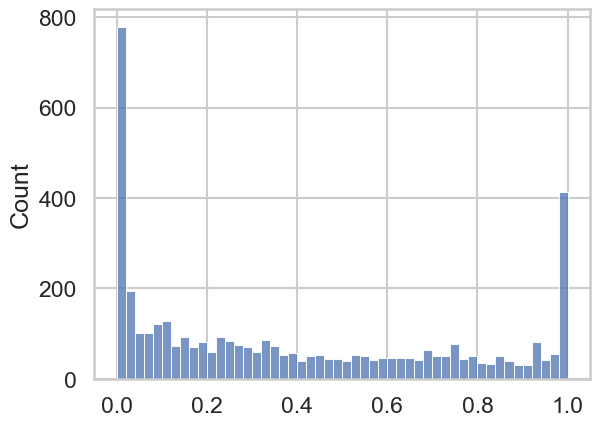

In [261]:
sns.histplot(sample1, bins=50)

<AxesSubplot:ylabel='Count'>

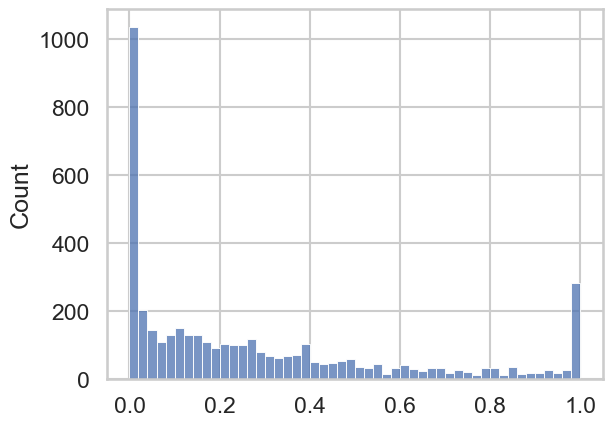

In [262]:
sns.histplot(sample2, bins=50)

In [250]:
vc = target_results_df.drop_duplicates('PDB ID').value_counts(level_str)
vc.name = 'Value_count'
order = ['Shuffle',
    'Generation order',
      'MMFF94s energy',
              'SchNet',
           'DimeNet++',
             'ComENet',
         'TFD2RefMCS']
test = grouped_target_results_df.pivot_table(index=['Test set', 'Iteration', level_str], 
               columns='Ranker',
               values='BEDROC of bioactive-like conformations',
                aggfunc='median')[order].reset_index()
test['C-M'] = test['ComENet'] - test['MMFF94s energy']

testbis = grouped_target_results_df.pivot_table(index=['Test set', 'Iteration', level_str], 
               columns='Ranker',
               values='MCS to training size',
                aggfunc=lambda l: np.quantile(l, 0.75)).reset_index()

test2 = test.groupby(['Test set', level_str],
                     sort=False).median().reset_index()

test2bis = testbis.groupby(['Test set', level_str],
                           sort=False).median().reset_index()

test3 = test2.reset_index().merge(pd.DataFrame(vc), on=level_str)
test3 = test3.merge(test2bis, on=['Test set', level_str]).sort_values('Value_count', ascending=False)

In [224]:
test3.head()

,index,Test set,level_2_combined,Iteration_x,Shuffle,Generation order,MMFF94s energy,SchNet,DimeNet++,ComENet,TFD2RefMCS_x,C-M,0,Iteration_y,TFD2RefMCS_y
19,10,Random,2.7,2.0,0.1135,0.171,0.1700,0.2345,0.2970,0.301,0.3870,0.1000,1558,2.0,21.0
20,50,Scaffold,2.7,2.0,0.1310,0.163,0.1740,0.1840,0.2430,0.297,0.3160,0.1310,1558,2.0,20.0
30,56,Scaffold,3.4,2.0,0.0780,0.084,0.1085,0.1690,0.2105,0.303,0.3125,0.2140,621,2.0,21.0
29,15,Random,3.4,2.0,0.0850,0.113,0.1285,0.2370,0.3000,0.381,0.3370,0.2525,621,2.0,21.0
23,12,Random,3.1,2.0,0.1000,0.161,0.2035,0.3170,0.3450,0.366,0.3775,0.1680,302,2.0,19.0


<AxesSubplot:xlabel='C-M', ylabel='0'>

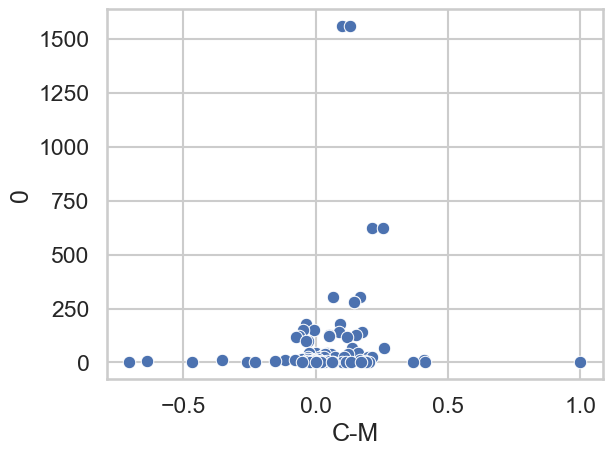

In [225]:
sns.scatterplot(data=test3,
               x='C-M',
               y='Value_count')

In [240]:
test3.iloc[:20]

,index,Test set,level_2_combined,Iteration_x,Shuffle,Generation order,MMFF94s energy,SchNet,DimeNet++,ComENet,TFD2RefMCS_x,C-M,0,Iteration_y,TFD2RefMCS_y
19,10,Random,2.7,2.0,0.1135,0.1710,0.1700,0.2345,0.2970,0.3010,0.3870,0.1000,1558,2.0,21.0
20,50,Scaffold,2.7,2.0,0.1310,0.1630,0.1740,0.1840,0.2430,0.2970,0.3160,0.1310,1558,2.0,20.0
30,56,Scaffold,3.4,2.0,0.0780,0.0840,0.1085,0.1690,0.2105,0.3030,0.3125,0.2140,621,2.0,21.0
29,15,Random,3.4,2.0,0.0850,0.1130,0.1285,0.2370,0.3000,0.3810,0.3370,0.2525,621,2.0,21.0
23,12,Random,3.1,2.0,0.1000,0.1610,0.2035,0.3170,0.3450,0.3660,0.3775,0.1680,302,2.0,19.0
24,52,Scaffold,3.1,2.0,0.0980,0.1250,0.1630,0.1040,0.2390,0.2500,0.3890,0.0670,302,2.0,17.0
37,19,Random,4.2,2.0,0.1920,0.3200,0.2220,0.2700,0.2820,0.3600,0.3580,0.1460,282,2.0,16.0
38,60,Scaffold,4.2,2.0,0.2140,0.3150,0.1540,0.2710,0.2200,0.3290,0.3770,0.1440,282,2.0,15.0
15,8,Random,2.4,2.0,0.1290,0.1550,0.2670,0.1230,0.1990,0.2615,0.2020,-0.0350,180,2.0,16.5
16,48,Scaffold,2.4,2.0,0.1560,0.2250,0.2050,0.2100,0.1760,0.2670,0.3405,0.0900,180,2.0,18.0


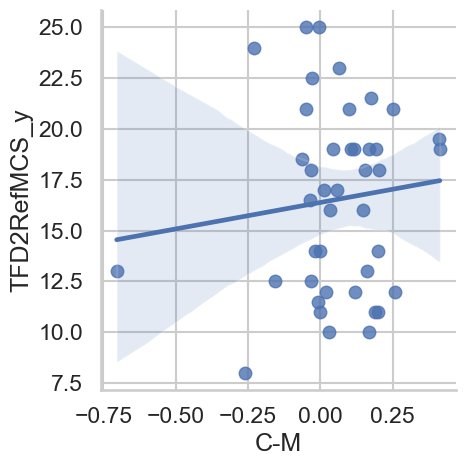

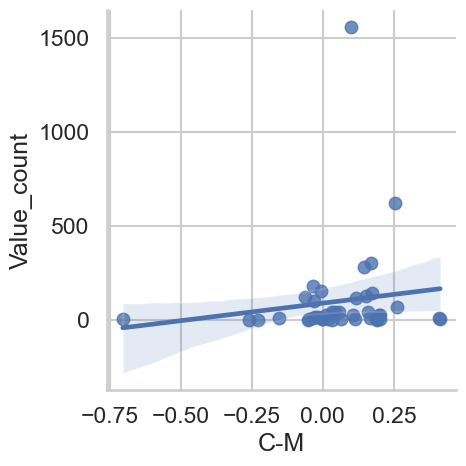

In [253]:
sns.lmplot(data=test3[test3['Test set'] == 'Random'],
               x='C-M',
               y='TFD2RefMCS_y',)
plt.show()
sns.lmplot(data=test3[test3['Test set'] == 'Random'],
               x='C-M',
               y='Value_count')

In [171]:
test = grouped_target_results_df.groupby(['Test set', 'Ranker', level_str],
                                                 sort=False).median().reset_index()
vc = target_results_df.drop_duplicates('PDB ID').value_counts(level_str)
order = ['Shuffle',
    'Generation order',
      'MMFF94s energy',
              'SchNet',
           'DimeNet++',
             'ComENet',
         'TFD2RefMCS']
test2 = test.pivot_table(index=['Test set', level_str], 
               columns='Ranker',
               values='BEDROC of bioactive-like conformations',
                aggfunc='first')[order]
testbis = grouped_target_results_df.groupby(['Test set', 'Ranker', level_str],
                                                 sort=False).median().reset_index()
test2bis = testbis.pivot_table(index=['Test set', level_str], 
               columns='Ranker',
               values='MCS to training size',
                aggfunc='median')

test3 = test2.reset_index().merge(pd.DataFrame(vc), on=level_str)
test3 = test3.merge(test2bis, on=['Test set', level_str]).sort_values(0, ascending=False)

In [117]:
test3['C-M'] = test3['ComENet'] - test3['MMFF94s energy']

In [116]:
test3.iloc[:20]

,Test set,level_3_combined,Shuffle,Generation order,MMFF94s energy,SchNet,DimeNet++,ComENet,TFD2RefMCS_x,0,TFD2RefMCS_y
52,Scaffold,2.7.11,0.1490,0.1970,0.2270,0.2070,0.2210,0.3180,0.3920,783,19.0
51,Random,2.7.11,0.1330,0.1900,0.1700,0.2160,0.2800,0.3010,0.3725,783,20.0
50,Scaffold,2.7.10,0.1160,0.1535,0.1595,0.1230,0.2730,0.2220,0.3855,433,23.0
49,Random,2.7.10,0.1030,0.1530,0.1580,0.2080,0.2710,0.2145,0.4370,433,24.0
133,Random,4.2.1,0.1910,0.3200,0.2140,0.2700,0.2630,0.3200,0.3370,272,16.0
134,Scaffold,4.2.1,0.2140,0.3150,0.1540,0.2710,0.2200,0.3290,0.3770,272,15.0
103,Scaffold,3.4.21,0.0835,0.0770,0.1470,0.2230,0.2445,0.3735,0.3520,252,22.0
102,Random,3.4.21,0.1160,0.0770,0.1415,0.3030,0.3460,0.3815,0.4030,252,25.0
63,Scaffold,2.7.7,0.0960,0.0770,0.2430,0.1120,0.2070,0.2450,0.2260,175,19.0
62,Random,2.7.7,0.0980,0.1620,0.2230,0.3270,0.3770,0.3385,0.4240,175,21.5


In [233]:
test = grouped_target_results_df.groupby(['Test set', 'Ranker', level_str],
                                                 sort=False).agg(custom_agg).reset_index()
vc = target_results_df.drop_duplicates('PDB ID').value_counts(level_str)
order = ['Shuffle',
    'Generation order',
      'MMFF94s energy',
              'SchNet',
           'DimeNet++',
             'ComENet',
         'TFD2RefMCS']
test2 = test.pivot_table(index=['Test set', level_str], 
               columns='Ranker',
               values='BEDROC of bioactive-like conformations',
                aggfunc='first')[order]
testbis = grouped_target_results_df.groupby(['Test set', 'Ranker', level_str],
                                                 sort=False).median().reset_index()
test2bis = testbis.pivot_table(index=['Test set', level_str], 
               columns='Ranker',
               values='MCS to training size',
                aggfunc='median')

test3 = test2.reset_index().merge(pd.DataFrame(vc), on=level_str)
test3 = test3.merge(test2bis, on=['Test set', level_str]).sort_values(0, ascending=False)

In [235]:
test3[test3[level_str].isin(vc.index[:10])]

,Test set,level_2_combined,Shuffle,Generation order,MMFF94s energy,SchNet,DimeNet++,ComENet,TFD2RefMCS_x,0,TFD2RefMCS_y
29,Random,2.7,0.12 ± 0.01,0.17 ± 0.01,0.17 ± 0.02,0.23 ± 0.03,0.28 ± 0.02,0.29 ± 0.04,0.4 ± 0.03,1558,21.0
30,Scaffold,2.7,0.13 ± 0.01,0.16 ± 0.02,0.19 ± 0.05,0.17 ± 0.03,0.23 ± 0.03,0.27 ± 0.07,0.35 ± 0.05,1558,20.0
40,Scaffold,3.4,0.08 ± 0.02,0.08 ± 0.02,0.11 ± 0.04,0.16 ± 0.05,0.23 ± 0.07,0.26 ± 0.08,0.3 ± 0.04,621,21.0
39,Random,3.4,0.08 ± 0.01,0.1 ± 0.03,0.12 ± 0.03,0.23 ± 0.05,0.31 ± 0.04,0.37 ± 0.05,0.34 ± 0.06,621,21.0
33,Random,3.1,0.1 ± 0.03,0.18 ± 0.08,0.21 ± 0.06,0.29 ± 0.07,0.34 ± 0.02,0.36 ± 0.09,0.4 ± 0.1,302,19.0
34,Scaffold,3.1,0.11 ± 0.03,0.15 ± 0.09,0.18 ± 0.07,0.12 ± 0.06,0.19 ± 0.08,0.22 ± 0.1,0.37 ± 0.18,302,17.0
48,Scaffold,4.2,0.22 ± 0.03,0.31 ± 0.08,0.19 ± 0.1,0.3 ± 0.1,0.25 ± 0.11,0.34 ± 0.11,0.33 ± 0.12,282,15.0
47,Random,4.2,0.21 ± 0.05,0.3 ± 0.08,0.24 ± 0.08,0.32 ± 0.09,0.36 ± 0.17,0.36 ± 0.08,0.31 ± 0.12,282,16.0
24,Scaffold,2.4,0.14 ± 0.05,0.22 ± 0.08,0.23 ± 0.17,0.2 ± 0.06,0.21 ± 0.09,0.34 ± 0.21,0.33 ± 0.24,180,18.0
23,Random,2.4,0.17 ± 0.1,0.15 ± 0.05,0.28 ± 0.12,0.18 ± 0.2,0.16 ± 0.11,0.27 ± 0.15,0.27 ± 0.23,180,16.5


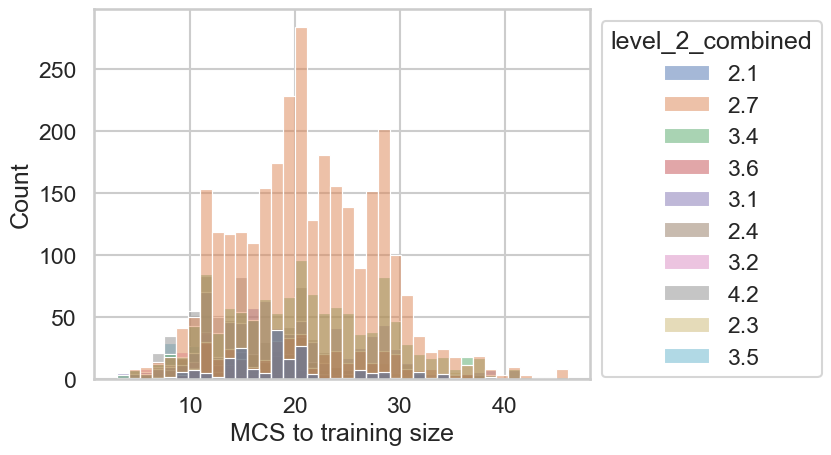

In [229]:
ax = sns.histplot(data=target_results_df[target_results_df[level_str].isin(vc.index[:10])],
           x='MCS to training size',
           hue=level_str,
           common_norm=False)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

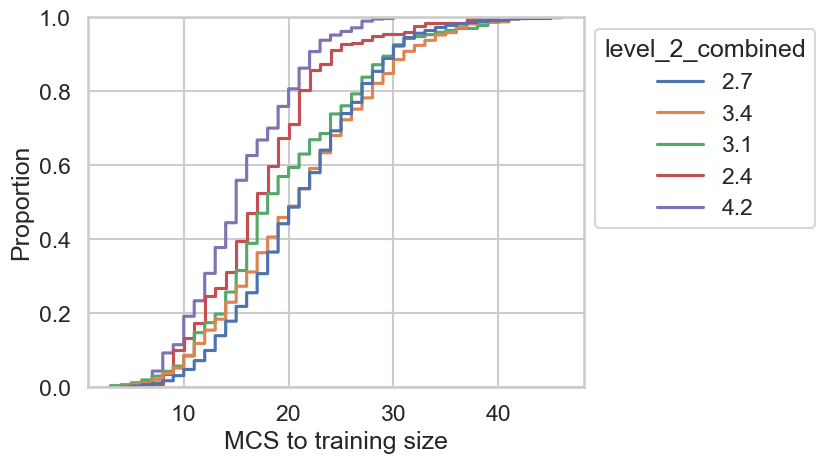

In [232]:
ax = sns.ecdfplot(data=target_results_df[target_results_df[level_str].isin(vc.index[:5])],
           x='MCS to training size',
           hue=level_str)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

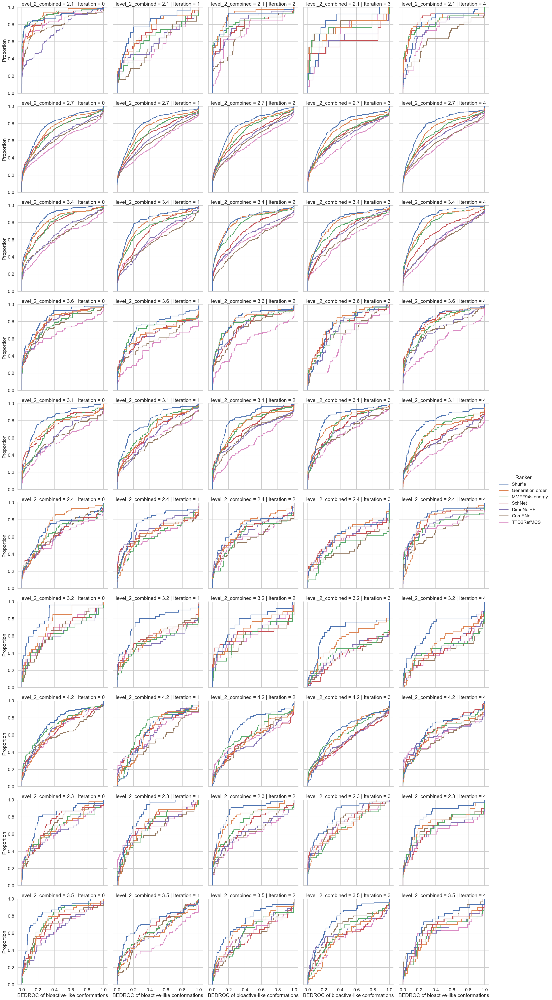

In [231]:
sns.displot(data=target_results_df[target_results_df[level_str].isin(vc.index[:10])],
           x='BEDROC of bioactive-like conformations',
           hue='Ranker',
            row=level_str,
            col='Iteration',
           kind='ecdf')
# sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [68]:
level_str = 'level_3_combined'
# target_results_df = results_df.merge(pdbbind_table, left_on='PDB ID', right_on='PDB code')
# target_results_df = target_results_df[target_results_df['level_2'].isin(['3.4', '2.7', '3.1', '3.6'])]
grouped_target_results_df = target_results_df.groupby(['Test set', 'Ranker', 'Iteration', level_str], sort=False).median().reset_index().sort_values(level_str, kind='stable')

In [69]:
vc = pdbbind_table[level_str].value_counts()

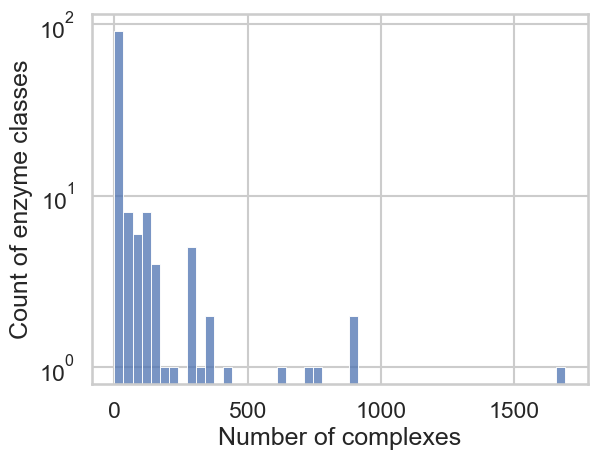

In [70]:
sns.histplot(vc, bins=50)
plt.yscale('log')
plt.xlabel('Number of complexes')
plt.ylabel('Count of enzyme classes')
plt.savefig(os.path.join(figure_dir, 'enzyme_class_distrib'), dpi=300, bbox_inches='tight')

In [71]:
vc

2.7.11     1691
2.7.7       890
4.2.1       886
2.7.10      773
3.4.21      744
           ... 
1.7.5         1
3.13.2        1
4.3.2         1
1.14.13       1
2.8.4         1
Name: level_3_combined, Length: 134, dtype: int64

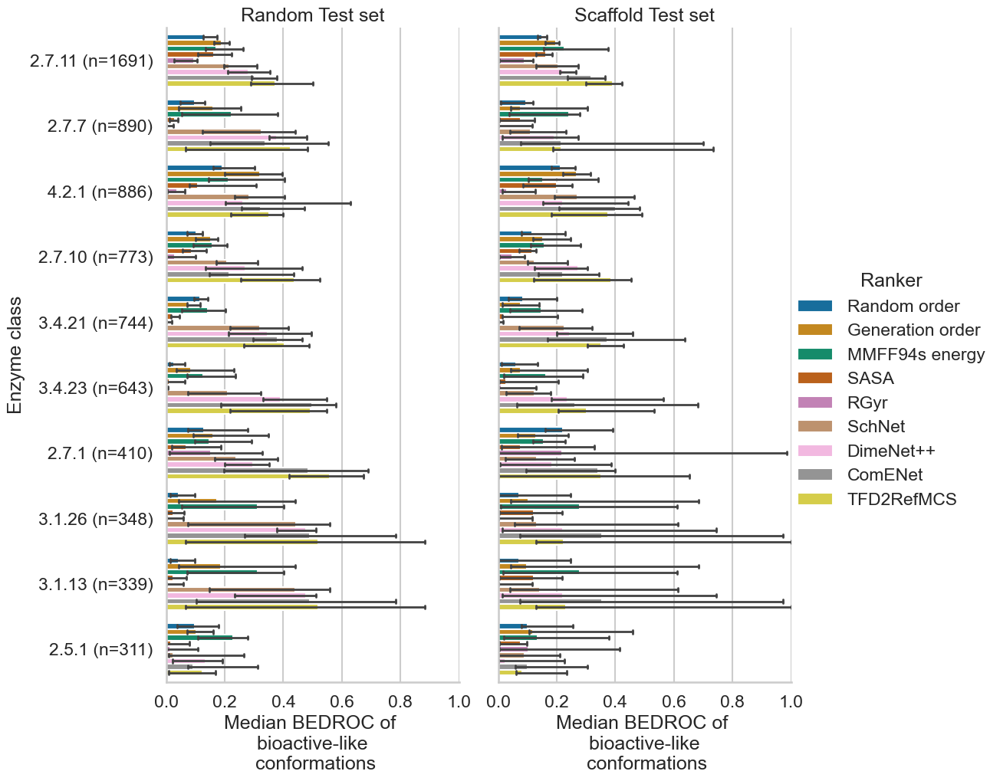

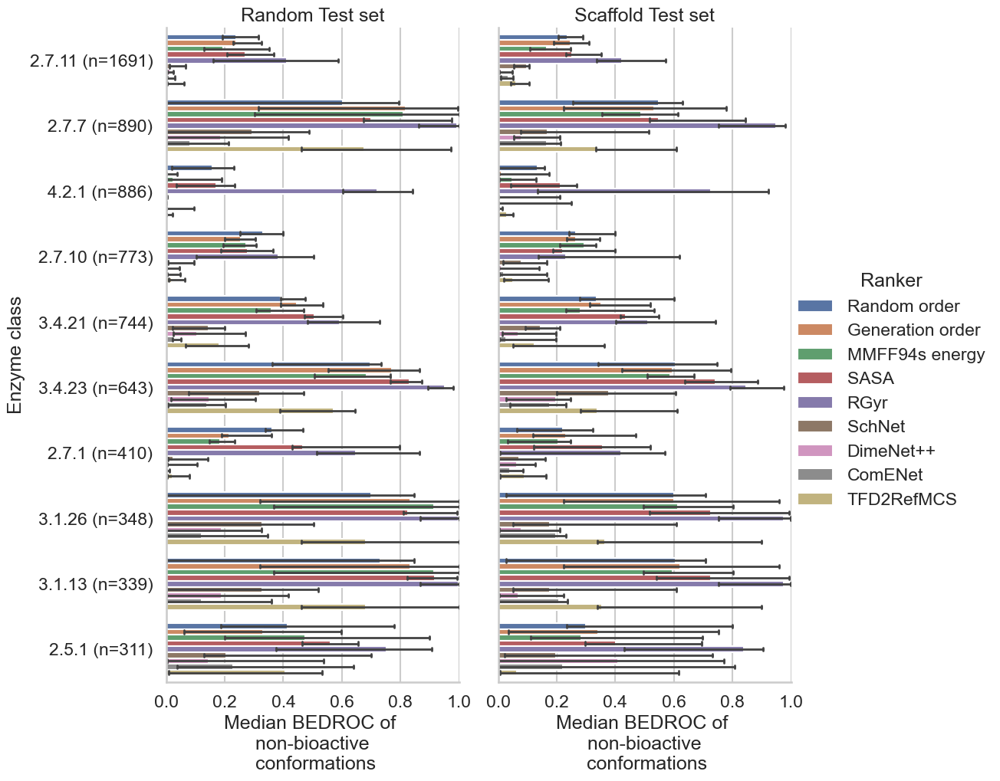

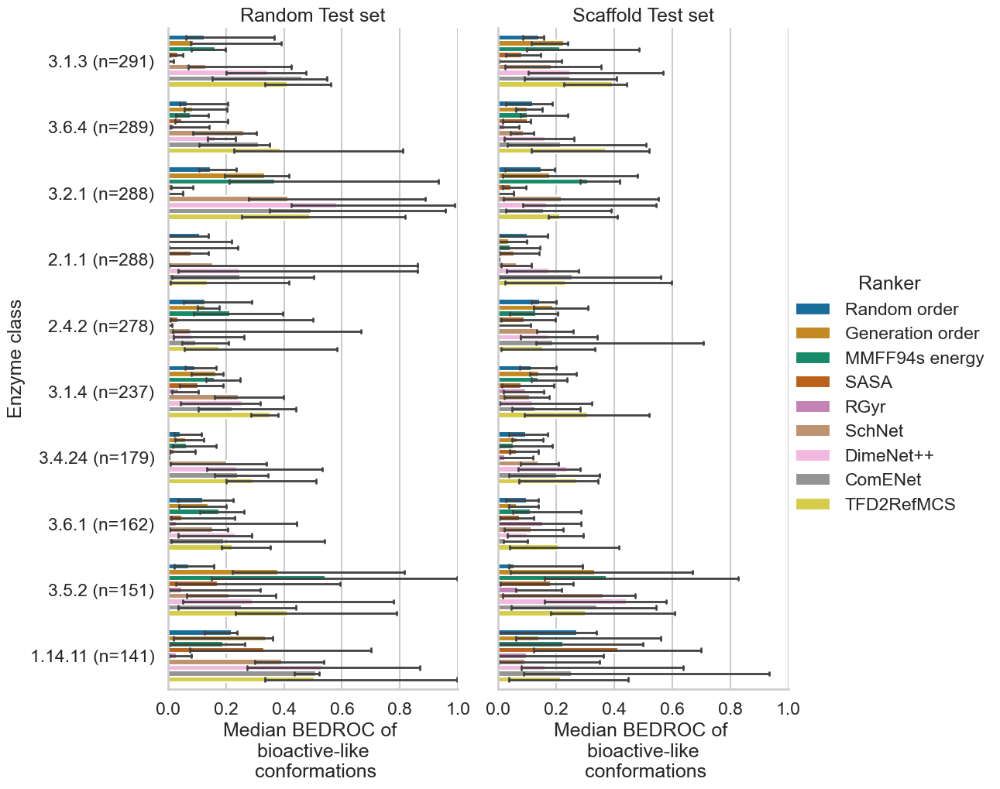

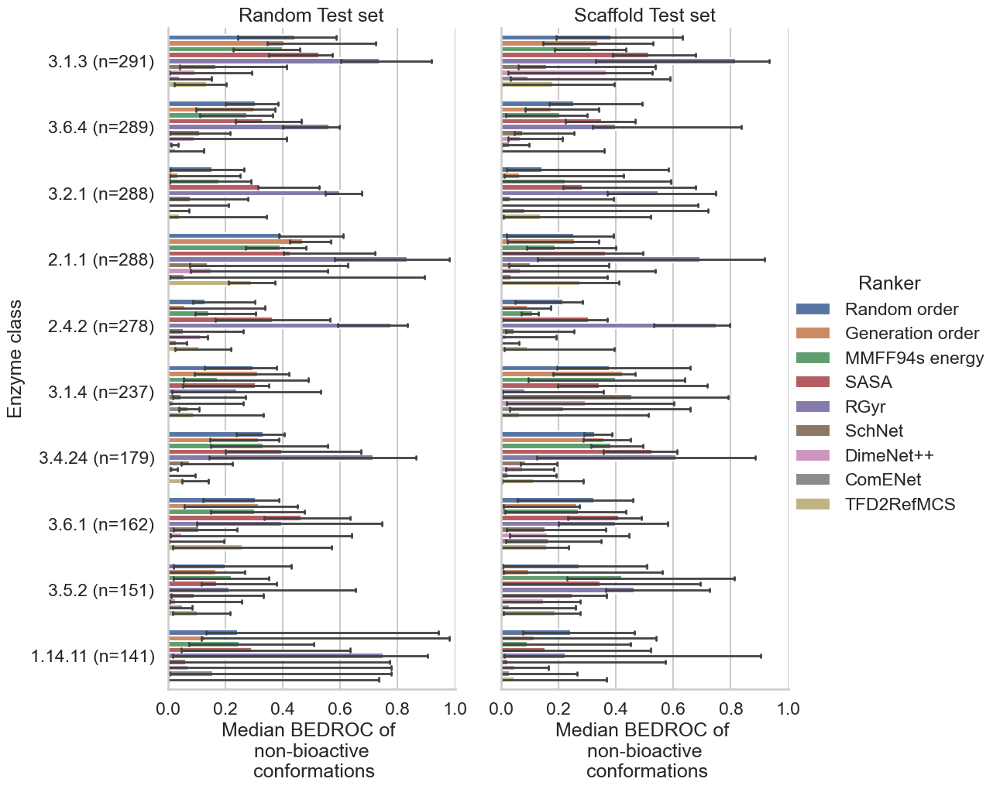

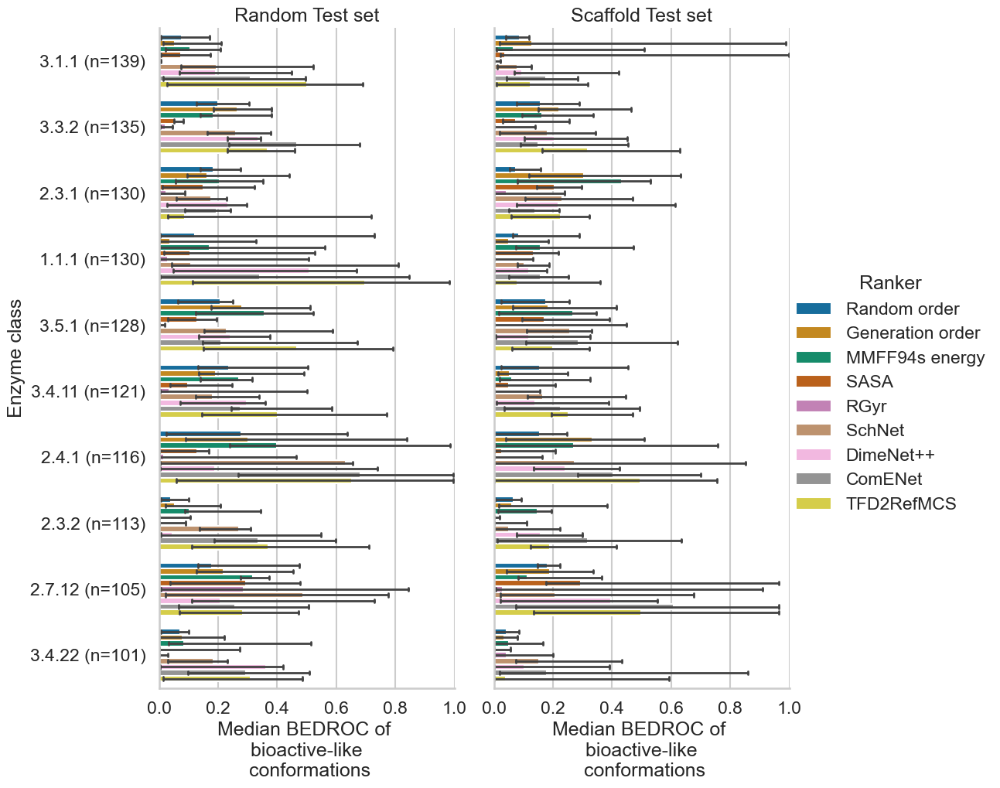

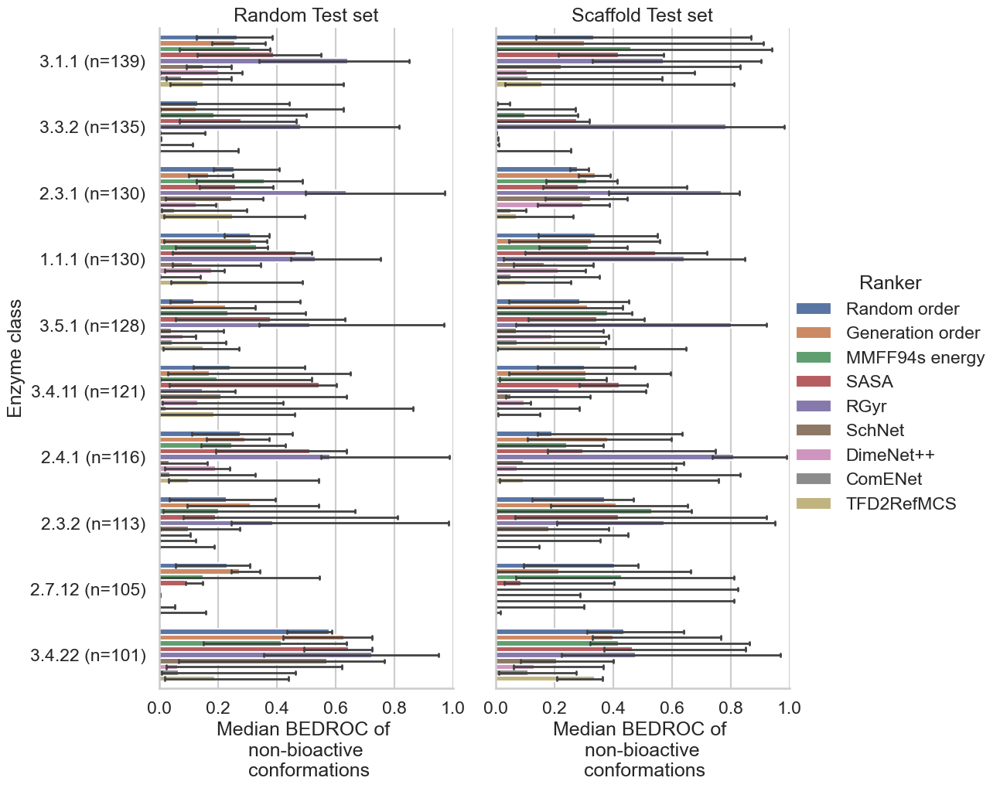

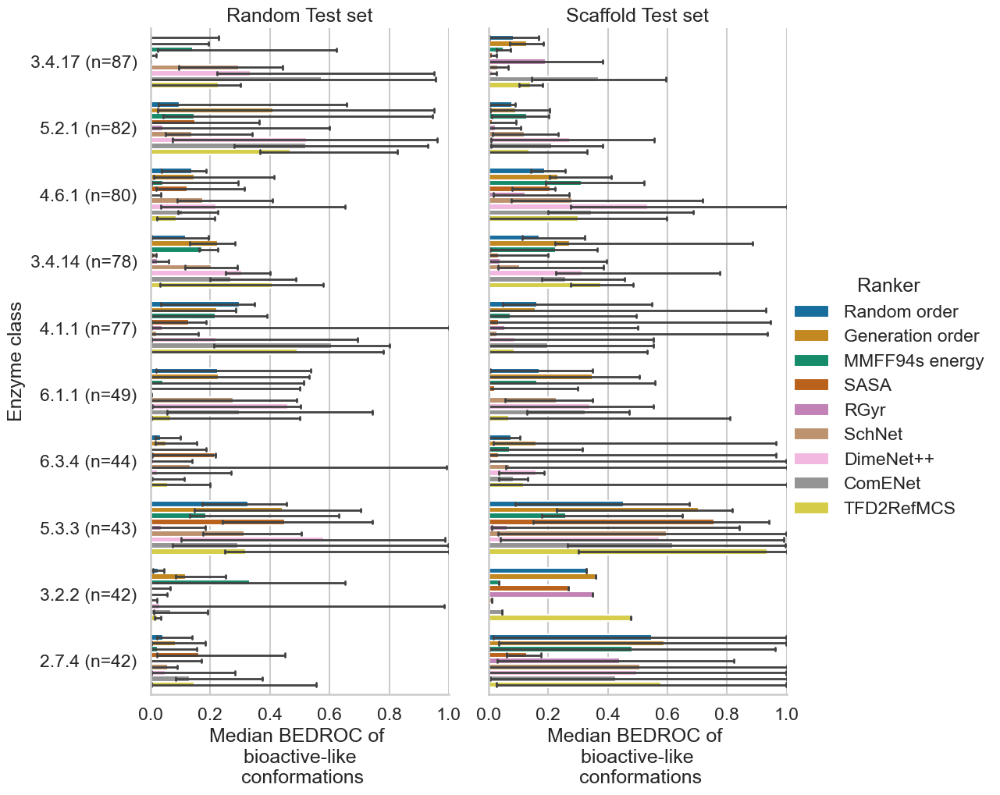

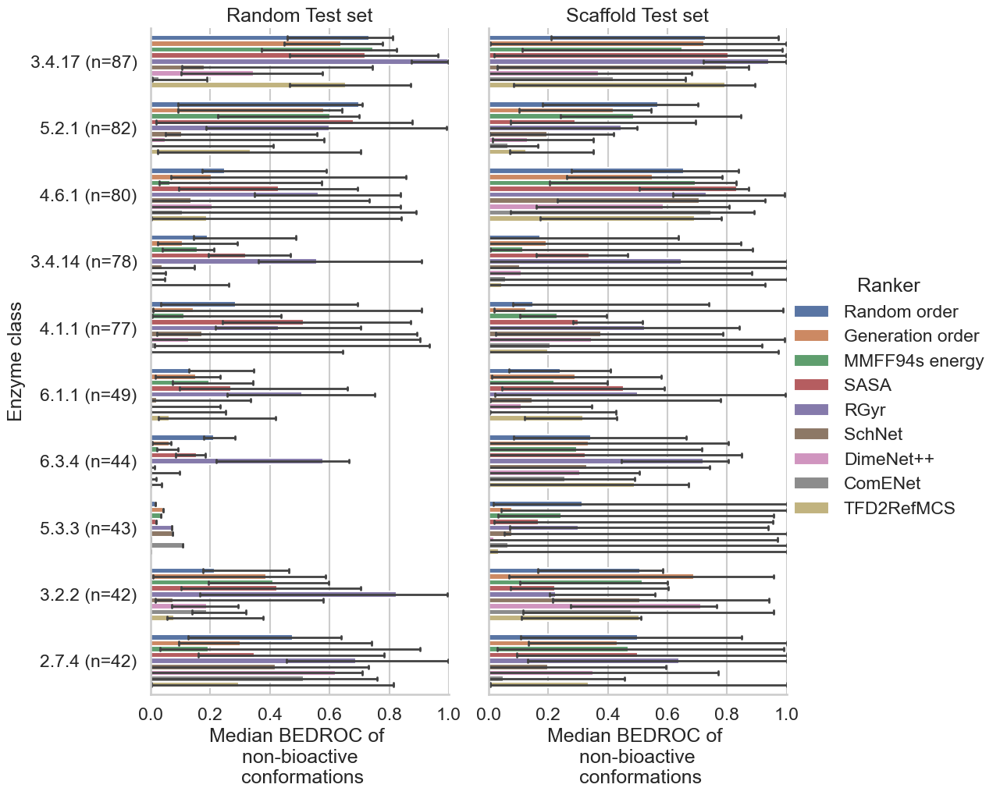

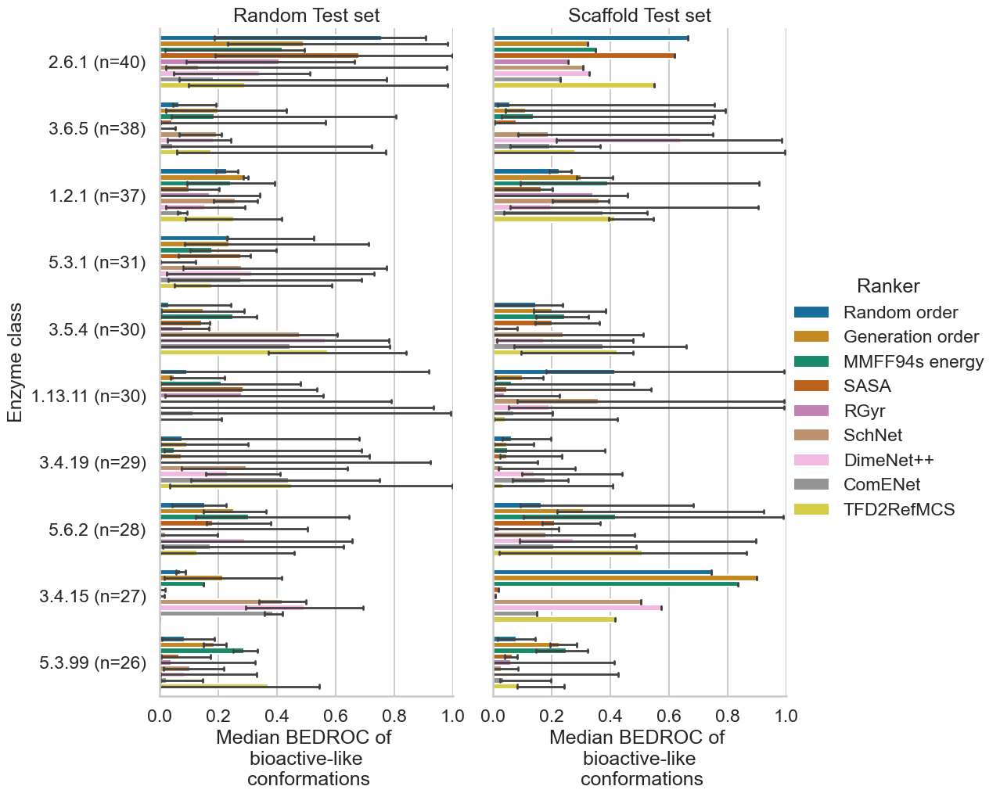

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

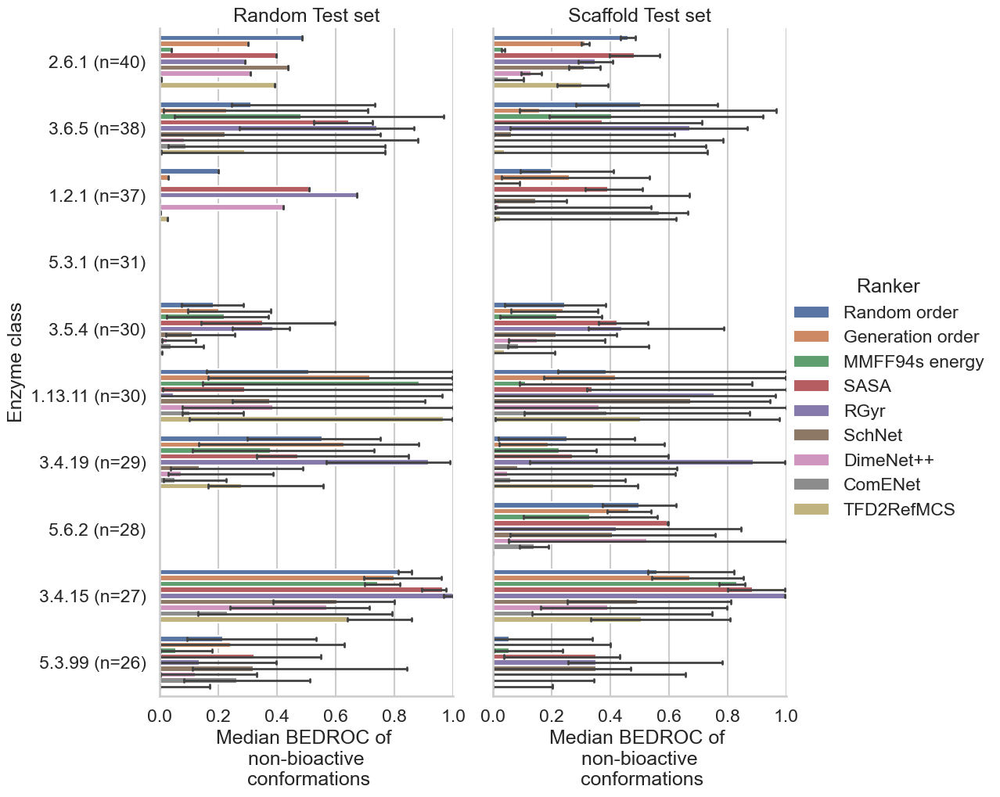

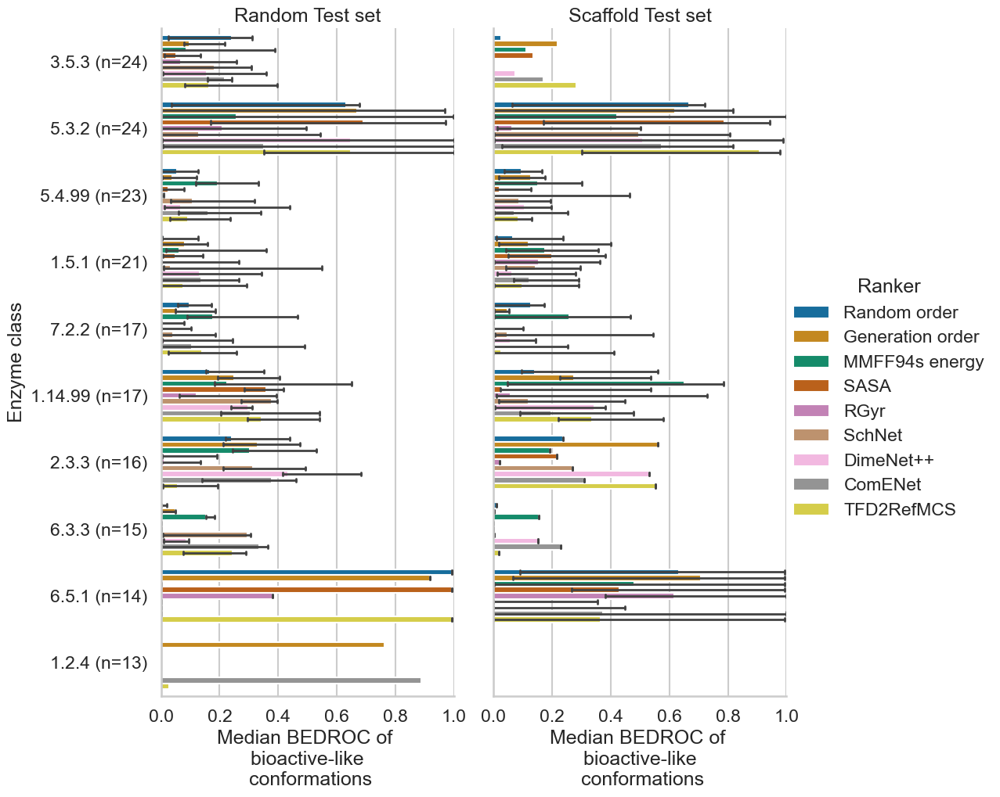

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/b

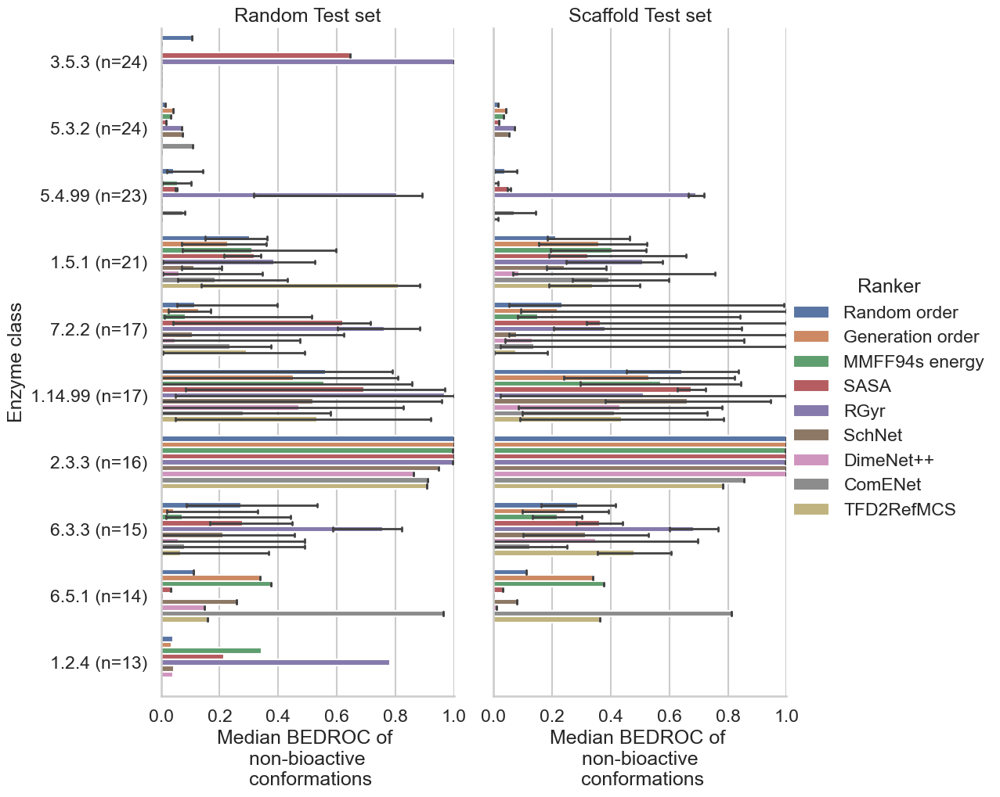

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

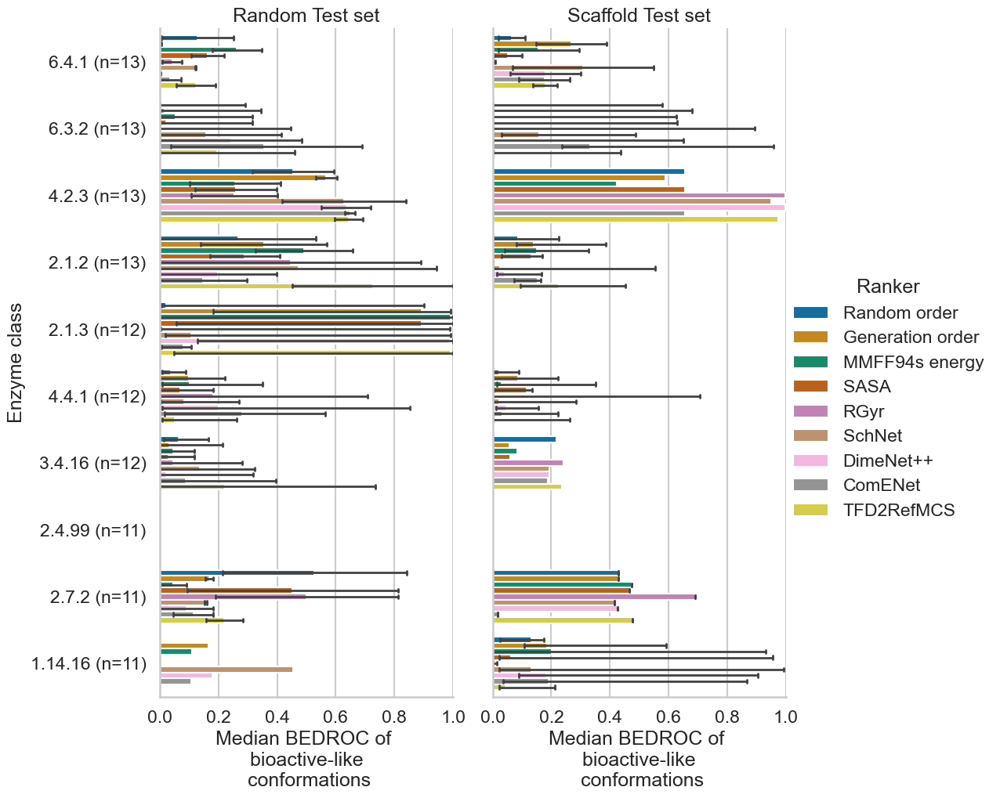

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

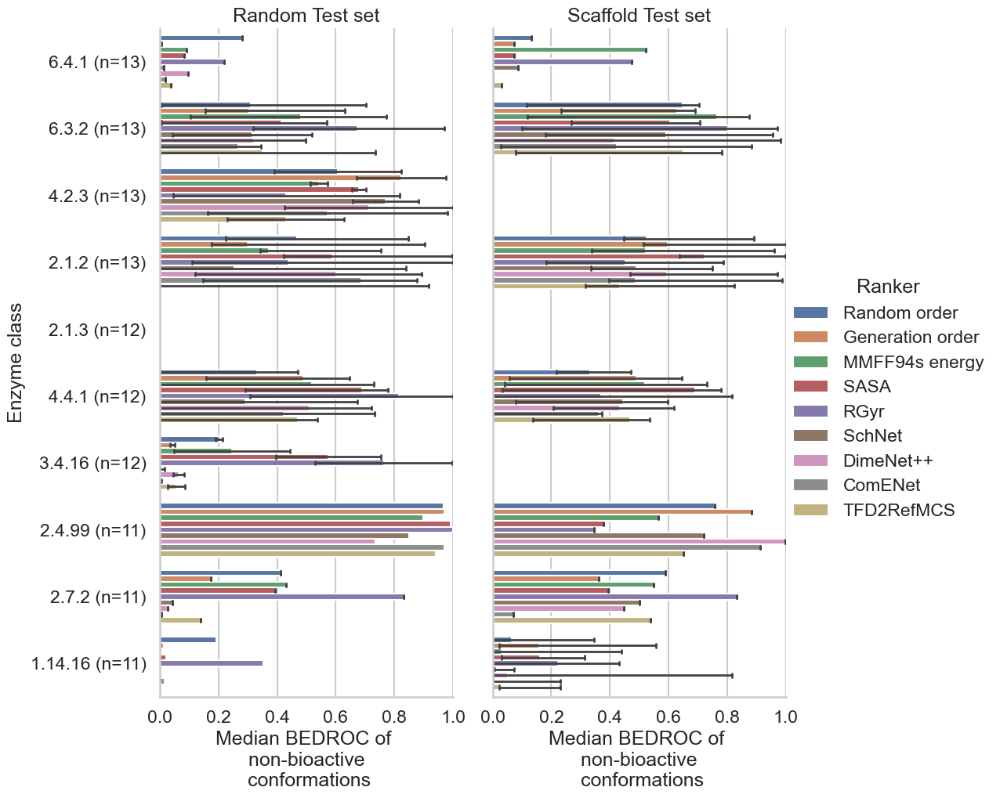

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

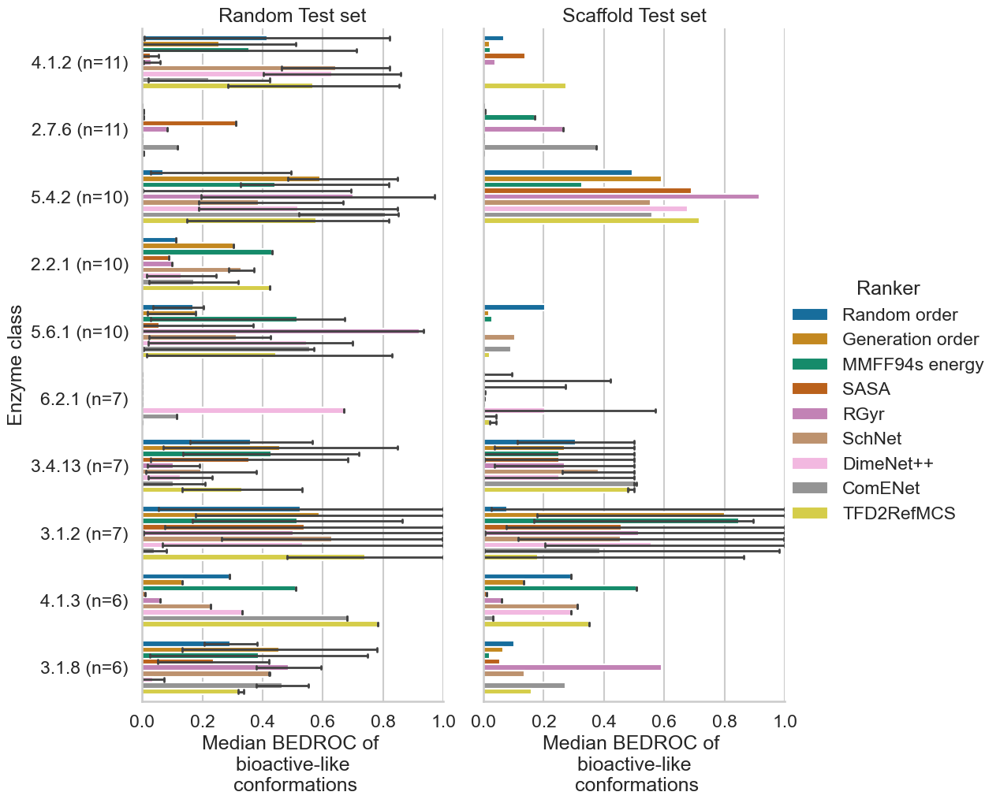

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

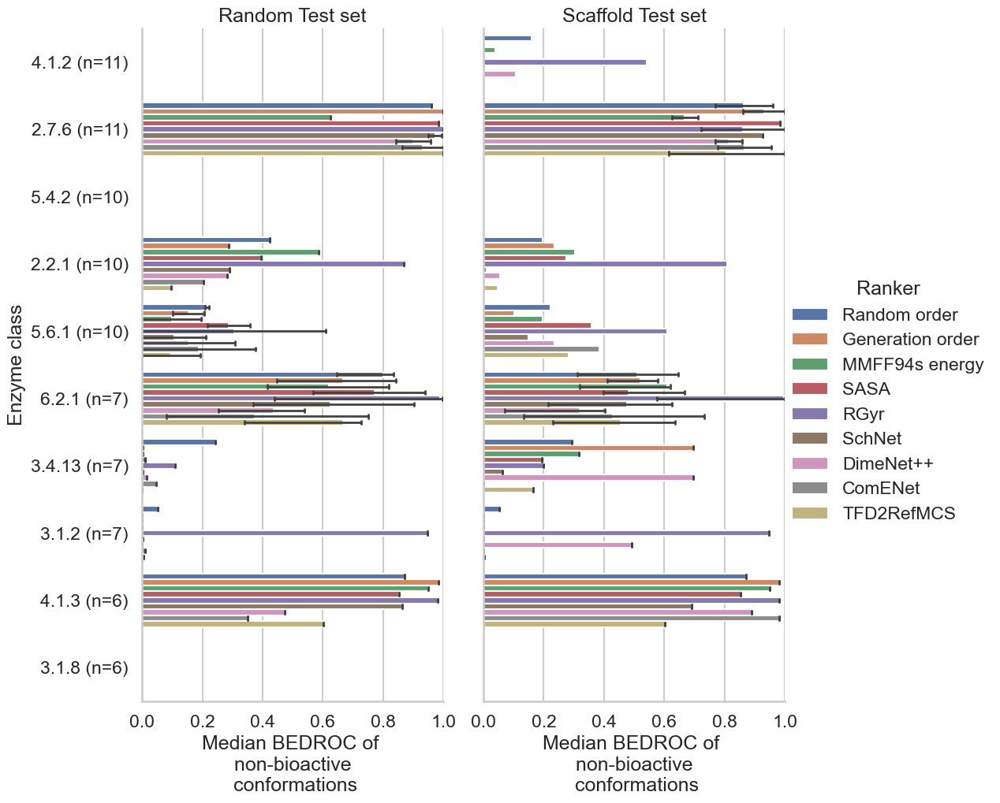

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

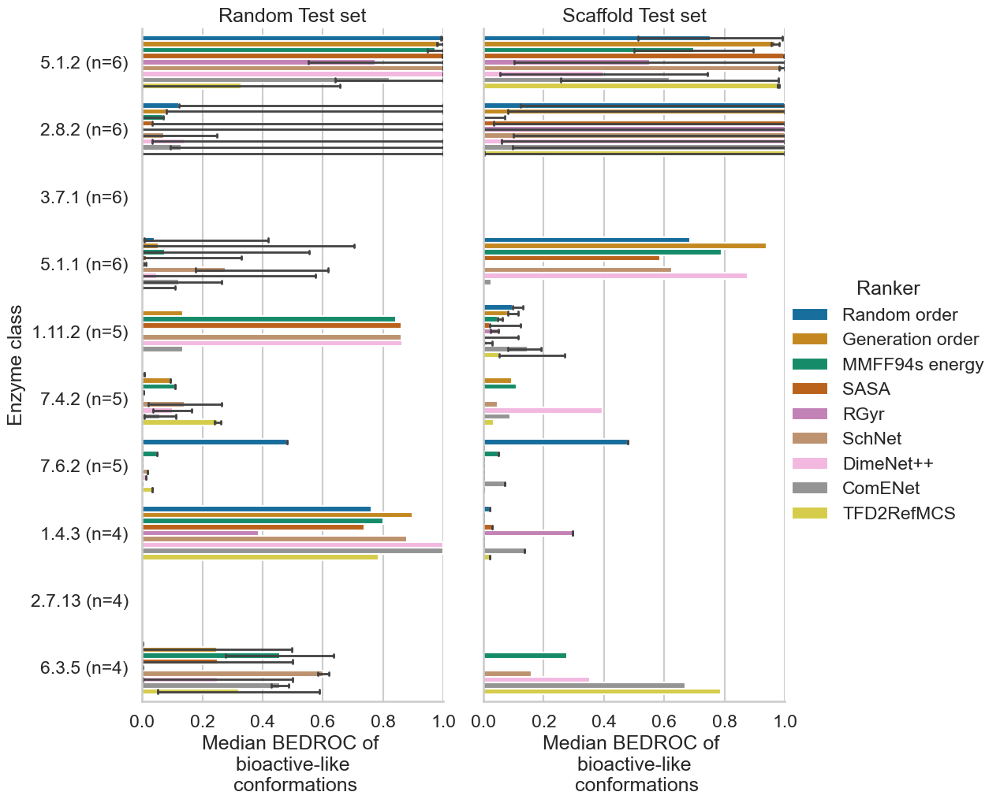

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

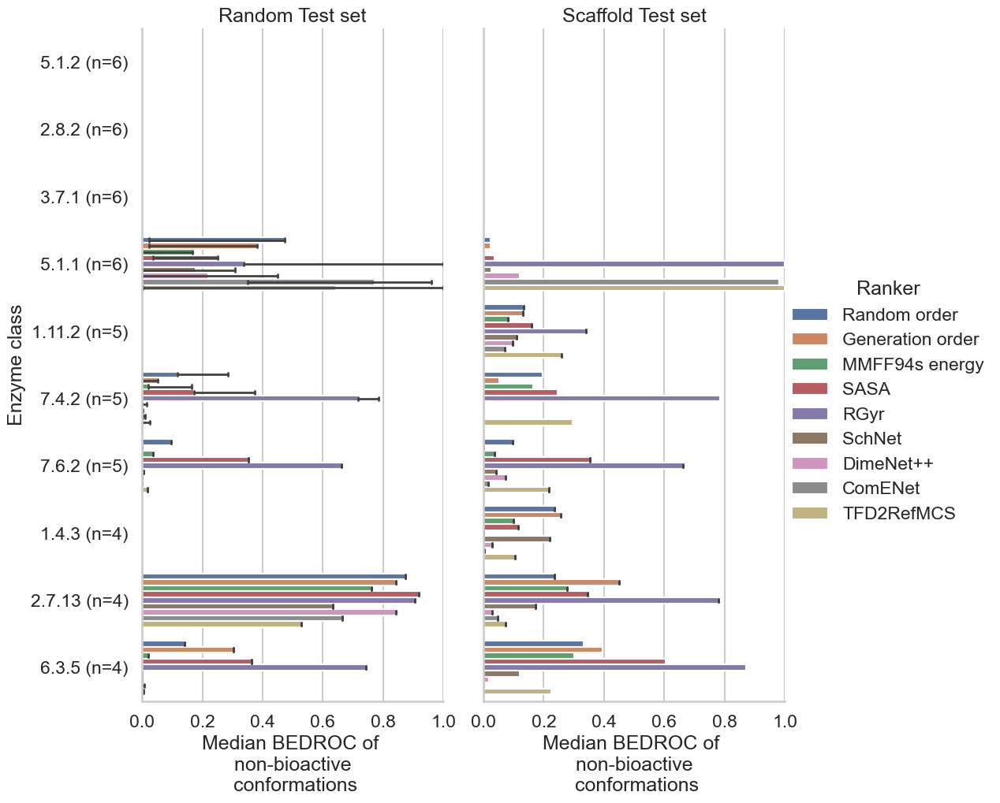

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

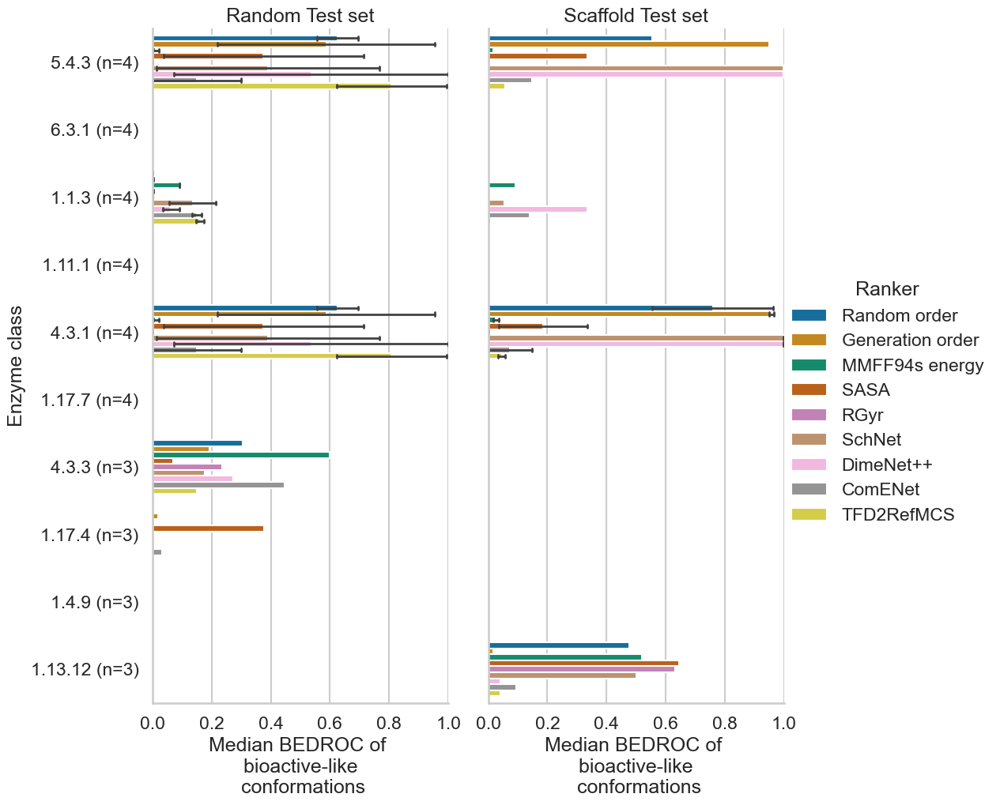

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

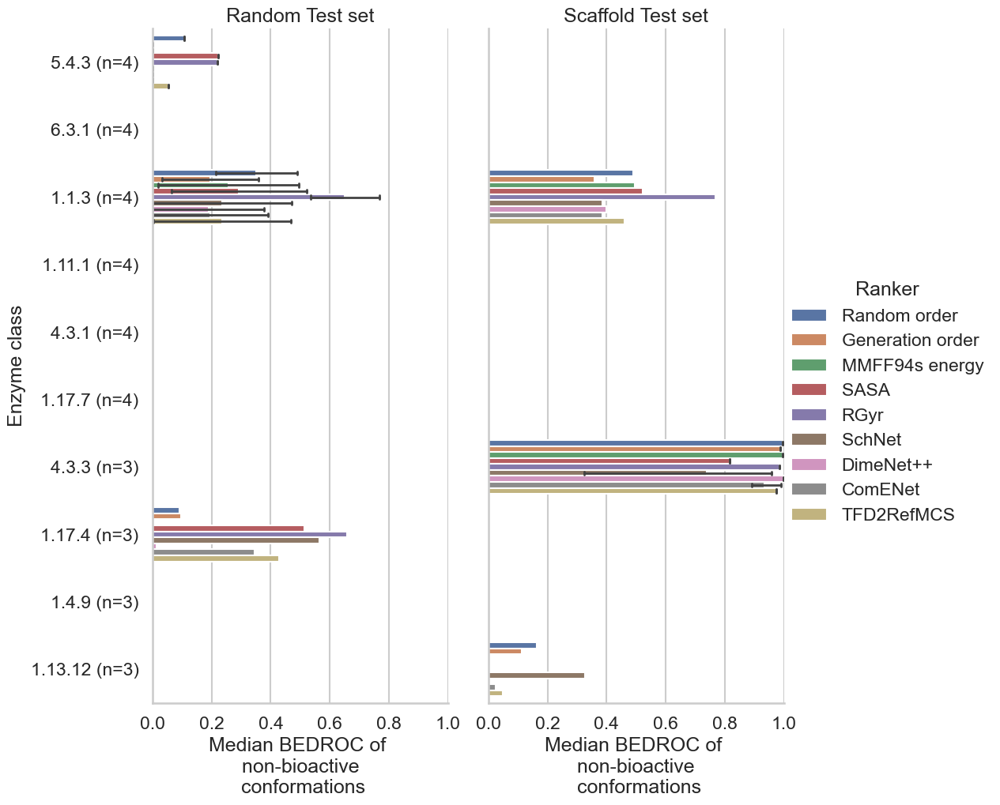

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

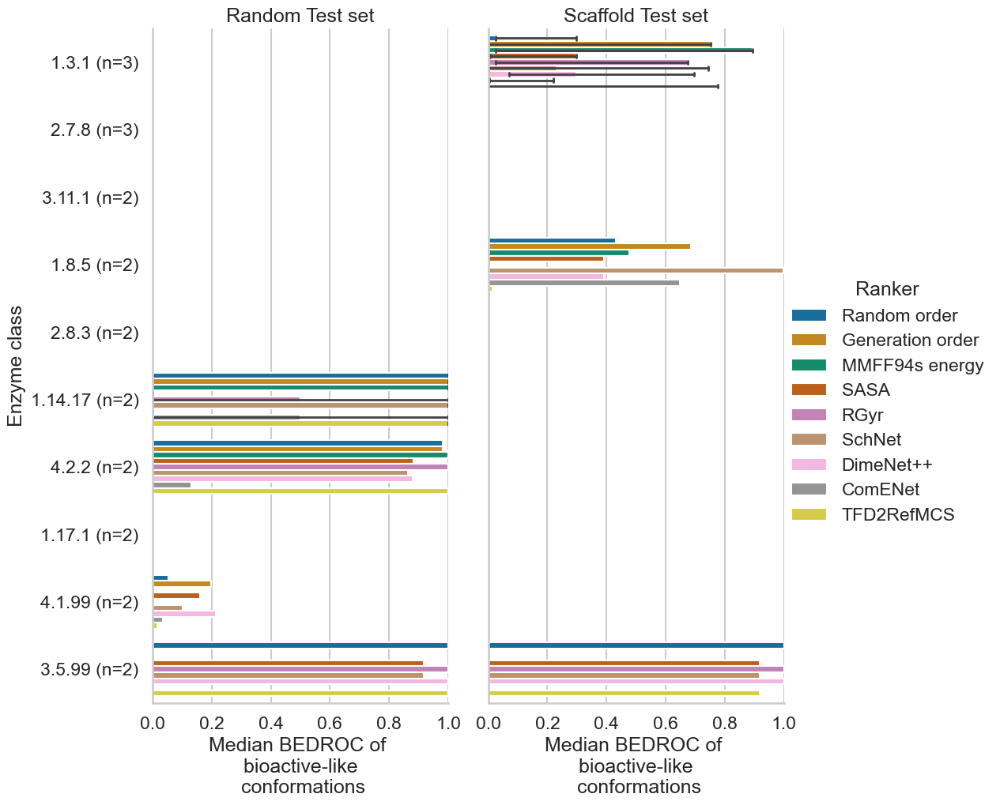

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

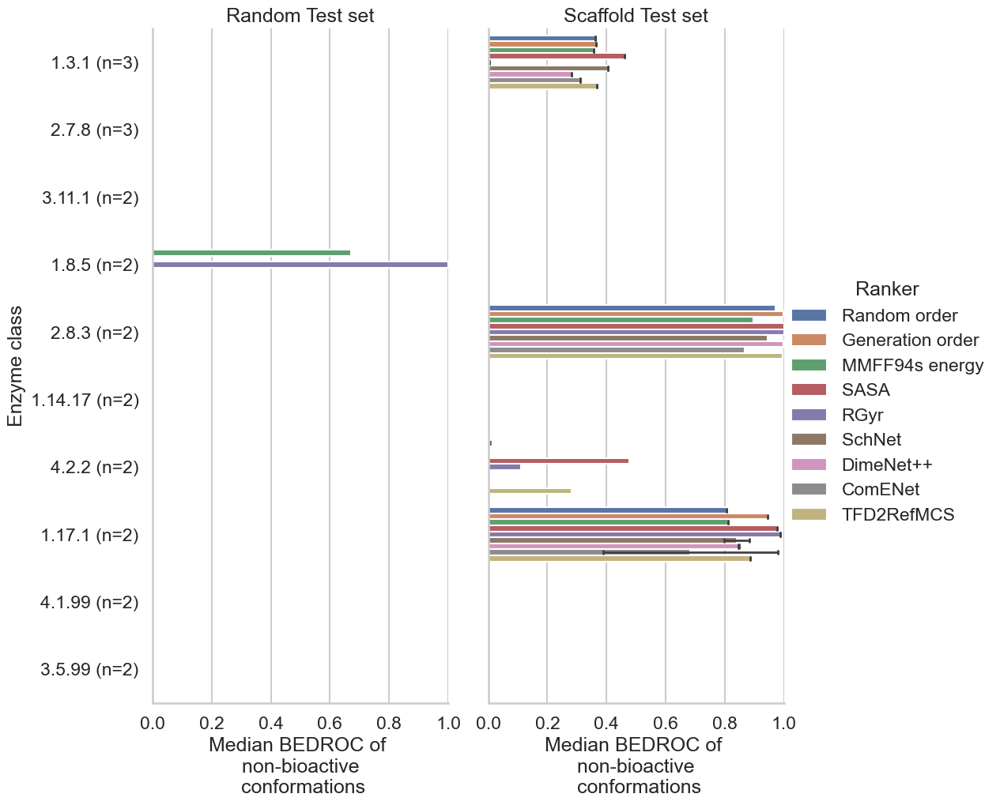

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1376: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anac

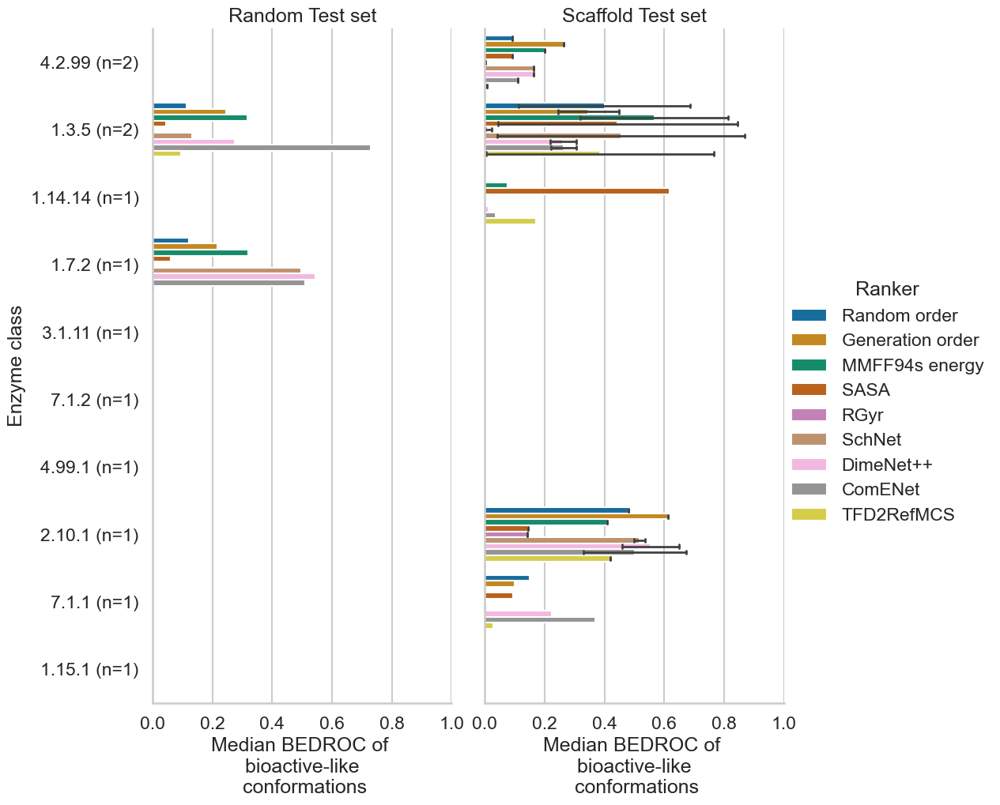

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

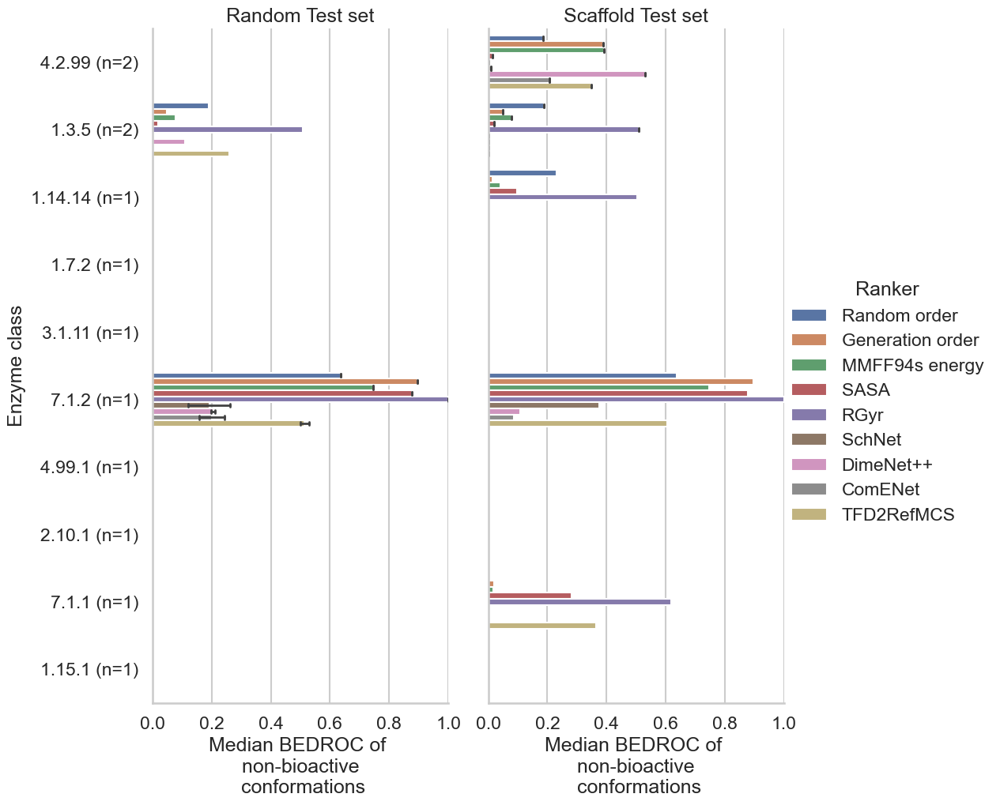

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

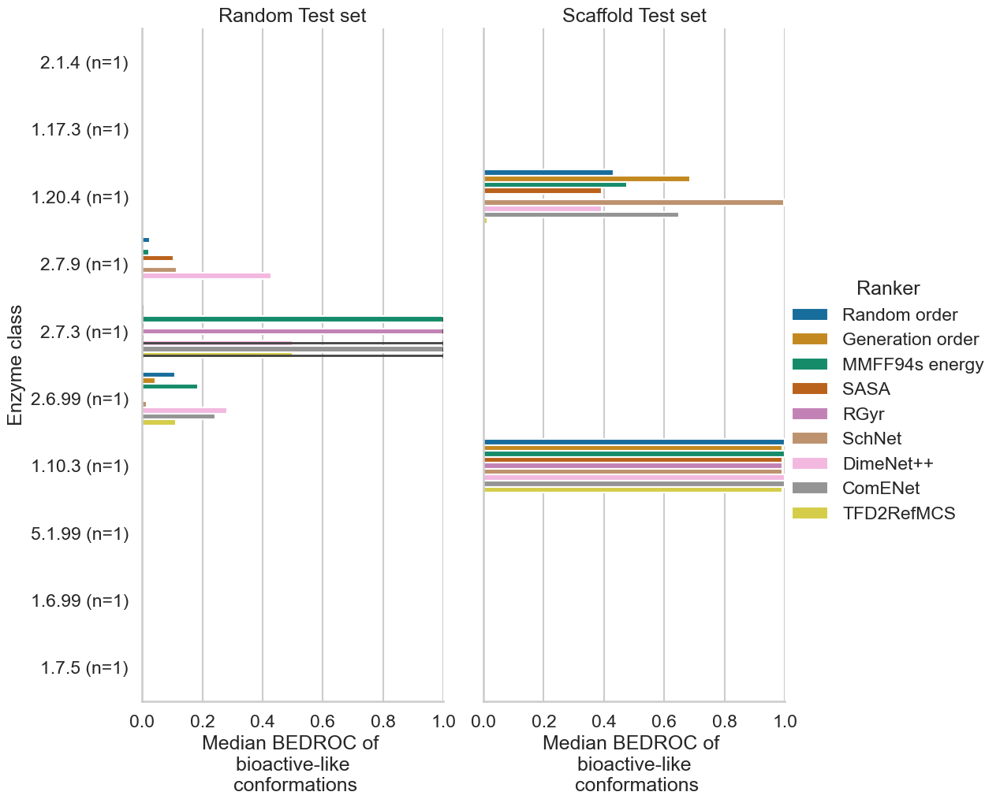

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

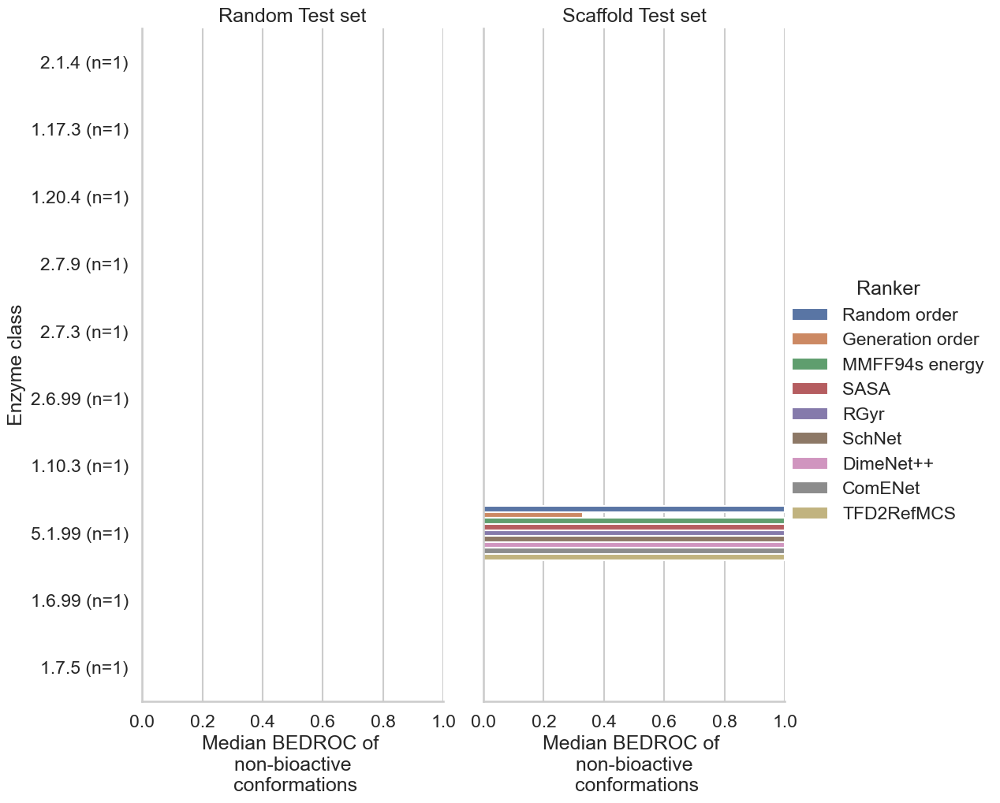

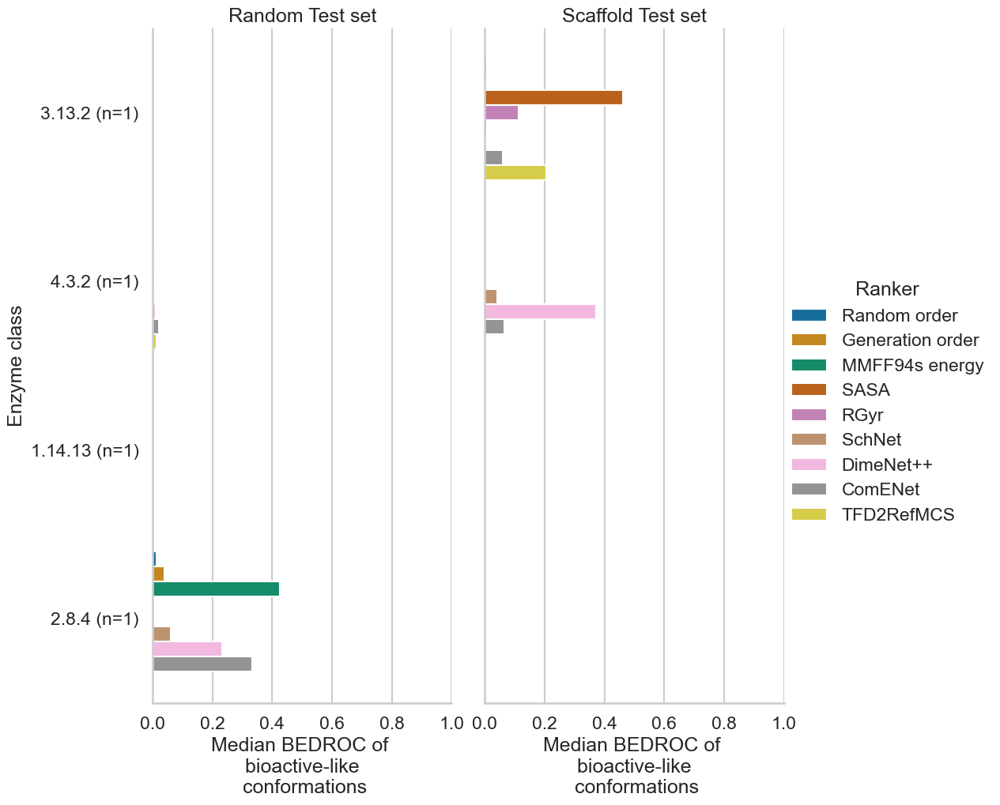

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/bb596/anaconda3/envs/bioconfpred/l

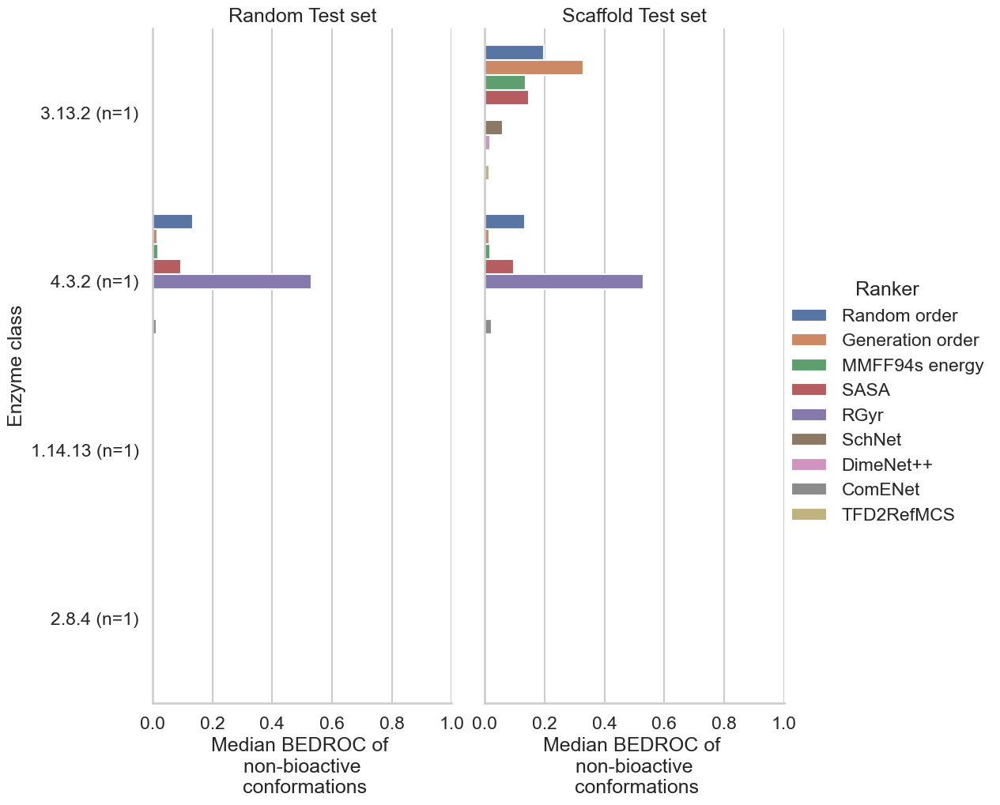

In [72]:
show_plots(target_results_df, vc, figname='enzyme_l3')

In [70]:
level_str = 'level_4_combined'
# target_results_df = results_df.merge(pdbbind_table, left_on='PDB ID', right_on='PDB code')
# target_results_df = target_results_df[target_results_df['level_3'].isin(['2.7.11', '2.7.10', '3.4.23', '3.4.21'])]
grouped_target_results_df = target_results_df.groupby(['Test set', 'Ranker', 'Iteration', level_str], sort=False).median().reset_index().sort_values(level_str, kind='stable')

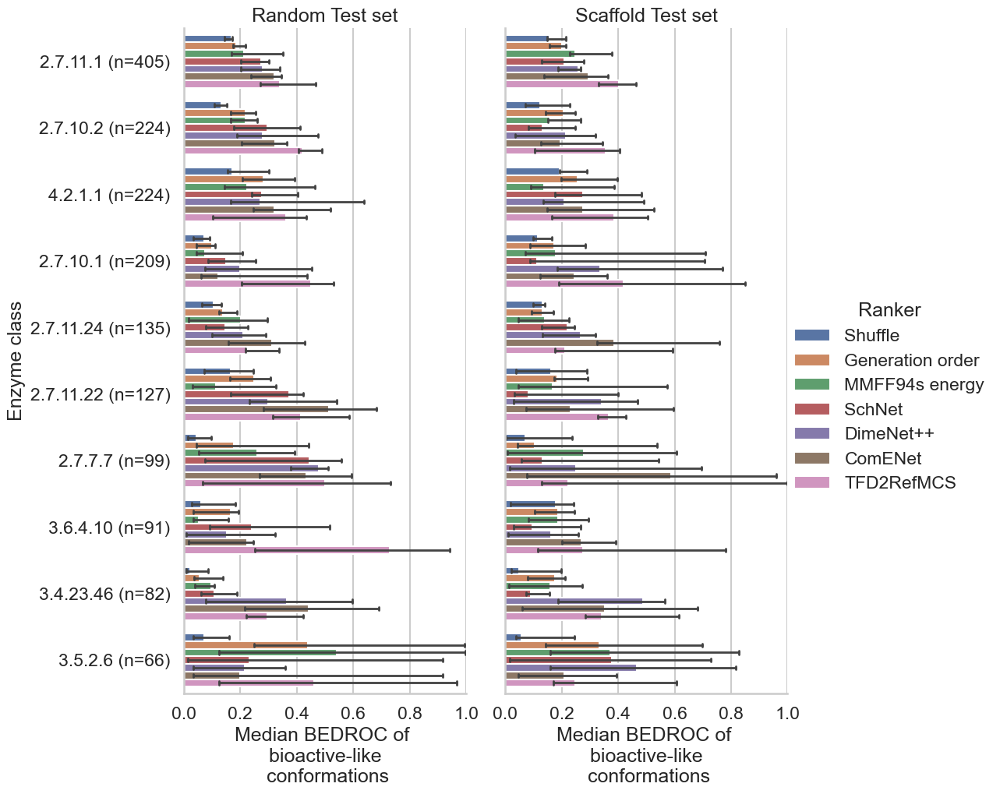

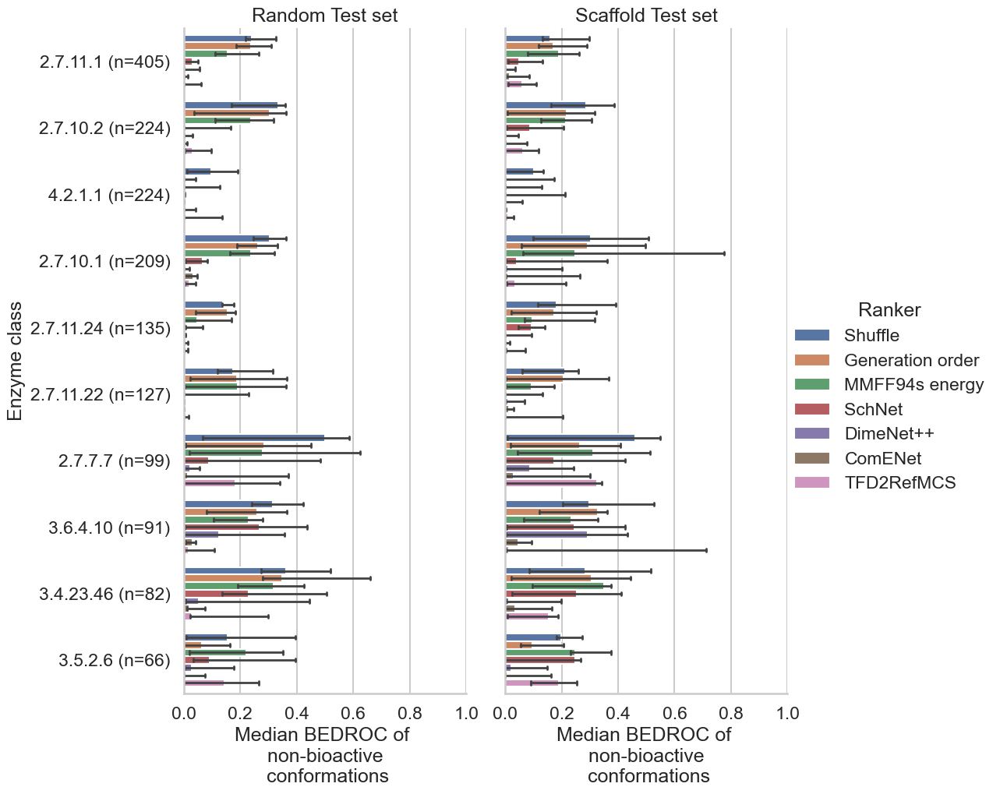

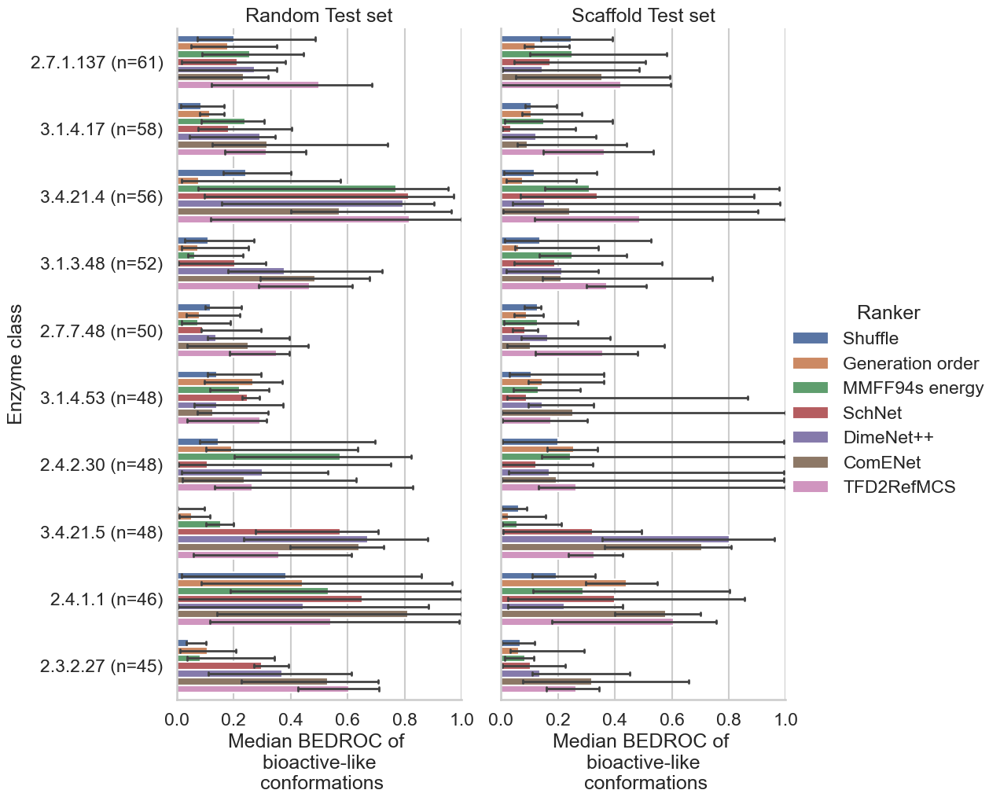

KeyboardInterrupt: 

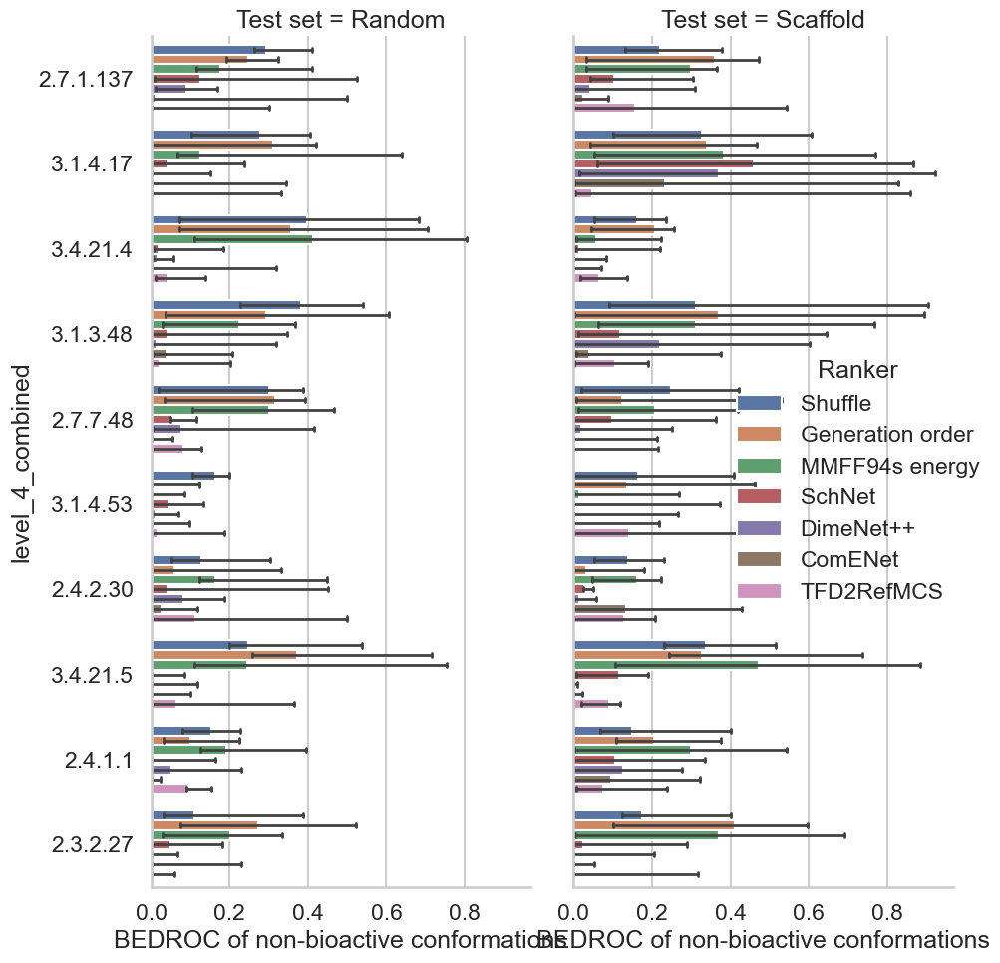

In [213]:
show_plots(target_results_df)

# INDIVIDUAL ANALYSIS

In [1]:
from data.utils.similarity_search import SimilaritySearch
from rdkit import Chem
from data.split.random_split import RandomSplit
from data.split.scaffold_split import ScaffoldSplit

In [2]:
from IPython.display import display

In [3]:
from rdkit.Chem import Draw
from scipy.stats import pearsonr

In [5]:
from rdkit.Chem import AllChem
from utils.molconfviewer import MolConfViewer

def get_mol_energy(mol, conf_id):
    mol_properties = AllChem.MMFFGetMoleculeProperties(mol, 
                                                       mmffVariant='MMFF94s')
    force_field = AllChem.MMFFGetMoleculeForceField(mol, 
                                                mol_properties,
                                                confId=conf_id)
    energy = force_field.CalcEnergy()
    return energy

def analyse_pdb(pdb_id):
    
    df = r0_regression_df[r0_regression_df['PDB ID']  == pdb_id]
    sns.scatterplot(data=df,
                   x='ARMSD',
                   y='Prediction')
    plt.ylabel('ComENet prediction')
    plt.savefig(os.path.join(figure_dir, f'{pdb_id}_ARMSD_prediction.png'),
               dpi=300,
               bbox_inches='tight')
    plt.show()
    print(pearsonr(df['ARMSD'], df['Prediction']))
    
    ligand_name = pdbbind_df[pdbbind_df['PDB ID'] == pdb_id]['Ligand name'].values[0]
    filename = cel_df[cel_df['ensemble_name'] == ligand_name]['filename'].values[0]
    filepath = os.path.join('../hdd/pdbbind_bioactive/data/gen_conf_ensembles/', filename)
    ce = ConfEnsemble.from_file(filepath)
    mol = ce.mol
    
    conf_ids = [conf.GetId() for conf in mol.GetConformers()]
    energies = [get_mol_energy(mol, conf_id) for conf_id in conf_ids]
    df['MMFF94s energy'] = energies
    sns.scatterplot(data=df,
                   x='ARMSD',
                   y='MMFF94s energy')
    plt.savefig(os.path.join(figure_dir, f'{pdb_id}_ARMSD_energy.png'),
               dpi=300,
               bbox_inches='tight')
    plt.show()
    print(pearsonr(df['ARMSD'], df['MMFF94s energy']))
    
    tfds, mcs = tfd_ranker.get_input_list_for_mol(mol)
    # import pdb;pdb.set_trace()
    df['TFD to MCS of closest training molecule'] = tfds
    sns.scatterplot(data=df,
                   x='ARMSD',
                   y='TFD to MCS of closest training molecule')
    plt.savefig(os.path.join(figure_dir, f'{pdb_id}_ARMSD_TFD.png'),
               dpi=300,
               bbox_inches='tight')
    plt.show()
    print(pearsonr(df['ARMSD'], df['TFD to MCS of closest training molecule']))
    
    MolConfViewer().view(Chem.RemoveHs(ce.mol), properties={'Energy': energies})
    
    
    
    smiles = cel_df[cel_df['ensemble_name'] == ligand_name]['smiles'].values[0]
    closest_smiles, sims = ss.find_closest_in_subset(smiles=smiles, subset=data_split.get_smiles('train'))
    print(sims[0])
    print(cel_df.loc[cel_df['smiles'].values.tolist().index(closest_smiles[0]), 'ensemble_name'])
    
    closest_mol = Chem.MolFromSmiles(closest_smiles[0])
    display(closest_mol)
    
    Draw.MolToFile(closest_mol, 
                   os.path.join(figure_dir, f'{pdb_id}_closest_mol.png'))
    
    ligand_name = cel_df.loc[cel_df['smiles'].values.tolist().index(closest_smiles[0]), 'ensemble_name']
    print(pdbbind_table[pdbbind_table['ligand name'] == ligand_name][['PDB code', 'level_4_combined']].values)
    
    return mol, closest_mol

In [ ]:
from evaluator.conf_scorer import ConfScorer, ConfAnalyzer
from rdkit.Chem import Mol

In [ ]:
ca = ConfAnalyzer()

In [ ]:
def analyze_torsions(ligand_name, pdb_id, have_bio_like=True):
    filename = cel_df[cel_df['ensemble_name'] == ligand_name]['filename'].values[0]
    
    gen_ce = ConfEnsemble.from_file(f'../hdd/pdbbind_bioactive/data/gen_conf_ensembles/{filename}')
    gen_ce.mol = Chem.RemoveHs(gen_ce.mol)
    gen_mol = Mol(gen_ce.mol)

    bio_ce = ConfEnsemble.from_file(f'../hdd/pdbbind_bioactive/data/pdb_conf_ensembles/{filename}')
    bio_ce.mol = Chem.RemoveHs(bio_ce.mol)
    
    bio_conf_ids = [i + gen_ce.mol.GetNumConformers() for i in range(bio_ce.mol.GetNumConformers())]
    gen_ce.add_mol(bio_ce.mol, standardize=False)
    
    if have_bio_like:
    
        bio_like_mol = Mol(gen_ce.mol)
        bio_like_mol.RemoveAllConformers()

        for conf_id in all_conf_results[pdb_id]['bioactive_like_idxs']:
            bio_like_mol.AddConformer(gen_ce.mol.GetConformer(conf_id))
            gen_ce.mol.RemoveConformer(conf_id)

    bio_mol = Mol(gen_ce.mol)
    bio_mol.RemoveAllConformers()

    for conf_id in bio_conf_ids:
        bio_mol.AddConformer(gen_ce.mol.GetConformer(conf_id))
        gen_ce.mol.RemoveConformer(conf_id)
        
    if have_bio_like:
        
        mol_dict = {'Non-bio': gen_ce.mol,
               'Bio-like': bio_like_mol, 
               'Bioactive': bio_mol}
        
    else:
        mol_dict = {'Gen': gen_ce.mol,
               'Bioactive': bio_mol}
    
    ca.plot_rotatable_histograms_ref_vs_gen(mol_dict=mol_dict)
    
    return gen_mol

In [ ]:
import torch
from rdkit.Chem.rdFMCS import FindMCS
from data.featurizer import PyGFeaturizer
from torch_geometric.data import Batch
pygf = PyGFeaturizer()

def get_pred_dihedral_table(mol, d_idxs, targets=None):
    with torch.no_grad():
        preds = model.get_preds_for_mol(mol).numpy().squeeze()
    d_mol = {'preds': preds}
    if targets is not None:
        d_mol['targets'] = targets

    # import pdb;pdb.set_trace()

    for i, idxs in enumerate(d_idxs):
        values = ca.get_conformers_dihedrals_deg(mol, *idxs)
        d_mol[i] = values
    table = pd.DataFrame(d_mol)
    return table

def compare_to_ref_mcs(gen_mol, gen_mol_ref, targets, bin_size=30):
    mcs = FindMCS([gen_mol, gen_mol_ref], matchChiralTag=True)
    smarts = mcs.smartsString
    mcs_mol = Chem.MolFromSmarts(smarts)
    display(mcs_mol)
    match1 = gen_mol.GetSubstructMatch(mcs_mol)
    match2 = gen_mol2.GetSubstructMatch(mcs_mol)
    d_match = {i: j for i, j in zip(match1, match2)}
    
    dihedrals_idxs = ca.get_rotatable_bonds_atom_idx(gen_mol)
    
    # import pdb;pdb.set_trace()
    
    dihedrals_idxs1 = []
    dihedrals_idxs2 = []
    for idxs in dihedrals_idxs :
        idxs2 = []
        for i in idxs :
            if i in d_match:
                idxs2.append(d_match[i])
        if len(idxs2) == 4:
            dihedrals_idxs1.append(idxs)
            dihedrals_idxs2.append(idxs2)
            
    # TODO: Compare with atomic contributions
    with torch.no_grad():
        model.show_atomic_contributions(gen_mol, 'gen_mol')
        model.show_atomic_contributions(gen_mol_ref, 'gen_mol_ref')
        data_list = pygf.featurize_mol(gen_mol)
        batch = Batch.from_data_list(data_list)
        ac1 = model.get_atomic_contributions(batch).numpy()

        data_list = pygf.featurize_mol(gen_mol_ref)
        batch = Batch.from_data_list(data_list)
        ac2 = model.get_atomic_contributions(batch).numpy()
    
    table1 = get_pred_dihedral_table(gen_mol, d_idxs=dihedrals_idxs1, targets=targets)
    table2 = get_pred_dihedral_table(gen_mol_ref, d_idxs=dihedrals_idxs2)

    n_dihedrals = len(dihedrals_idxs1)
    for i in range(n_dihedrals):
        table1[i] = (table1[i] / bin_size).round(0) * bin_size
        table2[i] = (table2[i] / bin_size).round(0) * bin_size
        
    return table1, table2, dihedrals_idxs1, ac1, ac2

In [ ]:
from model.comenet_model import ComENetModel

In [ ]:
ss = SimilaritySearch(smiles_list=cel_df['smiles'])

In [ ]:
cel = ConfEnsembleLibrary()

In [53]:
data_split = RandomSplit()
model = ComENetModel.get_model_for_data_split(data_split)
# model.to('cuda')

2023-05-03 18:08:26,120|INFO|Created a temporary directory at /tmp/tmp7tum9adt
2023-05-03 18:08:26,121|INFO|Writing /tmp/tmp7tum9adt/_remote_module_non_sriptable.py
/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/torch/distributed/_sharded_tensor/__init__.py:10: DeprecationWarning: torch.distributed._sharded_tensor will be deprecated, use torch.distributed._shard.sharded_tensor instead
  DeprecationWarning


In [54]:
import copy
train_smiles = data_split.get_smiles('train')
        
train_cel = copy.deepcopy(cel)
train_cel.select_smiles_list(smiles_list=train_smiles)

In [55]:
from rankers.tfd_ranker_sim import TFD2SimRefMCSRanker
tfd_ranker = TFD2SimRefMCSRanker(train_cel)

Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 849758.78it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


In [56]:
with open('../hdd/pdbbind_bioactive/results/random_split_0/SchNetModel/ranker_mol_results.p', 'rb') as f:
    all_mol_results = pickle.load(f)
    
with open('../hdd/pdbbind_bioactive/results/random_split_0/SchNetModel/ranker_conf_results.p', 'rb') as f:
    all_conf_results = pickle.load(f)

In [57]:
target_results_df = results_df.merge(pdbbind_table, left_on='PDB ID', right_on='PDB code')
t0 = target_results_df[(target_results_df['Iteration'] == 0)
                 & (target_results_df['Test set'] == 'Random')
                      & (target_results_df['Number of generated conformations'] == 250)]

In [58]:
r0_results_df = results_df[(results_df['Test set'] == 'Random')
                          &(results_df['Iteration'] == 0)
                          &(results_df['Ranker'] == 'ComENet')]
r0_regression_df = regression_df[(regression_df['Test set'] == 'Random')
                          &(regression_df['Iteration'] == 0)
                                &(regression_df['Model'] == 'ComENet')]

In [91]:
mcs_rows = []
for split_type in ['Random', 'Scaffold']:
    for split_i in range(5):
        
        subset_results_df = target_results_df[(target_results_df['Iteration'] == split_i)
                 & (target_results_df['Test set'] == split_type)]
        
        if split_type == 'Random': 
            data_split = RandomSplit(split_i=split_i)
        else:
            data_split = ScaffoldSplit(split_i=split_i)
            
        train_smiles = data_split.get_smiles('train')
        train_cel = copy.deepcopy(cel)
        train_cel.select_smiles_list(smiles_list=train_smiles)
        
        tfd_ranker = TFD2SimRefMCSRanker(train_cel)
        
        for ligand_name in tqdm(subset_results_df['Ligand name'].unique()) :
            test_mol = cel.library[ligand_name].mol
            closest_train_mol = tfd_ranker.find_closest_mols_in_cel(test_mol)
            mcs = FindMCS([test_mol, closest_train_mol], timeout=5)#, ringMatchesRingOnly=True, matchChiralTag=True)
            smarts = mcs.smartsString
            mcs_mol = Chem.MolFromSmarts(smarts)
            row = {}
            row['Test set'] = split_type
            row['Iteration'] = split_i
            row['Ligand name'] = ligand_name
            row['NHA'] = test_mol.GetNumHeavyAtoms()
            row['MCS size'] = mcs_mol.GetNumHeavyAtoms()
            mcs_rows.append(row)

mcs_df = pd.DataFrame(mcs_rows)

Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 843754.51it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 731/731 [01:41<00:00,  7.22it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 817412.34it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 742/742 [02:08<00:00,  5.77it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 819837.83it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 741/741 [02:28<00:00,  4.98it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 804712.80it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 722/722 [02:20<00:00,  5.15it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 806039.60it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 729/729 [02:15<00:00,  5.37it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 808430.32it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 721/721 [02:05<00:00,  5.76it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 831701.79it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 698/698 [02:53<00:00,  4.02it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 830858.71it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 722/722 [02:11<00:00,  5.48it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 812598.39it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 733/733 [01:37<00:00,  7.53it/s]


Loading enzyme classes data


100%|███████████████████████████████| 163761/163761 [00:00<00:00, 804381.08it/s]


Similarity matrix ready
TFD ranker ready, training compounds are loaded


100%|█████████████████████████████████████████| 713/713 [02:33<00:00,  4.64it/s]


In [92]:
test_df = target_results_df.merge(mcs_df, on=['Test set', 'Iteration', 'Ligand name'])

In [93]:
def rename_mcs_bin(value, step=10):
    return f'[{value}, {value + step}['

In [94]:
step = 10
test_df['MCS size binned'] = test_df['MCS size'] / step
test_df['MCS size binned'] = test_df['MCS size binned'].apply(np.floor)
test_df['MCS size binned'] = test_df['MCS size binned'] * step
test_df['MCS size binned'] = test_df['MCS size binned'].astype(int)
test_df = test_df[test_df['MCS size binned'] <= 45]
test_df = test_df.sort_values(['MCS size binned'])
test_df['MCS size binned'] = test_df['MCS size binned'].apply(rename_mcs_bin)
test_df['MCS size binned'] = test_df['MCS size binned'].astype(str)

In [95]:
grouped_test_df = test_df.groupby(['Test set', 'Ranker', 'Iteration', 'MCS size binned'], 
                                  sort=False).median().reset_index()

In [96]:
t = grouped_test_df.groupby(['Test set', 'Ranker', 'MCS size binned'], 
                        sort=False).agg(custom_agg)['BEDROC of bioactive-like conformations'].reset_index()

In [97]:
t.pivot_table(index=['Test set', 'MCS size binned'], columns='Ranker', values='BEDROC of bioactive-like conformations', aggfunc='first')

Ranker                        ComENet    DimeNet++ Generation order  \
Test set MCS size binned                                              
Random   [0, 10[          0.43 ± 0.12  0.48 ± 0.13      0.41 ± 0.14   
         [10, 20[         0.26 ± 0.03  0.28 ± 0.04      0.22 ± 0.03   
         [20, 30[         0.29 ± 0.04  0.23 ± 0.06      0.15 ± 0.02   
         [30, 40[         0.47 ± 0.09  0.33 ± 0.07      0.07 ± 0.03   
         [40, 50[         0.43 ± 0.32   0.3 ± 0.12      0.12 ± 0.15   
Scaffold [0, 10[          0.38 ± 0.17  0.44 ± 0.32      0.39 ± 0.28   
         [10, 20[         0.22 ± 0.02  0.22 ± 0.04      0.21 ± 0.04   
         [20, 30[         0.25 ± 0.07  0.19 ± 0.06      0.12 ± 0.03   
         [30, 40[         0.28 ± 0.09  0.21 ± 0.08      0.08 ± 0.01   
         [40, 50[         0.48 ± 0.36  0.28 ± 0.25      0.05 ± 0.07   

Ranker                   MMFF94s energy         RGyr Random order  \
Test set MCS size binned                                            
Random   [0, 10[            0.35 ± 0.17  0.11 ± 0.08  0.33 ± 0.08   
         [10, 20[           0.25 ± 0.03  0.02 ± 0.01  0.15 ± 0.03   
         [20, 30[           0.13 ± 0.02  0.01 ± 0.01  0.11 ± 0.02   
         [30, 40[           0.08 ± 0.02    0.0 ± 0.0  0.05 ± 0.03   
         [40, 50[           0.07 ± 0.05    0.0 ± 0.0  0.06 ± 0.05   
Scaffold [0, 10[            0.49 ± 0.29  0.17 ± 0.15  0.16 ± 0.05   
         [10, 20[           0.24 ± 0.05  0.05 ± 0.03  0.16 ± 0.03   
         [20, 30[           0.12 ± 0.03  0.01 ± 0.01   0.1 ± 0.01   
         [30, 40[           0.07 ± 0.06    0.0 ± 0.0  0.05 ± 0.03   
         [40, 50[           0.09 ± 0.12  0.02 ± 0.04  0.06 ± 0.07   

Ranker                           SASA       SchNet   TFD2RefMCS  
Test set MCS size binned                                         
Random   [0, 10[          0.23 ± 0.06  0.44 ± 0.09  0.37 ± 0.13  
         [10, 20[          0.1 ± 0.03  0.26 ± 0.03  0.22 ± 0.05  
         [20, 30[         0.06 ± 0.01  0.19 ± 0.04  0.41 ± 0.07  
         [30, 40[          0.01 ± 0.0  0.22 ± 0.07  0.49 ± 0.08  
         [40, 50[          0.0 ± 0.01  0.17 ± 0.09  0.55 ± 0.17  
Scaffold [0, 10[           0.2 ± 0.07  0.35 ± 0.21   0.5 ± 0.25  
         [10, 20[         0.14 ± 0.01  0.19 ± 0.06  0.22 ± 0.04  
         [20, 30[         0.06 ± 0.02  0.13 ± 0.06  0.33 ± 0.08  
         [30, 40[         0.02 ± 0.02  0.13 ± 0.07  0.35 ± 0.11  
         [40, 50[         0.01 ± 0.02   0.18 ± 0.1  0.36 ± 0.42

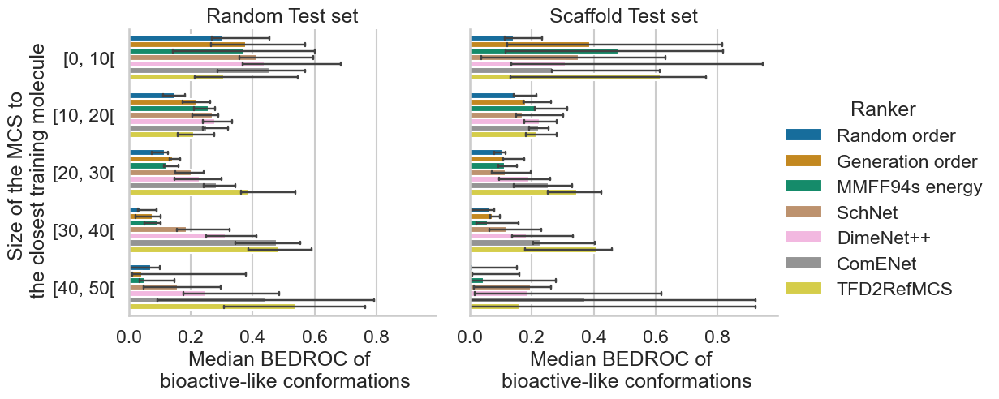

In [99]:
# plt.figure(figsize=(5, 10))
order = ['Random order', 'Generation order', 'MMFF94s energy', 
         'SchNet', 'DimeNet++', 'ComENet', 'TFD2RefMCS']
ax = sns.catplot(data=grouped_test_df,
               x='BEDROC of bioactive-like conformations',
               y='MCS size binned',
                 hue_order=order,
               hue='Ranker',
                kind='bar',
                 errorbar=('pi', 100),
                col='Test set',
                         errwidth=1.75,
                         capsize=0.05,
                         estimator='median',
                  palette=hue2palette)
ax.set_xlabels('Median BEDROC of \n bioactive-like conformations')
ax.set_ylabels('Size of the MCS to \n the closest training molecule')
ax.set_titles('{col_name} {col_var}')
plt.savefig(os.path.join(figure_dir, 'mcs_size_bedroc.png'),
           dpi=300,
           bbox_inches='tight')

In [634]:
mcs_sizes = {}
for ligand_name in tqdm(t0['Ligand name'].unique()) :
    test_mol = cel.library[ligand_name].mol
    closest_train_mol = tfd_ranker.find_closest_mols_in_cel(test_mol)
    mcs = FindMCS([test_mol, closest_train_mol], timeout=5)#, ringMatchesRingOnly=True, matchChiralTag=True)
    smarts = mcs.smartsString
    mcs_mol = Chem.MolFromSmarts(smarts)
    mcs_sizes[ligand_name] = mcs_mol.GetNumHeavyAtoms()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 731/731 [01:41<00:00,  7.22it/s]


In [668]:
t0['Size of train MCS'] = t0['Ligand name'].apply(lambda x: mcs_sizes[x])

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [332]:
t0 = target_results_df[(target_results_df['Iteration'] == 0)
                 & (target_results_df['Test set'] == 'Random')]
t = t0.groupby(['Ranker', 'ligand name']).mean().reset_index()

In [738]:
mcs_sizes = {}
for ligand_name in tqdm(t0['Ligand name'].unique()) :
    test_mol = cel.library[ligand_name].mol
    closest_train_mol = tfd_ranker.find_closest_mols_in_cel(test_mol)
    mcs = FindMCS([test_mol, closest_train_mol], timeout=5)#, ringMatchesRingOnly=True, matchChiralTag=True)
    smarts = mcs.smartsString
    mcs_mol = Chem.MolFromSmarts(smarts)
    mcs_sizes[ligand_name] = mcs_mol.GetNumHeavyAtoms()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 742/742 [01:51<00:00,  6.66it/s]


In [742]:
num_has = {}
for ligand_name in tqdm(t0['Ligand name'].unique()) :
    test_mol = cel.library[ligand_name].mol
    num_has[ligand_name] = test_mol.GetNumHeavyAtoms()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 742/742 [00:00<00:00, 268198.34it/s]


In [746]:
from rdkit.Chem.rdMolDescriptors import CalcNumRotatableBonds
num_rbs = {}
for ligand_name in tqdm(t0['Ligand name'].unique()) :
    test_mol = cel.library[ligand_name].mol
    num_rbs[ligand_name] = CalcNumRotatableBonds(test_mol)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 742/742 [00:00<00:00, 21231.33it/s]


In [ ]:
t0['Size of train MCS'] = t0['Ligand name'].apply(lambda x: mcs_sizes[x])
t0['Number of heavy atoms'] = t0['Ligand name'].apply(lambda x: num_has[x])
t0['Number of rotatable bonds'] = t0['Ligand name'].apply(lambda x: num_rbs[x])

In [ ]:
t0['MCS size binned'] = t0['Size of train MCS'] / 5
t0['MCS size binned'] = t0['MCS size binned'].apply(np.floor)
t0['MCS size binned'] = t0['MCS size binned'] * 5
t0['MCS size binned'] = t0['MCS size binned'].astype(int)
t0 = t0.sort_values(['MCS size binned', 'Ranker'])
t0['MCS size binned'] = t0['MCS size binned'].astype(str)

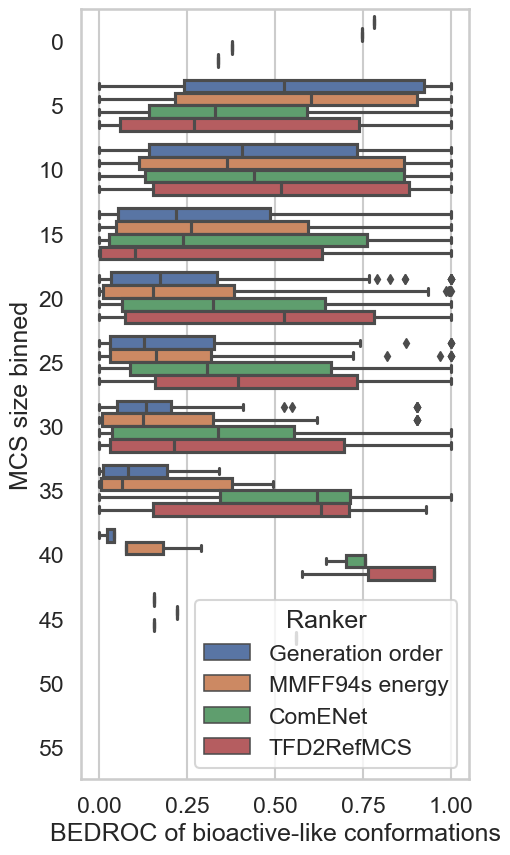

In [766]:
plt.figure(figsize=(5, 10))
order = ['Generation order', 'MMFF94s energy', 'ComENet', 'TFD2RefMCS']
ax = sns.boxplot(data=t0[t0['Ranker'].isin(order)],
               x='BEDROC of bioactive-like conformations',
               y='MCS size binned',
                 hue_order=order,
               hue='Ranker')

In [744]:
t0['NHA'] = t0['Number of heavy atoms'] / 5
t0['NHA'] = t0['NHA'].apply(np.floor)
t0['NHA'] = t0['NHA'] * 5
t0['NHA'] = t0['NHA'].astype(int)
t0 = t0.sort_values(['NHA', 'Ranker'])
t0['NHA'] = t0['NHA'].astype(str)

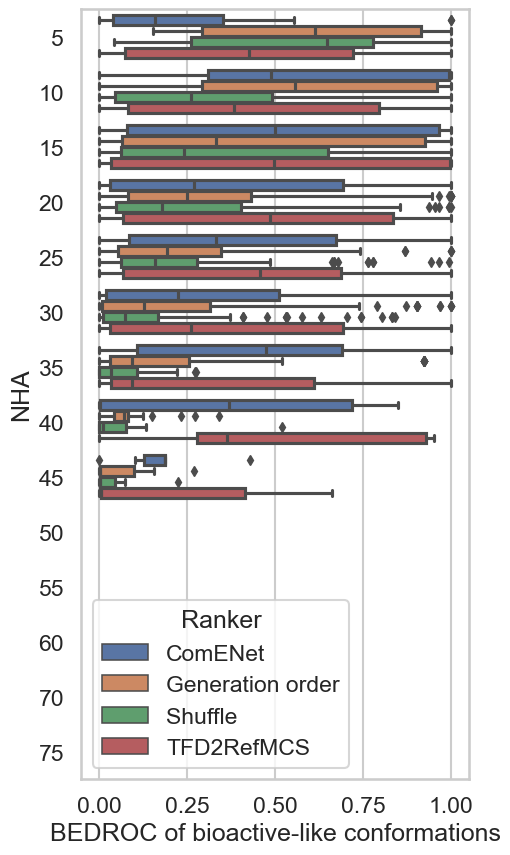

In [745]:
plt.figure(figsize=(5, 10))
ax = sns.boxplot(data=t0[t0['Ranker'].isin(['Shuffle', 'Generation order', 'MMFF94s', 'ComENet', 'TFD2RefMCS'])],
               x='BEDROC of bioactive-like conformations',
               y='NHA',
               hue='Ranker')

In [755]:
t0['NRB'] = t0['Number of rotatable bonds'] / 3
t0['NRB'] = t0['NRB'].apply(np.floor)
t0['NRB'] = t0['NRB'] * 3
t0['NRB'] = t0['NRB'].astype(int)
t0 = t0.sort_values(['NRB', 'Ranker'])
t0['NRB'] = t0['NRB'].astype(str)

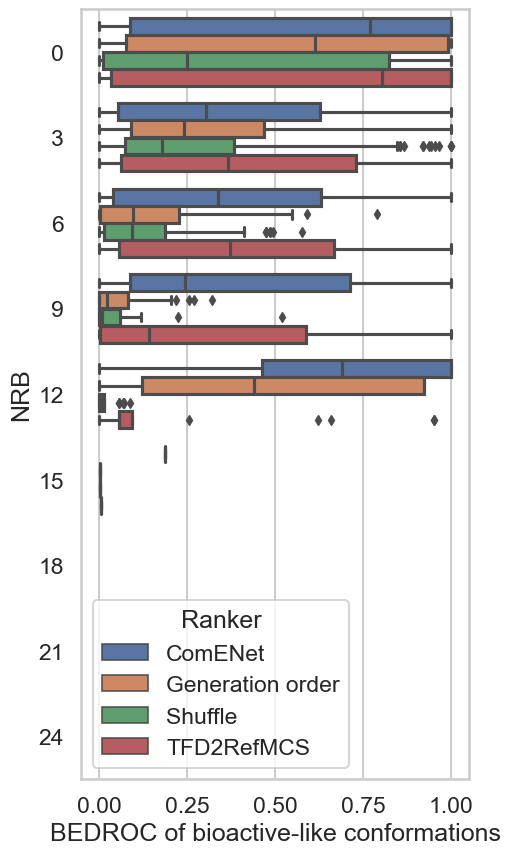

In [756]:
plt.figure(figsize=(5, 10))
ax = sns.boxplot(data=t0[t0['Ranker'].isin(['Shuffle', 'Generation order', 'MMFF94s', 'ComENet', 'TFD2RefMCS'])],
               x='BEDROC of bioactive-like conformations',
               y='NRB',
               hue='Ranker')

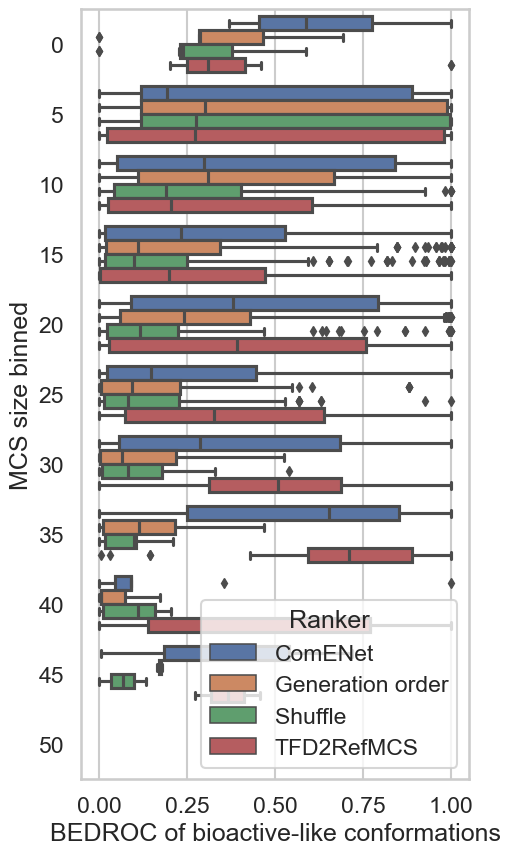

In [736]:
plt.figure(figsize=(5, 10))
ax = sns.boxplot(data=t0[t0['Ranker'].isin(['Shuffle', 'Generation order', 'MMFF94s', 'ComENet', 'TFD2RefMCS'])],
               x='BEDROC of bioactive-like conformations',
               y='MCS size binned',
               hue='Ranker')

In [334]:
p = t0.pivot_table(values='BEDROC of bioactive-like conformations', columns='Ranker', index=['PDB code', 'ligand name'])
p['S-M'] = p['ComENet'] - p['TFD2RefMCS']
p = p.reset_index()
# p['MCS size'] = p['ligand name'].apply(lambda x: mcs_sizes[x])
p = p.round(3)

<AxesSubplot:xlabel='TFD2RefMCS', ylabel='ComENet'>

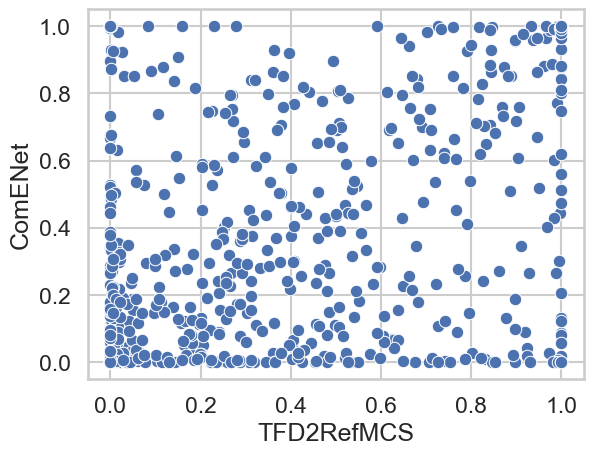

In [700]:
sns.scatterplot(data=p,
               x='TFD2RefMCS',
               y='ComENet')

In [672]:
p1 = p[(p['ComENet'] > 0.75) & (p['MMFF94s energy'] < 0.25)]
p1 = p1.merge(target_results_df[['ligand name', 'level_4']].drop_duplicates(), on='ligand name')

In [673]:
p1['level_4'].value_counts()

1.2.4.4      6
1.2.4.1      6
2.7.11.1     6
4.2.1.1      4
3.4.23.46    4
4.2.1.10     3
2.5.1.19     3
2.7.7.7      2
5.2.1.8      2
2.7.11.22    2
3.1.26.13    2
3.6.4.10     2
4.2.1.69     2
3.4.21.5     2
2.7.1.140    2
2.7.7.49     2
1.1.1.34     2
2.7.10.1     2
2.7.11.24    2
3.4.23.16    2
3.1.13.2     2
2.7.11.11    2
2.7.1.151    2
2.7.1.153    2
2.4.2.30     2
2.8.2.4      1
3.1.3.76     1
2.3.1.48     1
2.7.12.1     1
3.6.1.15     1
3.4.11.18    1
3.4.24.7     1
2.4.1.1      1
6.5.1.2      1
3.4.24.65    1
2.7.7.48     1
3.1.1.7      1
4.1.1.5      1
3.4.19.12    1
3.4.21.21    1
2.7.11.23    1
2.7.10.2     1
6.1.1.6      1
3.4.21.98    1
3.2.1.18     1
2.3.2.27     1
3.4.21.6     1
3.3.2.10     1
3.6.4.13     1
3.4.24.83    1
Name: level_4, dtype: int64

In [684]:
p2 = p1[p1['level_4'] == '2.7.11.1']

In [685]:
p2

,PDB code,ligand name,ComENet,DimeNet++,Generation order,MMFF94s energy,SchNet,SchNet_1e3,Shuffle,TFD2RefMCS,S-M,MCS size,level_4
34,2cgv,3B3,1.000,0.045,0.000,0.000,0.000,0.000,0.000,NaN,NaN,13,2.7.11.1
59,3r04,UNQ,0.928,0.955,0.213,0.034,0.943,0.979,0.236,0.844,0.085,21,2.7.11.1
60,3uol,0C7,0.794,0.468,0.259,0.006,0.608,0.589,0.167,0.265,0.530,22,2.7.11.1
63,4dgn,LU2,1.000,0.000,0.993,0.007,0.007,1.000,0.000,1.000,0.000,21,2.7.11.1
68,6m8a,LU2,1.000,0.000,0.993,0.007,0.007,1.000,0.000,1.000,0.000,21,2.7.11.1
76,4nus,2NK,0.999,0.695,0.398,0.224,0.993,0.633,0.659,0.760,0.238,13,2.7.11.1


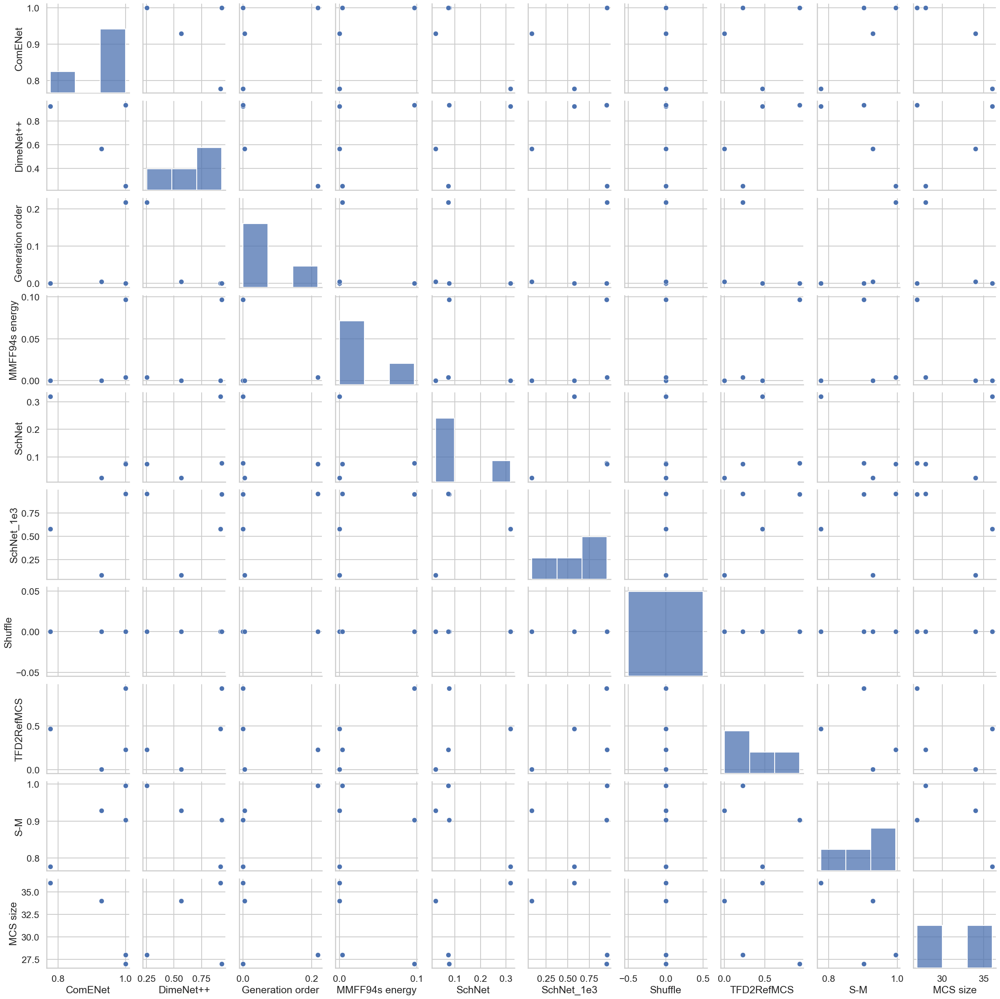

In [562]:
sns.pairplot(p2)

In [565]:
p1 = p[(p['ComENet'] < 0.25) & (p['MMFF94s energy'] > 0.75)]
p1 = p1.merge(target_results_df[['ligand name', 'level_4']].drop_duplicates(), on='ligand name')

In [566]:
p1['level_4'].value_counts()

2.4.2.30     4
2.7.11.1     3
2.7.1.151    2
2.7.1.153    2
2.7.1.140    2
3.2.1.1      1
3.4.11.18    1
3.2.1.46     1
4.2.1.2      1
4.2.2.1      1
2.3.1.48     1
2.3.1.57     1
4.2.1.69     1
6.5.1.2      1
2.7.11.11    1
2.7.11.24    1
4.2.1.1      1
3.6.4.10     1
Name: level_4, dtype: int64

In [568]:
p2 = p1[p1['level_4'] == '2.4.2.30']
p2

,PDB code,ligand name,ComENet,DimeNet++,Generation order,MMFF94s energy,SchNet,SchNet_1e3,Shuffle,TFD2RefMCS,S-M,MCS size,level_4
10,4hkn,LU2,0.000,1.0,0.007,0.993,0.993,0.00,1.000,0.000,-0.993,21,2.4.2.30
15,5auu,LU2,0.000,1.0,0.007,0.993,0.993,0.00,1.000,0.000,-0.993,21,2.4.2.30
19,4tki,33E,0.000,0.0,1.000,0.993,1.000,1.00,0.993,0.993,-0.993,9,2.4.2.30
23,5zqp,9H3,0.001,0.0,0.006,0.930,0.000,0.93,0.924,0.930,-0.930,25,2.4.2.30


In [ ]:
# 4kqr: mismatch in MCS chirality
# 5div: molecule is larger in test than train, MCS is false because non-ring match
# 6ma1: there is an added chlorine, changes atomic contributions of atoms around
# 3efj: extra tail in train
# 1qbu: extra tail in train. symmetric (HIV protease ligand)
# 5t18: fluorines at different positions
# 4lwv: F and Cl positions are different

In [ ]:
pdb_id = '3uol'
ligand_name = '0C7'

In [471]:
p[p['S-M'] > 0].sort_values('S-M').round(3)

Ranker,ligand name,ComENet,DimeNet++,Generation order,MMFF94s energy,SchNet,SchNet_1e3,Shuffle,TFD2RefMCS,S-M,MCS size
PDB code,,,,,,,,,,,
3l5e,BDW,0.243,0.357,0.060,0.191,0.000,0.008,0.008,0.392,0.052,23
6bfd,DJS,0.164,0.326,0.413,0.004,0.137,0.442,0.306,0.013,0.160,25
2oht,IP6,0.180,0.546,0.036,0.012,0.000,0.157,0.023,0.000,0.168,21
4i11,1CH,0.191,0.480,0.207,0.018,0.575,0.190,0.115,0.214,0.174,24
4h3f,10O,0.685,0.883,0.143,0.395,0.009,0.840,0.089,0.295,0.290,31
2qu2,251,0.510,0.458,0.473,0.173,0.535,0.308,0.419,0.886,0.338,24
3udq,09E,0.711,0.785,0.099,0.217,0.390,0.409,0.052,0.508,0.495,28
3ivh,1LI,0.683,0.375,0.013,0.014,0.408,0.895,0.002,0.854,0.669,30
2vj9,VG7,0.777,0.923,0.000,0.000,0.318,0.577,0.000,0.469,0.777,36


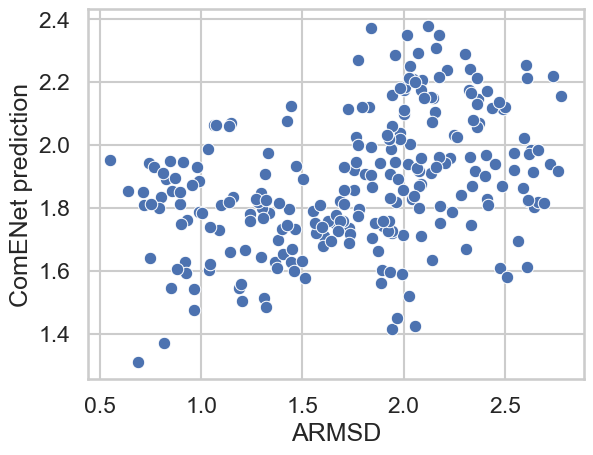

(0.39489153164739643, 9.3151214342258e-11)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


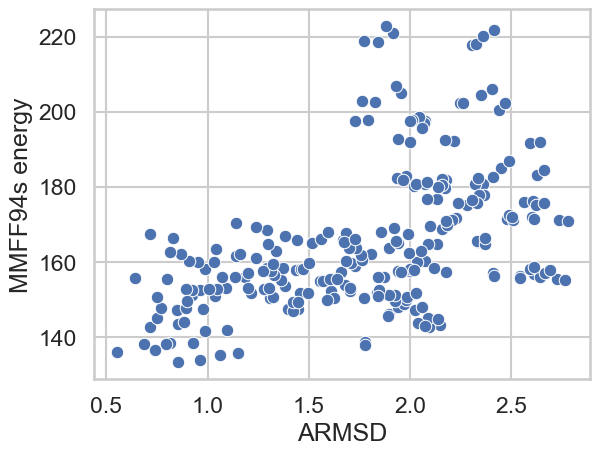

(0.4894360213604282, 1.828775179873511e-16)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


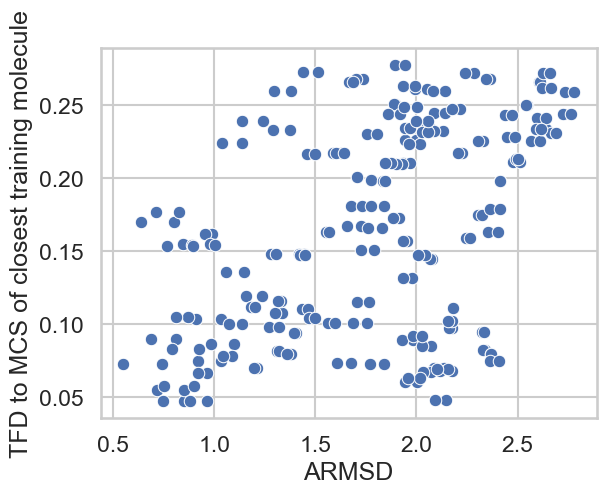

(0.44927662582984335, 8.010483951244374e-14)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.41007194244604317
20U


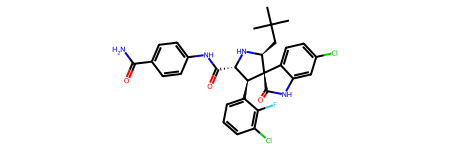

[['4lwu' '2.3.2.27']]


In [74]:
mol, closest_mol = analyse_pdb('4lwv')

In [686]:
pdb_id = '3uol'
ligand_name = '0C7'

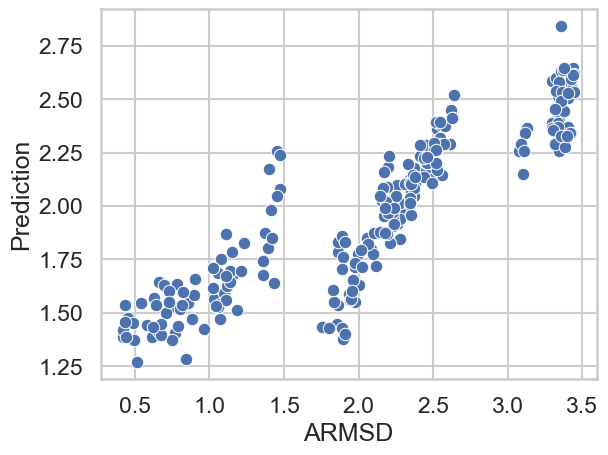

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


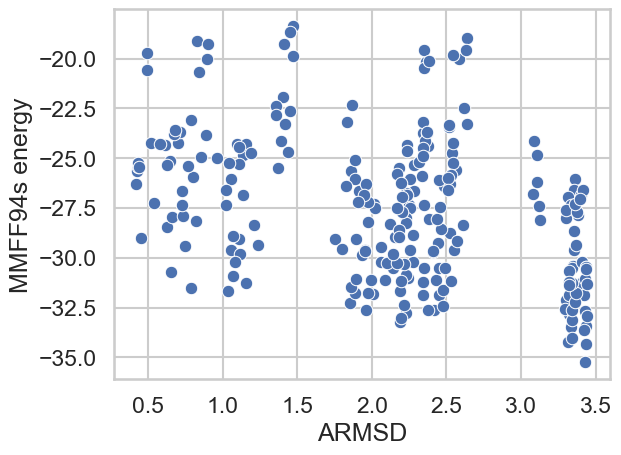

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


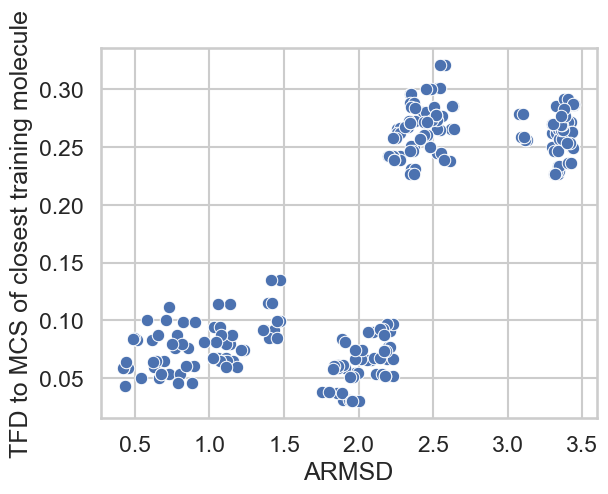

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.5921052631578947
0BY


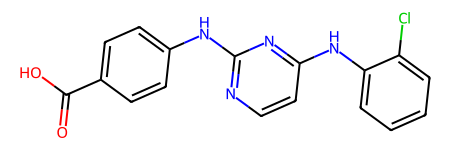

[['3uo6' '2.7.11.1']
 ['3unk' '2.7.11.22']]


In [687]:
mol, closest_mol = analyse_pdb(pdb_id)

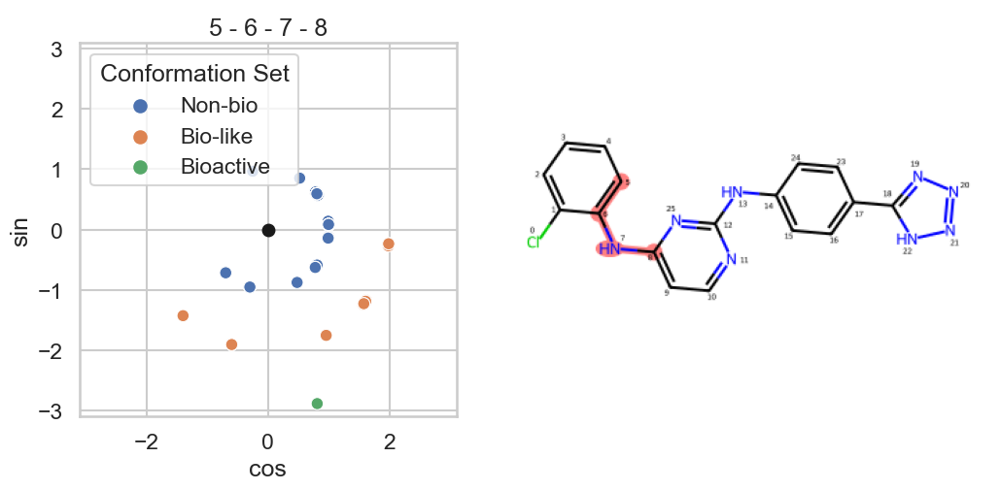

<Figure size 640x480 with 0 Axes>

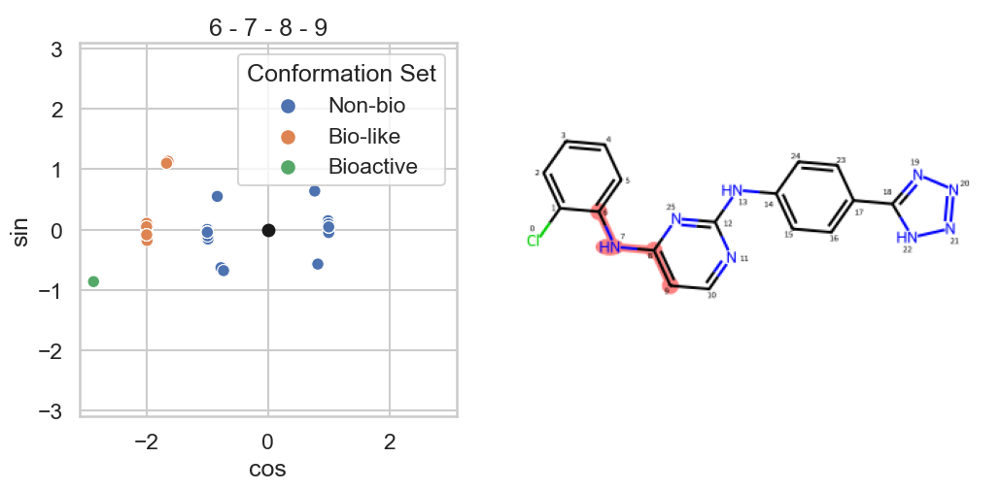

<Figure size 640x480 with 0 Axes>

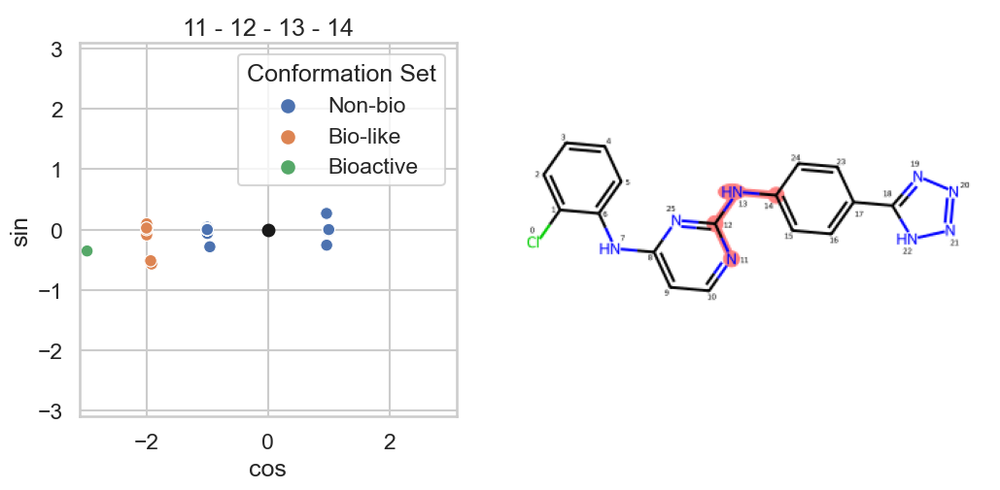

<Figure size 640x480 with 0 Axes>

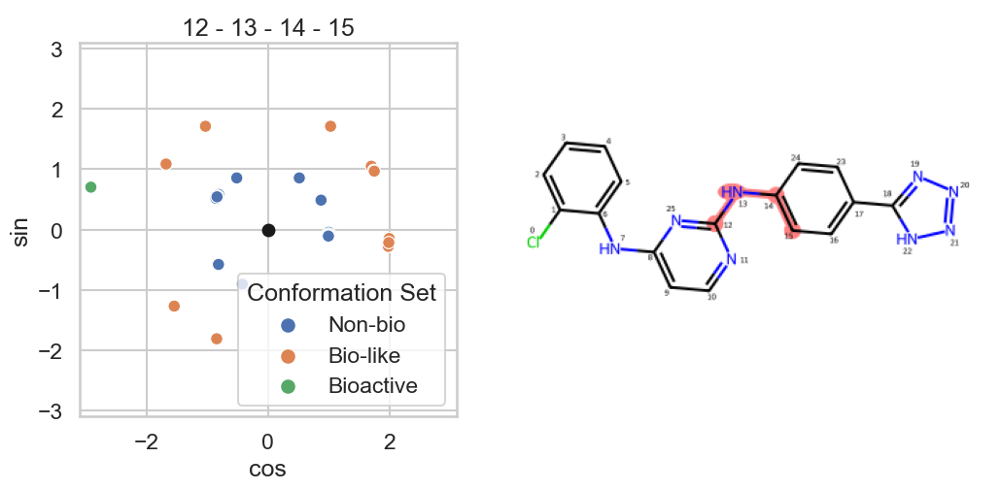

<Figure size 640x480 with 0 Axes>

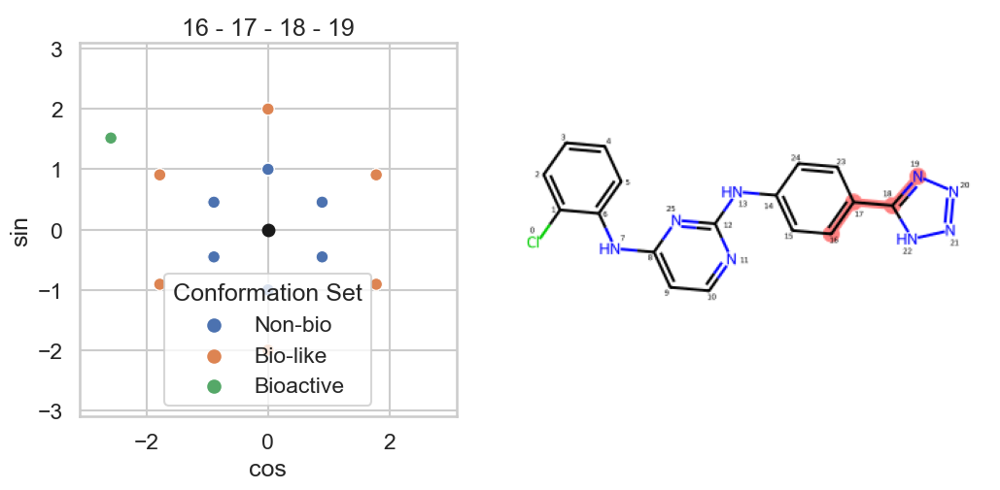

<Figure size 640x480 with 0 Axes>

In [688]:
gen_mol = analyze_torsions(ligand_name, pdb_id)

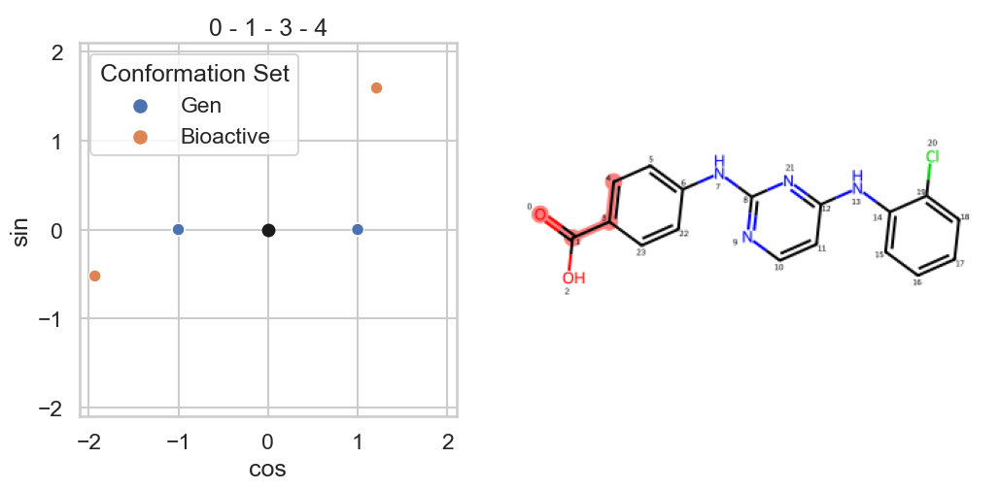

<Figure size 640x480 with 0 Axes>

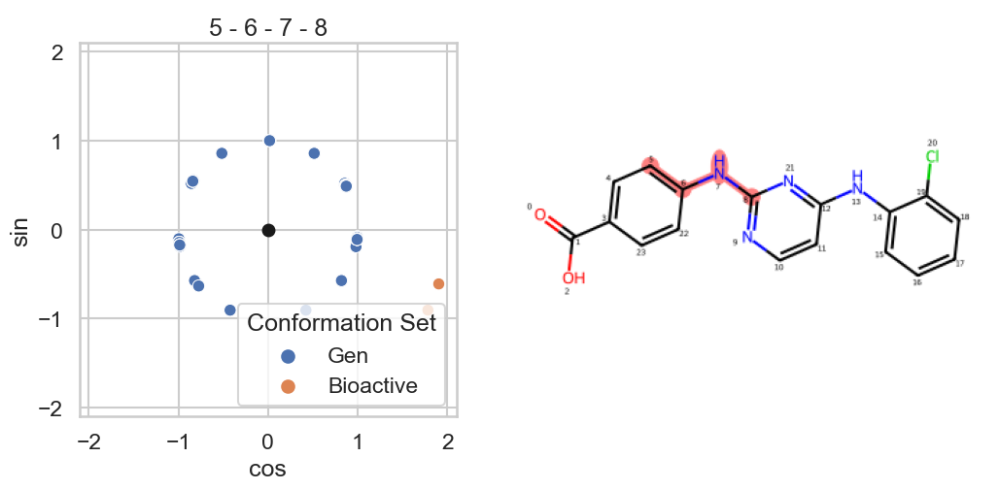

<Figure size 640x480 with 0 Axes>

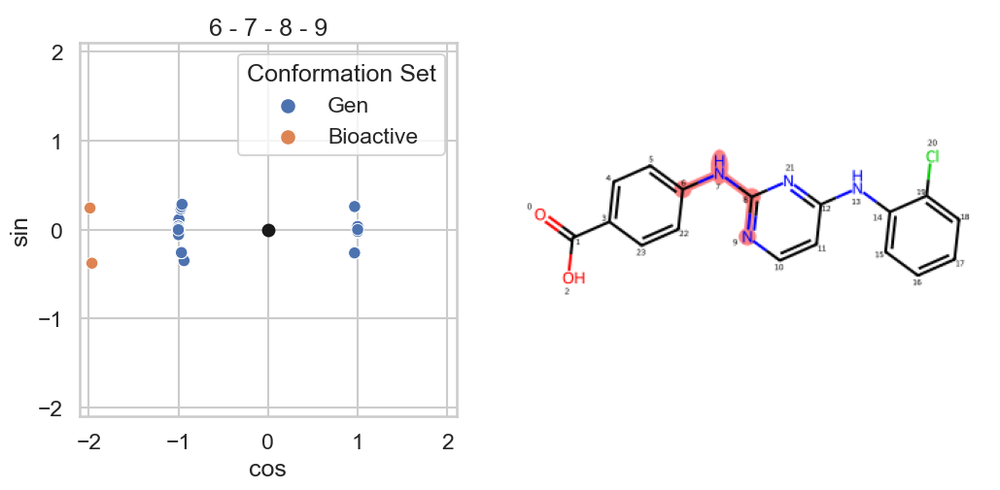

<Figure size 640x480 with 0 Axes>

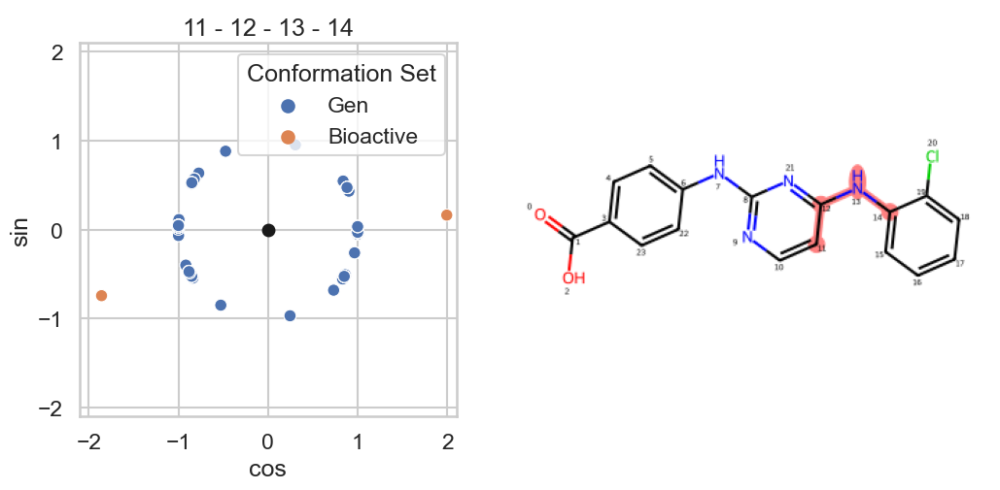

<Figure size 640x480 with 0 Axes>

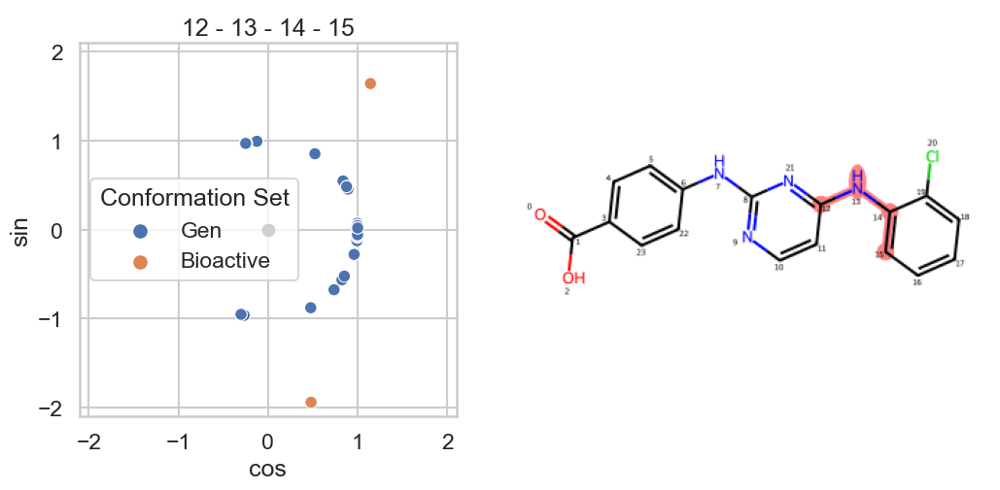

<Figure size 640x480 with 0 Axes>

In [689]:
gen_mol2 = analyze_torsions('0BY', '3uo6', have_bio_like=False)

In [690]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

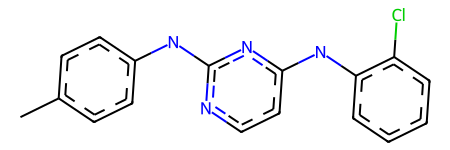

In [691]:
table1, table2, d_idxs, ac1, ac2 = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=30)

In [692]:
d_idxs

[(5, 6, 7, 8), (6, 7, 8, 9), (11, 12, 13, 14), (12, 13, 14, 15)]

In [693]:
table1.head()

,preds,targets,0,1,2,3
0,1.945923,2.242506,-30.0,180.0,-0.0,-0.0
1,1.986371,2.276252,-30.0,180.0,-0.0,-0.0
2,1.477454,0.454411,-30.0,180.0,180.0,-0.0
3,1.569134,0.627803,-30.0,180.0,180.0,-0.0
4,2.275115,2.418744,30.0,-180.0,-0.0,-0.0


In [694]:
table2.head()

,preds,0,1,2,3
0,1.807842,-0.0,180.0,-0.0,-0.0
1,1.821702,-0.0,180.0,-0.0,-0.0
2,1.008754,0.0,-180.0,-180.0,30.0
3,0.884855,0.0,-180.0,-180.0,30.0
4,0.684804,-0.0,180.0,180.0,150.0


In [695]:
indexes = [i for i in range(len(d_idxs))]
merged_table = table1.merge(table2, on=indexes)

In [696]:
len(merged_table)

44

<AxesSubplot:xlabel='preds_x', ylabel='preds_y'>

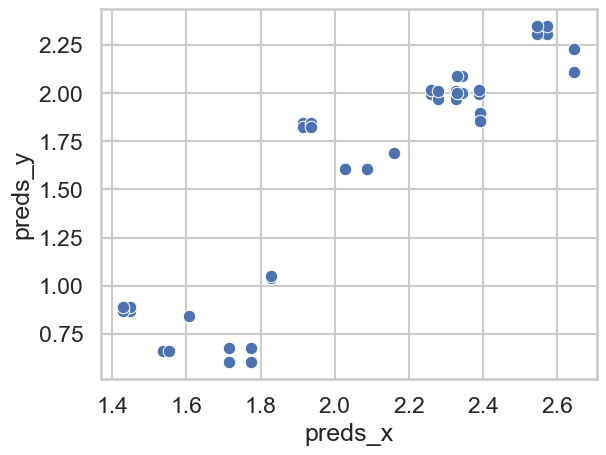

In [697]:
sns.scatterplot(data=merged_table, x='preds_x', y='preds_y')

<AxesSubplot:xlabel='targets', ylabel='preds_y'>

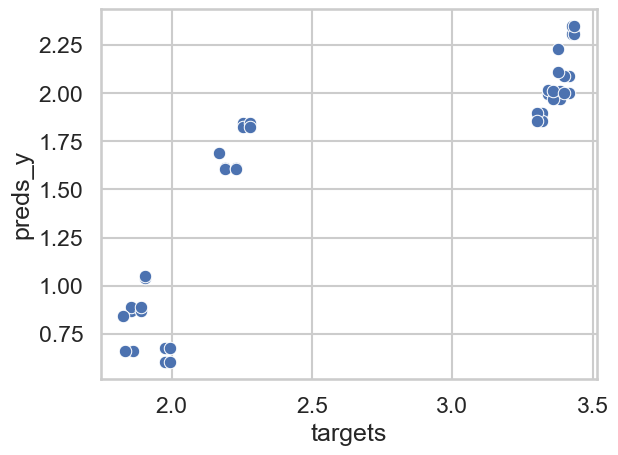

In [698]:
sns.scatterplot(data=merged_table, x='targets', y='preds_y')

In [389]:
pdb_id = '3ivh'
ligand_name = '1LI'

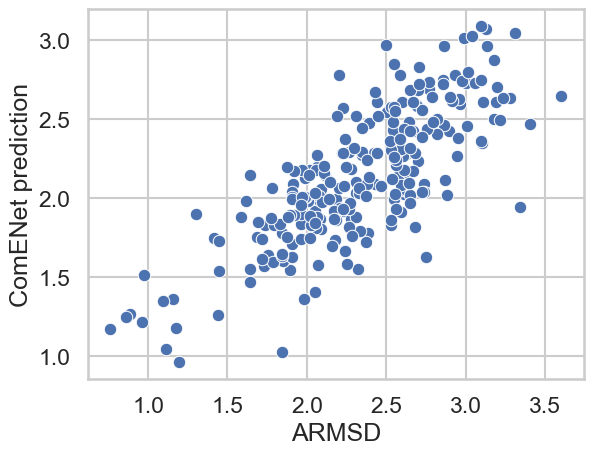

(0.7823660158044612, 6.478873073138095e-53)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


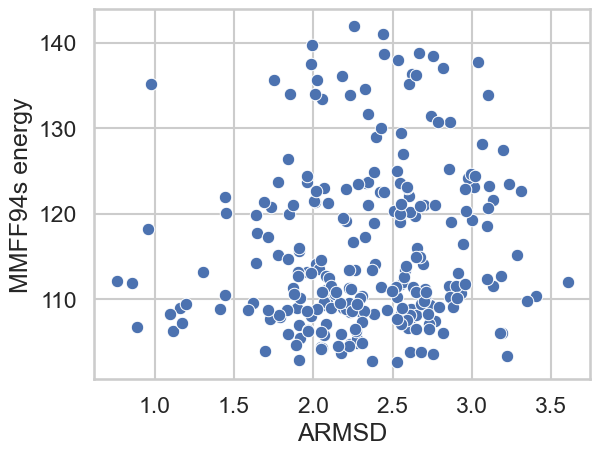

(0.12535984452521964, 0.04770383525338798)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


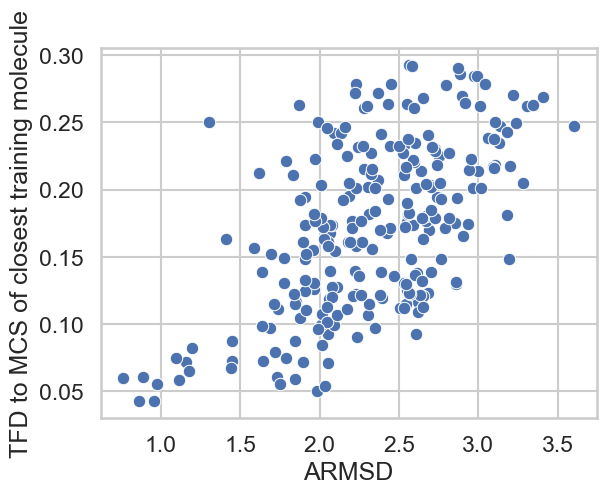

(0.5861624155035087, 1.8324022132693696e-24)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.6288659793814433
842


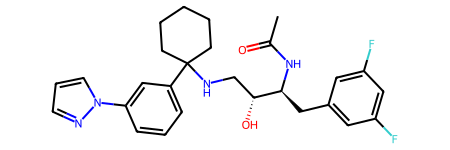

[['3n4l' '3.4.23.46']]


In [390]:
mol, closest_mol = analyse_pdb(pdb_id)

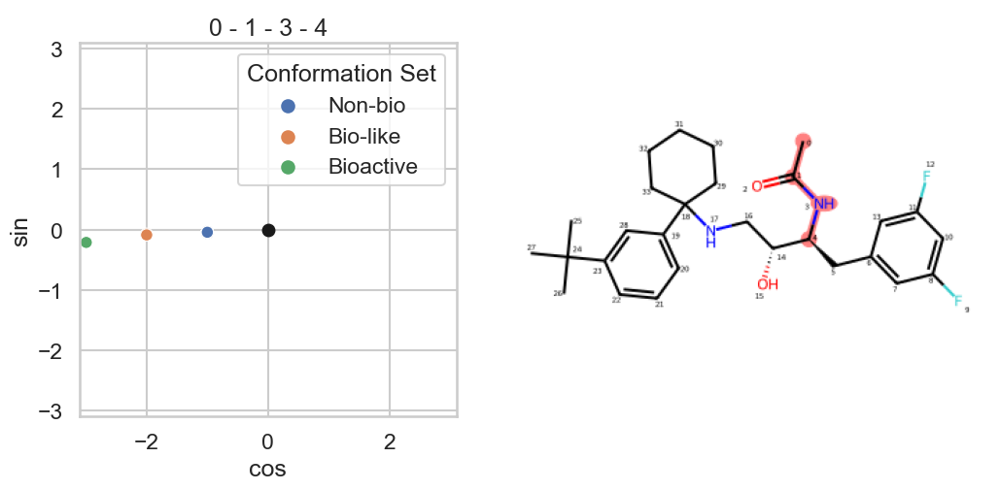

<Figure size 640x480 with 0 Axes>

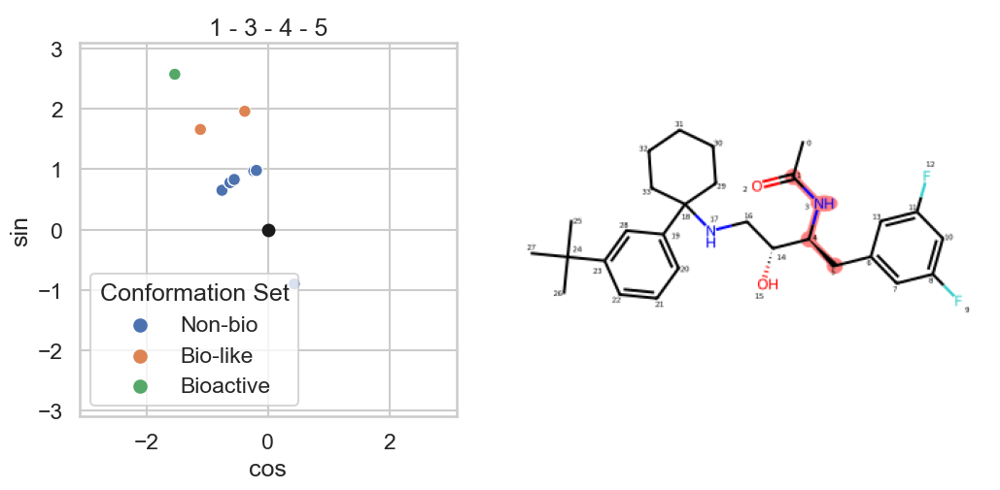

<Figure size 640x480 with 0 Axes>

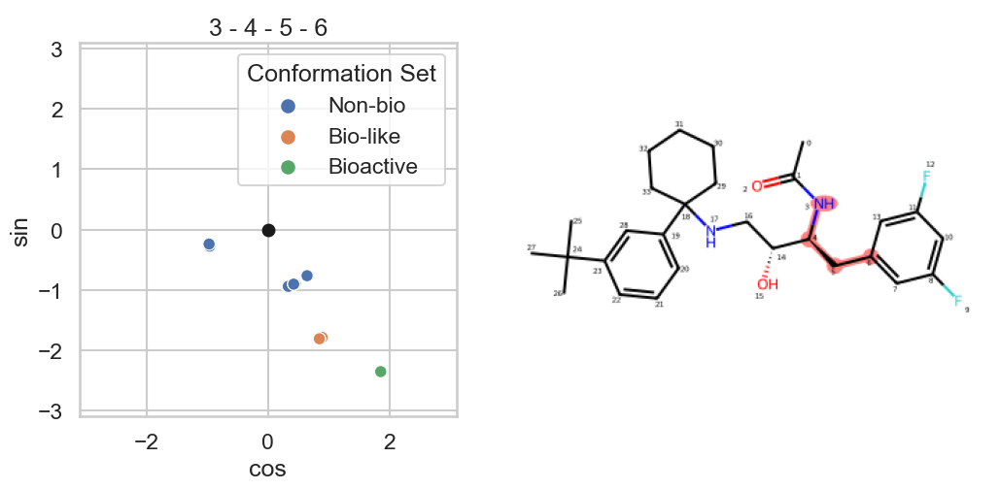

<Figure size 640x480 with 0 Axes>

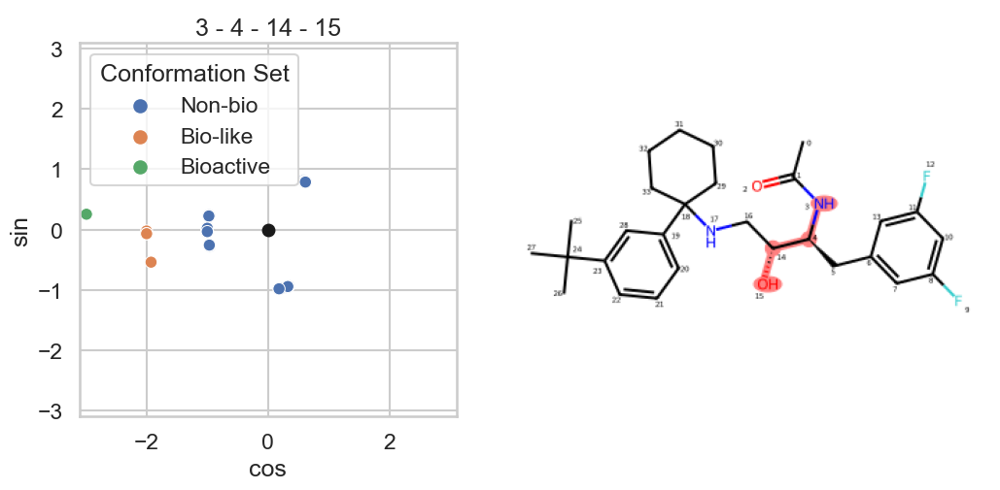

<Figure size 640x480 with 0 Axes>

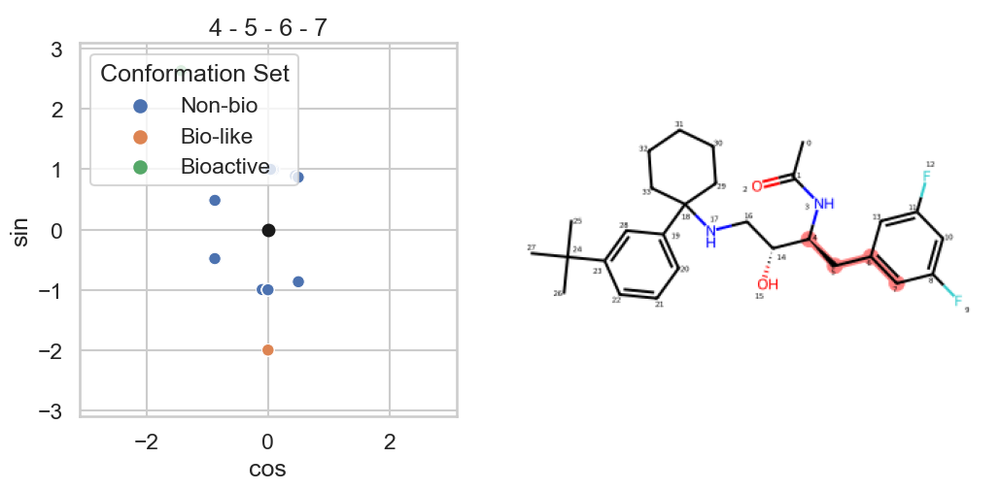

<Figure size 640x480 with 0 Axes>

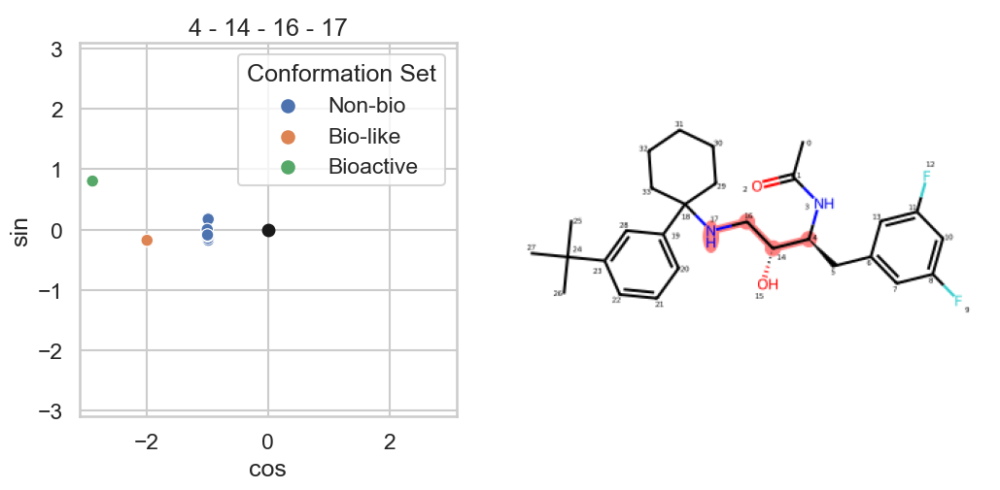

<Figure size 640x480 with 0 Axes>

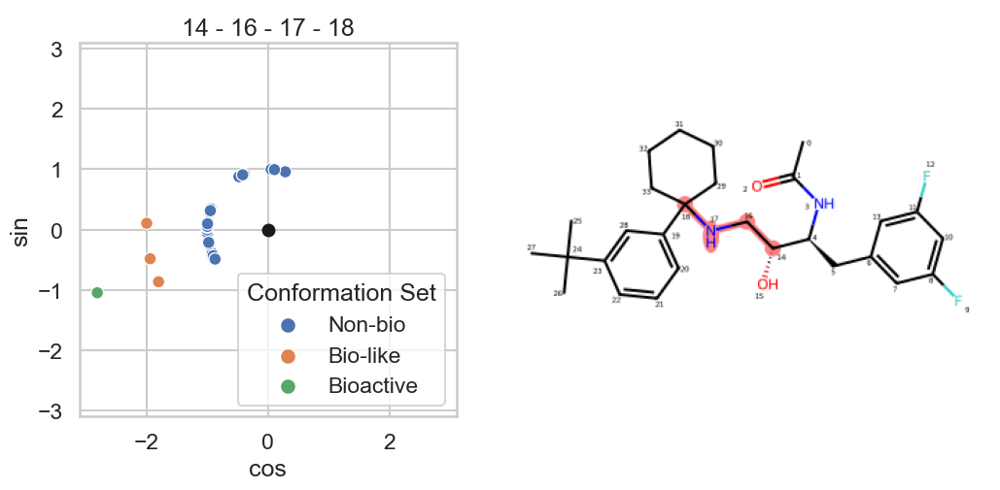

<Figure size 640x480 with 0 Axes>

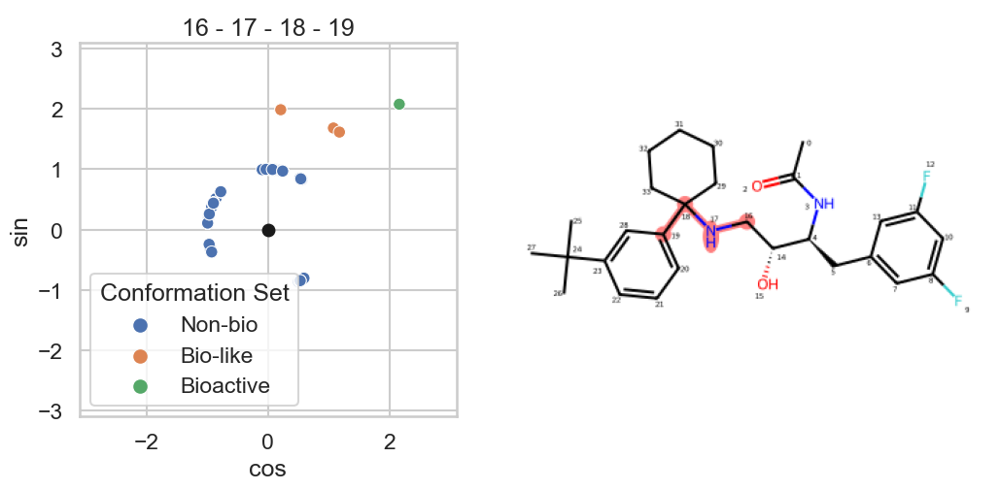

<Figure size 640x480 with 0 Axes>

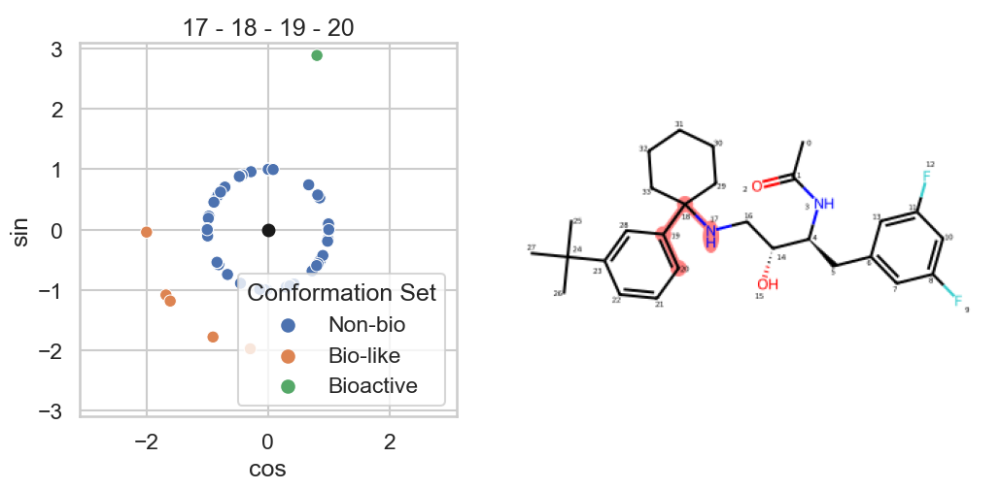

<Figure size 640x480 with 0 Axes>

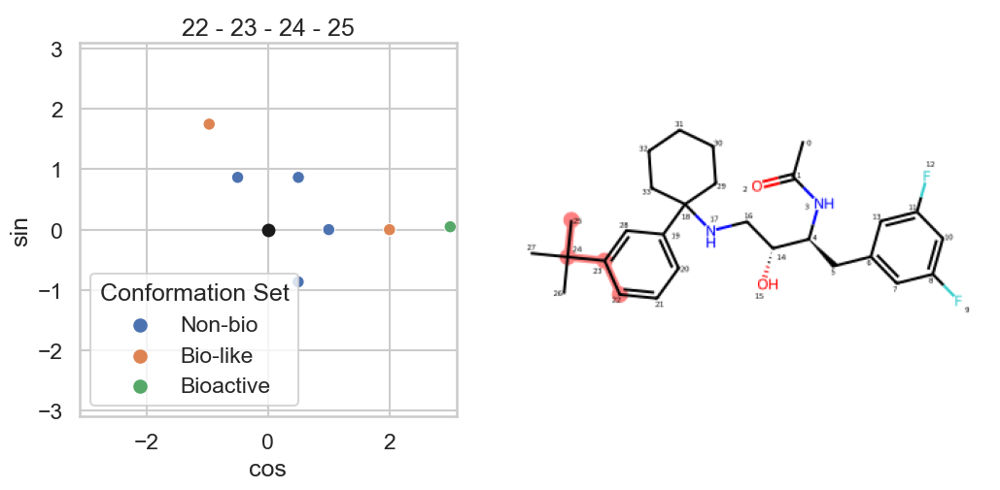

<Figure size 640x480 with 0 Axes>

In [391]:
gen_mol = analyze_torsions(ligand_name, pdb_id)

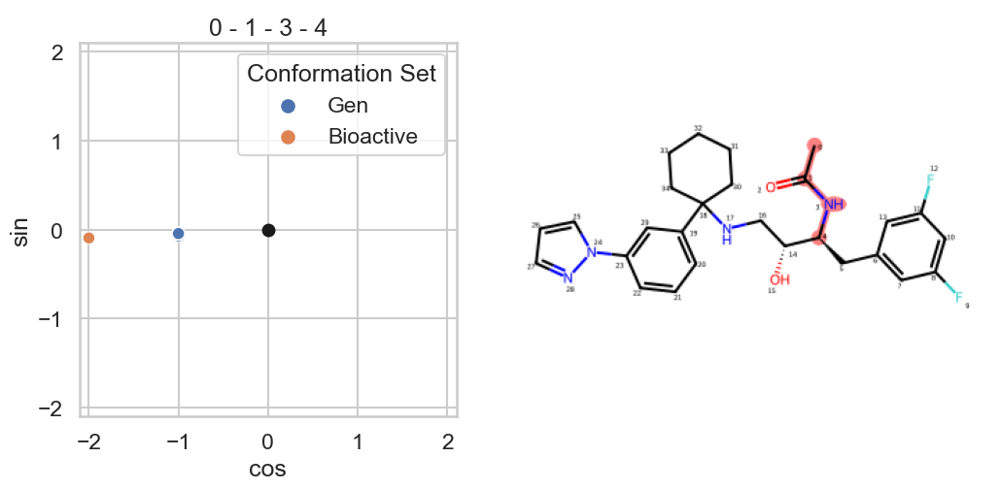

<Figure size 640x480 with 0 Axes>

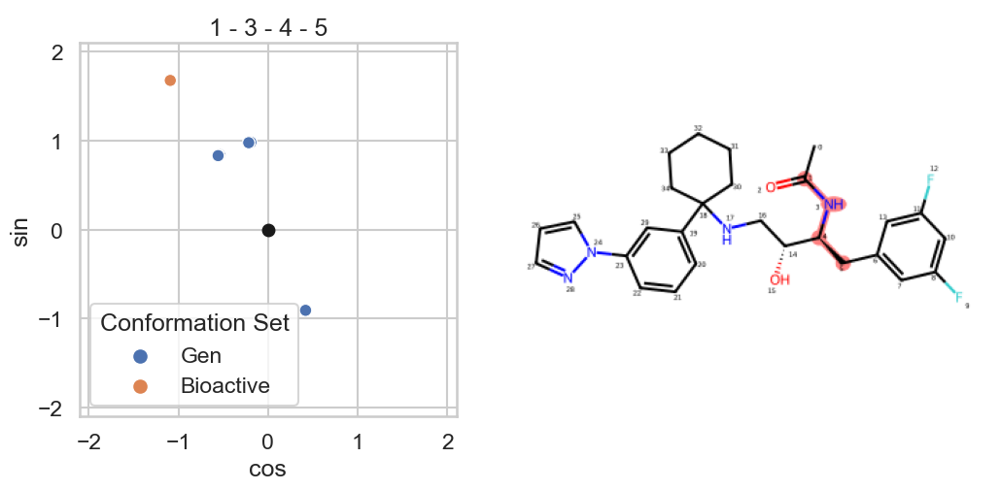

<Figure size 640x480 with 0 Axes>

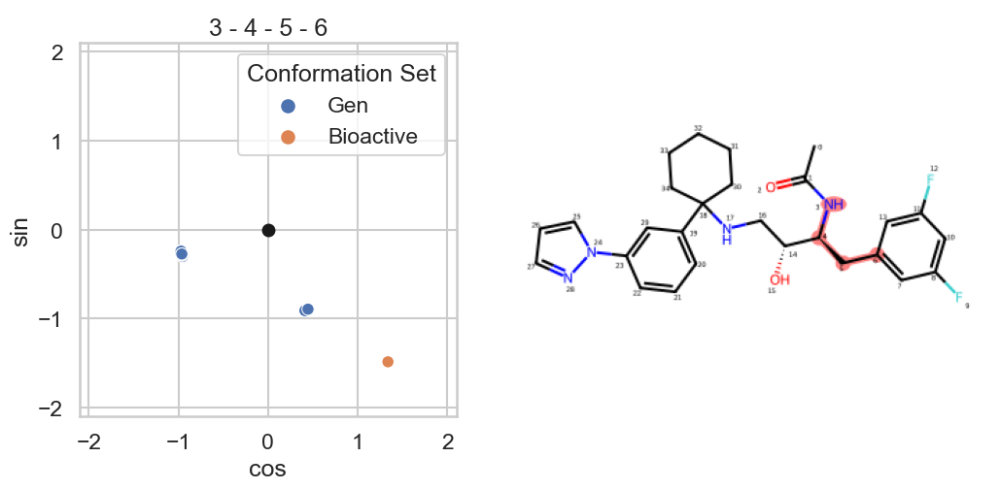

<Figure size 640x480 with 0 Axes>

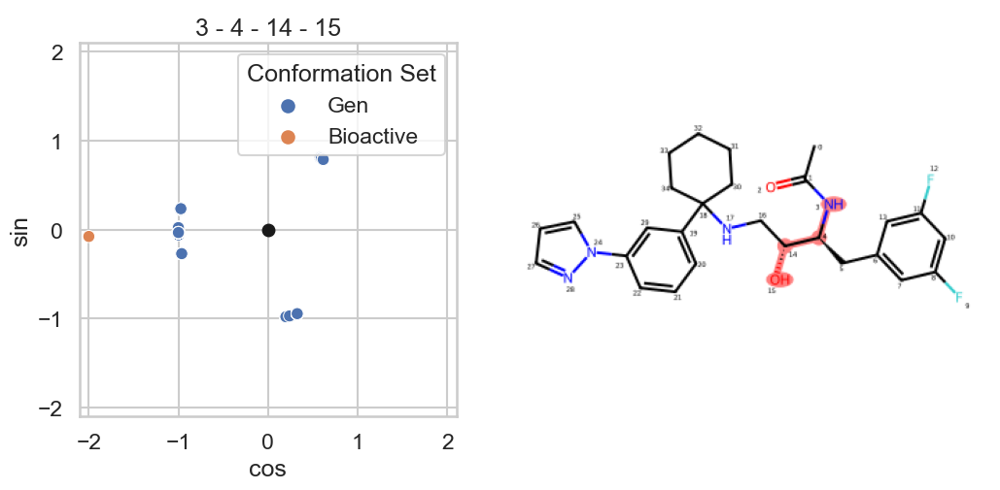

<Figure size 640x480 with 0 Axes>

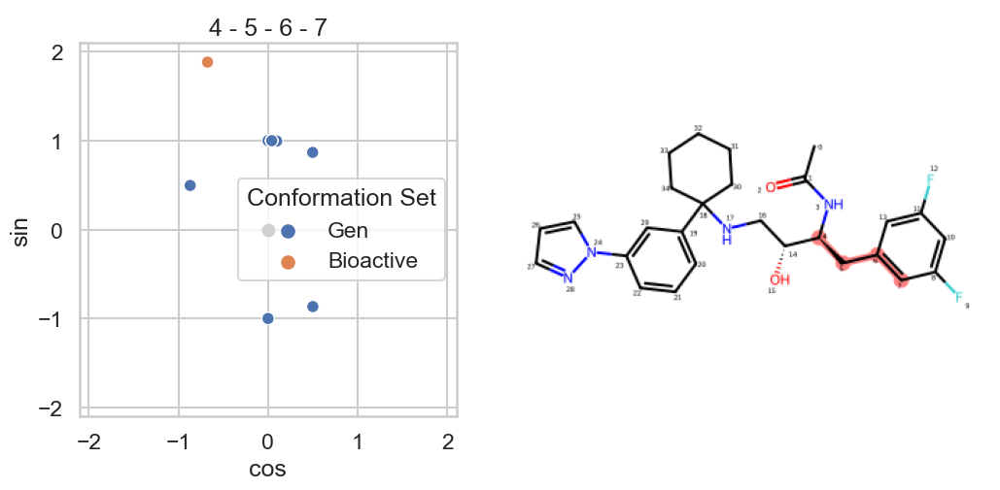

<Figure size 640x480 with 0 Axes>

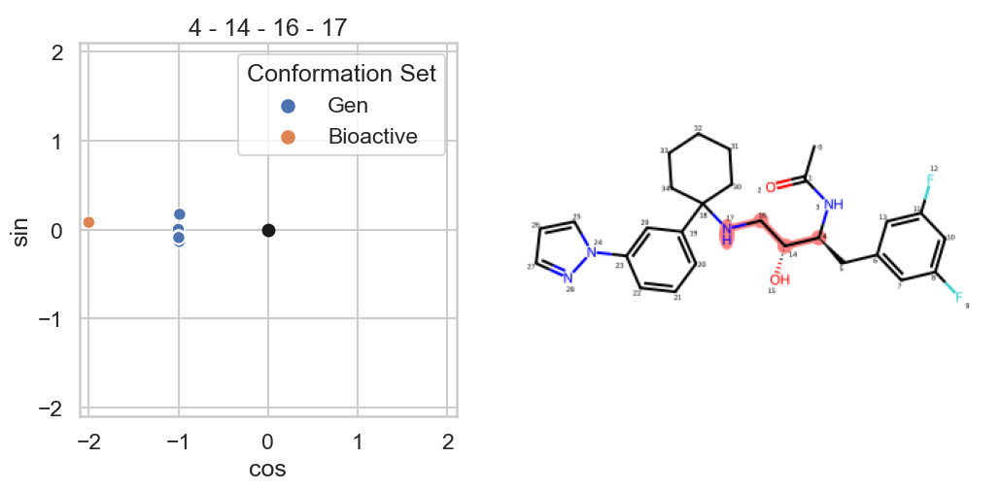

<Figure size 640x480 with 0 Axes>

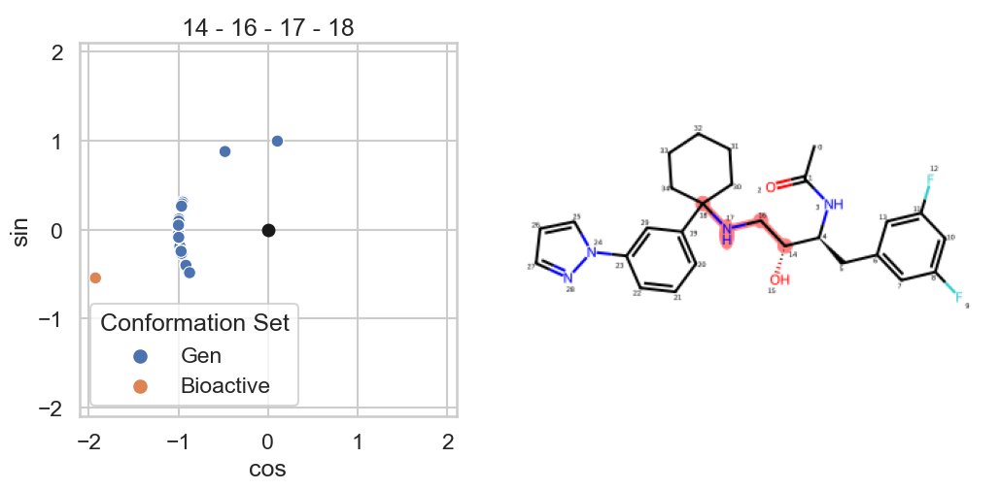

<Figure size 640x480 with 0 Axes>

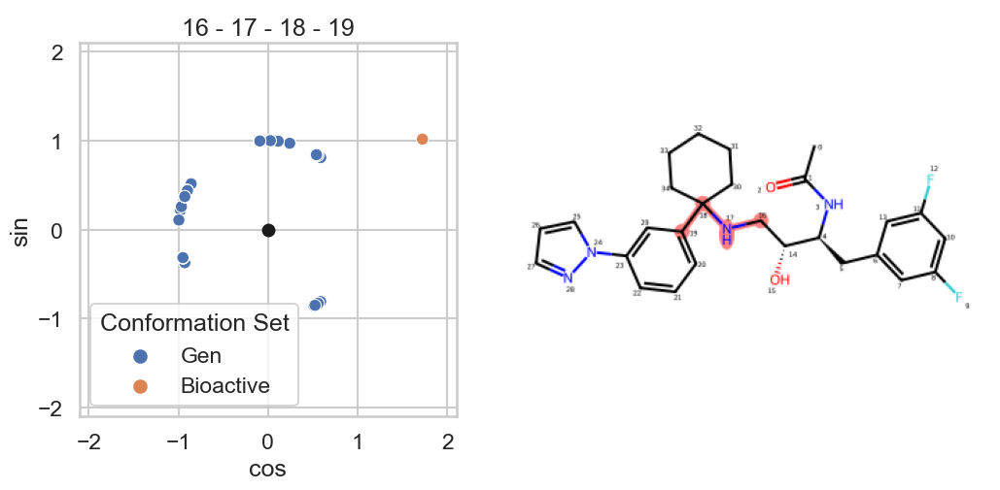

<Figure size 640x480 with 0 Axes>

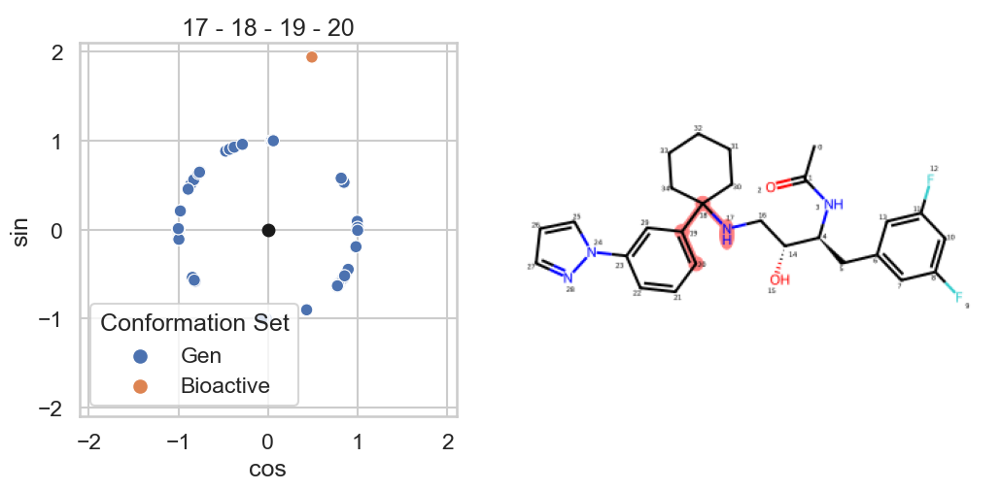

<Figure size 640x480 with 0 Axes>

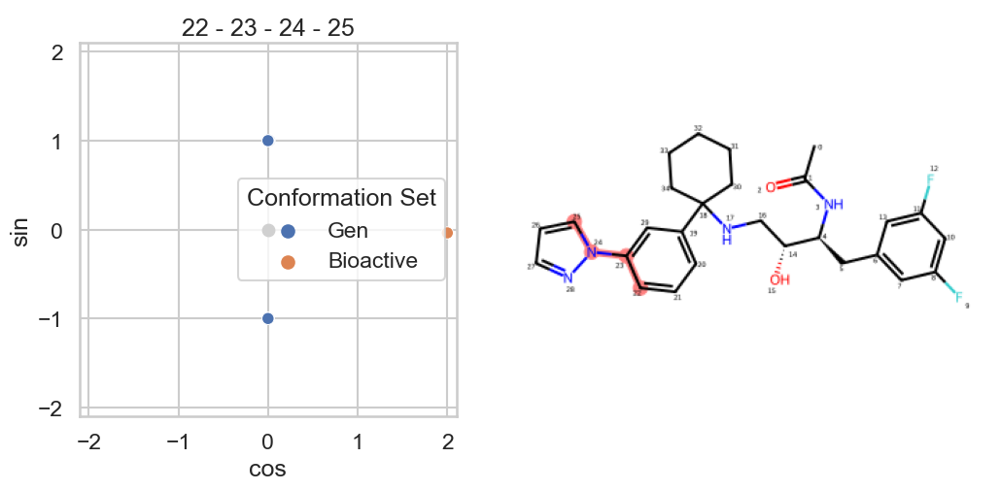

<Figure size 640x480 with 0 Axes>

In [392]:
gen_mol2 = analyze_torsions('842', '3n4l', have_bio_like=False)

In [393]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

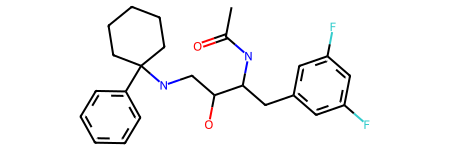

In [394]:
table1, table2, d_idxs, ac1, ac2 = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=5)

In [395]:
d_idxs

[(0, 1, 3, 4),
 (1, 3, 4, 5),
 (3, 4, 5, 6),
 (3, 4, 14, 15),
 (4, 5, 6, 7),
 (4, 14, 16, 17),
 (14, 16, 17, 18),
 (16, 17, 18, 19),
 (17, 18, 19, 20)]

In [396]:
table1.head()

,preds,targets,0,1,2,3,4,5,6,7,8
0,2.543896,2.507648,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,155.0,-0.0
1,1.773076,1.736678,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,155.0,-180.0
2,2.200602,2.062069,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,-55.0,-40.0
3,2.025492,2.614726,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,-55.0,140.0
4,1.544447,1.894717,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,85.0,0.0


In [397]:
table2.head()

,preds,0,1,2,3,4,5,6,7,8
0,2.605392,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,155.0,-0.0
1,2.678051,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,155.0,-0.0
2,1.512730,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,155.0,-180.0
3,1.417226,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,155.0,-180.0
4,2.306566,-175.0,125.0,-65.0,-180.0,-90.0,-175.0,175.0,-55.0,-40.0


In [398]:
indexes = [i for i in range(len(d_idxs))]
merged_table = table1.merge(table2, on=indexes)

In [399]:
len(merged_table)

122

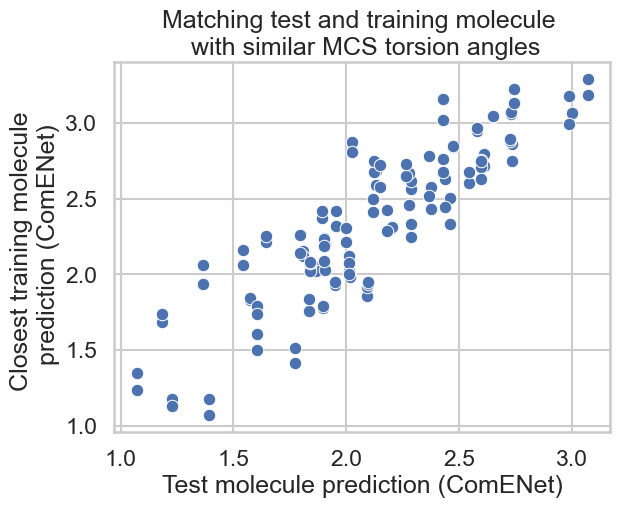

In [400]:
sns.scatterplot(data=merged_table, 
                x='preds_x', 
                y='preds_y')
plt.xlabel('Test molecule prediction (ComENet)')
plt.ylabel('Closest training molecule \n prediction (ComENet)')
plt.title('Matching test and training molecule \n with similar MCS torsion angles')
plt.savefig(os.path.join(figure_dir, f'{pdb_id}_matching_mcs_preds.png'), 
            dpi=300,
           bbox_inches='tight')

In [298]:
pearsonr(merged_table['preds_x'], merged_table['preds_y'])

(0.8790311825194992, 2.0551554418427048e-40)

In [340]:
pdbbind_table[pdbbind_table['PDB code'] == '6ma1']

,PDB code,resolution,release year_x,-logKd/Ki,Kd/Ki,reference,ligand name,activity_list,sep,value,...,protein name,active,enzyme_id,class_name,uniprot_id,enzyme_name,level_1,level_2,level_3,level_4
10612,6ma1,2.75,2018,8.1,Kd=0.008uM //,6ma1.pdf,JA4,"[uM, =, 0.008]",=,8.0,...,UDP-N-ACETYLGLUCOSAMINE--PEPTIDE N,True,2.4.1.255,protein O-GlcNAc transferase.,O15294,OGT1_HUMAN,2,2.4,2.4.1,2.4.1.255


In [338]:
p[p['PDB code'] == '6ma1']

Ranker,PDB code,ligand name,ComENet,DimeNet++,Generation order,MMFF94s energy,SchNet,Shuffle,TFD2RefMCS,S-M
595,6ma1,JA4,0.1,0.07,0.103,0.492,0.0,0.086,0.897,-0.797


In [428]:
pdb_id = '6ma1'
# ligand_name = '1LI'

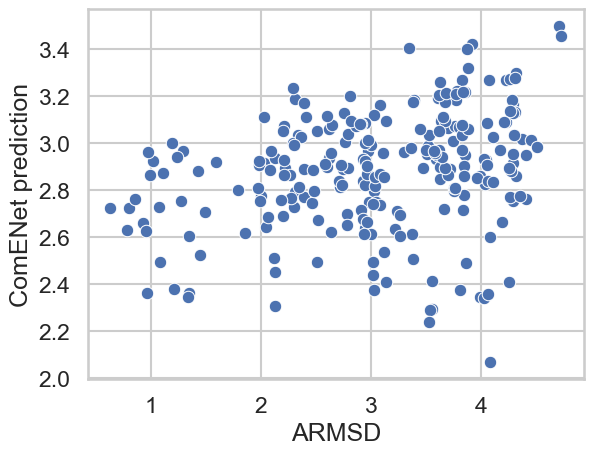

(0.29383827261022616, 2.27321045718019e-06)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


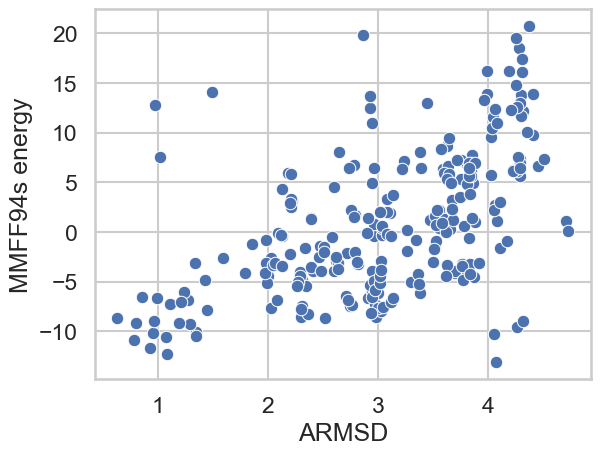

(0.545345391128695, 9.021534348062837e-21)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


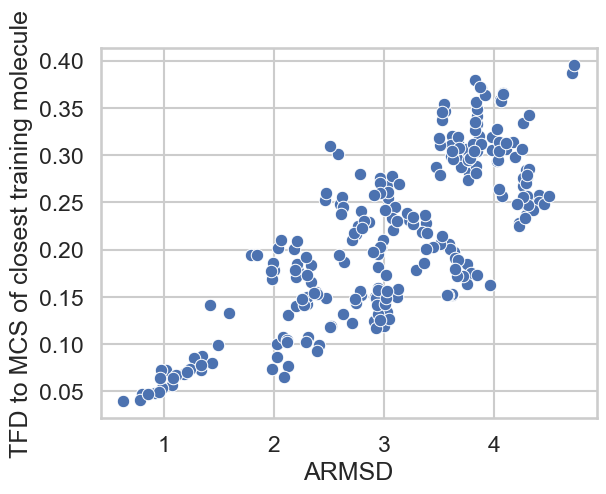

(0.7849903079976499, 1.721790466482912e-53)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.7
J9V


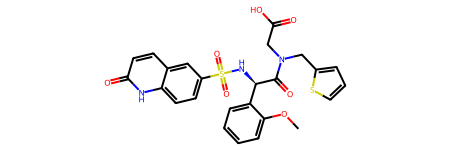

[['6ma5' '2.4.1.255']]


In [429]:
mol, closest_mol = analyse_pdb(pdb_id)

In [430]:
gen_mol = Chem.RemoveHs(mol)

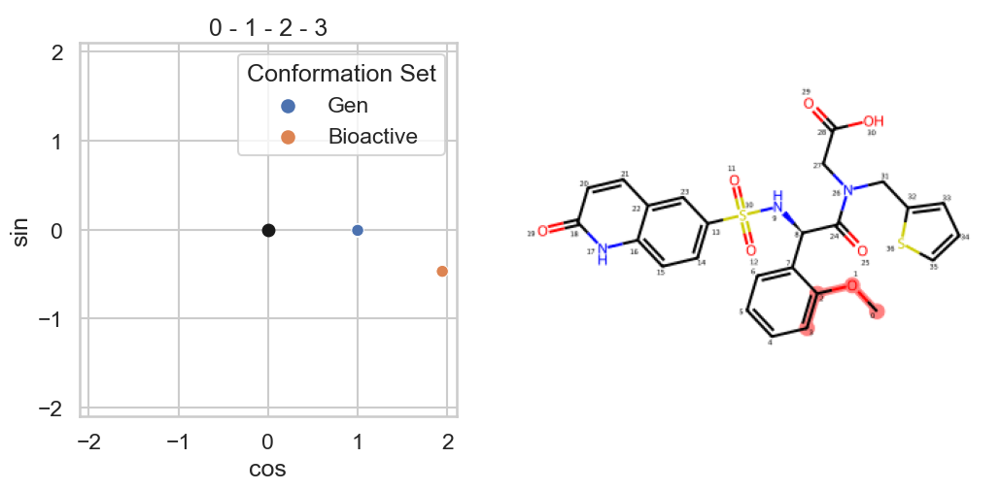

<Figure size 640x480 with 0 Axes>

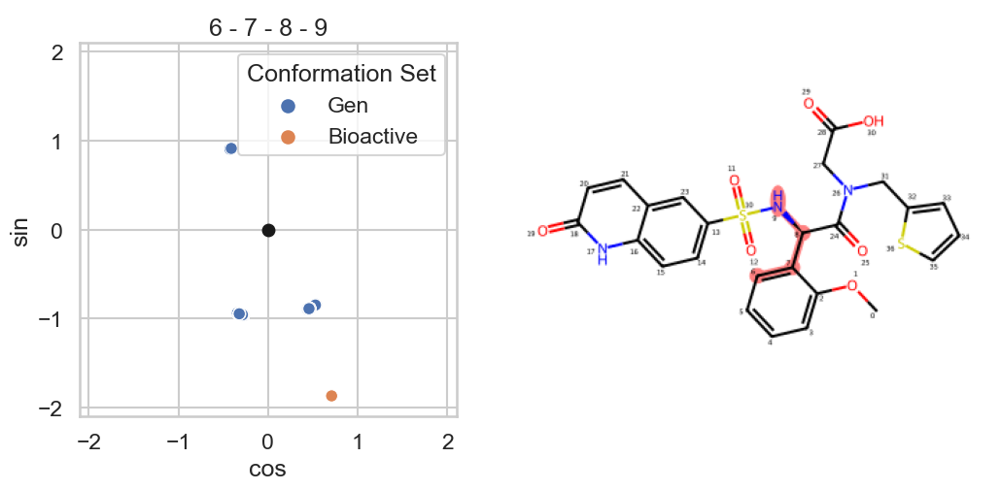

<Figure size 640x480 with 0 Axes>

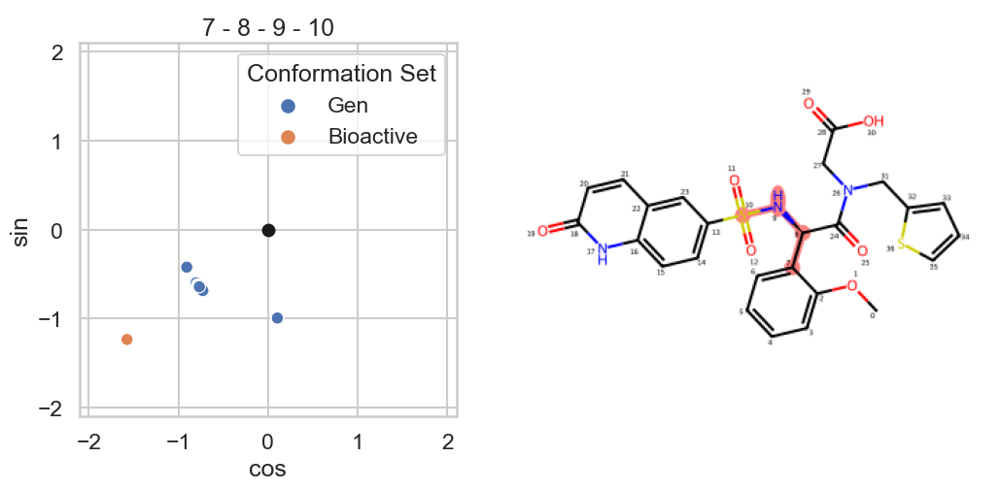

<Figure size 640x480 with 0 Axes>

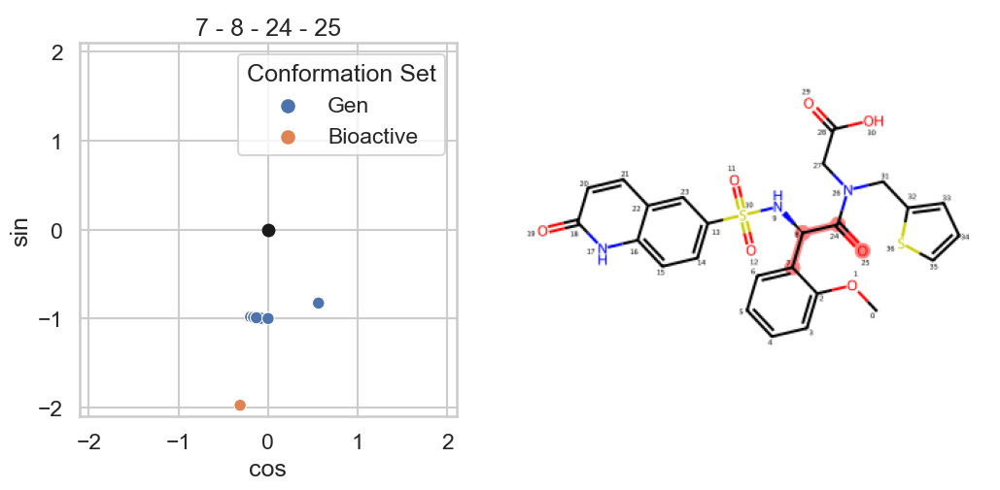

<Figure size 640x480 with 0 Axes>

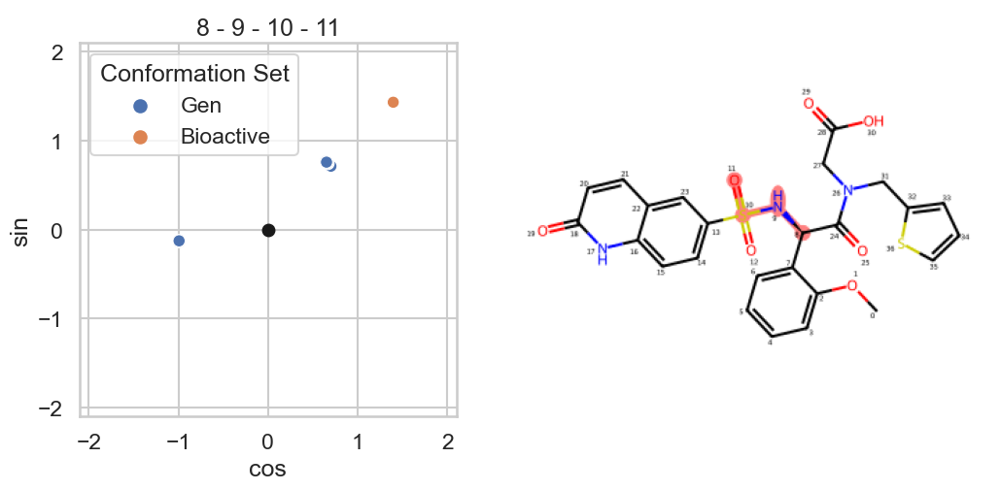

<Figure size 640x480 with 0 Axes>

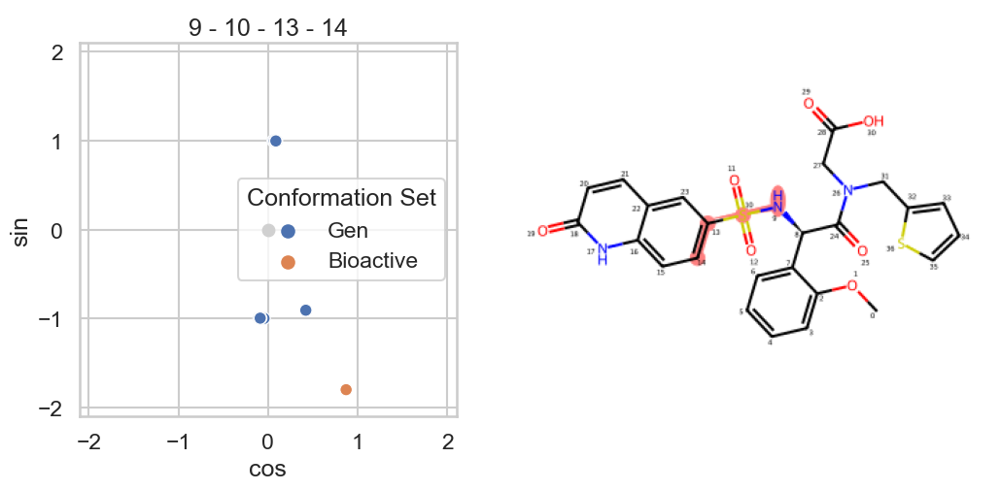

<Figure size 640x480 with 0 Axes>

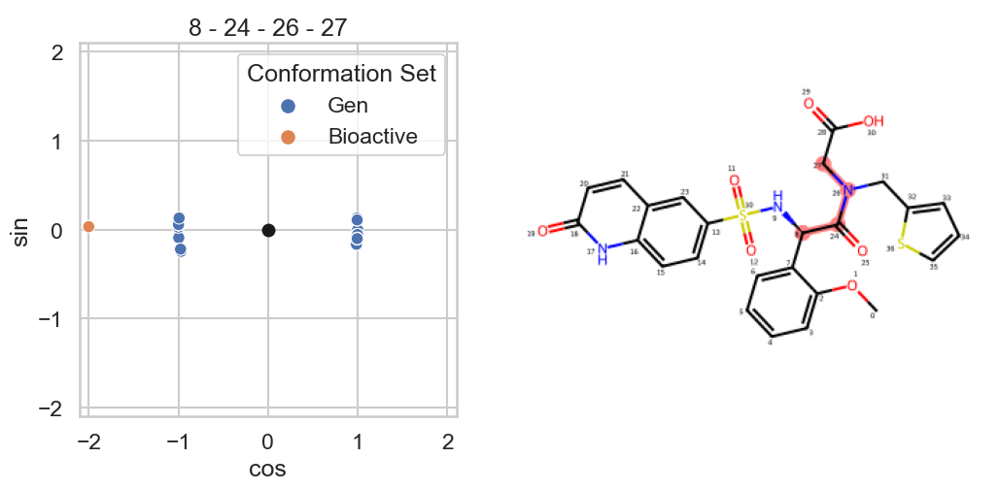

<Figure size 640x480 with 0 Axes>

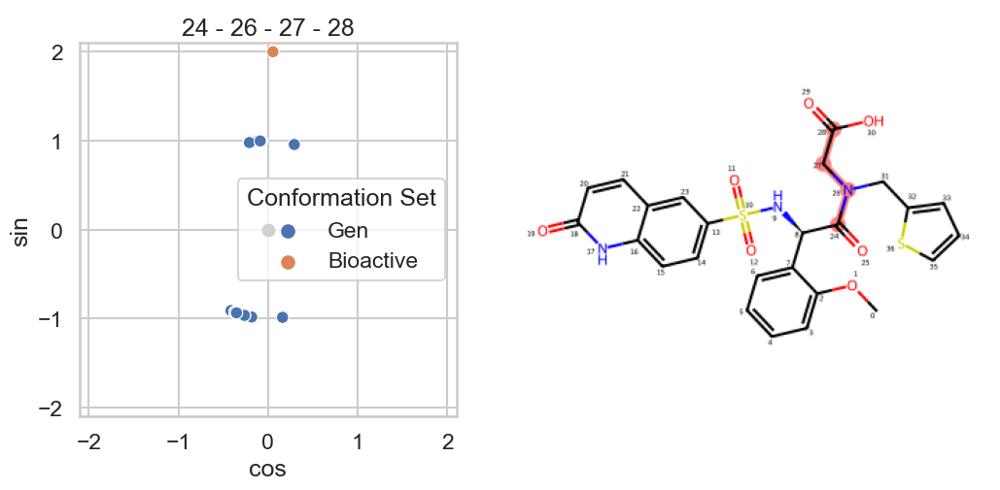

<Figure size 640x480 with 0 Axes>

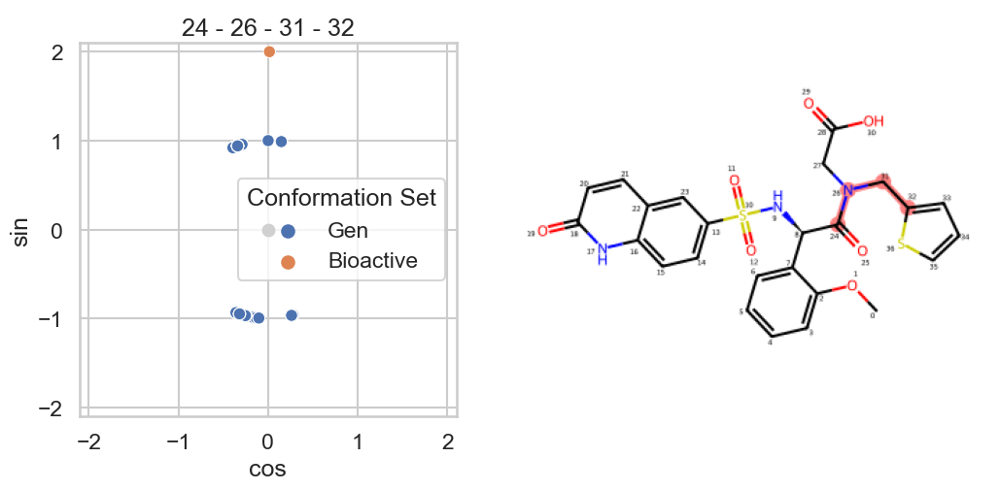

<Figure size 640x480 with 0 Axes>

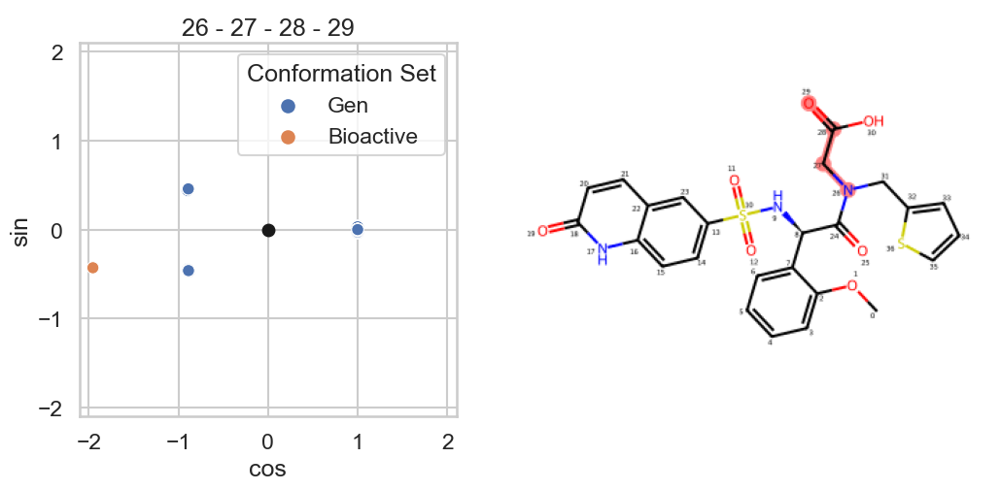

<Figure size 640x480 with 0 Axes>

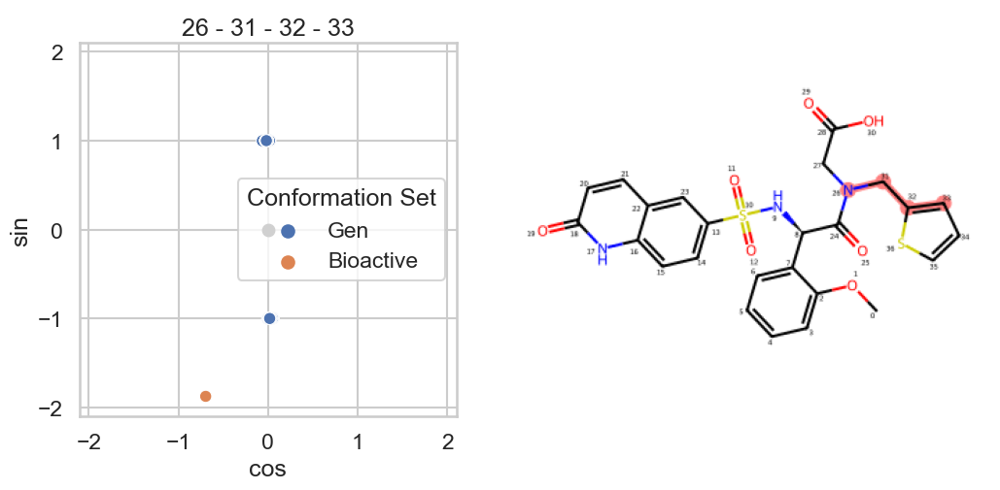

<Figure size 640x480 with 0 Axes>

In [431]:
gen_mol2 = analyze_torsions('J9V', '6ma5', have_bio_like=False)

In [432]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

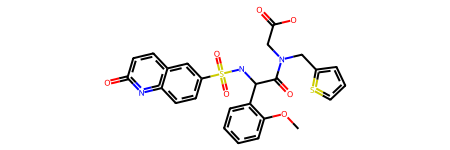

In [433]:
table1, table2, d_idxs, ac1, ac2 = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=30)

In [434]:
d_idxs

[(0, 1, 2, 3),
 (6, 7, 8, 9),
 (7, 8, 9, 10),
 (7, 8, 25, 26),
 (8, 9, 10, 11),
 (9, 10, 13, 14),
 (8, 25, 27, 28),
 (25, 27, 28, 29),
 (25, 27, 32, 33),
 (27, 28, 29, 30),
 (27, 32, 33, 34)]

In [435]:
table1.head()

,preds,targets,0,1,2,3,4,5,6,7,8,9,10
0,3.004903,2.983732,-0.0,-120.0,-150.0,-90.0,60.0,120.0,-0.0,90.0,120.0,-0.0,-90.0
1,3.043849,3.026475,-0.0,-120.0,-150.0,-90.0,60.0,120.0,-0.0,90.0,120.0,-0.0,90.0
2,3.280719,1.998379,-0.0,-120.0,-150.0,-90.0,60.0,120.0,-0.0,-120.0,-120.0,0.0,-90.0
3,3.292239,1.992392,-0.0,-120.0,-150.0,-90.0,60.0,120.0,-0.0,-120.0,-120.0,0.0,90.0
4,2.558027,4.288468,-0.0,-120.0,-150.0,-90.0,-180.0,120.0,-0.0,-120.0,-120.0,0.0,-90.0


In [436]:
table2.head()

,preds,0,1,2,3,4,5,6,7,8,9,10
0,3.211981,-0.0,-120.0,-150.0,-90.0,-180.0,90.0,-0.0,90.0,120.0,0.0,-90.0
1,3.060455,-0.0,-120.0,-150.0,-90.0,-180.0,90.0,-0.0,90.0,120.0,0.0,90.0
2,2.565644,-0.0,-120.0,-150.0,-90.0,-180.0,90.0,-0.0,-120.0,-90.0,-0.0,-90.0
3,2.676628,-0.0,-120.0,-150.0,-90.0,-180.0,90.0,-0.0,-120.0,-90.0,-0.0,90.0
4,3.051373,-0.0,-120.0,-150.0,-90.0,60.0,-90.0,-0.0,-120.0,-90.0,-0.0,90.0


In [437]:
indexes = [i for i in range(len(d_idxs))]
merged_table = table1.merge(table2, on=indexes)

In [438]:
len(merged_table)

9

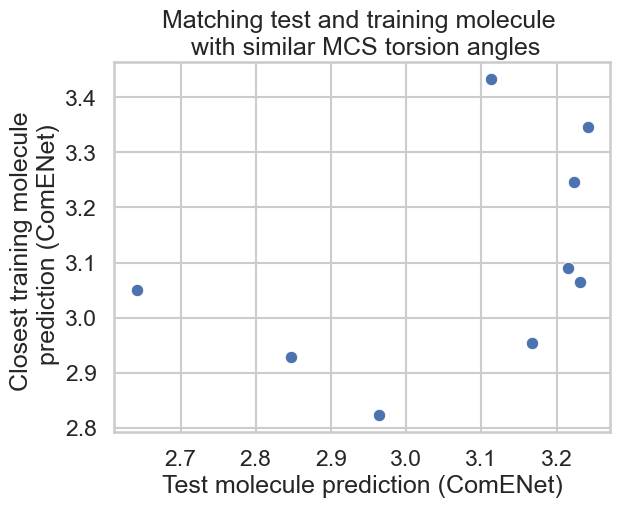

In [440]:
sns.scatterplot(data=merged_table, 
                x='preds_x', 
                y='preds_y')
plt.xlabel('Test molecule prediction (ComENet)')
plt.ylabel('Closest training molecule \n prediction (ComENet)')
plt.title('Matching test and training molecule \n with similar MCS torsion angles')
plt.savefig(os.path.join(figure_dir, f'{pdb_id}_matching_mcs_preds.png'), 
            dpi=300,
           bbox_inches='tight')

In [413]:
pearsonr(merged_table['preds_x'], merged_table['preds_y'])

(0.028324973692823163, 0.981965349601176)

In [414]:
p[p['PDB code'] == '3efj']

Ranker,PDB code,ligand name,ComENet,DimeNet++,Generation order,MMFF94s energy,SchNet,Shuffle,TFD2RefMCS,S-M
190,3efj,MT3,0.014,0.313,0.001,0.004,0.249,0.107,0.713,-0.699


In [441]:
pdb_id = '3efj'
# ligand_name = '1LI'

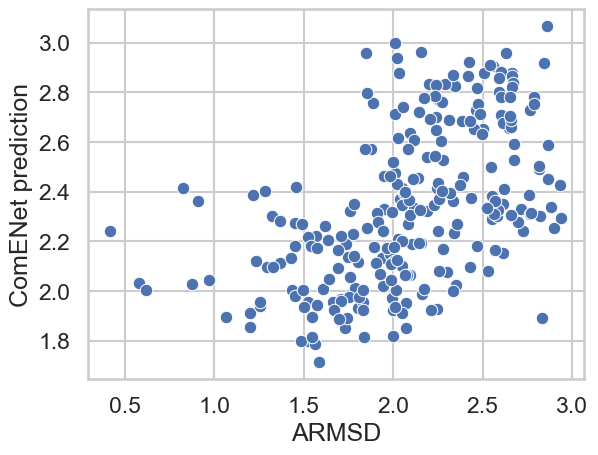

(0.5197717128866512, 1.0566375519757921e-18)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


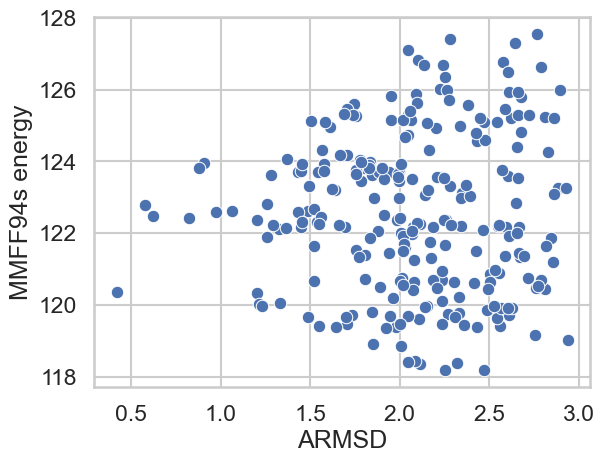

(0.04003351291894974, 0.5286515127402462)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


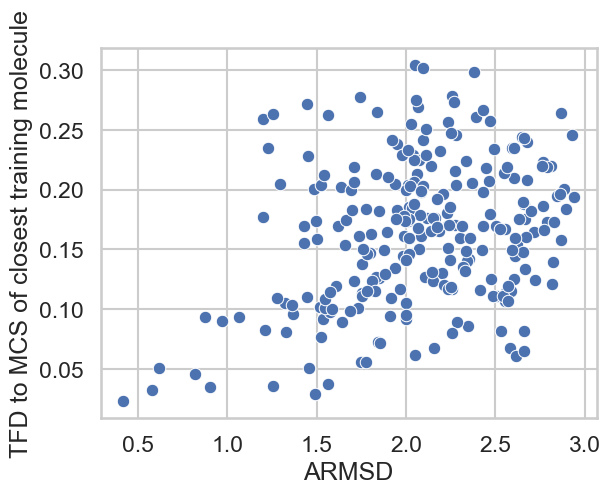

(0.30598088748317365, 8.11632053760019e-07)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.7368421052631579
AM7


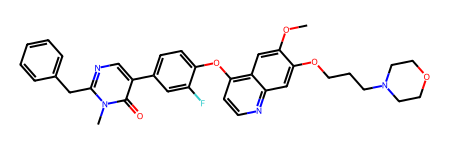

[['2rfn' '2.7.10.1']]


In [442]:
mol, closest_mol = analyse_pdb(pdb_id)

In [443]:
gen_mol = Chem.RemoveHs(mol)

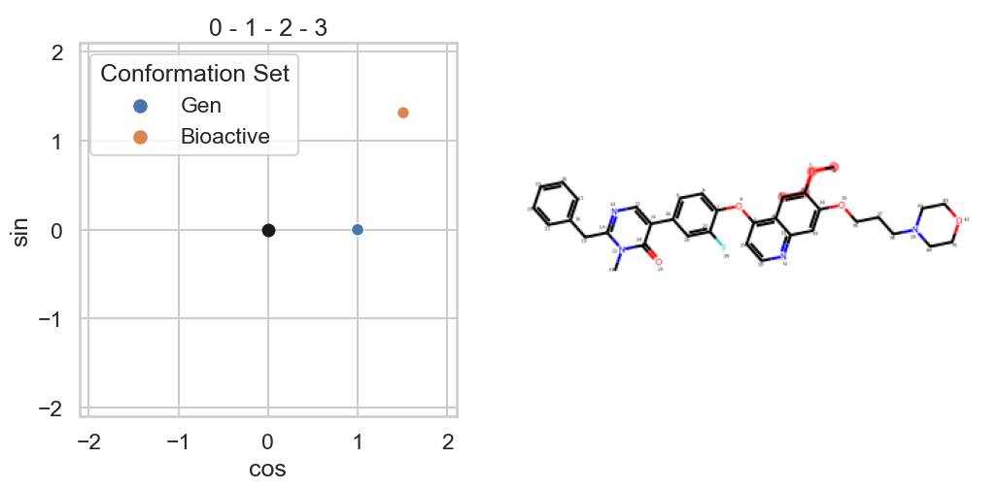

<Figure size 640x480 with 0 Axes>

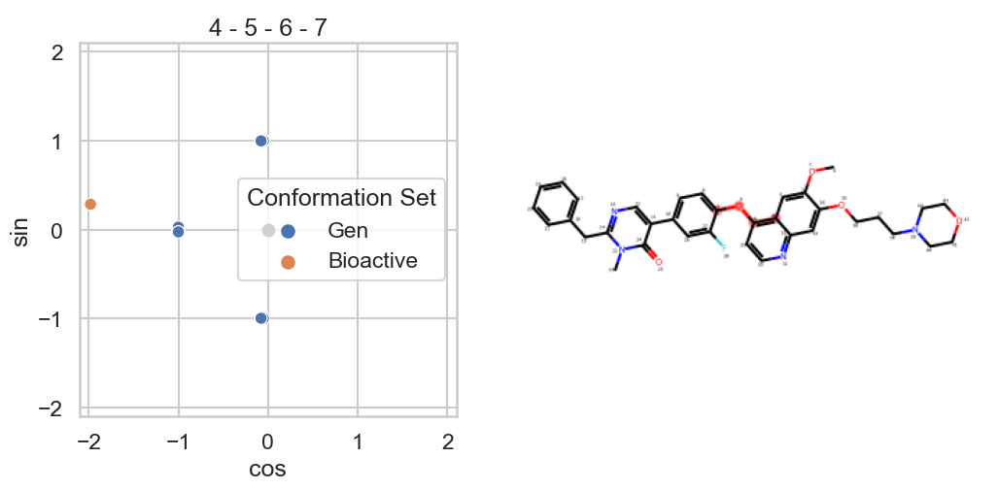

<Figure size 640x480 with 0 Axes>

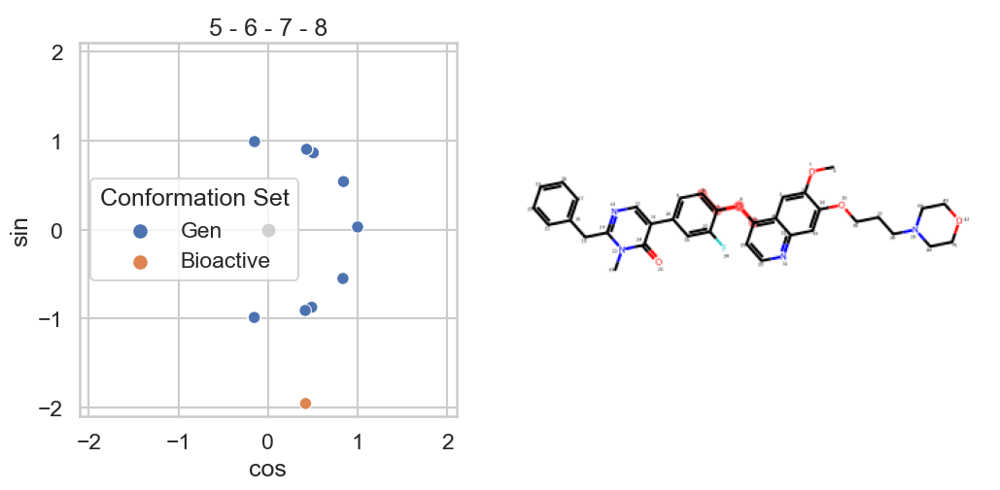

<Figure size 640x480 with 0 Axes>

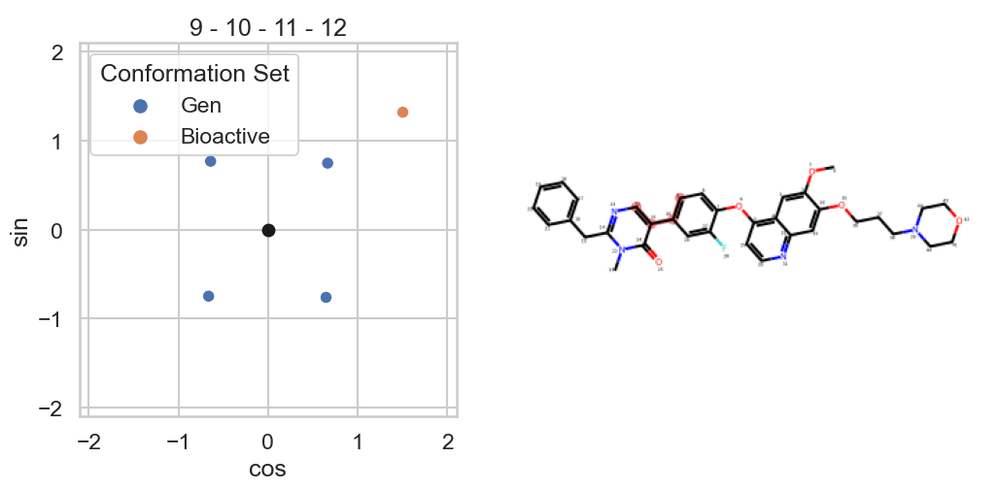

<Figure size 640x480 with 0 Axes>

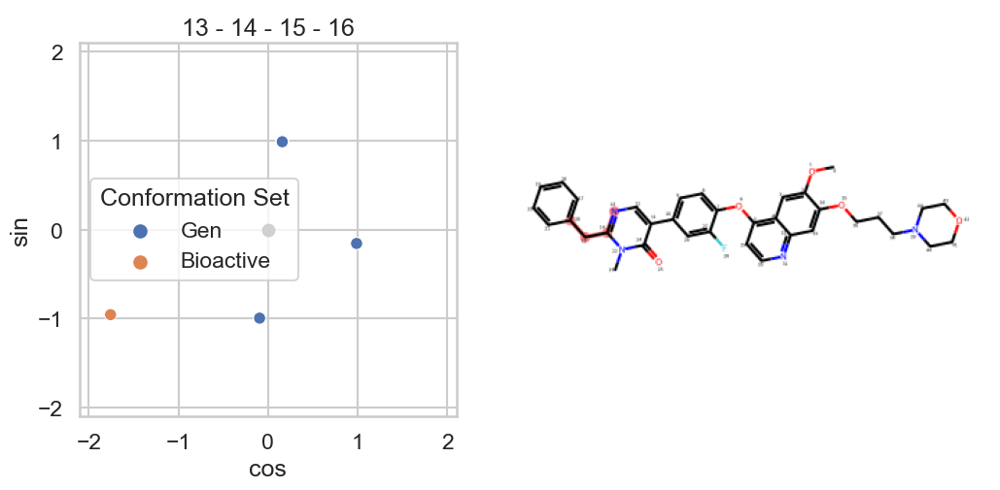

<Figure size 640x480 with 0 Axes>

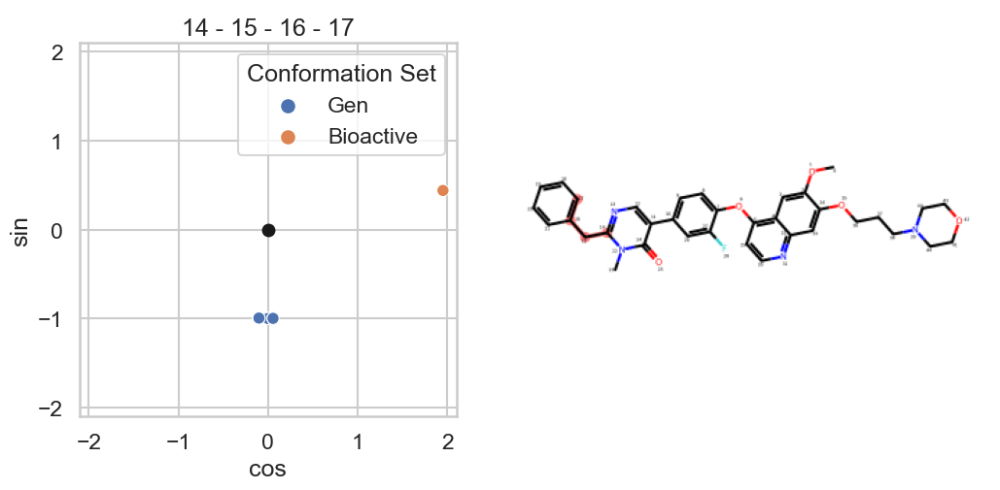

<Figure size 640x480 with 0 Axes>

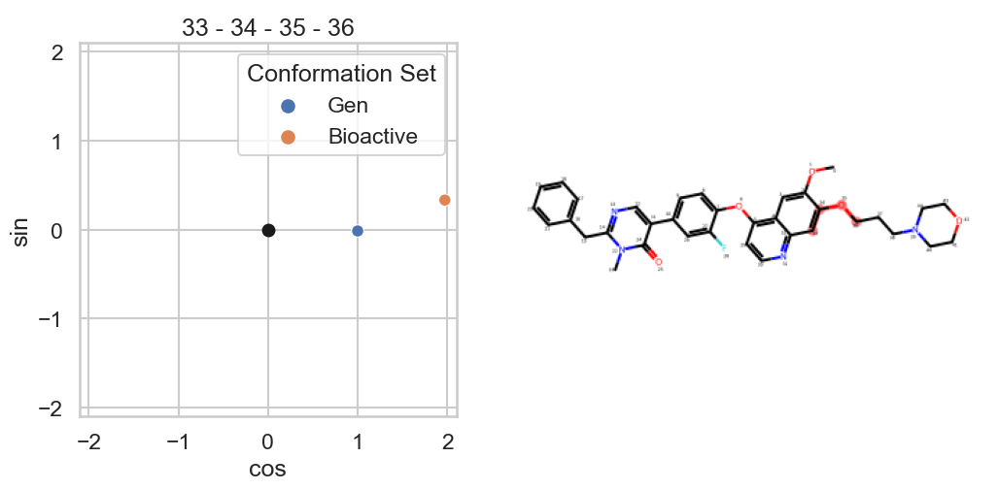

<Figure size 640x480 with 0 Axes>

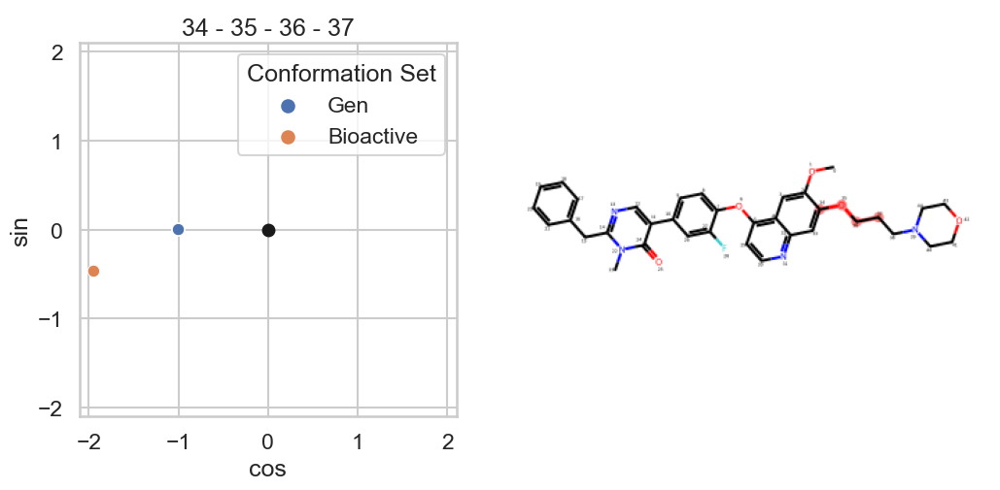

<Figure size 640x480 with 0 Axes>

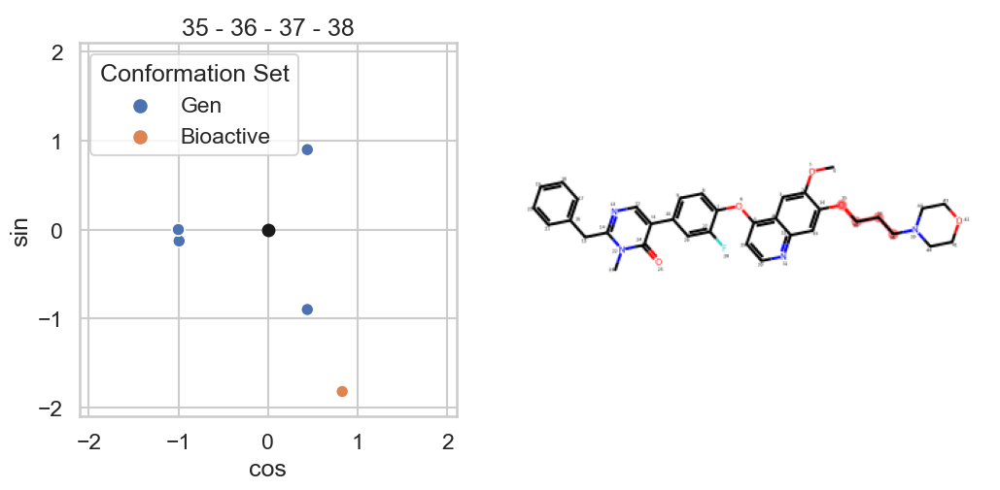

<Figure size 640x480 with 0 Axes>

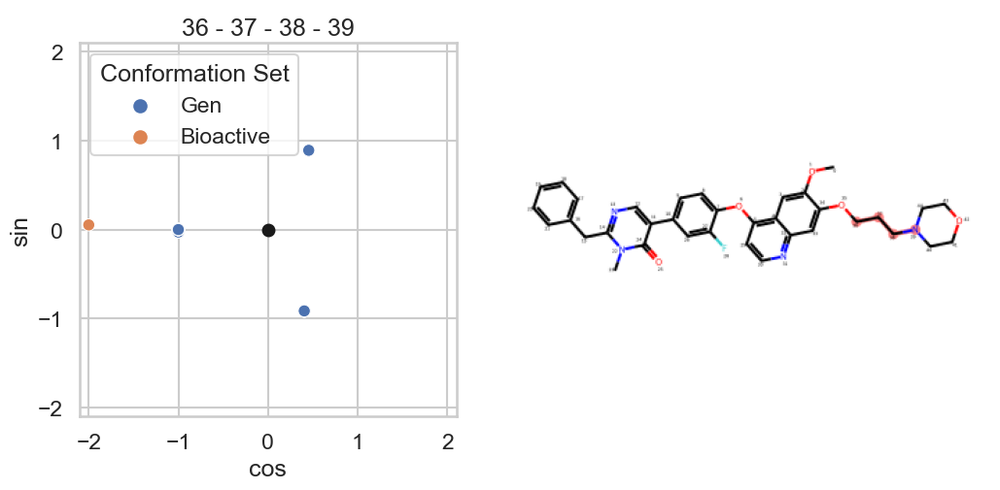

<Figure size 640x480 with 0 Axes>

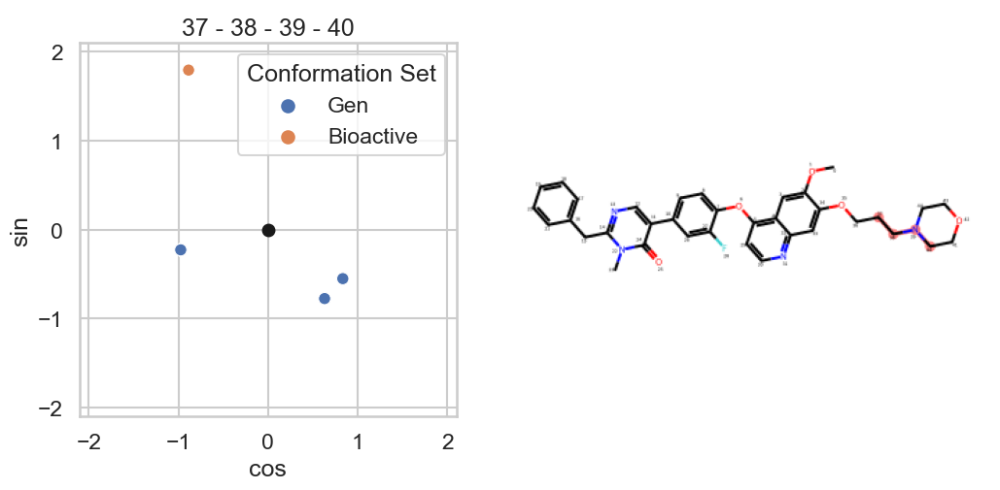

<Figure size 640x480 with 0 Axes>

In [444]:
gen_mol2 = analyze_torsions('AM7', '2rfn', have_bio_like=False)

In [445]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

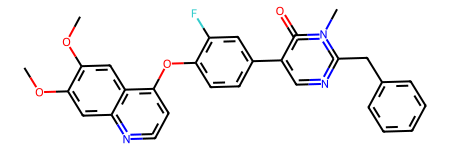

In [446]:
table1, table2, d_idxs, ac1, ac2 = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=10)

In [447]:
d_idxs

[(0, 1, 2, 3),
 (7, 8, 9, 10),
 (8, 9, 10, 11),
 (12, 13, 14, 15),
 (16, 17, 18, 19),
 (17, 18, 19, 20),
 (33, 34, 35, 36)]

In [448]:
table1.head()

,preds,targets,0,1,2,3,4,5,6
0,2.878477,2.506874,0.0,90.0,0.0,50.0,80.0,-90.0,-0.0
1,2.700348,2.236349,0.0,90.0,0.0,-50.0,80.0,-90.0,-0.0
2,2.651960,2.503689,0.0,90.0,0.0,130.0,80.0,-90.0,-0.0
3,2.370628,2.036593,0.0,90.0,0.0,-130.0,80.0,-90.0,-0.0
4,1.798105,1.521206,0.0,-90.0,0.0,50.0,80.0,-90.0,-0.0


In [449]:
table2.head()

,preds,0,1,2,3,4,5,6
0,3.094567,-0.0,90.0,0.0,50.0,80.0,-90.0,-0.0
1,3.040116,-0.0,90.0,0.0,-50.0,80.0,-90.0,-0.0
2,2.820609,-0.0,90.0,0.0,130.0,80.0,-90.0,-0.0
3,2.767437,-0.0,90.0,0.0,-130.0,80.0,-90.0,-0.0
4,2.223056,-0.0,-90.0,0.0,50.0,80.0,-90.0,-0.0


In [450]:
indexes = [i for i in range(len(d_idxs))]
merged_table = table1.merge(table2, on=indexes)

In [451]:
len(merged_table)

199

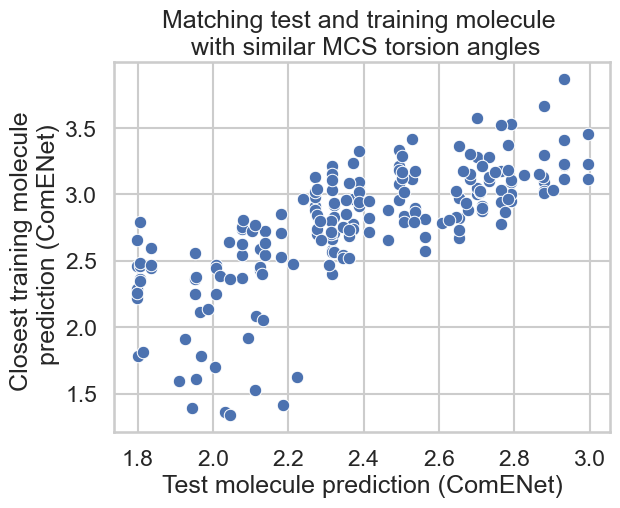

In [452]:
sns.scatterplot(data=merged_table, 
                x='preds_x', 
                y='preds_y')
plt.xlabel('Test molecule prediction (ComENet)')
plt.ylabel('Closest training molecule \n prediction (ComENet)')
plt.title('Matching test and training molecule \n with similar MCS torsion angles')
plt.savefig(os.path.join(figure_dir, f'{pdb_id}_matching_mcs_preds.png'), 
            dpi=300,
           bbox_inches='tight')

In [427]:
pearsonr(merged_table['preds_x'], merged_table['preds_y'])

(0.7275103969109478, 4.553038317408937e-34)

In [ ]:
sns.scatterplot(data=merged_table, x='targets', y='preds_y')

In [55]:
with open('../hdd/pdbbind_bioactive/results/scaffold_split_0/SchNetModel/ranker_mol_results.p', 'rb') as f:
    all_mol_results = pickle.load(f)
    
with open('../hdd/pdbbind_bioactive/results/scaffold_split_0/SchNetModel/ranker_conf_results.p', 'rb') as f:
    all_conf_results = pickle.load(f)

In [56]:
r0_results_df = results_df[(results_df['Test set'] == 'Scaffold')
                          &(results_df['Iteration'] == 0)
                          &(results_df['Ranker'] == 'ComENet')]
r0_regression_df = regression_df[(regression_df['Test set'] == 'Scaffold')
                          &(regression_df['Iteration'] == 0)
                                &(regression_df['Model'] == 'ComENet')]

In [57]:
t0 = target_results_df[(target_results_df['level_4'] == '3.4.23.46') 
                  & (target_results_df['Iteration'] == 0)
                 & (target_results_df['Test set'] == 'Scaffold')]
t = t0.groupby(['Ranker', 'ligand name']).mean().reset_index()

In [58]:
data_split = ScaffoldSplit()
model = ComENetModel.get_model_for_data_split(data_split)

In [59]:
p = t0.pivot_table(values='BEDROC of bioactive-like conformations', columns='Ranker', index=['PDB code', 'ligand name'])
p['S-M'] = p['ComENet'] - p['MMFF94s energy']

In [60]:
p[p['S-M'] > 0].sort_values('S-M')

,Ranker,ComENet,DimeNet++,Generation order,MMFF94s energy,SchNet,Shuffle,TFD2RefMCS,S-M
PDB code,ligand name,,,,,,,,
2zdz,310,0.001041,0.002987,6.180533e-04,0.000016,1.032056e-02,0.000043,0.416924,0.001025
3ru1,3RU,0.282211,0.333737,3.307860e-03,0.280929,1.605604e-01,0.027707,0.239006,0.001282
4ivt,VTI,0.104984,0.000003,3.269787e-06,0.028781,7.535922e-02,0.000549,0.203051,0.076203
3udr,09F,0.211933,0.211343,1.644168e-02,0.070636,3.690814e-08,0.001577,0.000024,0.141298
5hd0,60Y,0.714479,0.794203,2.456721e-01,0.360919,1.220842e-01,0.022486,0.307836,0.353560
2vie,VG0,0.923116,1.000000,5.180406e-09,0.000026,5.272924e-01,0.047835,0.852144,0.923090


In [61]:
pdb_id = '2vie'
ligand_name = 'VG0'

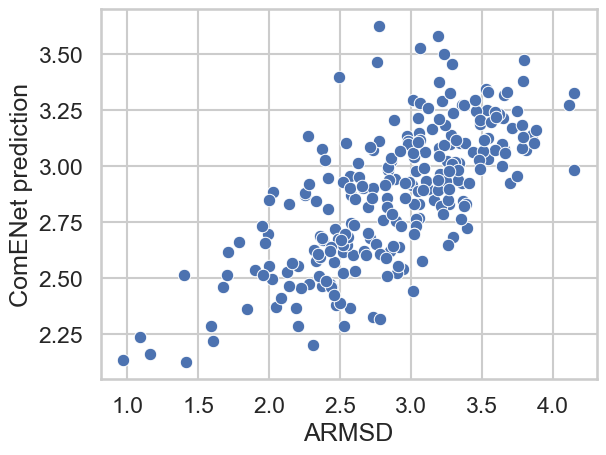

(0.7052979861182321, 6.322741979344739e-39)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


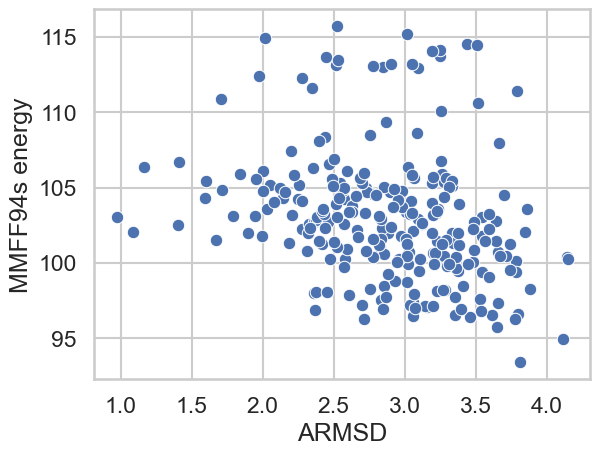

(-0.2660567755083105, 2.0194846813432523e-05)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


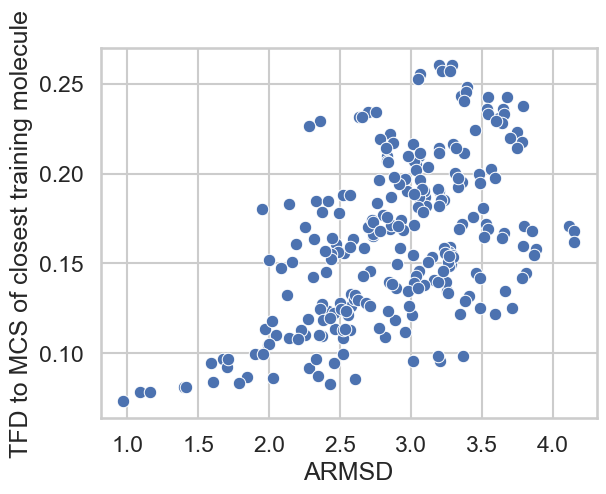

(0.5427817017223286, 1.4813866922843163e-20)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.6198347107438017
VG6


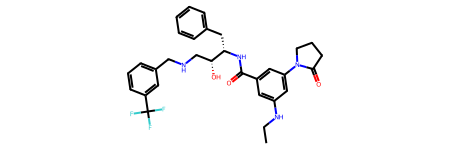

[['2vj7' '3.4.23.46']]


In [62]:
mol, closest_mol = analyse_pdb(pdb_id)

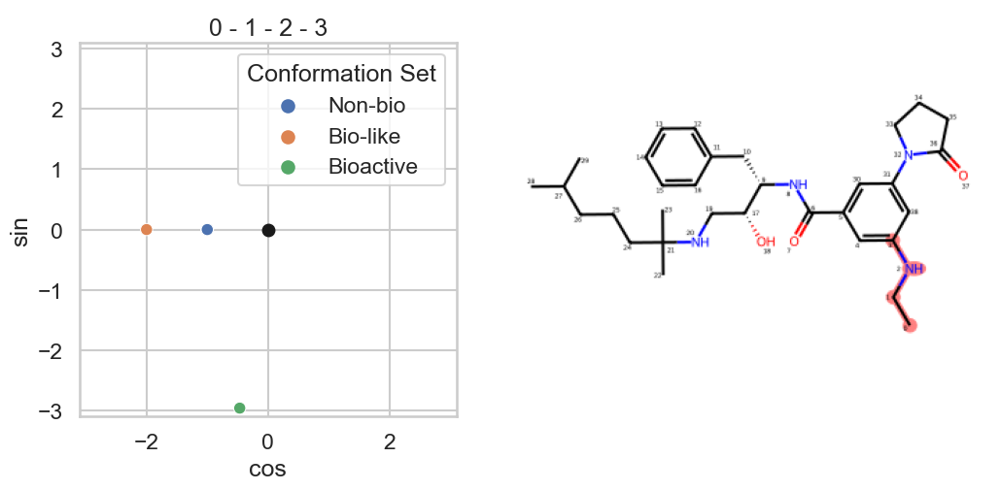

<Figure size 640x480 with 0 Axes>

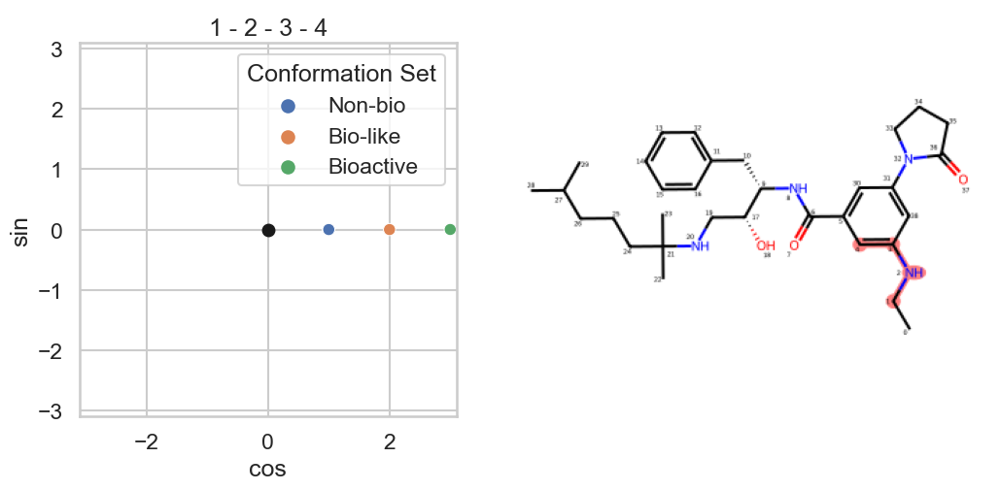

<Figure size 640x480 with 0 Axes>

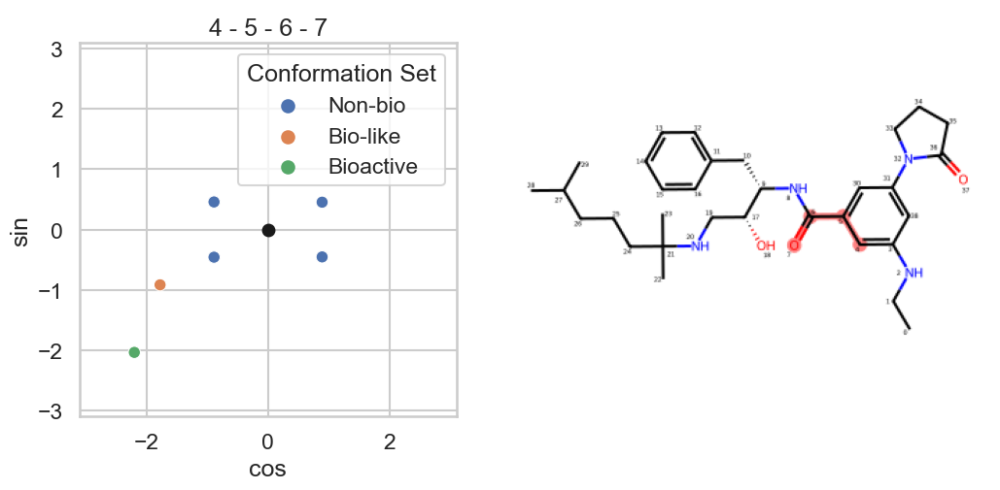

<Figure size 640x480 with 0 Axes>

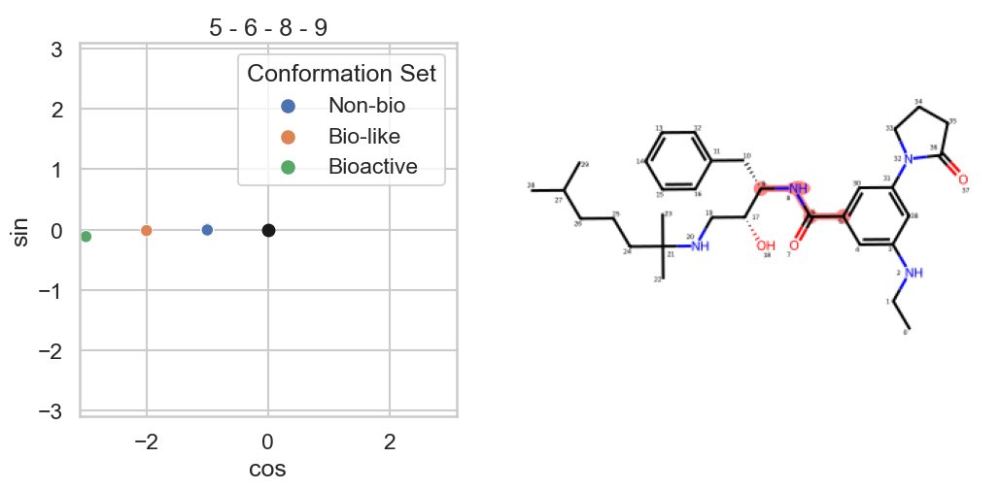

<Figure size 640x480 with 0 Axes>

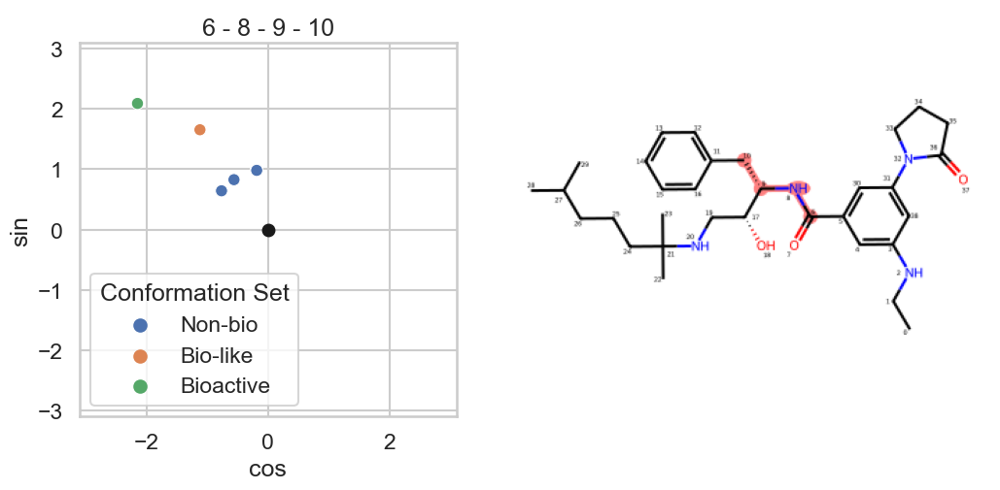

<Figure size 640x480 with 0 Axes>

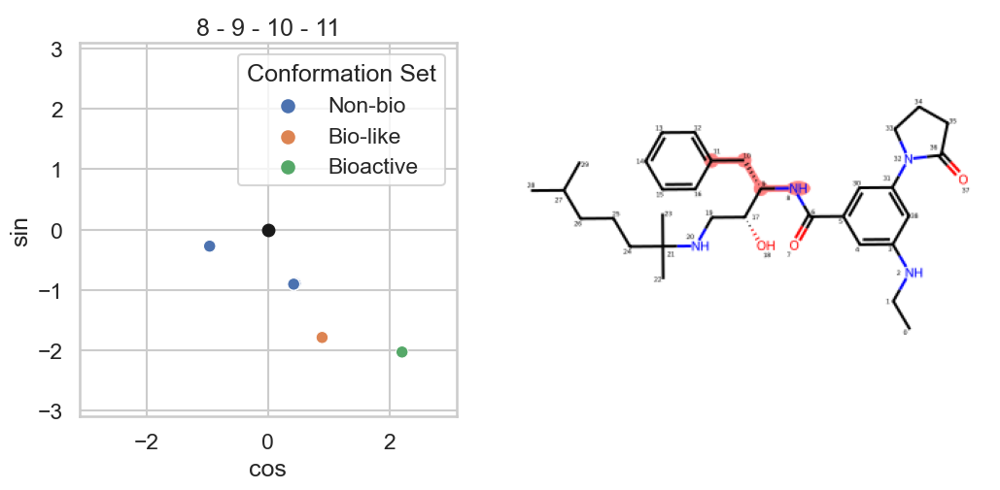

<Figure size 640x480 with 0 Axes>

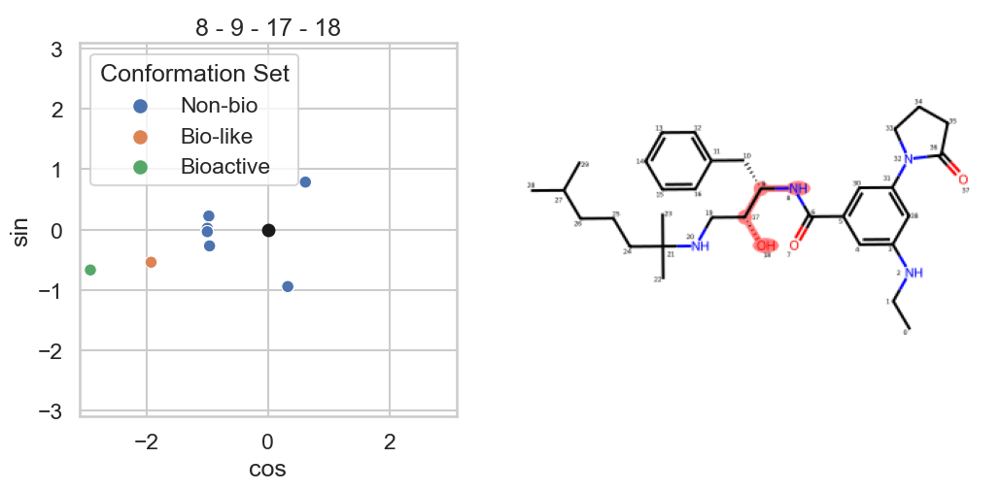

<Figure size 640x480 with 0 Axes>

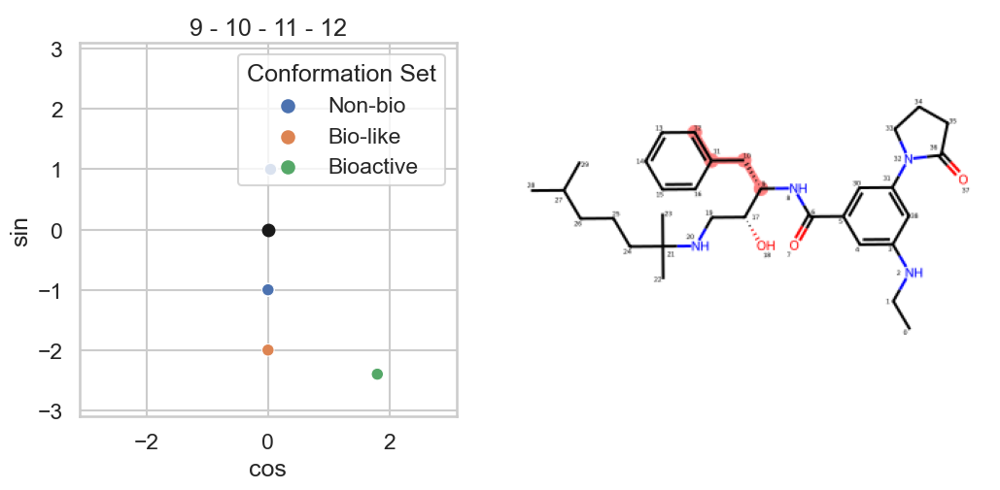

<Figure size 640x480 with 0 Axes>

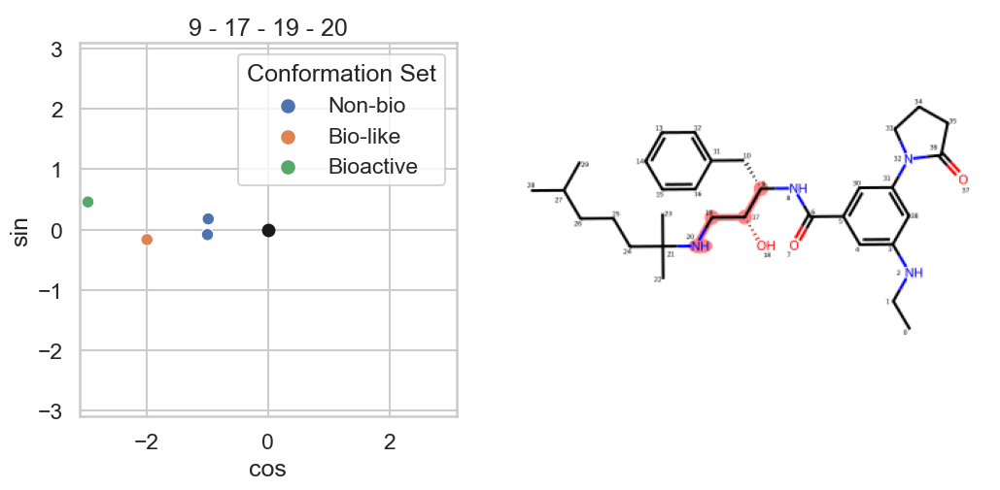

<Figure size 640x480 with 0 Axes>

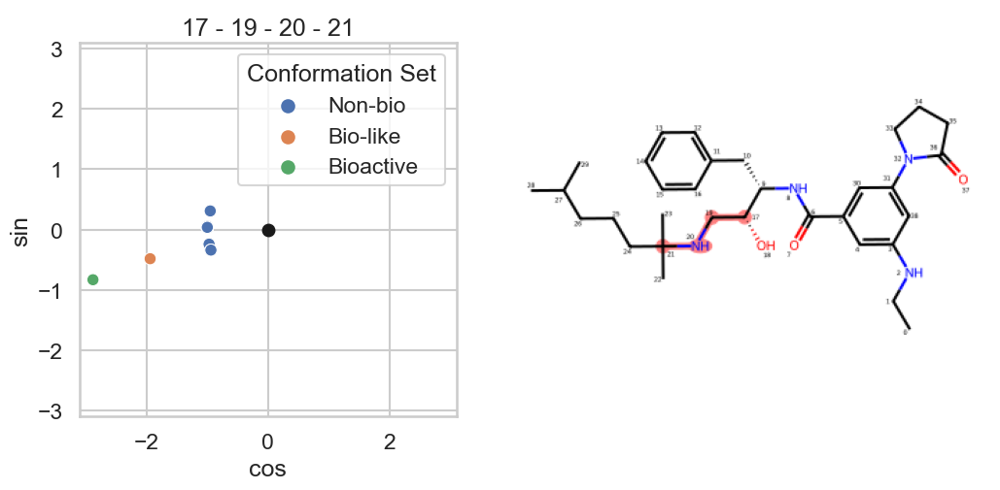

<Figure size 640x480 with 0 Axes>

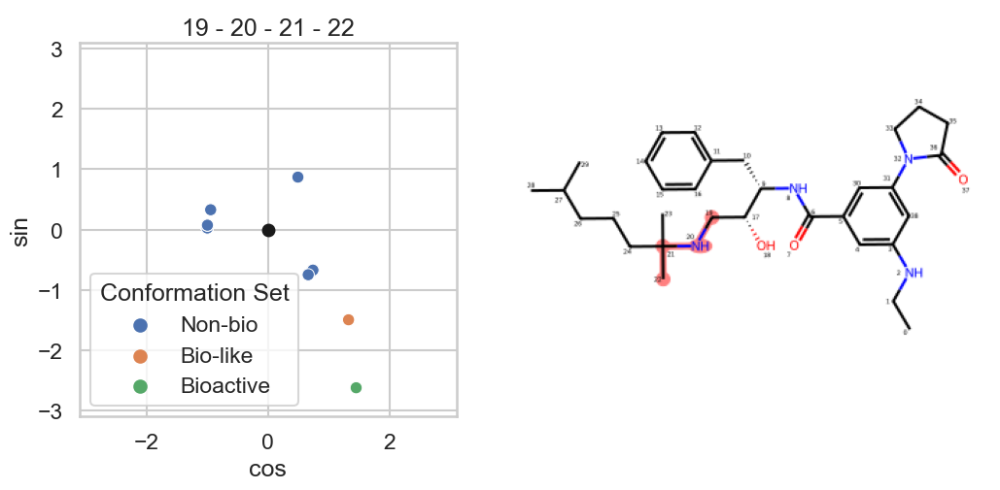

<Figure size 640x480 with 0 Axes>

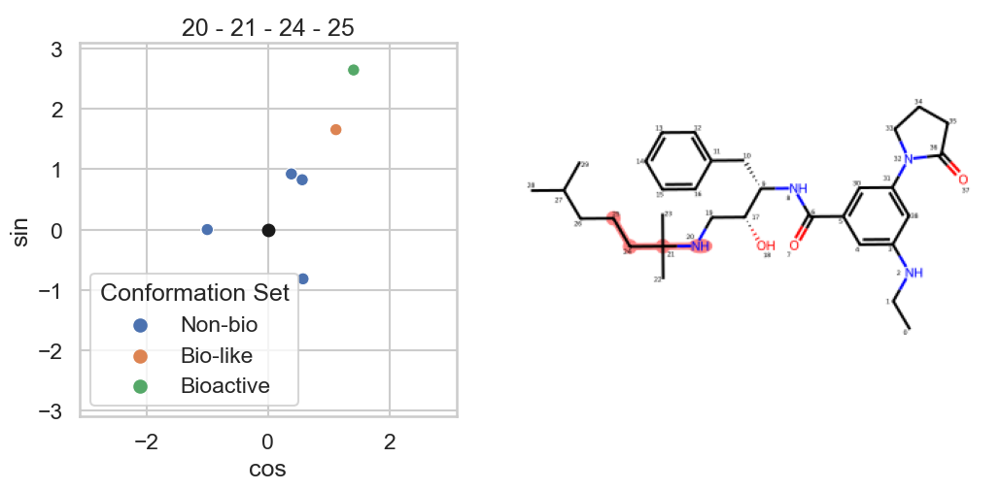

<Figure size 640x480 with 0 Axes>

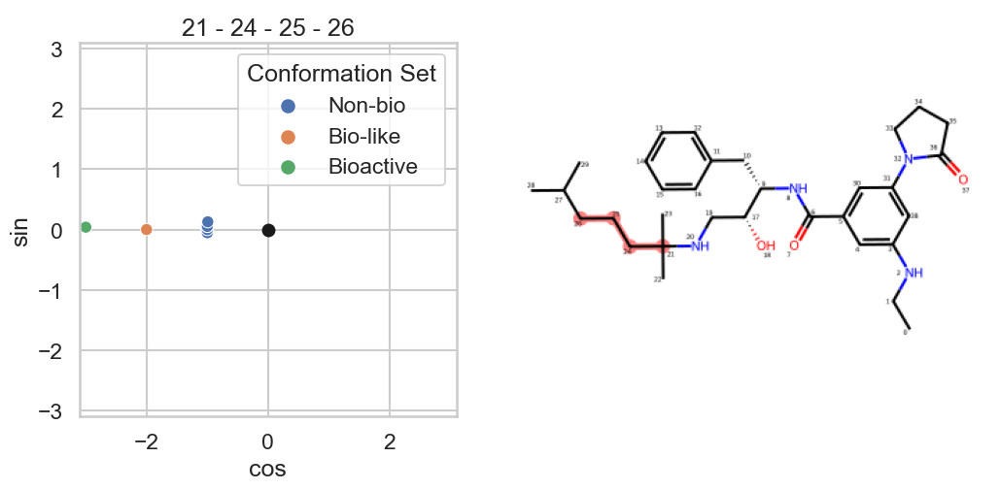

<Figure size 640x480 with 0 Axes>

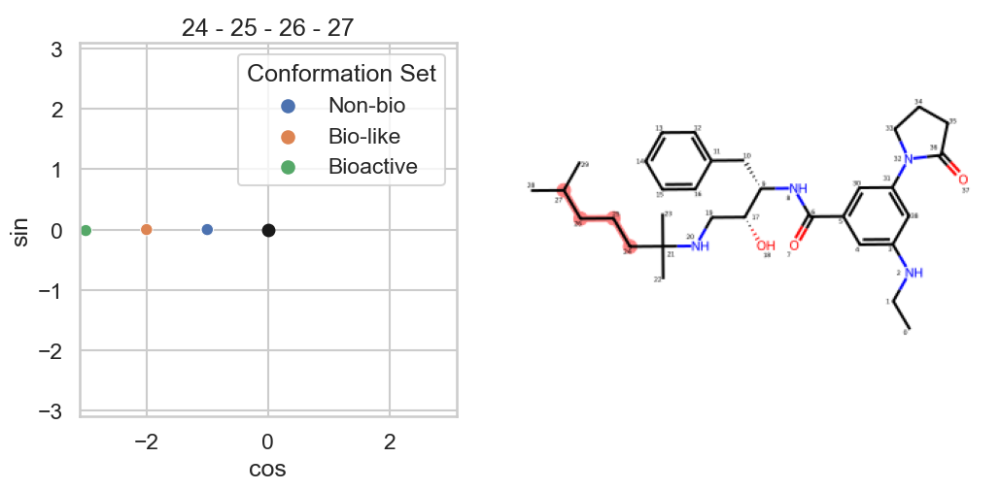

<Figure size 640x480 with 0 Axes>

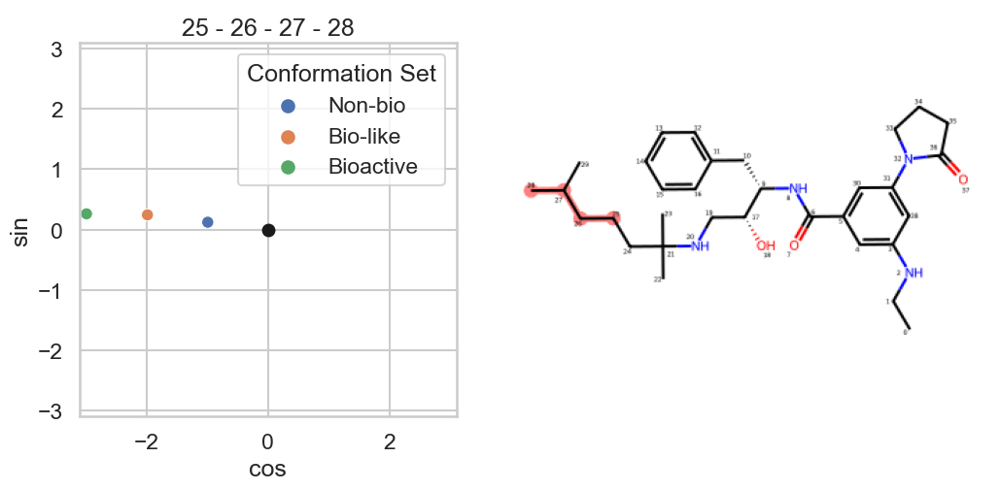

<Figure size 640x480 with 0 Axes>

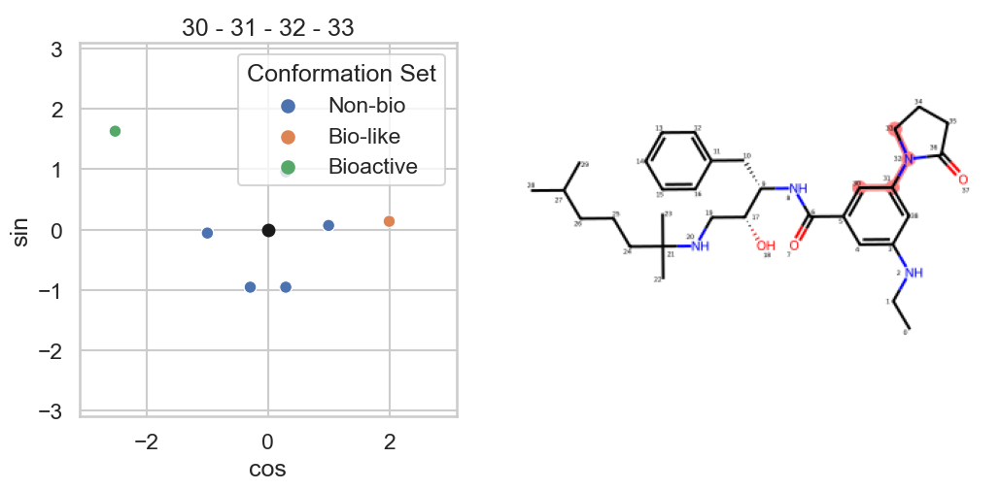

<Figure size 640x480 with 0 Axes>

In [63]:
gen_mol = analyze_torsions(ligand_name, pdb_id)

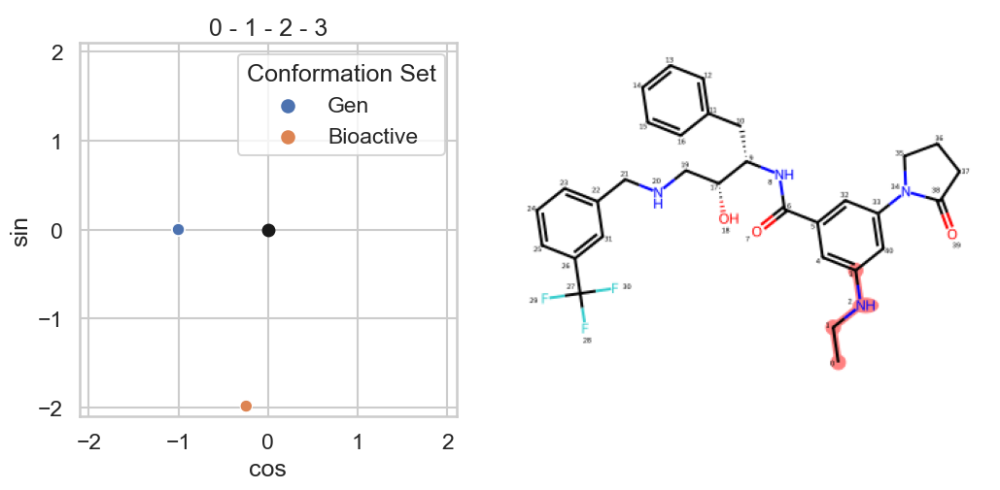

<Figure size 640x480 with 0 Axes>

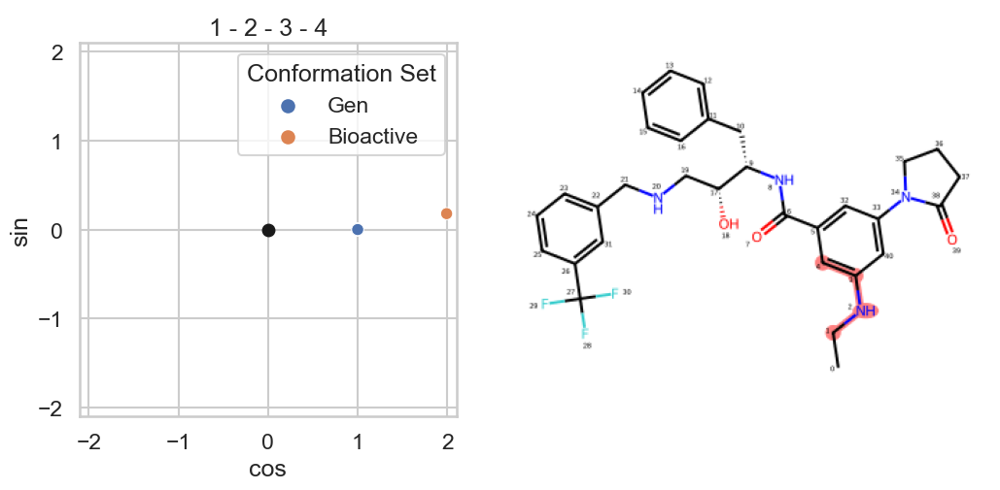

<Figure size 640x480 with 0 Axes>

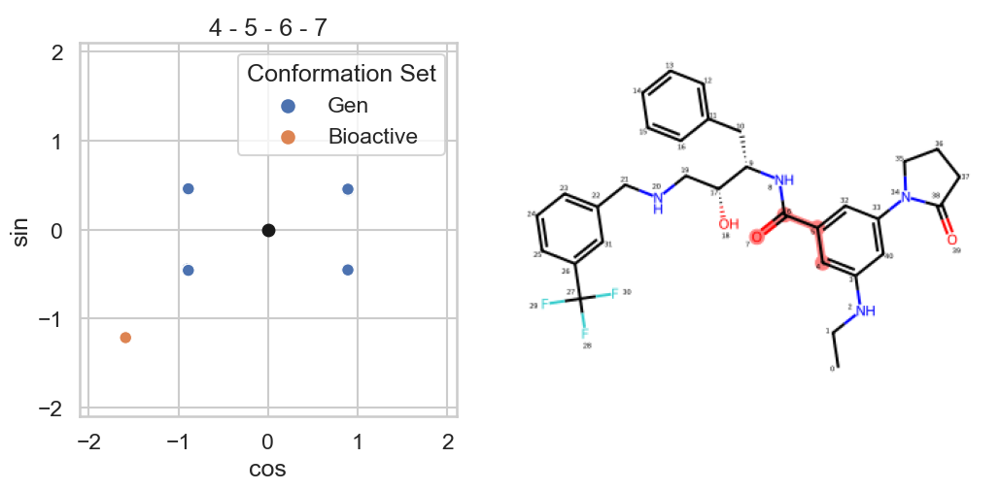

<Figure size 640x480 with 0 Axes>

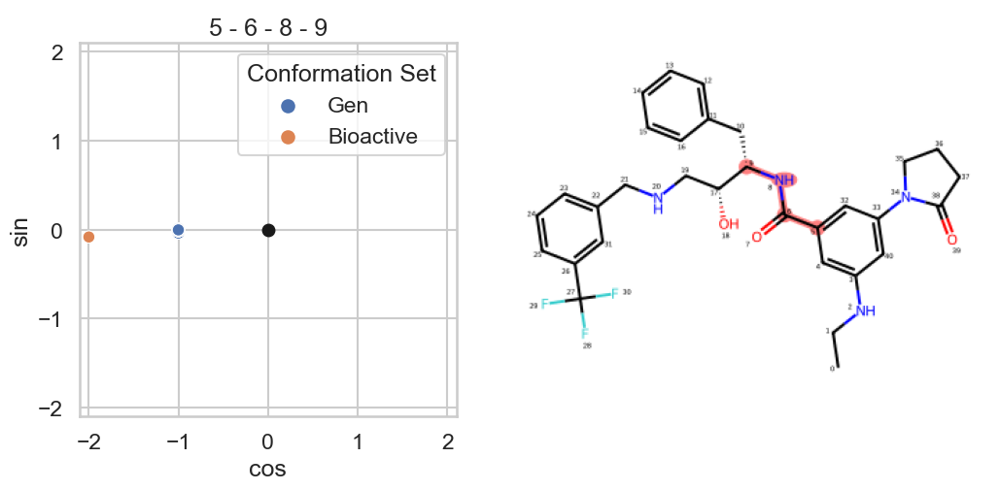

<Figure size 640x480 with 0 Axes>

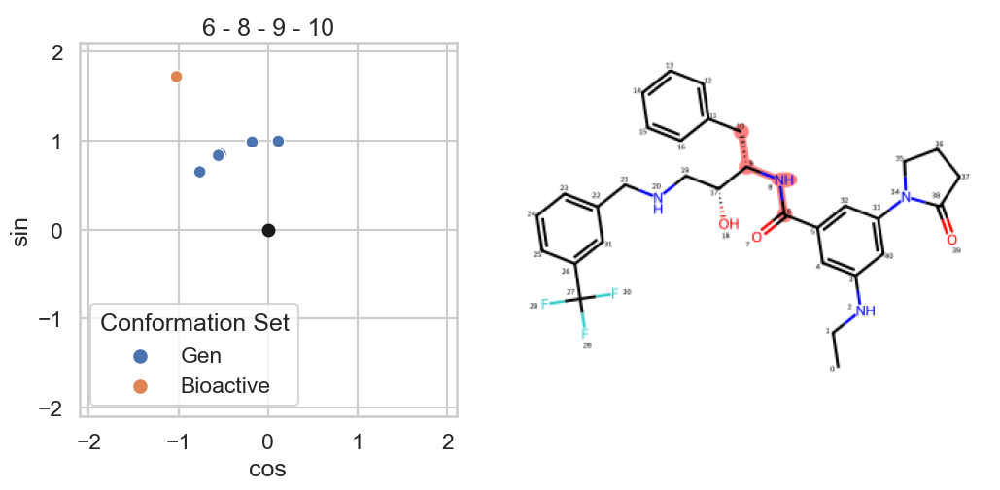

<Figure size 640x480 with 0 Axes>

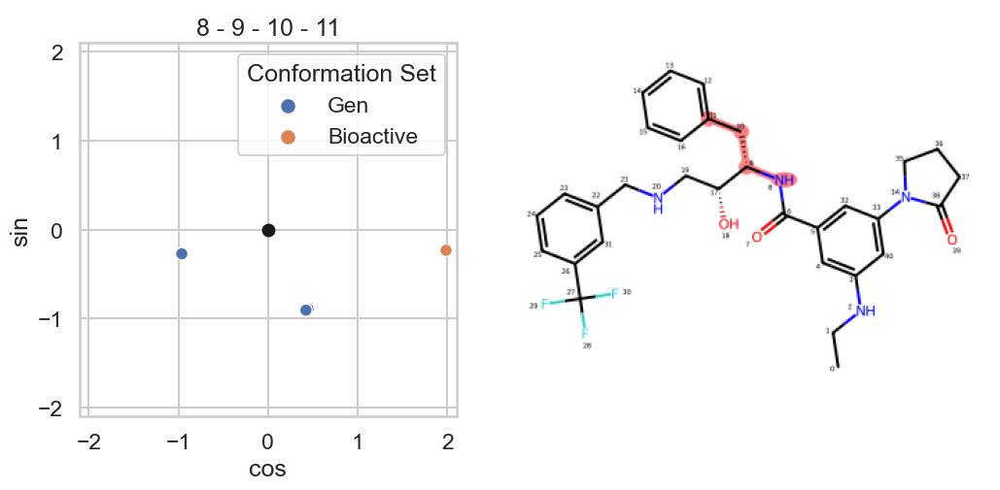

<Figure size 640x480 with 0 Axes>

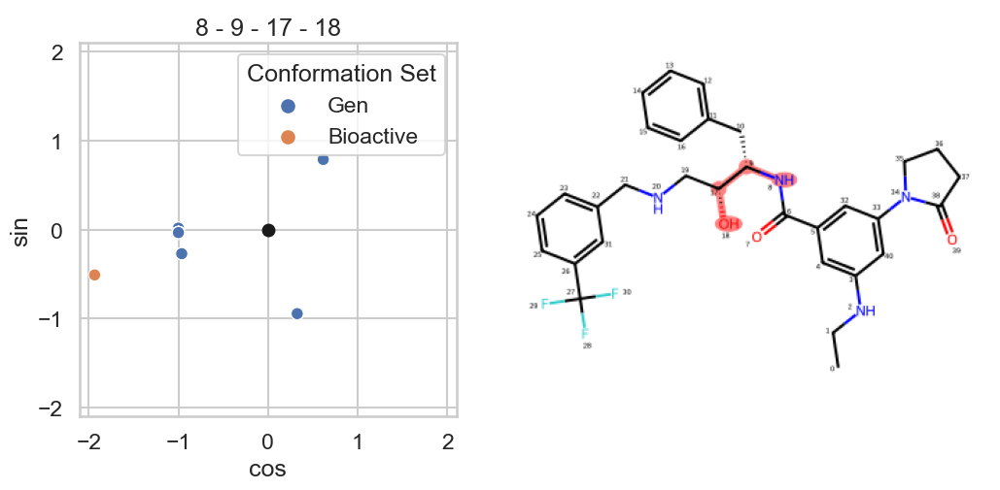

<Figure size 640x480 with 0 Axes>

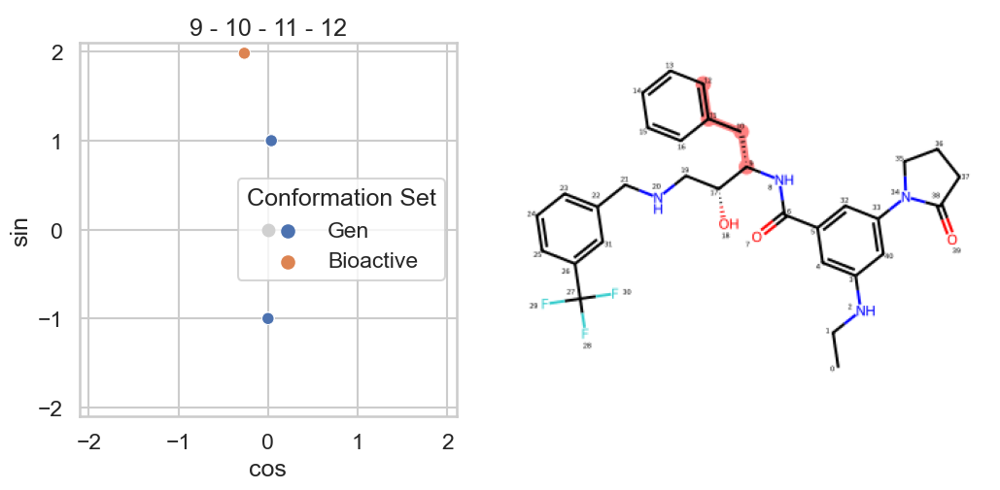

<Figure size 640x480 with 0 Axes>

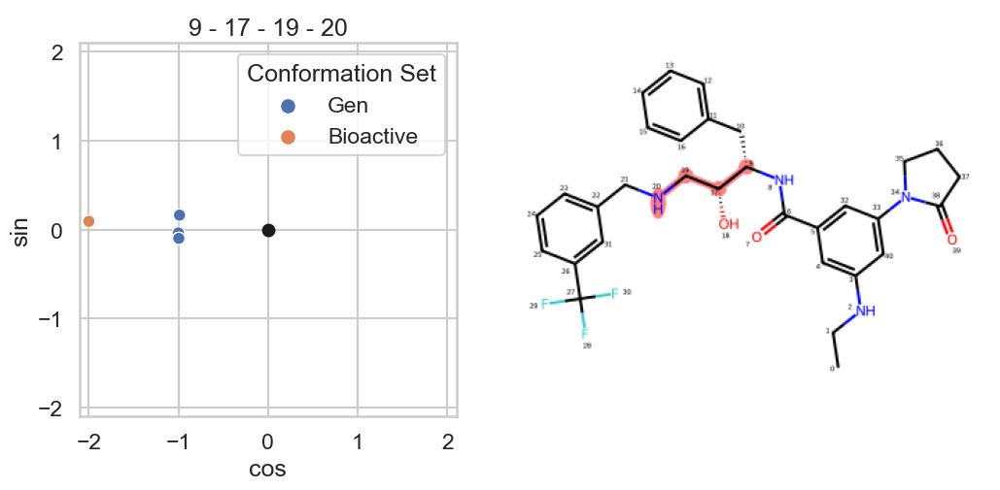

<Figure size 640x480 with 0 Axes>

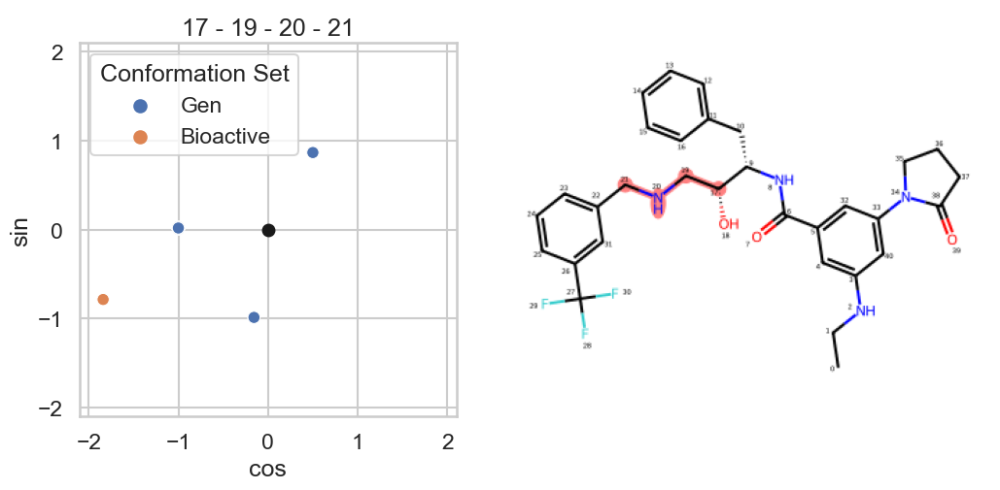

<Figure size 640x480 with 0 Axes>

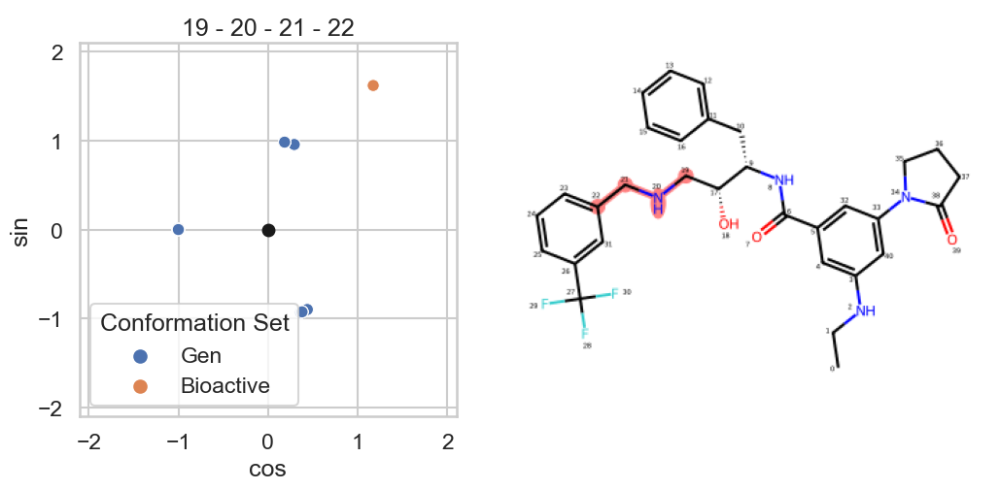

<Figure size 640x480 with 0 Axes>

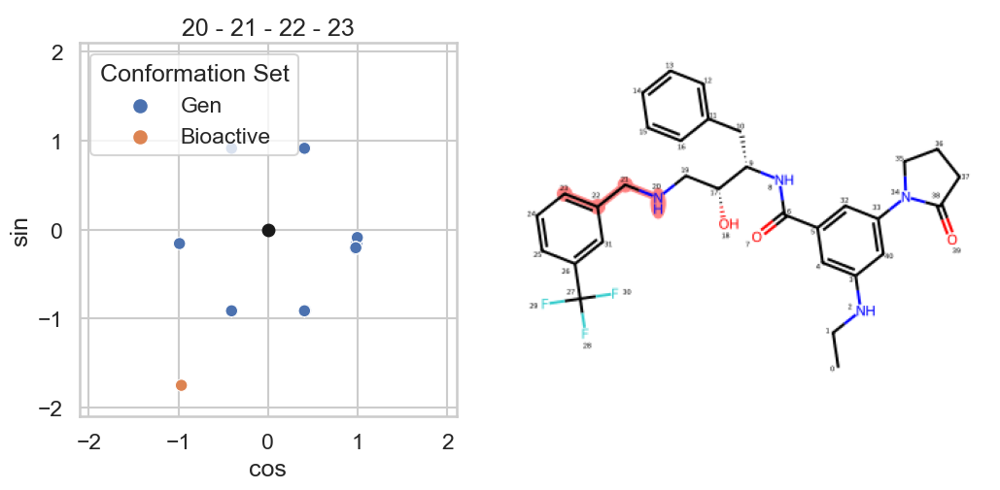

<Figure size 640x480 with 0 Axes>

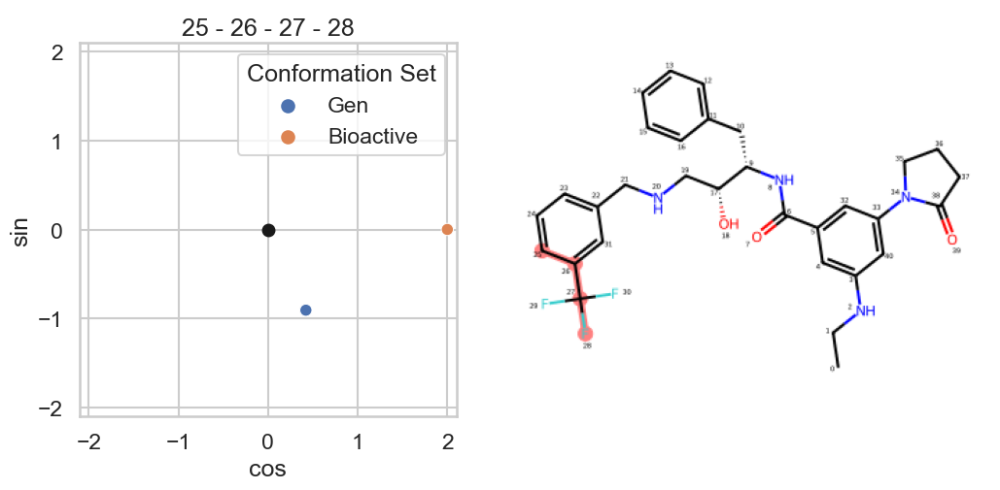

<Figure size 640x480 with 0 Axes>

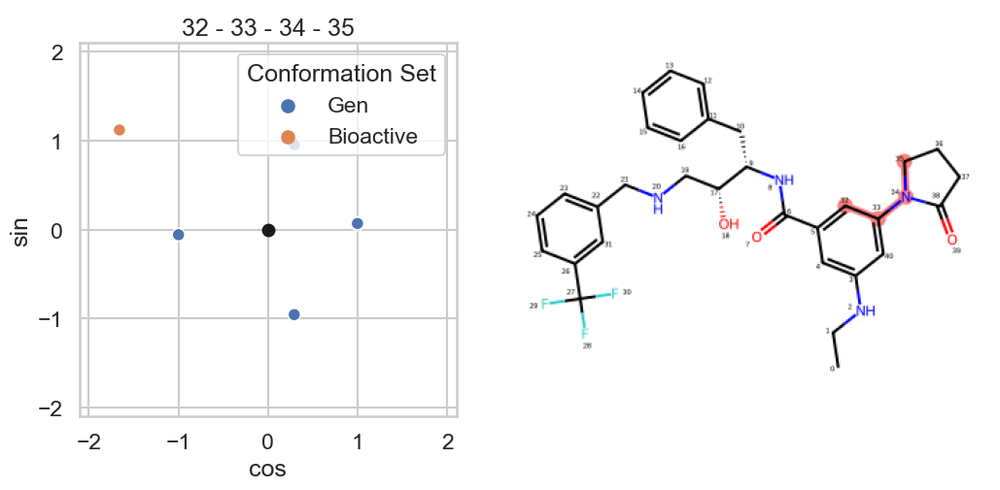

<Figure size 640x480 with 0 Axes>

In [64]:
gen_mol2 = analyze_torsions('VG6', '2vj7', have_bio_like=False)

In [65]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

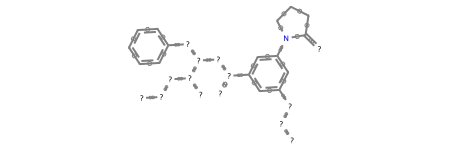

In [82]:
table1, table2, d_idxs, ac1, ac2 = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=10)

In [83]:
d_idxs

[(0, 1, 2, 3),
 (1, 2, 3, 4),
 (4, 5, 6, 7),
 (5, 6, 8, 9),
 (6, 8, 9, 10),
 (8, 9, 10, 11),
 (8, 9, 17, 18),
 (9, 10, 11, 12),
 (9, 17, 19, 20),
 (17, 19, 20, 21),
 (30, 31, 32, 33)]

In [84]:
table1.head()

,preds,targets,0,1,2,3,4,5,6,7,8,9,10
0,2.653827,2.714297,-180.0,0.0,-30.0,-180.0,120.0,-60.0,-180.0,-90.0,-180.0,180.0,-180.0
1,2.709170,3.160210,-180.0,0.0,-30.0,-180.0,120.0,-60.0,-180.0,-90.0,-180.0,180.0,-180.0
2,3.168381,3.358471,-180.0,0.0,30.0,-180.0,120.0,-60.0,-180.0,-90.0,-180.0,180.0,-180.0
3,3.212830,3.656866,-180.0,0.0,30.0,-180.0,120.0,-60.0,-180.0,-90.0,-180.0,180.0,-180.0
4,2.794184,2.576279,180.0,0.0,150.0,-180.0,120.0,-70.0,-180.0,-90.0,-180.0,180.0,-180.0


In [85]:
table2.head()

,preds,0,1,2,3,4,5,6,7,8,9,10
0,3.073273,180.0,0.0,-30.0,-180.0,120.0,-60.0,-180.0,-90.0,-170.0,180.0,-180.0
1,3.456692,-180.0,0.0,30.0,-180.0,120.0,-60.0,-180.0,-90.0,-170.0,180.0,-180.0
2,3.008533,180.0,0.0,150.0,-180.0,120.0,-60.0,-180.0,-90.0,-170.0,180.0,-180.0
3,2.581940,180.0,0.0,-150.0,-180.0,120.0,-60.0,-180.0,-90.0,-170.0,180.0,-180.0
4,2.779042,180.0,0.0,-30.0,-180.0,120.0,-60.0,-180.0,-90.0,-170.0,180.0,-180.0


In [86]:
indexes = [i for i in range(len(d_idxs))]
merged_table = table1.merge(table2, on=indexes)

In [87]:
len(merged_table)

11

<AxesSubplot:xlabel='preds_x', ylabel='preds_y'>

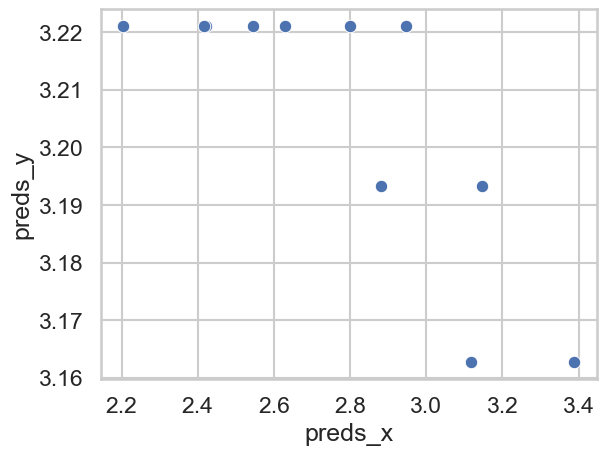

In [88]:
sns.scatterplot(data=merged_table, x='preds_x', y='preds_y')

<AxesSubplot:xlabel='targets', ylabel='preds_y'>

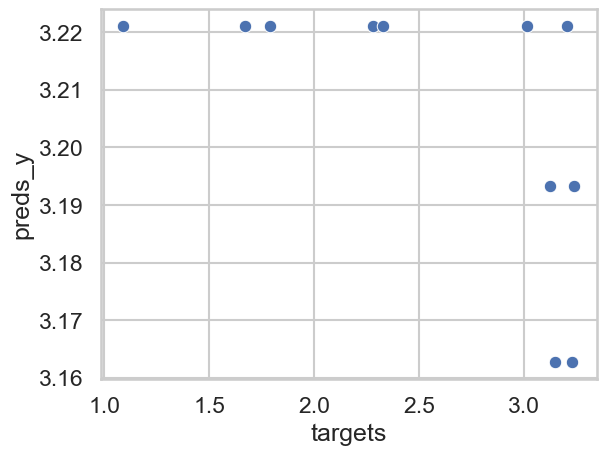

In [89]:
sns.scatterplot(data=merged_table, x='targets', y='preds_y')

In [90]:
pdb_id = '5hd0'
ligand_name = '60Y'

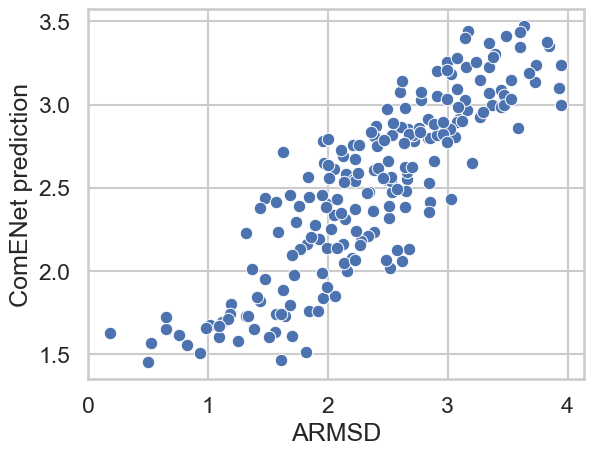

(0.8659191145774512, 2.6971335126838623e-63)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


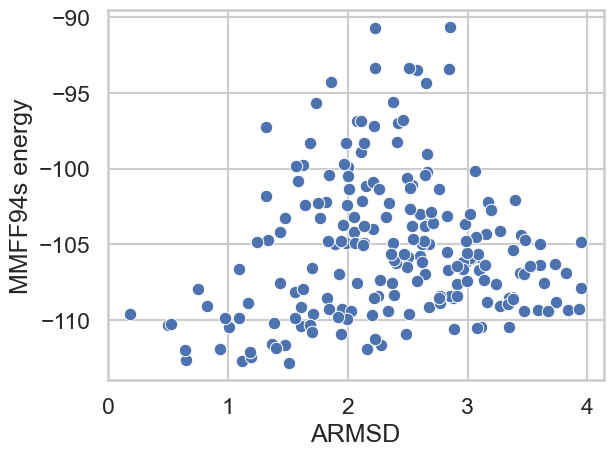

(0.0771616001055954, 0.27029531733723955)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


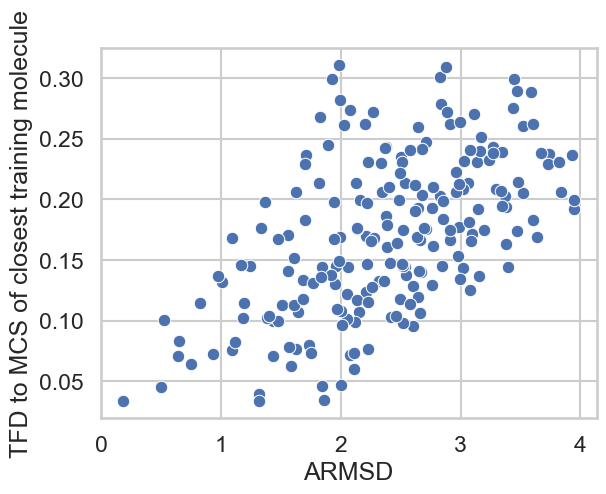

(0.5647554662420038, 9.43366459659095e-19)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=205), Output()), _dom_classes=(…

0.6666666666666666
10Q


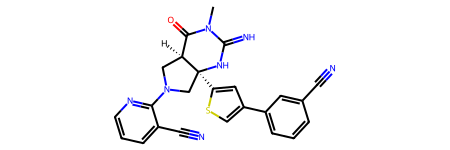

[['4h3g' '3.4.23.46']]


In [91]:
mol, closest_mol = analyse_pdb(pdb_id)

In [92]:
gen_mol = analyze_torsions(ligand_name, pdb_id)

[12:15:07] 

****
Pre-condition Violation
Number of atom mismatch
Violation occurred on line 679 in file /project/build/temp.linux-x86_64-cpython-37/rdkit/Code/GraphMol/ROMol.cpp
Failed Expression: conf->getNumAtoms() == this->getNumAtoms()
****



RuntimeError: Pre-condition Violation
	Number of atom mismatch
	Violation occurred on line 679 in file Code/GraphMol/ROMol.cpp
	Failed Expression: conf->getNumAtoms() == this->getNumAtoms()
	RDKIT: 2022.09.3
	BOOST: 1_78


In [239]:
gen_mol2 = analyze_torsions('10Q', '4h3g', have_bio_like=False)

[15:06:15] 

****
Pre-condition Violation
Number of atom mismatch
Violation occurred on line 679 in file /project/build/temp.linux-x86_64-cpython-37/rdkit/Code/GraphMol/ROMol.cpp
Failed Expression: conf->getNumAtoms() == this->getNumAtoms()
****



RuntimeError: Pre-condition Violation
	Number of atom mismatch
	Violation occurred on line 679 in file Code/GraphMol/ROMol.cpp
	Failed Expression: conf->getNumAtoms() == this->getNumAtoms()
	RDKIT: 2022.09.3
	BOOST: 1_78


In [271]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

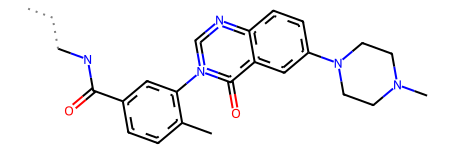

In [412]:
table1, table2, d_idxs = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=1)

In [322]:
table1.head()

,preds,targets,0,1
0,1.273248,2.136951,-0.0,73.0
1,1.414746,2.018063,-2.0,73.0
2,1.320713,1.964377,-0.0,73.0
3,1.415789,1.782485,-0.0,73.0
4,1.749362,2.109415,-0.0,66.0


In [323]:
table2.head()

,preds,0,1
0,0.921054,0.0,73.0
1,1.071580,0.0,73.0
2,0.760494,0.0,66.0
3,0.867205,0.0,73.0
4,0.824968,0.0,66.0


In [324]:
indexes = [0, 1]

In [325]:
merged_table = table1.merge(table2, on=indexes)

In [326]:
len(merged_table)

567

<AxesSubplot:xlabel='preds_x', ylabel='preds_y'>

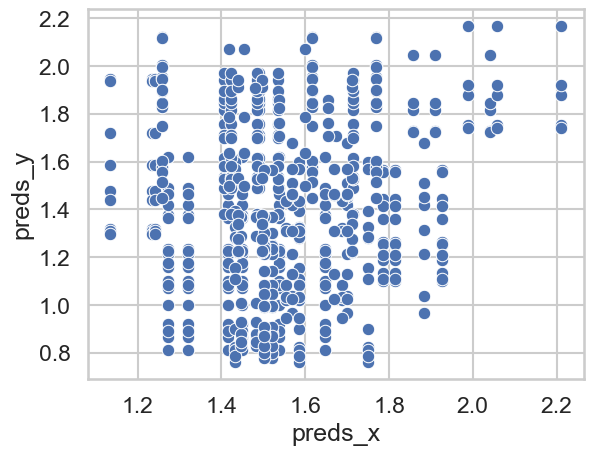

In [327]:
sns.scatterplot(data=merged_table, x='preds_x', y='preds_y')

<AxesSubplot:xlabel='targets', ylabel='preds_y'>

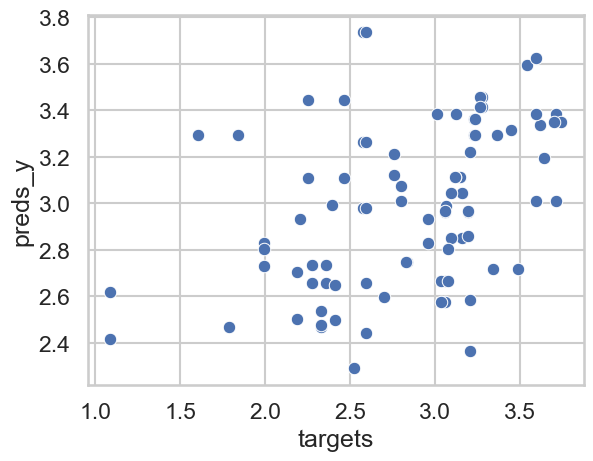

In [248]:
sns.scatterplot(data=merged_table, x='targets', y='preds_y')

In [93]:
t0 = target_results_df[(target_results_df['level_4'] == '2.7.11.24') 
                  & (target_results_df['Iteration'] == 0)
                 & (target_results_df['Test set'] == 'Scaffold')]
t = t0.groupby(['Ranker', 'ligand name']).mean().reset_index()

In [94]:
p = t0.pivot_table(values='BEDROC of bioactive-like conformations', columns='Ranker', index=['PDB code', 'ligand name'])
p['S-M'] = p['ComENet'] - p['MMFF94s energy']

In [95]:
p[p['S-M'] > 0].sort_values('S-M').round(3)

,Ranker,ComENet,DimeNet++,Generation order,MMFF94s energy,SchNet,Shuffle,TFD2RefMCS,S-M
PDB code,ligand name,,,,,,,,
2ewa,SB2,0.869,0.771,0.534,0.835,0.380,0.402,0.992,0.034
1a9u,SB2,0.834,0.771,0.520,0.788,0.376,0.401,0.994,0.046
5ke0,6S9,0.064,0.006,0.000,0.002,0.044,0.222,0.000,0.062
3oy1,589,0.155,0.118,0.117,0.076,0.096,0.024,0.019,0.080
3ocg,OCG,0.097,0.019,0.023,0.003,0.151,0.104,0.547,0.094
4z9l,880,0.096,0.267,0.000,0.001,0.247,0.005,0.660,0.095
1zz2,B11,0.160,0.020,0.019,0.013,0.001,0.001,0.000,0.148
4f9w,LM4,0.970,0.160,0.030,0.817,0.154,0.035,1.000,0.153
1pme,SB2,0.873,0.800,0.405,0.660,0.385,0.526,0.934,0.212


In [96]:
pdb_id = '4aac'
ligand_name = 'AAV'

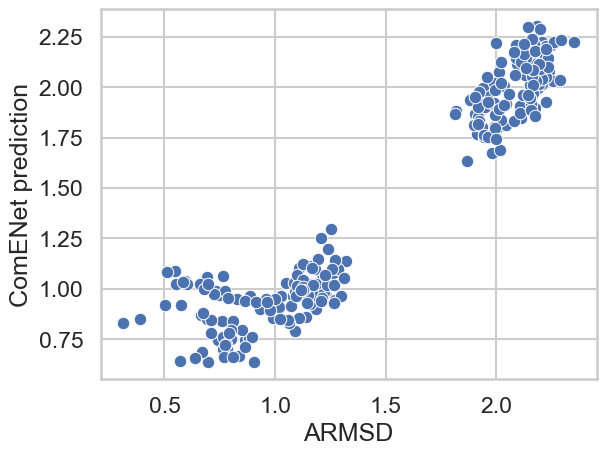

(0.9576714898079118, 3.991445090206565e-136)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


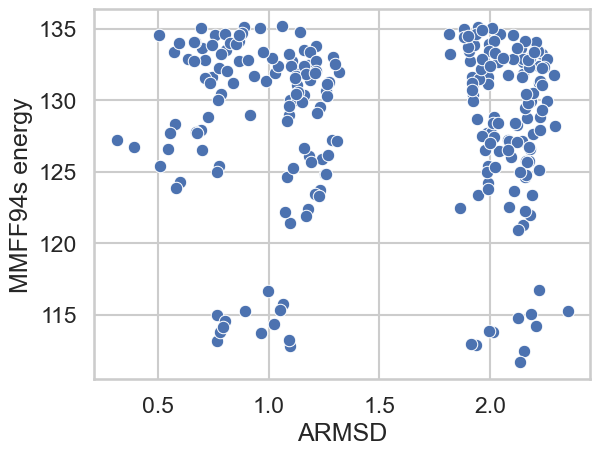

(-0.025810183525725654, 0.6846564014428327)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


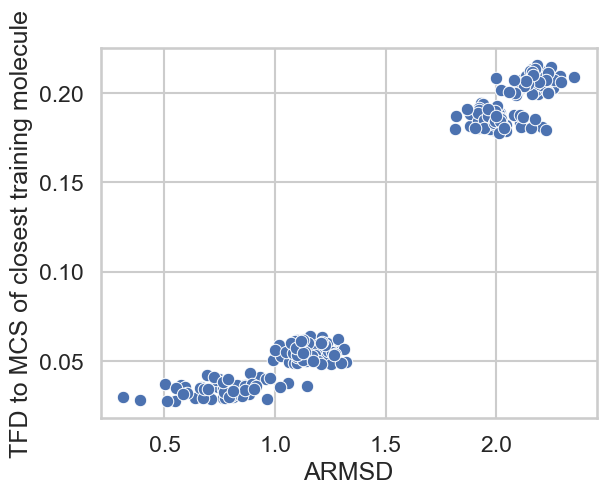

(0.9734938965390473, 6.606557677360796e-161)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.6907216494845361
NQB


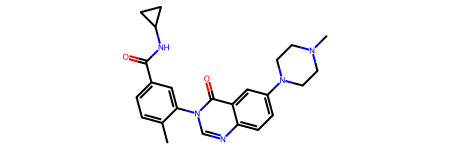

[['4aa5' '2.7.11.24']]


In [97]:
mol, closest_mol = analyse_pdb(pdb_id)

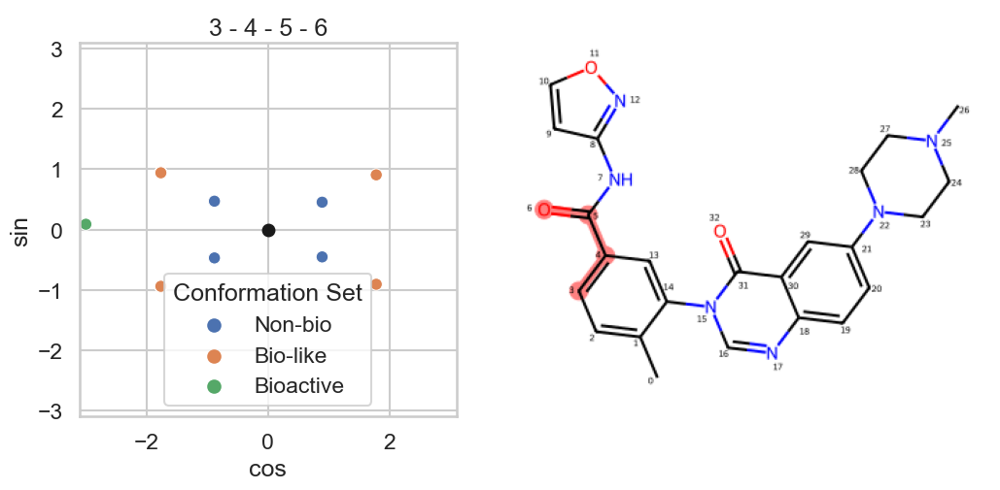

<Figure size 640x480 with 0 Axes>

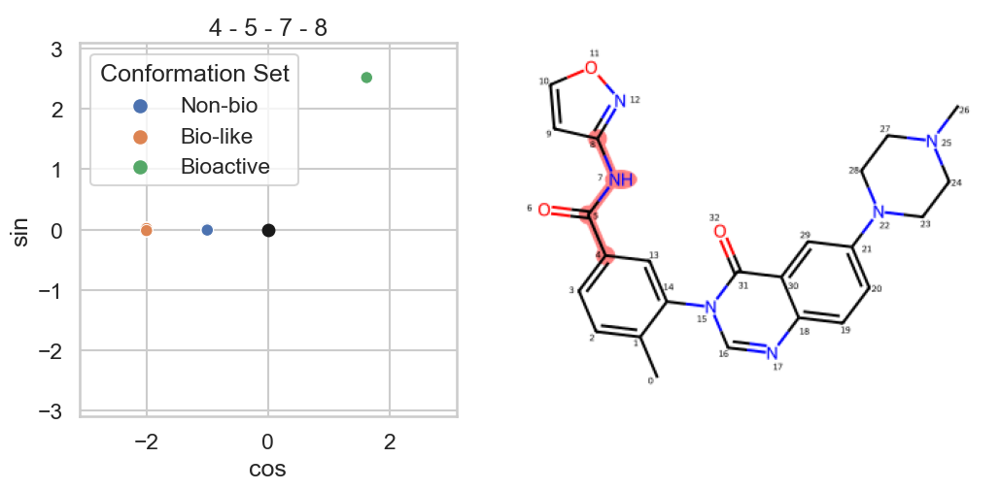

<Figure size 640x480 with 0 Axes>

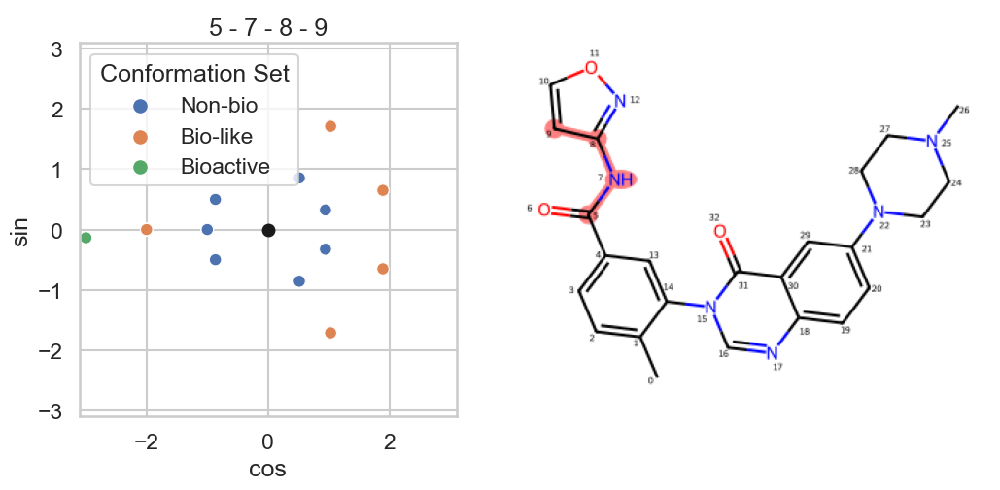

<Figure size 640x480 with 0 Axes>

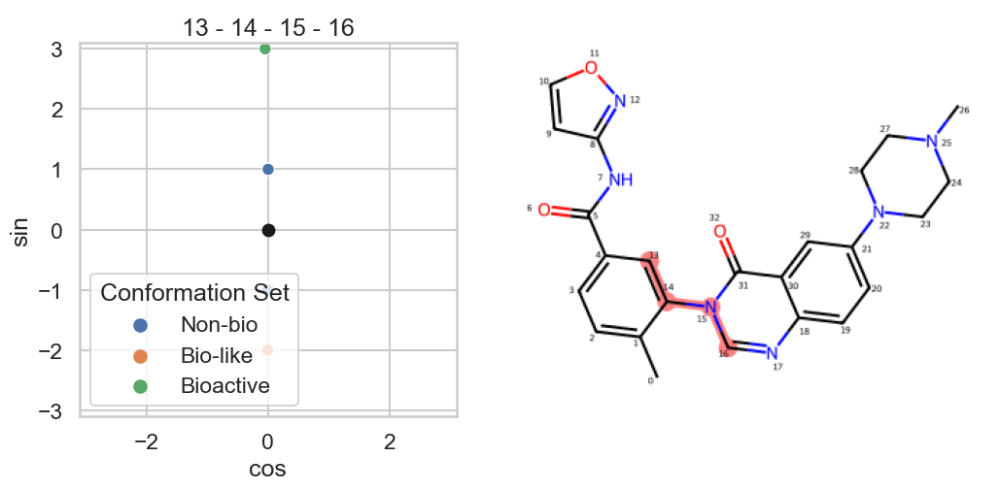

<Figure size 640x480 with 0 Axes>

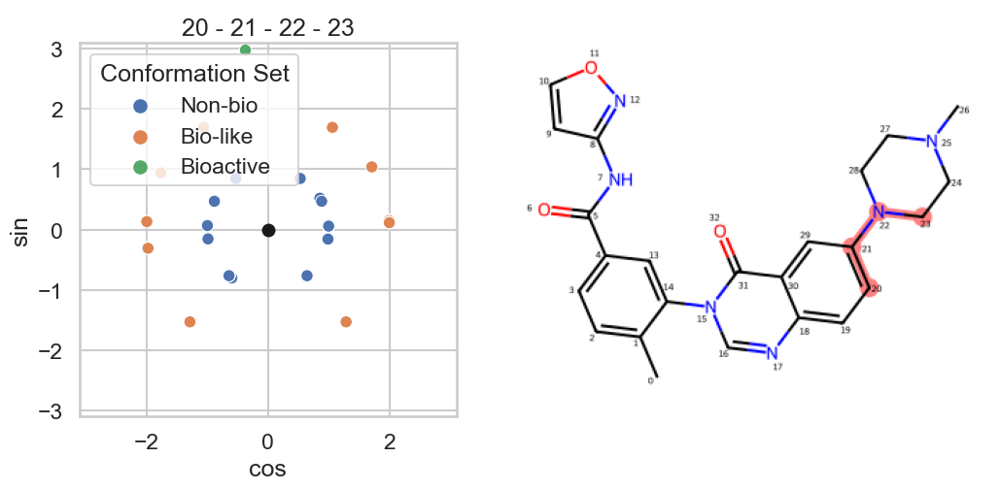

<Figure size 640x480 with 0 Axes>

In [98]:
gen_mol = analyze_torsions(ligand_name, pdb_id)

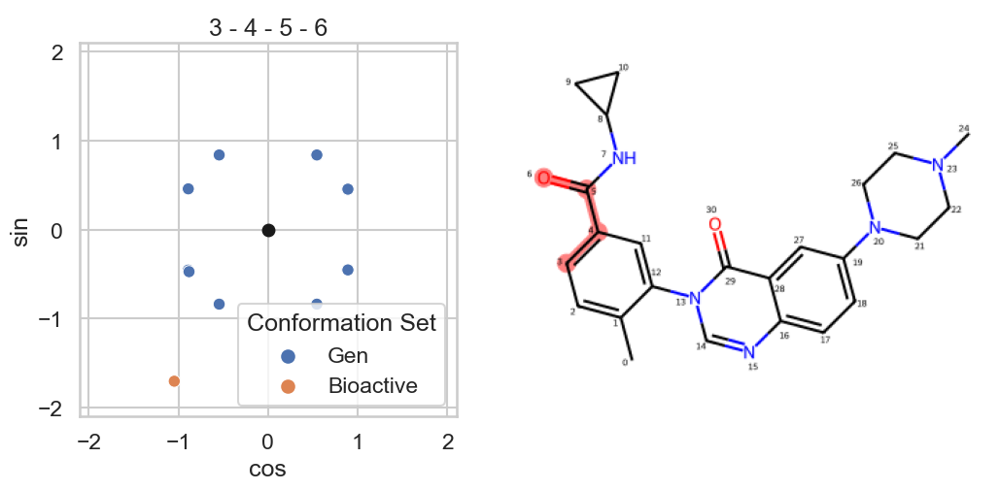

<Figure size 640x480 with 0 Axes>

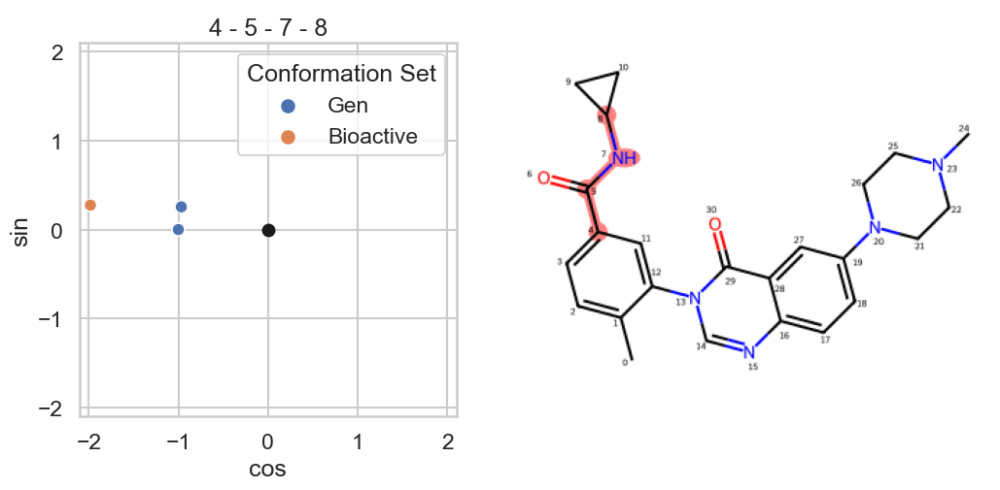

<Figure size 640x480 with 0 Axes>

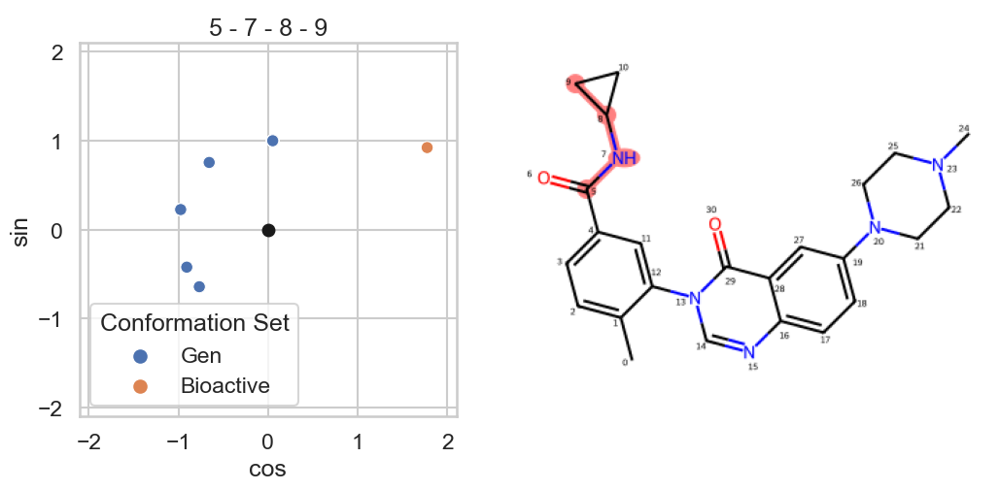

<Figure size 640x480 with 0 Axes>

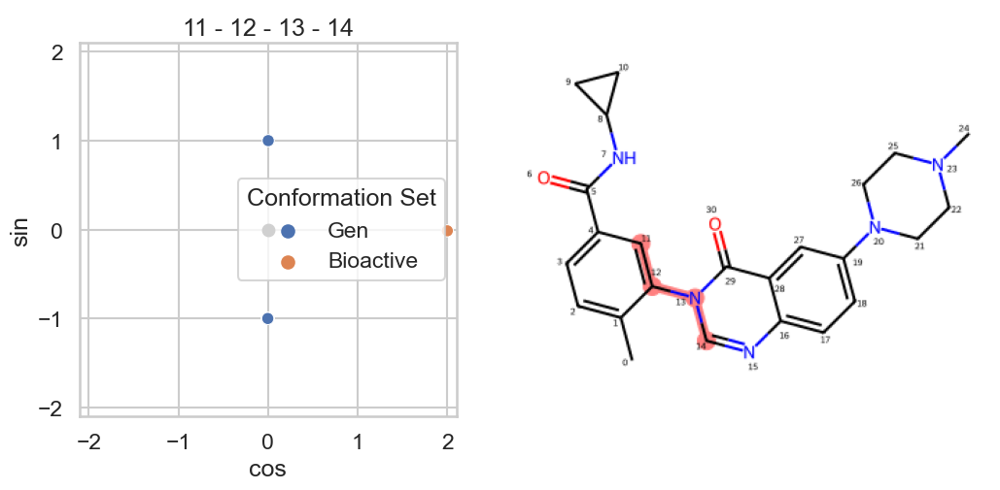

<Figure size 640x480 with 0 Axes>

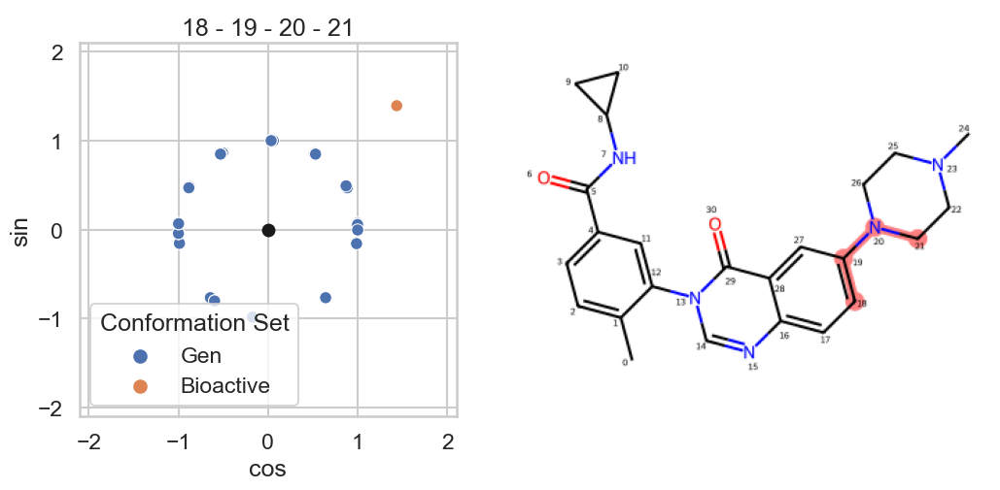

<Figure size 640x480 with 0 Axes>

In [99]:
gen_mol2 = analyze_torsions('NQB', '4aa5', have_bio_like=False)

In [100]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

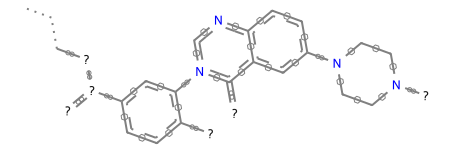

In [116]:
table1, table2, d_idxs, ac1, ac2 = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=5)

In [117]:
table1 = table1.rename({i: f'TOR_{i}' for i in range(len(d_idxs))}, axis=1)
table2 = table2.rename({i: f'TOR_{i}' for i in range(len(d_idxs))}, axis=1)

In [118]:
reshaped_ac1 = ac1.reshape((len(table1), -1))
reshaped_ac2 = ac2.reshape((len(table2), -1))

In [119]:
ac_table1 = table1.copy()
ac_table2 = table2.copy()

In [120]:
for i, acs in enumerate(reshaped_ac1.transpose()):
    ac_table1[f'AC_{i}'] = acs
    
for i, acs in enumerate(reshaped_ac2.transpose()):
    ac_table2[f'AC_{i}'] = acs

In [121]:
ac_table1 = ac_table1.reset_index()
ac_table2 = ac_table2.reset_index()

In [122]:
ac_table1.head()

,index,preds,targets,TOR_0,TOR_1,TOR_2,TOR_3,TOR_4,AC_0,AC_1,...,AC_23,AC_24,AC_25,AC_26,AC_27,AC_28,AC_29,AC_30,AC_31,AC_32
0,0,2.012911,2.151981,-25.0,180.0,60.0,90.0,-170.0,0.144969,0.092229,...,0.011106,-0.016946,-0.026673,-0.019821,-0.027412,0.043200,0.038780,0.056163,0.131364,0.077470
1,1,2.083175,2.237003,-25.0,180.0,60.0,90.0,5.0,0.136844,0.074291,...,0.040013,-0.001787,-0.037426,-0.020270,-0.015324,0.012164,0.058275,0.101454,0.132194,0.098188
2,2,0.855361,0.989638,-25.0,180.0,60.0,-90.0,-170.0,0.059164,0.036159,...,-0.010563,-0.015977,-0.026258,-0.026401,-0.019962,0.035066,0.060801,0.065208,0.142640,0.117489
3,3,0.964093,1.027644,-25.0,180.0,60.0,-90.0,5.0,0.064714,0.045875,...,0.036441,-0.011064,-0.033754,-0.020411,-0.027680,0.000835,0.036450,0.054175,0.146797,0.098444
4,4,2.070329,2.150307,25.0,180.0,60.0,90.0,-170.0,0.163445,0.096242,...,0.019655,-0.010358,-0.019038,-0.021919,-0.027892,0.033444,0.037009,0.051196,0.121770,0.077118


In [123]:
ac_table2.head()

,index,preds,TOR_0,TOR_1,TOR_2,TOR_3,TOR_4,AC_0,AC_1,AC_2,...,AC_21,AC_22,AC_23,AC_24,AC_25,AC_26,AC_27,AC_28,AC_29,AC_30
0,0,1.987681,-25.0,180.0,-155.0,90.0,-170.0,0.118619,0.050342,0.021572,...,-0.004771,-0.014803,-0.026123,-0.021966,-0.028481,0.019813,0.017266,-0.005830,0.151141,0.084421
1,1,2.093704,-25.0,180.0,-155.0,90.0,5.0,0.105426,0.040914,0.020540,...,0.012476,-0.007188,-0.026704,-0.024479,-0.028264,0.023854,0.055587,0.049413,0.138939,0.107227
2,2,1.016028,-25.0,180.0,-155.0,-90.0,-170.0,0.034284,0.006622,-0.004988,...,-0.005850,-0.016287,-0.028037,-0.030980,-0.024691,0.032184,0.030047,0.030272,0.153340,0.105348
3,3,1.104072,-25.0,180.0,-155.0,-90.0,5.0,0.037489,0.016758,0.005136,...,0.016604,-0.008576,-0.038340,-0.026129,-0.031442,0.000791,0.033443,0.021702,0.172109,0.090037
4,4,2.121528,25.0,180.0,-155.0,90.0,-170.0,0.146838,0.085629,0.016261,...,0.020743,-0.005257,-0.013158,-0.018305,-0.024383,0.011704,0.023823,0.033464,0.168988,0.075267


In [135]:
indexes = [f'TOR_{i}' for i in [0, 1, 3, 4]]
merged_table = ac_table1.merge(ac_table2, on=indexes, suffixes = ('', '_y'))

In [136]:
len(merged_table)

364

In [126]:
corr_table = merged_table.corr()

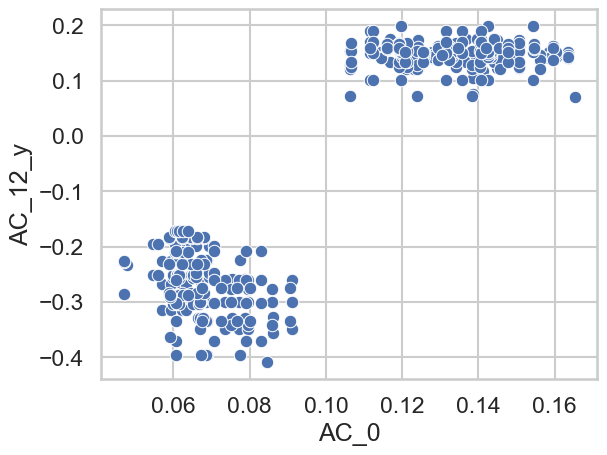

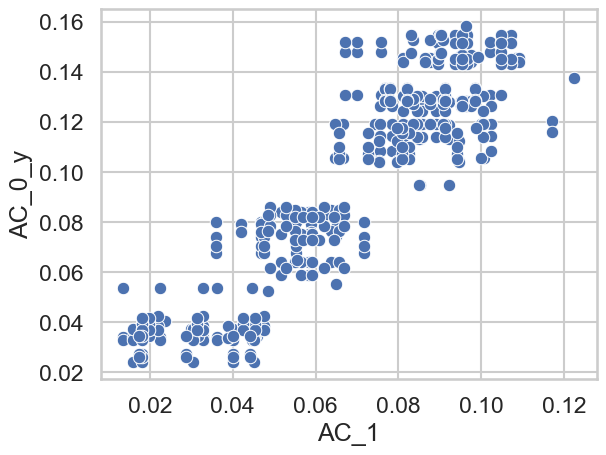

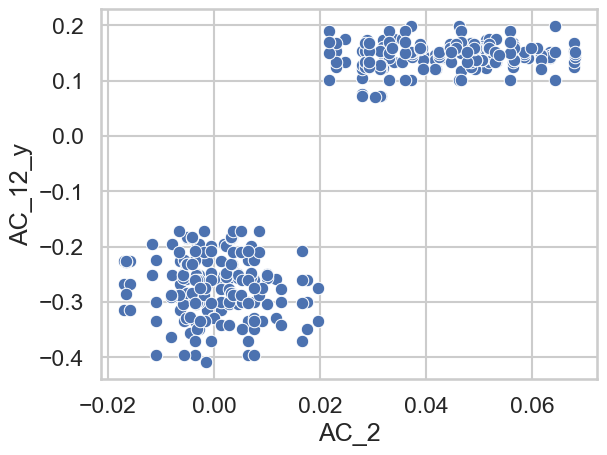

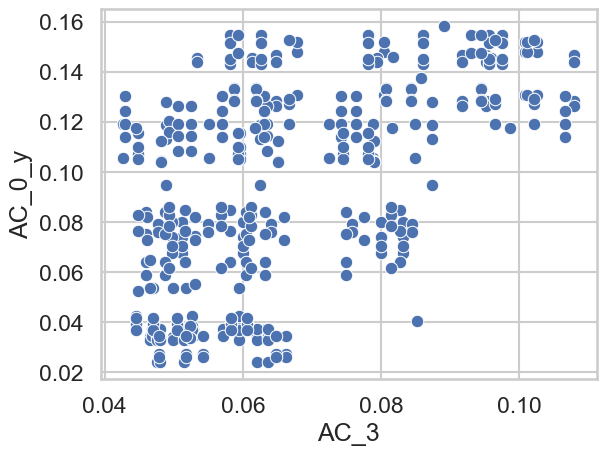

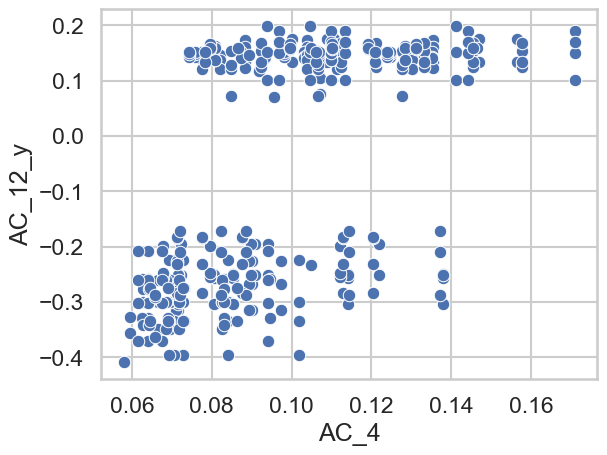

...

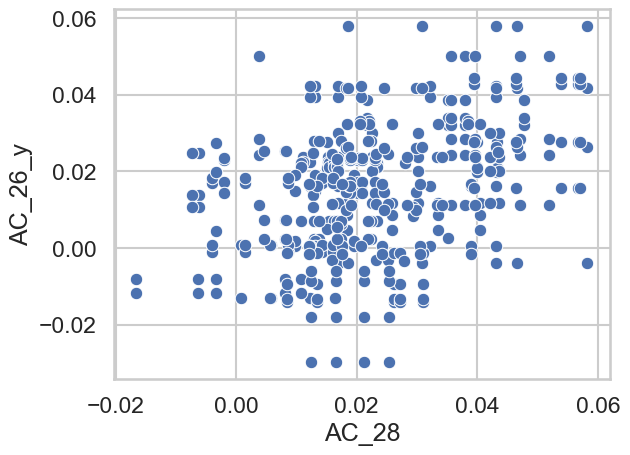

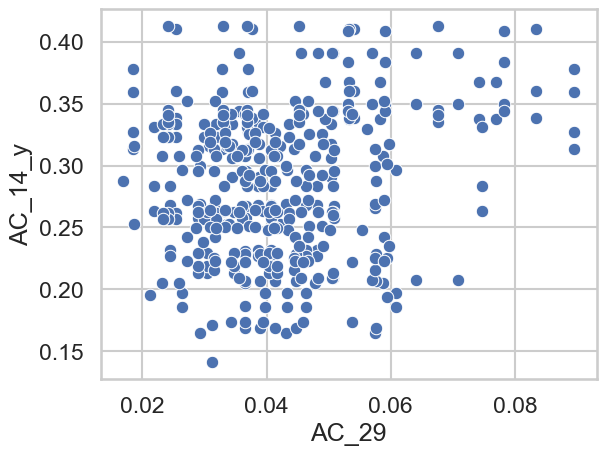

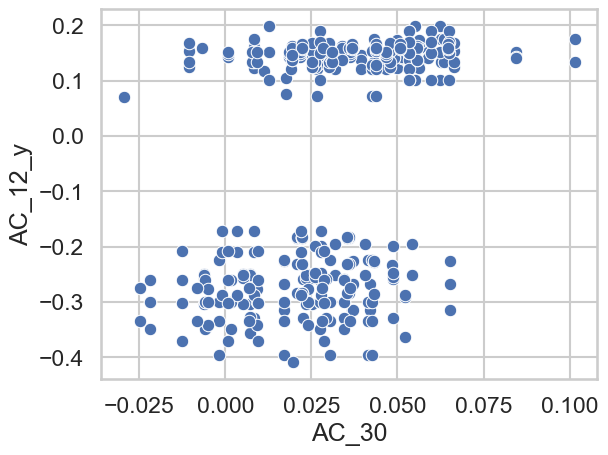

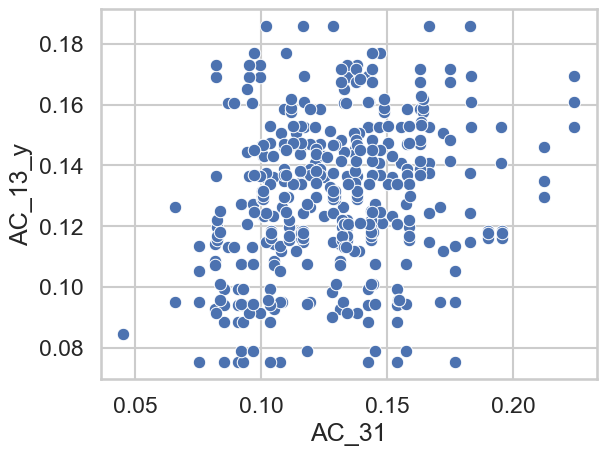

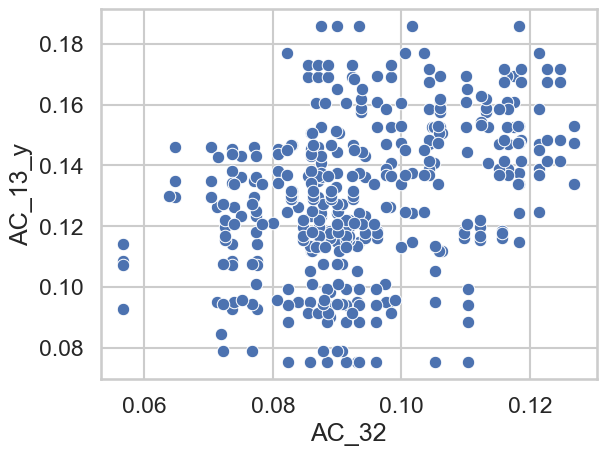

In [127]:
col_names = [f'AC_{i}' for i in range(len(reshaped_ac1.transpose()))]
other_col_names = [f'AC_{i}_y' for i in range(len(reshaped_ac2.transpose()))]
for col_name in col_names:
    col = corr_table[col_name]
    col = col[other_col_names]
    best_col = col[col == col.max()]
    sns.scatterplot(data=merged_table,
                   x=col_name,
                   y=best_col.index[0])
    plt.show()

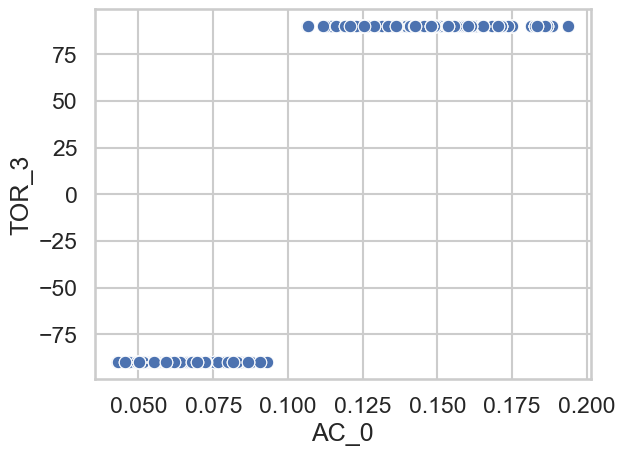

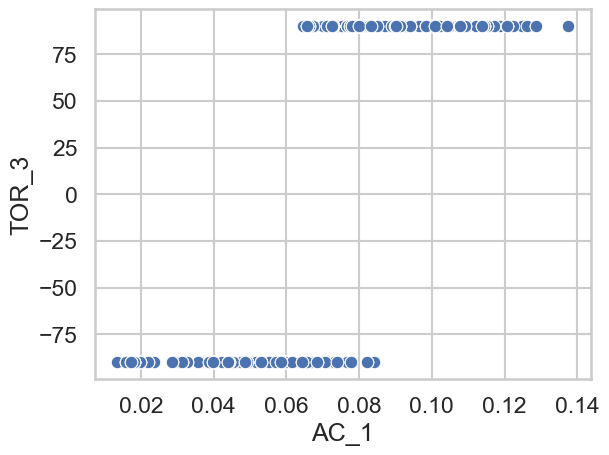

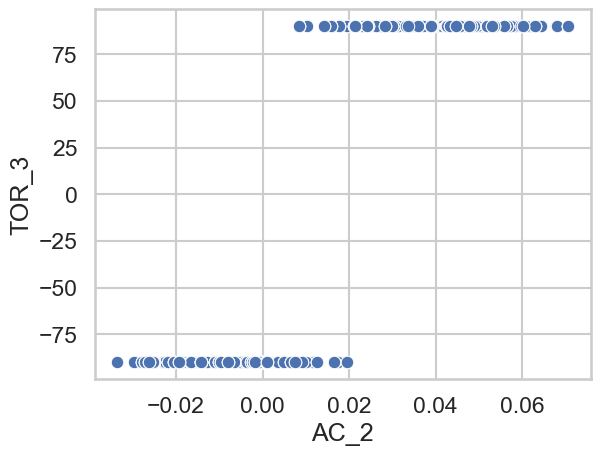

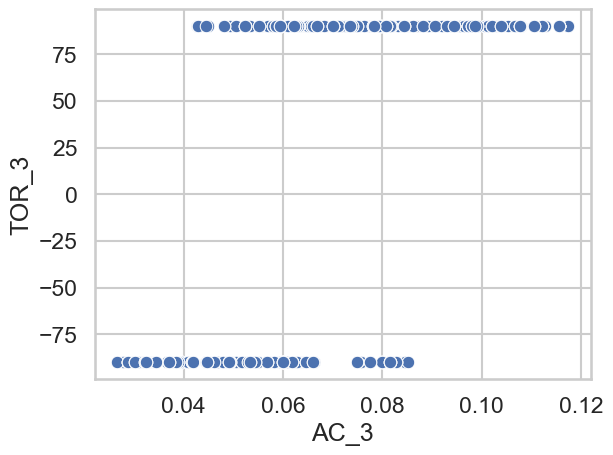

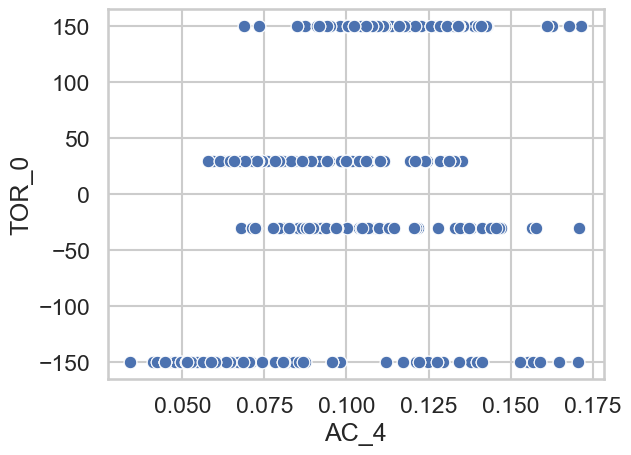

...

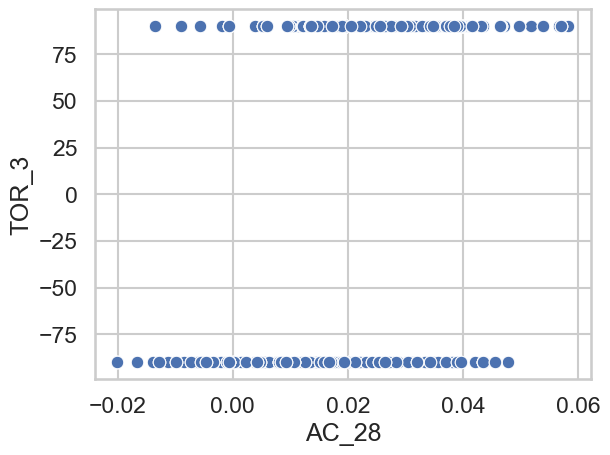

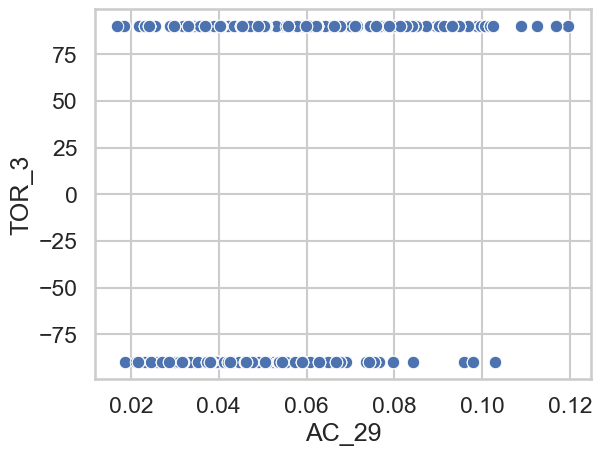

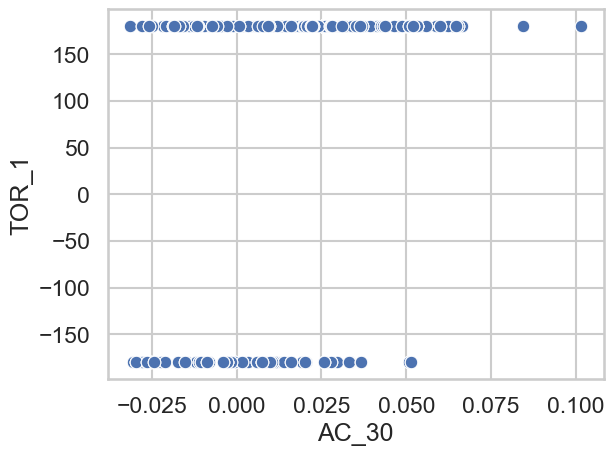

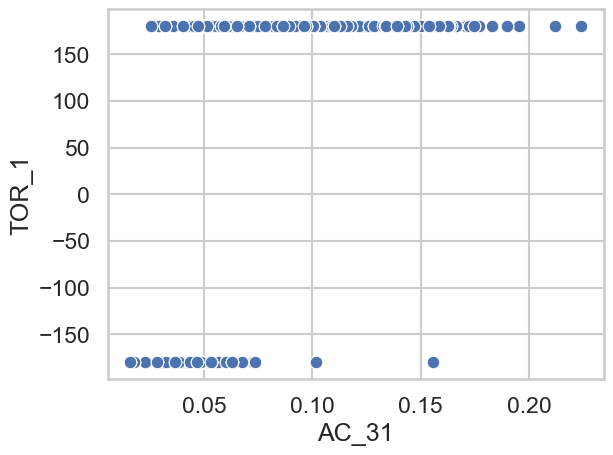

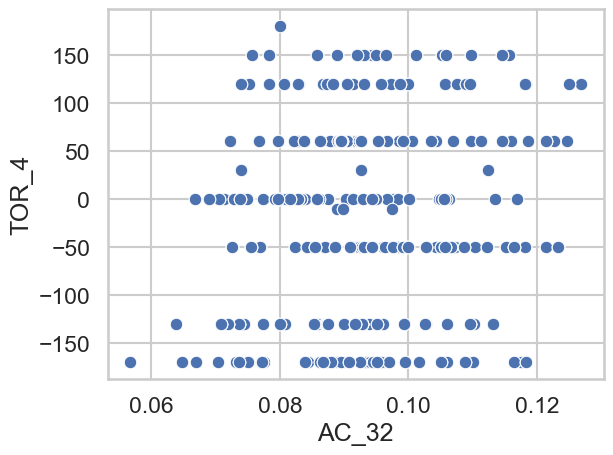

In [112]:
col_names = [f'AC_{i}' for i in range(len(reshaped_ac1.transpose()))]
other_col_names = [f'TOR_{i}' for i in range(len(d_idxs))]
for col_name in col_names:
    col = corr_table[col_name]
    col = col[other_col_names]
    best_col = col[col == col.max()]
    sns.scatterplot(data=merged_table,
                   x=col_name,
                   y=best_col.index[0])
    plt.show()

<AxesSubplot:xlabel='preds', ylabel='preds_y'>

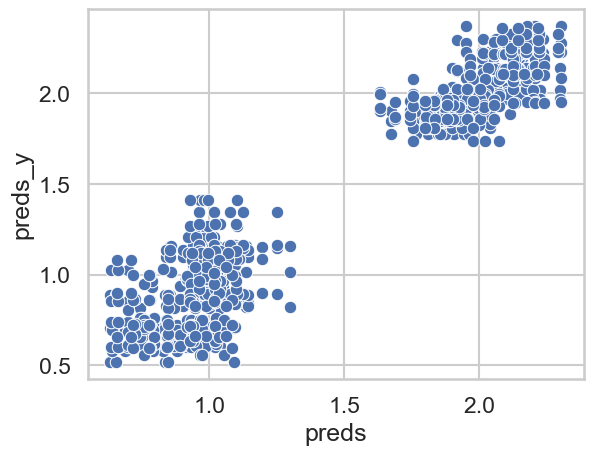

In [114]:
sns.scatterplot(data=merged_table, x='preds', y='preds_y')

<AxesSubplot:xlabel='targets', ylabel='preds_y'>

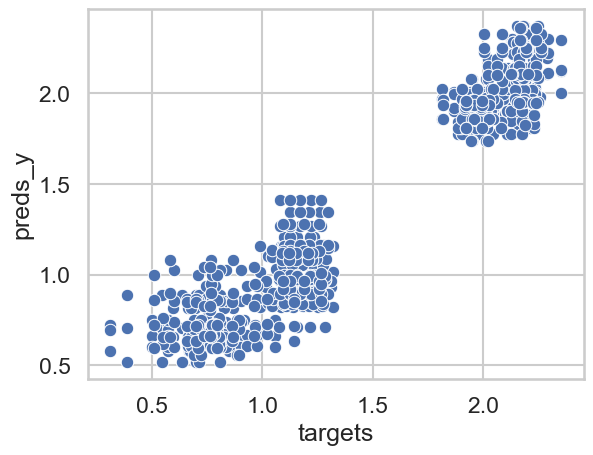

In [167]:
sns.scatterplot(data=merged_table, x='targets', y='preds_y')

In [ ]:
5ml5 	1VI 	

In [137]:
pdb_id = '5ml5'
ligand_name = '1VI'

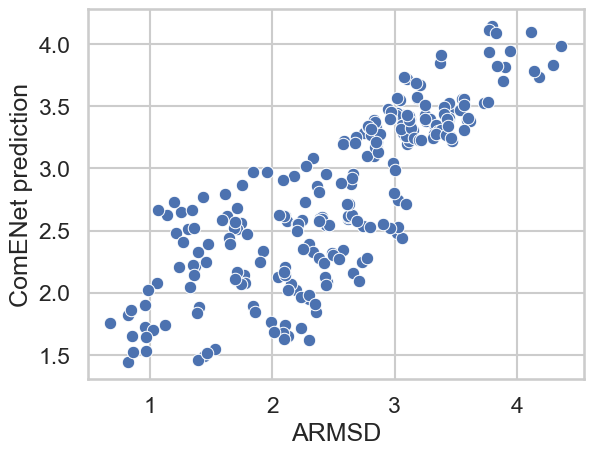

(0.8200493087108534, 4.77465440662074e-62)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


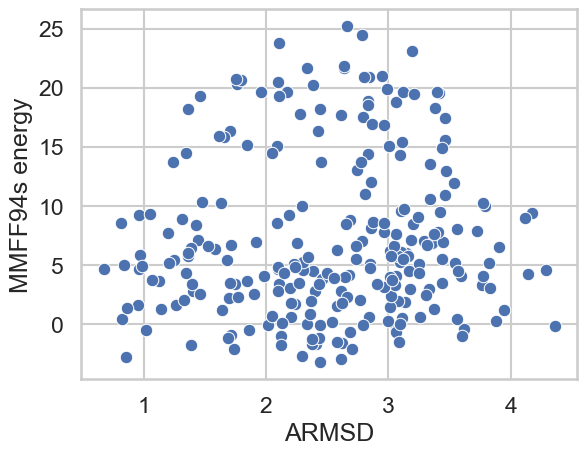

(0.06857008683035504, 0.28013037378109473)


/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


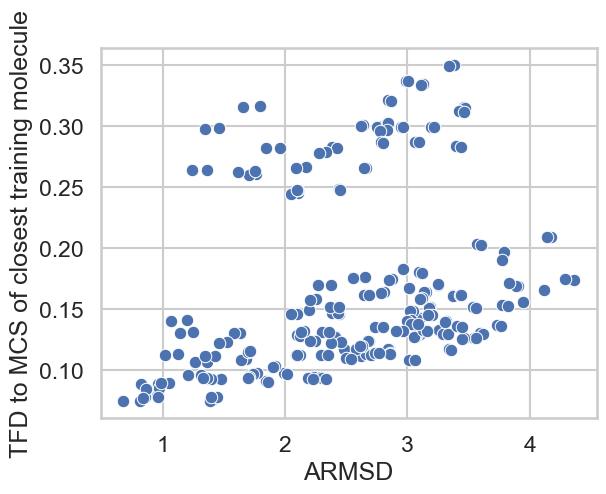

(0.2924184715670838, 2.5563368878490883e-06)


interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.5847457627118644
D5Q


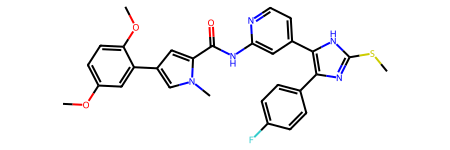

[['5mqv' '2.7.11.1']
 ['5mqv' '2.7.11.26']]


In [138]:
mol, closest_mol = analyse_pdb(pdb_id)

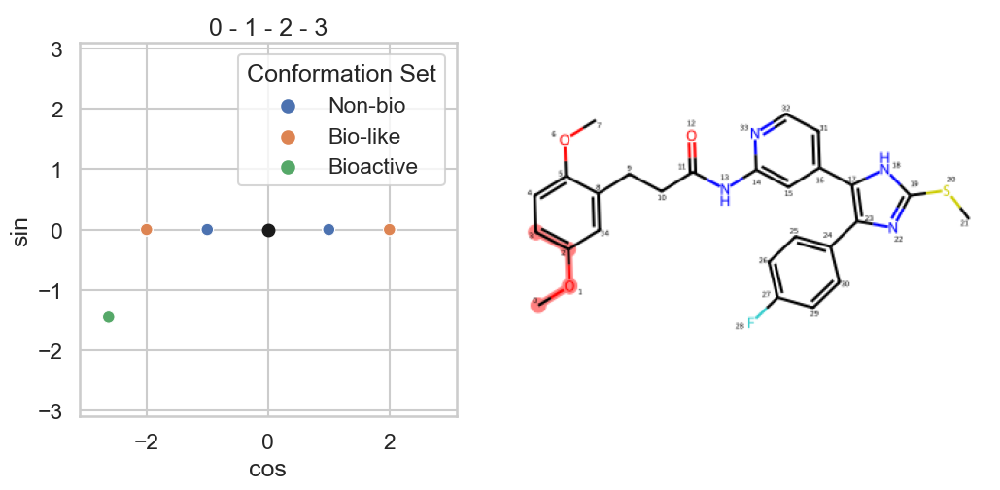

<Figure size 640x480 with 0 Axes>

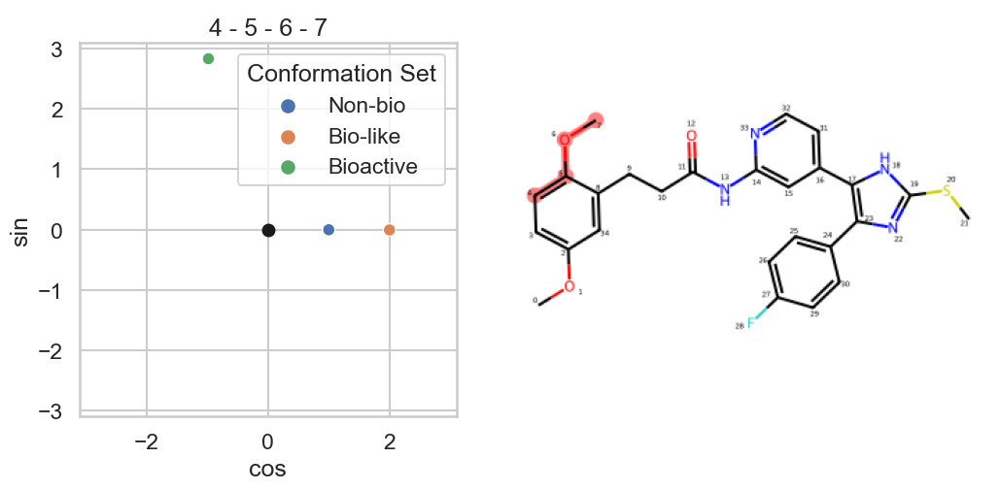

<Figure size 640x480 with 0 Axes>

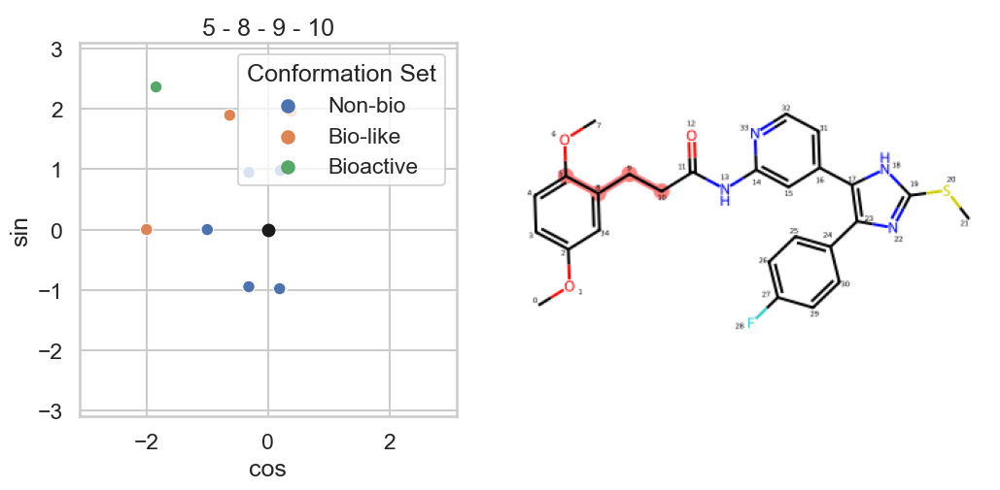

<Figure size 640x480 with 0 Axes>

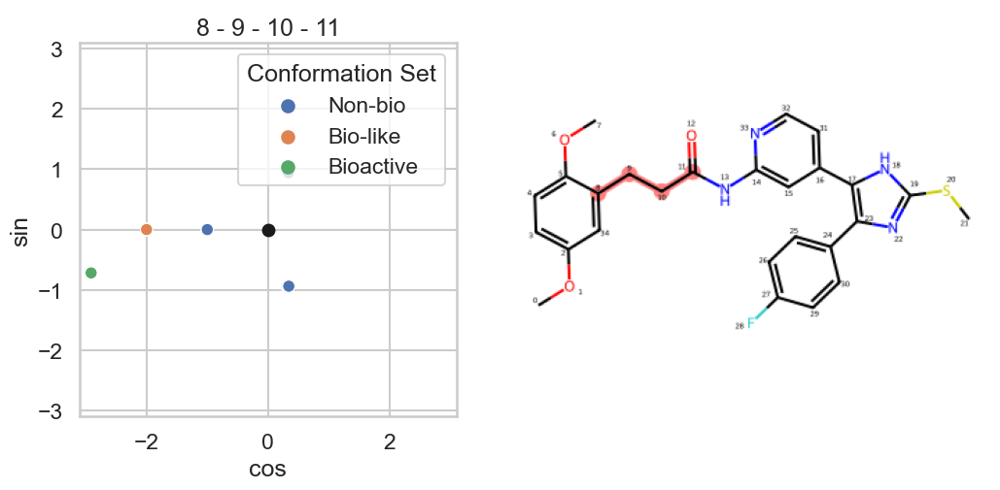

<Figure size 640x480 with 0 Axes>

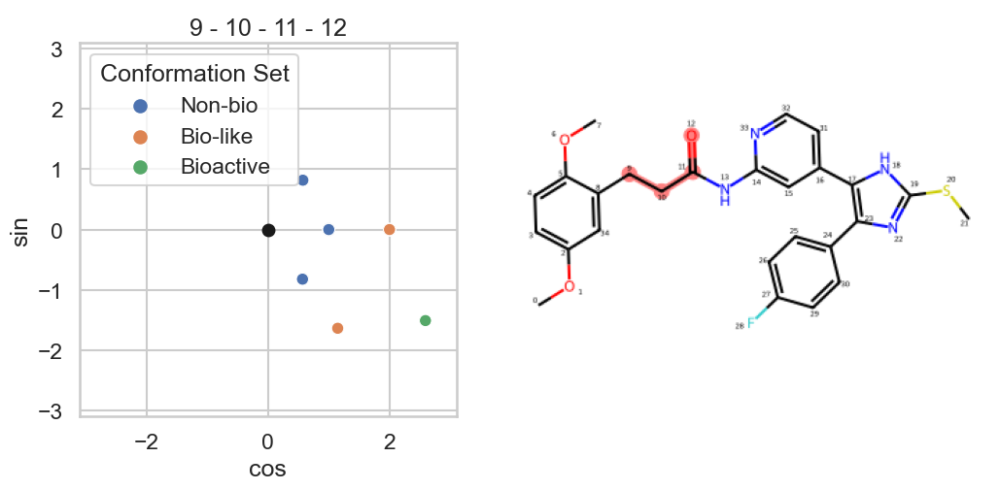

<Figure size 640x480 with 0 Axes>

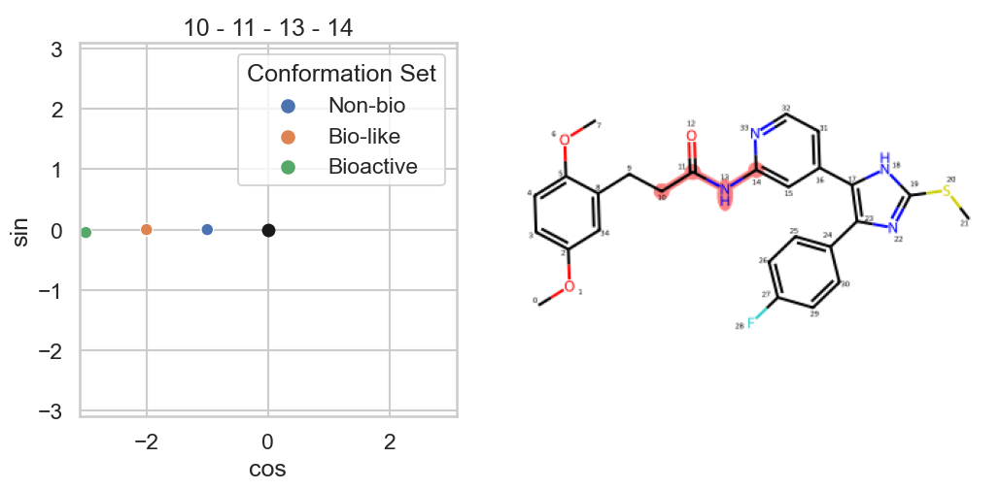

<Figure size 640x480 with 0 Axes>

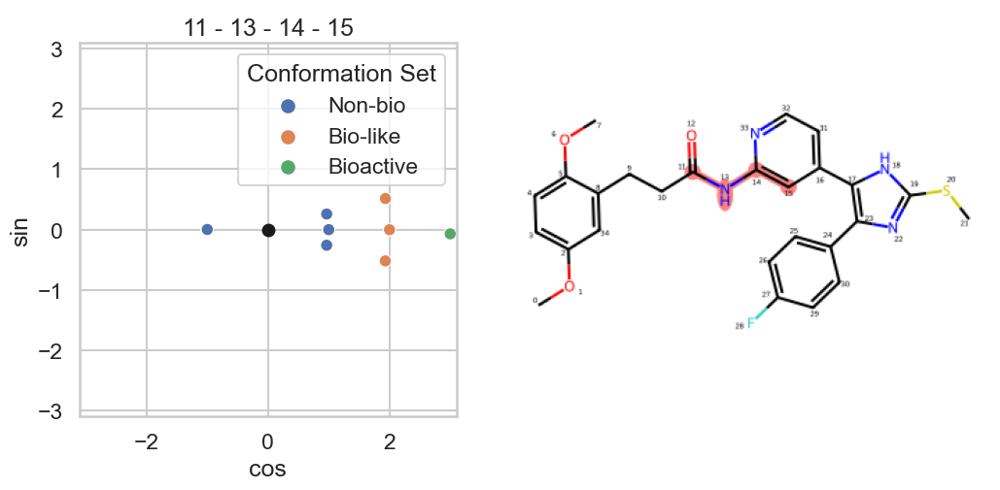

<Figure size 640x480 with 0 Axes>

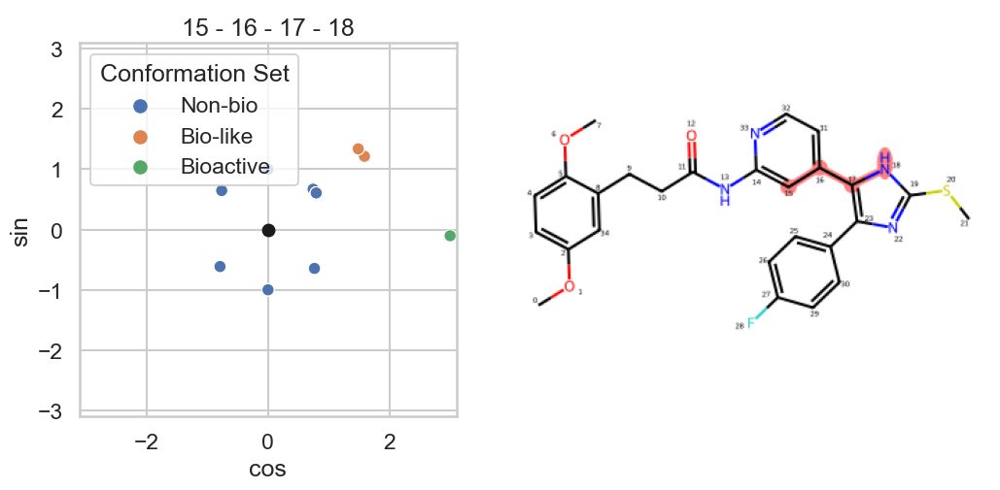

<Figure size 640x480 with 0 Axes>

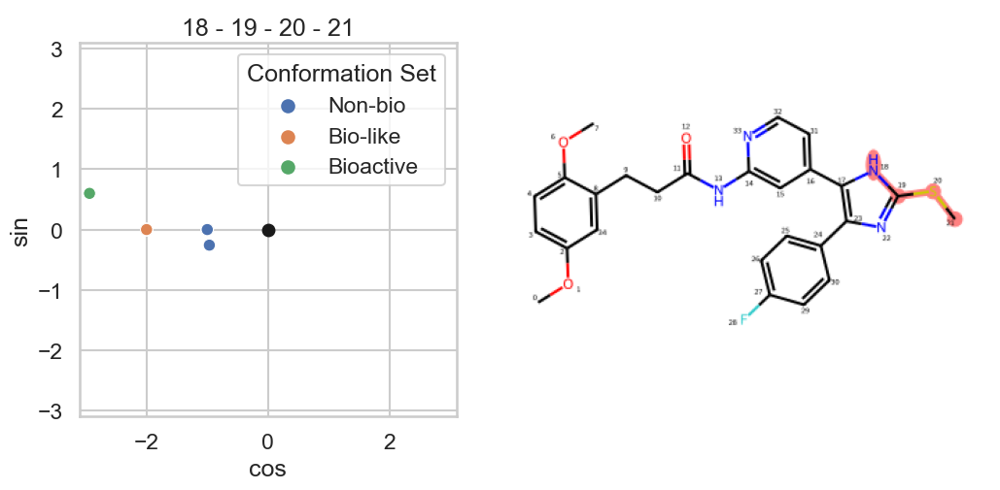

<Figure size 640x480 with 0 Axes>

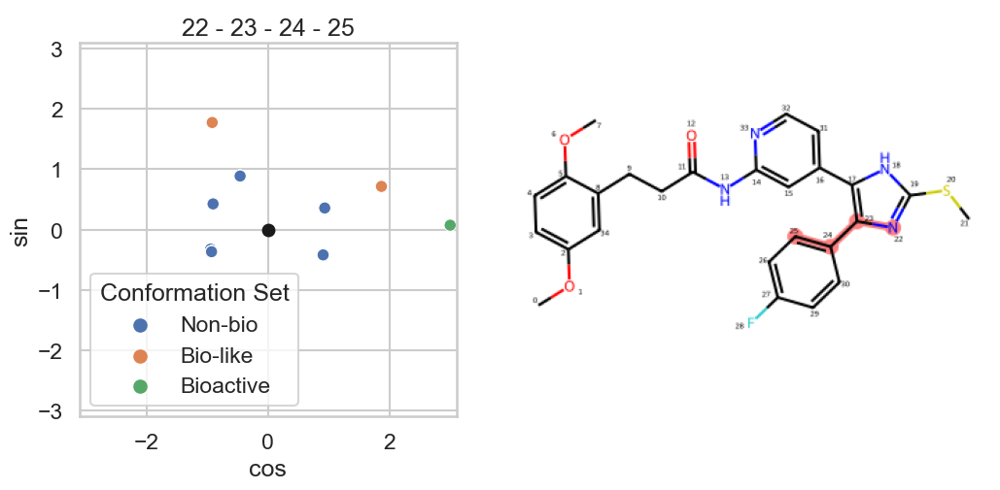

<Figure size 640x480 with 0 Axes>

In [139]:
gen_mol = analyze_torsions(ligand_name, pdb_id)

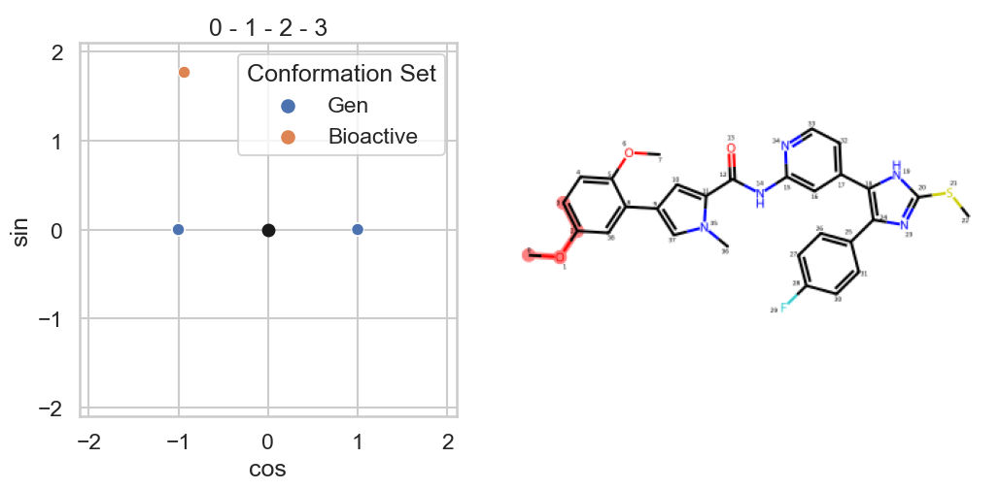

<Figure size 640x480 with 0 Axes>

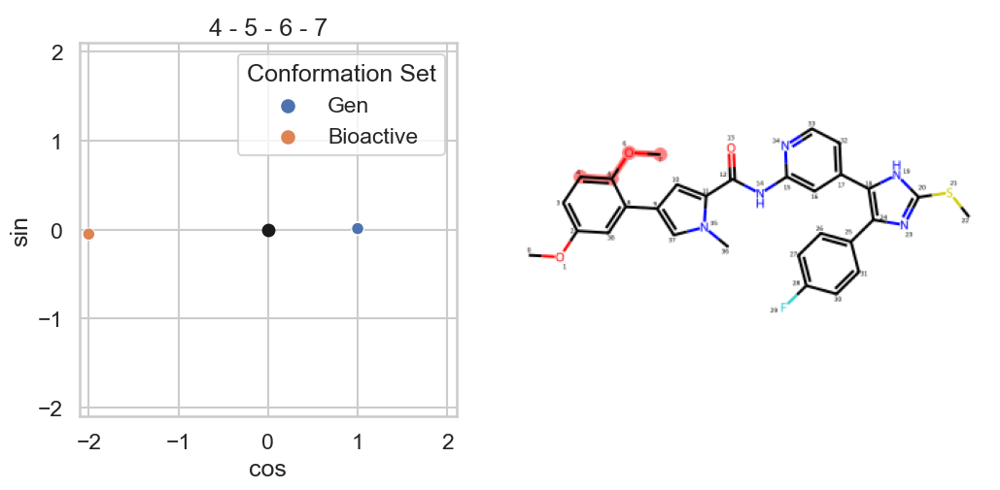

<Figure size 640x480 with 0 Axes>

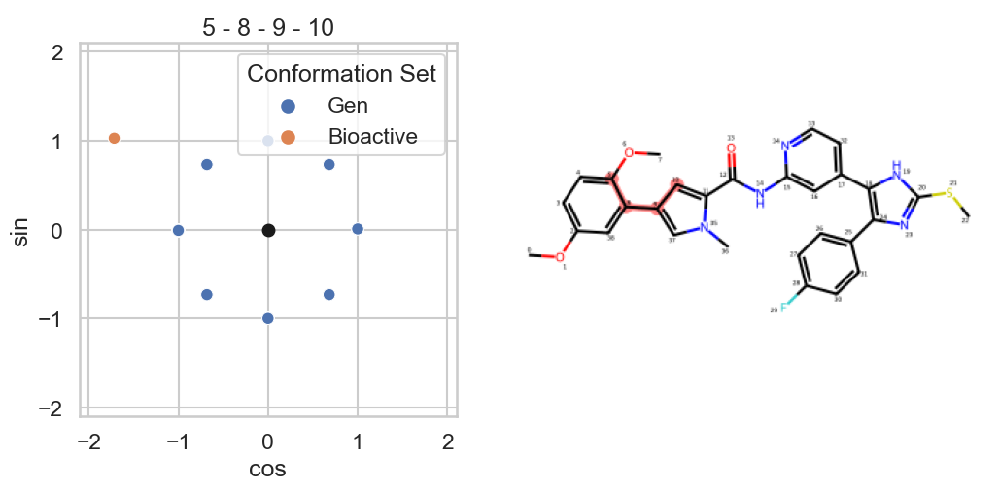

<Figure size 640x480 with 0 Axes>

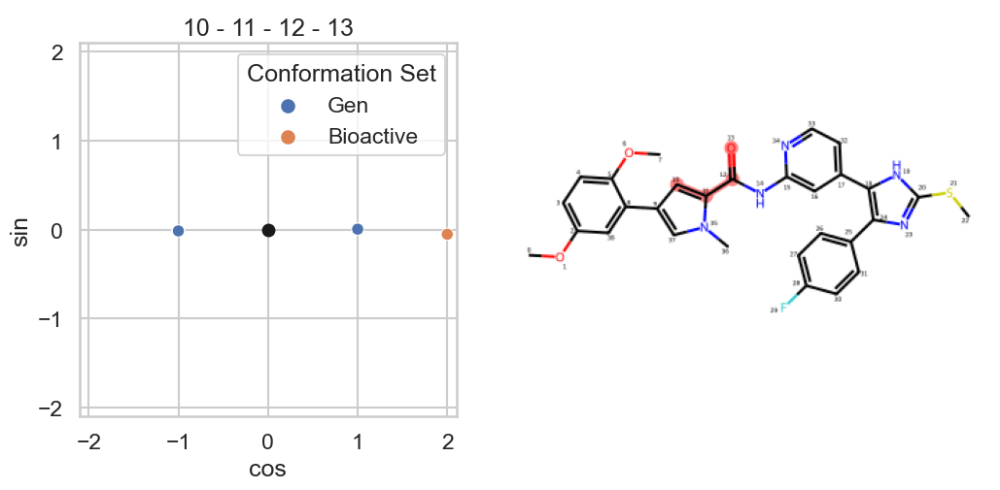

<Figure size 640x480 with 0 Axes>

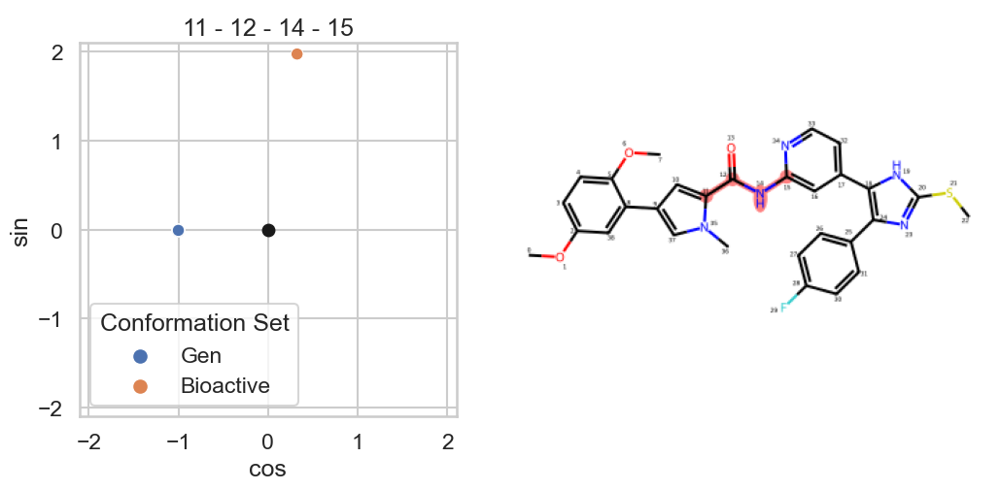

<Figure size 640x480 with 0 Axes>

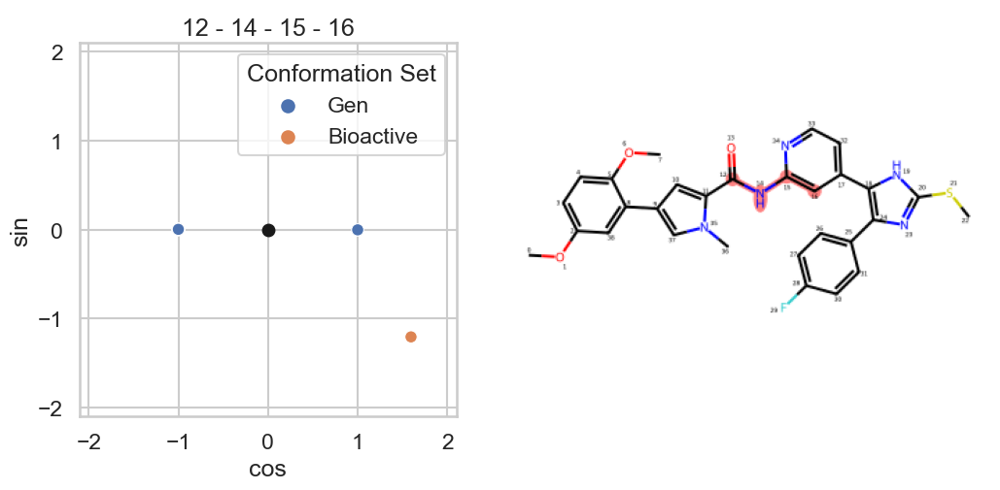

<Figure size 640x480 with 0 Axes>

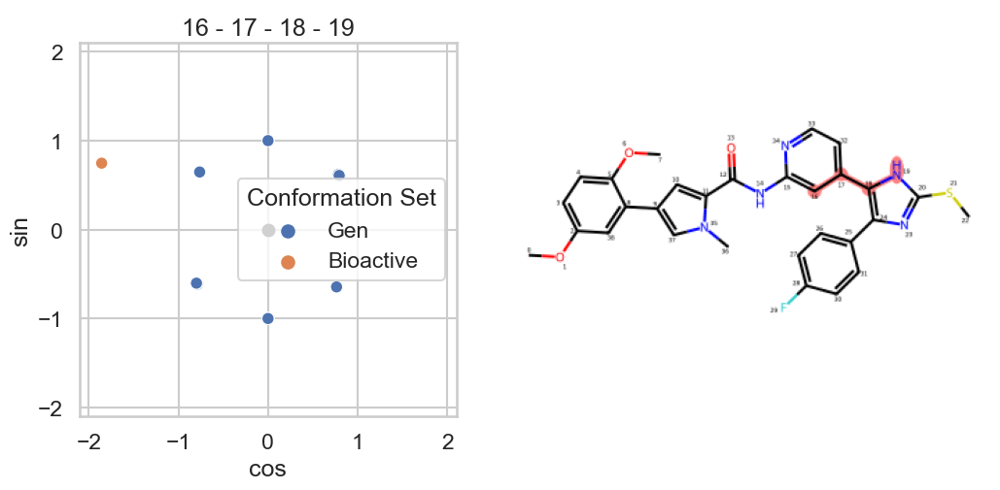

<Figure size 640x480 with 0 Axes>

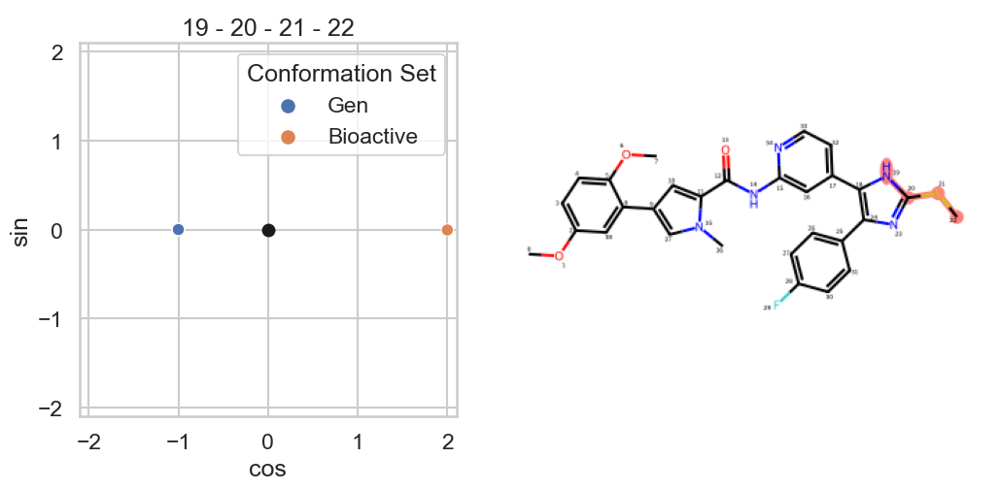

<Figure size 640x480 with 0 Axes>

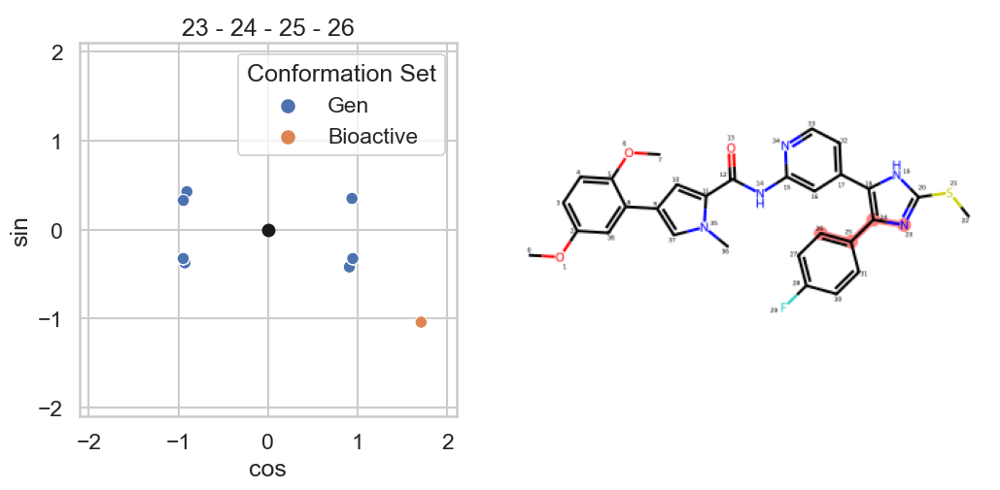

<Figure size 640x480 with 0 Axes>

In [140]:
gen_mol2 = analyze_torsions('D5Q', '5mqv', have_bio_like=False)

In [141]:
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

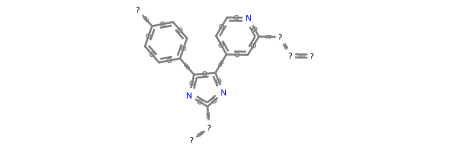

In [160]:
table1, table2, d_idxs, ac1, ac2 = compare_to_ref_mcs(gen_mol, gen_mol2, targets, bin_size=1)

In [161]:
d_idxs

[(11, 13, 14, 15), (15, 16, 17, 18), (18, 19, 20, 21), (22, 23, 24, 25)]

In [162]:
table1 = table1.reset_index()
table2 = table2.reset_index()

In [163]:
table1.head()

,index,preds,targets,0,1,2,3
0,0,3.387992,3.594560,-0.0,-142.0,-180.0,-158.0
1,1,3.380317,3.616060,-0.0,-142.0,-180.0,-158.0
2,2,3.428414,3.065228,-0.0,-142.0,-180.0,-158.0
3,3,3.377127,3.060000,-0.0,-142.0,-180.0,-158.0
4,4,1.727558,0.957075,-0.0,37.0,-180.0,21.0


In [164]:
table2.head()

,index,preds,0,1,2,3
0,0,3.352119,-0.0,-142.0,180.0,-158.0
1,1,3.177045,-0.0,-142.0,180.0,-158.0
2,2,1.841113,-0.0,37.0,180.0,21.0
3,3,1.647752,-0.0,38.0,-180.0,-158.0
4,4,1.747076,-0.0,38.0,-180.0,-158.0


In [165]:
indexes = [i for i in range(len(d_idxs))]
merged_table = table1.merge(table2, on=indexes)

In [166]:
merged_table

,index_x,preds_x,targets,0,1,2,3,index_y,preds_y
0,0,3.387992,3.594560,-0.0,-142.0,-180.0,-158.0,10,3.827736
1,0,3.387992,3.594560,-0.0,-142.0,-180.0,-158.0,11,3.696524
2,0,3.387992,3.594560,-0.0,-142.0,-180.0,-158.0,16,3.752909
3,0,3.387992,3.594560,-0.0,-142.0,-180.0,-158.0,27,3.778440
4,0,3.387992,3.594560,-0.0,-142.0,-180.0,-158.0,80,3.443890
...,...,...,...,...,...,...,...,...,...
1283,157,3.861639,3.945144,-0.0,140.0,-180.0,155.0,54,3.205153
1284,157,3.861639,3.945144,-0.0,140.0,-180.0,155.0,55,3.070564
1285,157,3.861639,3.945144,-0.0,140.0,-180.0,155.0,79,3.000923
1286,157,3.861639,3.945144,-0.0,140.0,-180.0,155.0,95,3.148993


<AxesSubplot:xlabel='preds_x', ylabel='preds_y'>

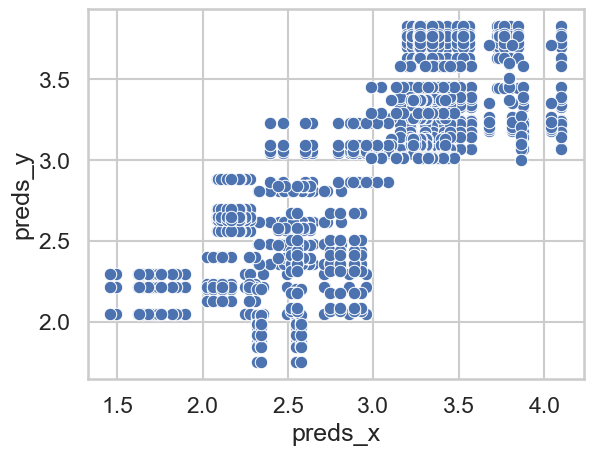

In [167]:
sns.scatterplot(data=merged_table, x='preds_x', y='preds_y')

<AxesSubplot:xlabel='targets', ylabel='preds_y'>

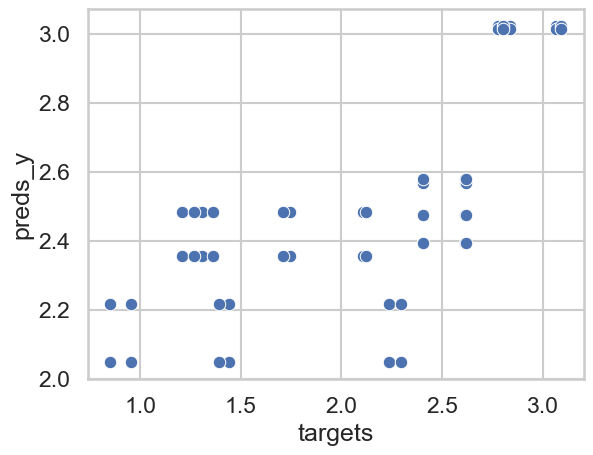

In [366]:
sns.scatterplot(data=merged_table, x='targets', y='preds_y')

In [ ]:
dihedrals_indexes = ['']

In [129]:
import torch
with torch.no_grad():
    model.show_atomic_contributions(gen_mol, save_dir='3n4l')

In [249]:
dihedrals_1 = ca.get_conformers_dihedrals_deg(gen_mol, 4,5,6,7)
dihedrals_2 = ca.get_conformers_dihedrals_deg(gen_mol, 8,9,17,18)

In [113]:
pdb_id = '3ivh'
preds = all_conf_results[pdb_id]['regression']['preds']
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

<AxesSubplot:>

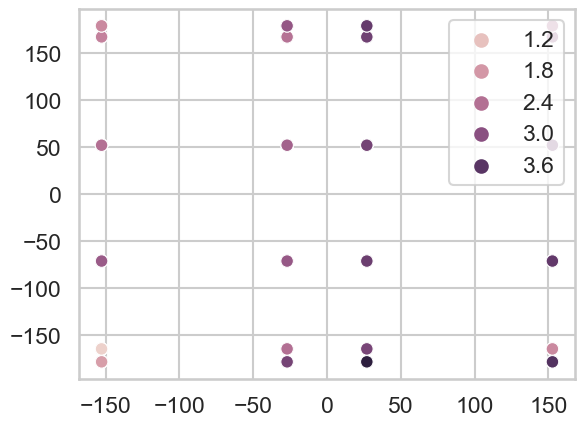

In [251]:
sns.scatterplot(x=dihedrals_1, y=dihedrals_2, hue=targets)

<AxesSubplot:>

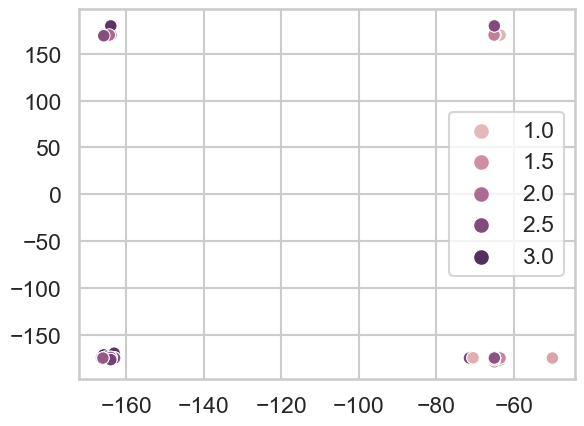

In [116]:
sns.scatterplot(x=dihedrals_1, y=dihedrals_2, hue=preds)

In [ ]:
#RANDOM

In [123]:
r0_results_df = results_df[(results_df['Test set'] == 'Random')
                          &(results_df['Iteration'] == 0)]
r0_regression_df = regression_df[(regression_df['Test set'] == 'Random')
                          &(regression_df['Iteration'] == 0)]

In [124]:
from data.utils.similarity_search import SimilaritySearch
from rdkit import Chem
from data.split.random_split import RandomSplit

In [125]:
ss = SimilaritySearch(smiles_list=cel_df['smiles'])
data_split = RandomSplit()

Similarity matrix ready


In [126]:
from IPython.display import display

In [127]:
from rdkit.Chem import AllChem
from data.utils.molconfviewer import MolConfViewer

def get_mol_energy(mol, conf_id):
    mol_properties = AllChem.MMFFGetMoleculeProperties(mol, 
                                                       mmffVariant='MMFF94s')
    force_field = AllChem.MMFFGetMoleculeForceField(mol, 
                                                mol_properties,
                                                confId=conf_id)
    energy = force_field.CalcEnergy()
    return energy

def analyse_pdb(pdb_id):
    df = r0_regression_df[r0_regression_df['PDB ID']  == pdb_id]
    sns.scatterplot(data=df,
                   x='ARMSD',
                   y='Prediction')
    plt.show()
    ligand_name = pdbbind_df[pdbbind_df['PDB ID'] == pdb_id]['Ligand name'].values[0]
    filename = cel_df[cel_df['ensemble_name'] == ligand_name]['filename'].values[0]
    filepath = os.path.join('../hdd/pdbbind_bioactive/data/gen_conf_ensembles/', filename)
    ce = ConfEnsemble.from_file(filepath)
    mol = ce.mol
    conf_ids = [conf.GetId() for conf in mol.GetConformers()]
    energies = [get_mol_energy(mol, conf_id) for conf_id in conf_ids]
    sns.scatterplot(x=df['ARMSD'], y=energies)
    MolConfViewer().view(Chem.RemoveHs(ce.mol), properties={'Energy': energies})
    cel_df['smiles']
    smiles = cel_df[cel_df['ensemble_name'] == ligand_name]['smiles'].values[0]
    closest_smiles, sims = ss.find_closest_in_subset(smiles=smiles, subset=data_split.get_smiles('train'))
    print(sims[0])
    print(cel_df.loc[cel_df['smiles'].values.tolist().index(closest_smiles[0]), 'ensemble_name'])
    display(Chem.MolFromSmiles(closest_smiles[0]))
    ligand_name = cel_df.loc[cel_df['smiles'].values.tolist().index(closest_smiles[0]), 'ensemble_name']
    print(pdbbind_table[pdbbind_table['ligand name'] == ligand_name][['PDB code', 'level_4']].values)

In [117]:
t0 = target_results_df[(target_results_df['level_4'] == '3.4.23.46') 
                  & (target_results_df['Iteration'] == 0)
                 & (target_results_df['Test set'] == 'Random')]
t = t0.groupby(['Ranker', 'ligand name']).mean().reset_index()

In [120]:
p = t0.pivot_table(values='BEDROC of bioactive-like conformations', columns='Ranker', index=['PDB code', 'ligand name'])
p['S-M'] = p['SchNet'] - p['MMFF94s energy']

In [121]:
p[p['S-M'] > 0].sort_values('S-M')

,Ranker,CCDC generation order,MMFF94s energy,SchNet,Shuffle,S-M
PDB code,ligand name,,,,,
3ivi,2LI,5.021899e-03,0.000003,0.025465,3.647835e-07,0.025462
3nsh,957,2.178206e-01,0.003509,0.075131,2.080044e-05,0.071623
6bfd,DJS,4.129654e-01,0.003541,0.137492,3.061624e-01,0.133951
3udq,09E,9.879968e-02,0.216559,0.389972,5.221198e-02,0.173413
2vj9,VG7,1.067740e-07,0.000240,0.313074,5.975557e-07,0.312834
2qu2,251,4.727387e-01,0.172581,0.533837,4.191777e-01,0.361256
3ivh,1LI,1.278004e-02,0.014210,0.408234,1.554575e-03,0.394024
4i11,1CH,2.066323e-01,0.017742,0.575148,1.153973e-01,0.557406
3rth,RTH,4.509404e-05,0.006738,1.000000,4.509404e-05,0.993262


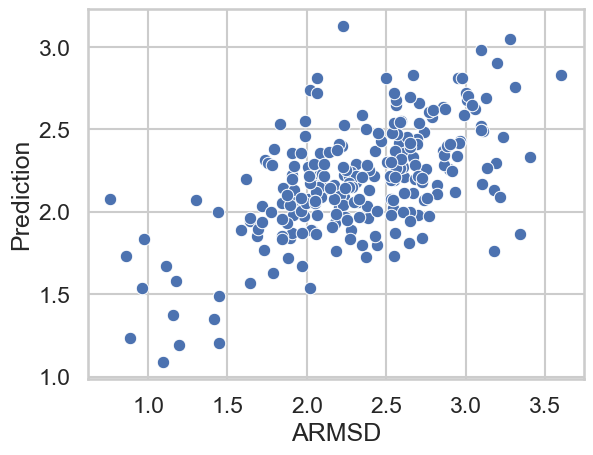

/home/bb596/anaconda3/envs/bioconfpred/lib/python3.7/site-packages/ipykernel/pylab/backend_inline.py:13: DeprecationWarning: `ipykernel.pylab.backend_inline` is deprecated, directly use `matplotlib_inline.backend_inline`
  DeprecationWarning,


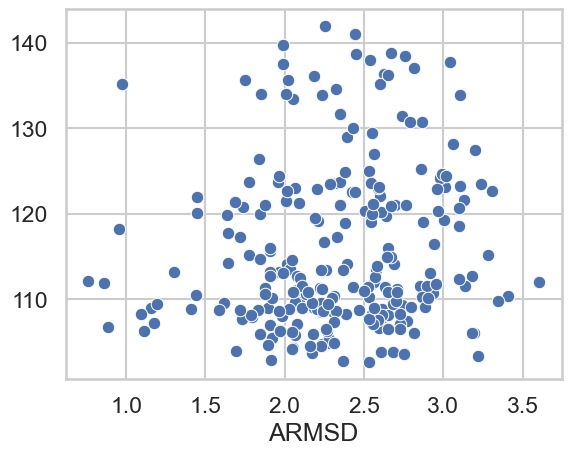

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.6288659793814433
842


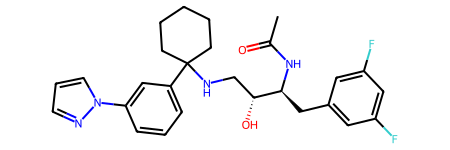

[['3n4l' '3.4.23.46']]


In [128]:
analyse_pdb('3ivh')

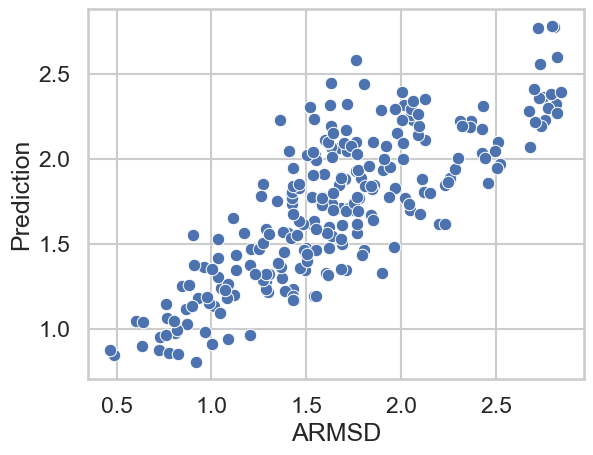

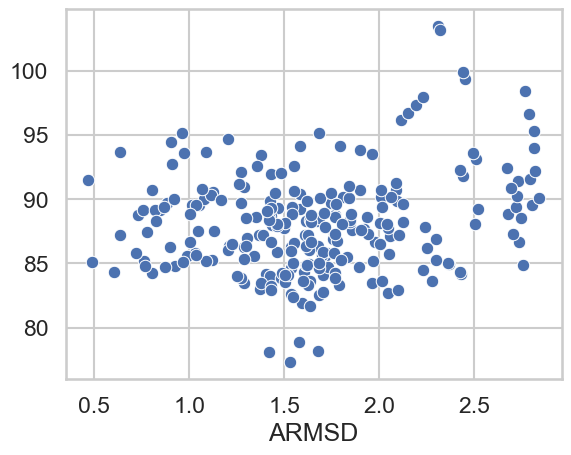

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=246), Output()), _dom_classes=(…

0.38144329896907214
1B7


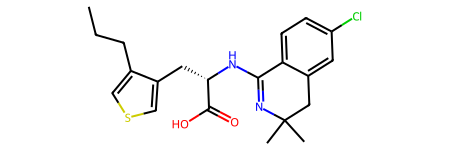

[['4i0d' '3.4.23.46']]


In [49]:
analyse_pdb('4i11')

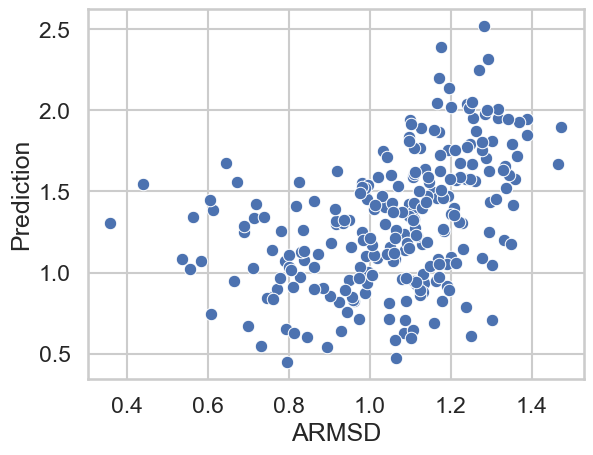

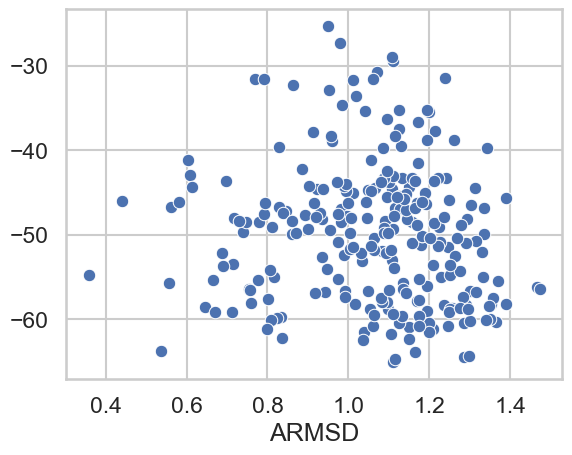

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.5915492957746479
411


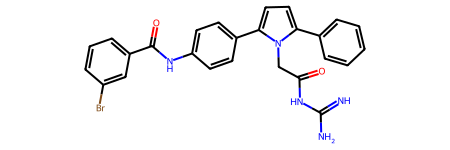

[['2ze1' '3.4.23.46']]


In [130]:
analyse_pdb('2qu2')

In [131]:
t0 = target_results_df[(target_results_df['level_4'] == '2.7.10.2') 
                  & (target_results_df['Iteration'] == 0)
                 & (target_results_df['Test set'] == 'Random')]
t = t0.groupby(['Ranker', 'ligand name']).mean().reset_index()

In [132]:
t0[t0['ligand name'] != '1N1'].groupby(['Ranker']).mean()

,Iteration,MAE,RMSE,Number of generated conformations,Number of bioactive-like conformations,Normalized rank of first bioactive-like conformation,BEDROC of bioactive-like conformations,Normalized rank of first non-bioactive conformation,BEDROC of non-bioactive,Number of non-bioactive conformations,...,Number of heavy atoms,Maximum similarity to training set,Maximum Tanimoto similarity to training set,Ratio of bioactive-like conformations,Ratio of non-bioactive conformations,Bioactive-like conformation is first,-logKd/Ki,value,release year_y,active
Ranker,,,,,,,,,,,,,,,,,,,,,
CCDC generation order,0.0,NaN,NaN,203.193548,23.16129,0.112620,0.231561,0.121244,0.234827,58.0,...,30.171429,0.503009,0.594286,0.147133,0.229218,0.142857,7.688857,1802.834286,2013.285714,0.857143
MMFF94s energy,0.0,NaN,NaN,203.193548,23.16129,0.071336,0.281003,0.133710,0.207623,58.0,...,30.171429,0.503009,0.594286,0.147133,0.229218,0.171429,7.688857,1802.834286,2013.285714,0.857143
SchNet,0.0,0.483894,0.576836,203.193548,23.16129,0.090108,0.258248,0.223599,0.072087,58.0,...,30.171429,0.503009,0.594286,0.147133,0.229218,0.142857,7.688857,1802.834286,2013.285714,0.857143
Shuffle,0.0,NaN,NaN,203.193548,23.16129,0.077236,0.195067,0.094370,0.244599,58.0,...,30.171429,0.503009,0.594286,0.147133,0.229218,0.171429,7.688857,1802.834286,2013.285714,0.857143


In [133]:
t0.groupby(['Ranker']).mean()

,Iteration,MAE,RMSE,Number of generated conformations,Number of bioactive-like conformations,Normalized rank of first bioactive-like conformation,BEDROC of bioactive-like conformations,Normalized rank of first non-bioactive conformation,BEDROC of non-bioactive,Number of non-bioactive conformations,...,Number of heavy atoms,Maximum similarity to training set,Maximum Tanimoto similarity to training set,Ratio of bioactive-like conformations,Ratio of non-bioactive conformations,Bioactive-like conformation is first,-logKd/Ki,value,release year_y,active
Ranker,,,,,,,,,,,,,,,,,,,,,
CCDC generation order,0.0,NaN,NaN,209.694444,23.75,0.099534,0.233078,0.141719,0.195340,56.344828,...,30.525,0.515914,0.62,0.14192,0.222622,0.125,7.762,1578.355,2012.975,0.875
MMFF94s energy,0.0,NaN,NaN,209.694444,23.75,0.081095,0.245470,0.111346,0.237383,56.344828,...,30.525,0.515914,0.62,0.14192,0.222622,0.150,7.762,1578.355,2012.975,0.875
SchNet,0.0,0.482451,0.576904,209.694444,23.75,0.081037,0.254425,0.321599,0.059658,56.344828,...,30.525,0.515914,0.62,0.14192,0.222622,0.150,7.762,1578.355,2012.975,0.875
Shuffle,0.0,NaN,NaN,209.694444,23.75,0.069954,0.199129,0.079479,0.231463,56.344828,...,30.525,0.515914,0.62,0.14192,0.222622,0.150,7.762,1578.355,2012.975,0.875


In [134]:
p = t0.pivot_table(values='BEDROC of bioactive-like conformations', columns='Ranker', index=['PDB code', 'ligand name'])

In [135]:
p['S-M'] = p['SchNet'] - p['MMFF94s energy']

# p[p['S-M'] > 0].sort_values('S-M')

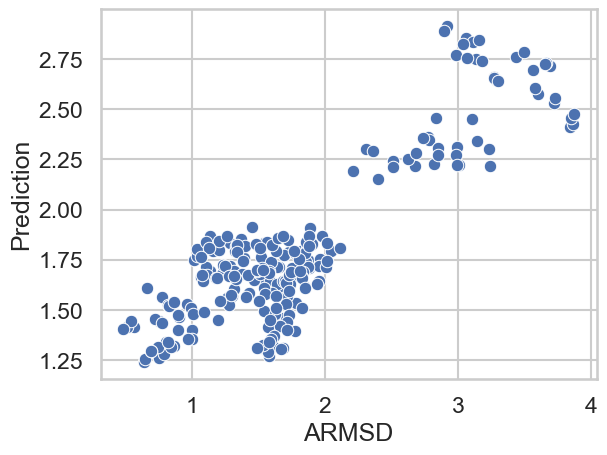

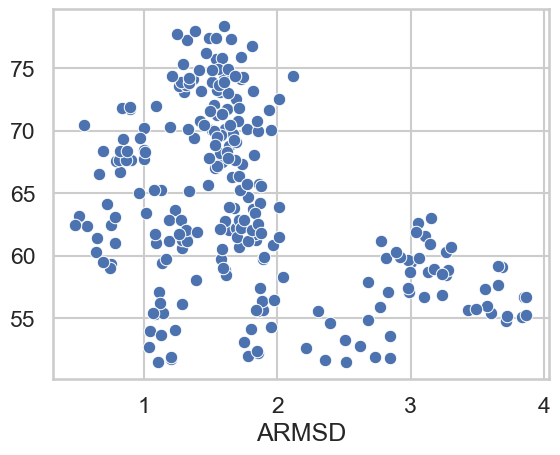

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.625
4B7


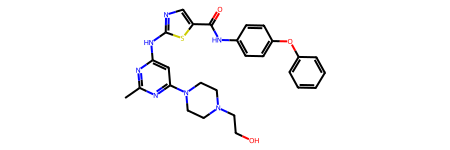

[['4ybk' '2.7.10.2']
 ['4yc8' '2.7.10.2']]


In [68]:
analyse_pdb('5h2u')

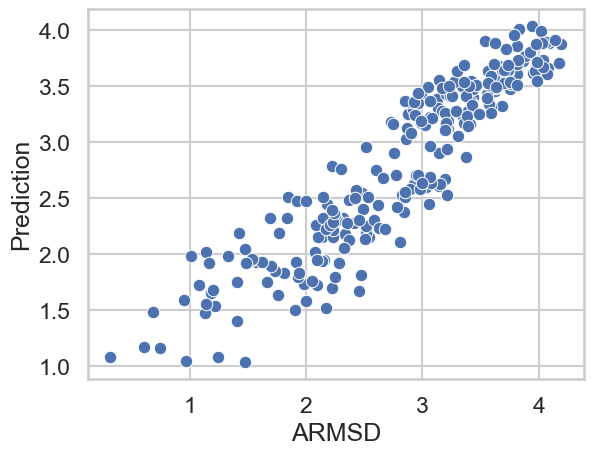

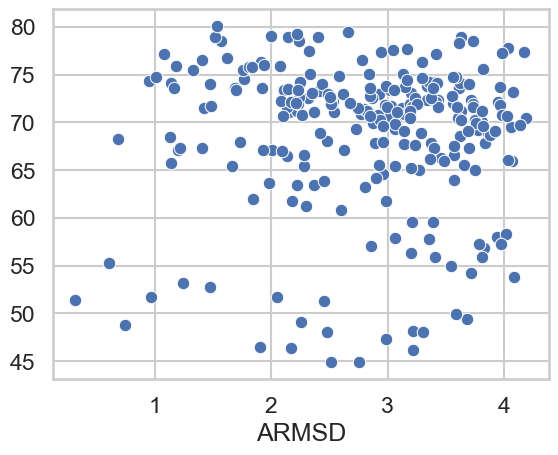

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.7684210526315789
X9G


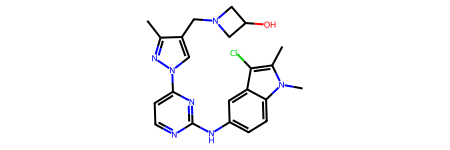

['4xg9']


In [56]:
analyse_pdb('4rss')

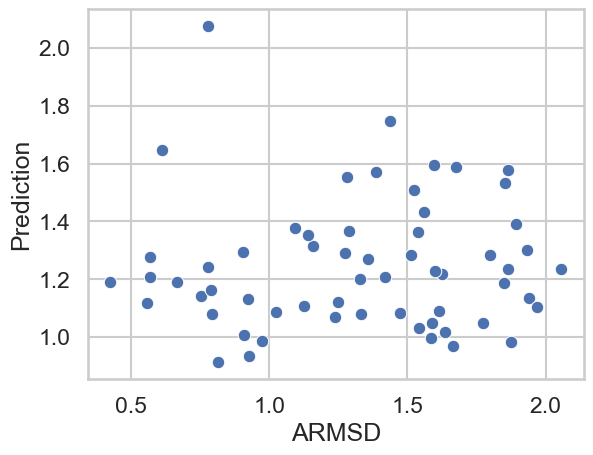

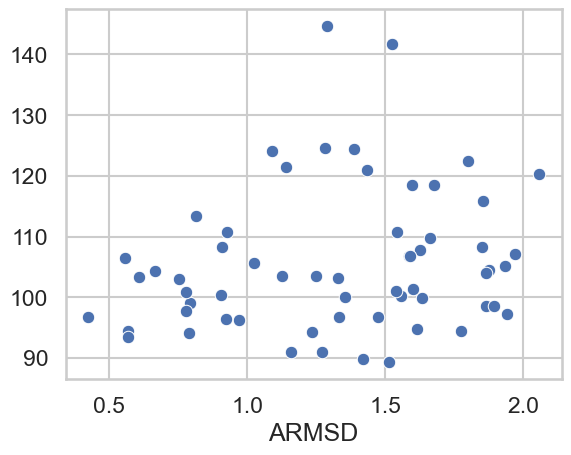

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=59), Output()), _dom_classes=('…

0.648936170212766
F48


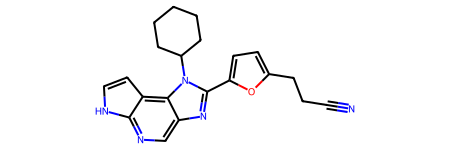

[['6glb' '2.7.10.2']]


In [139]:
analyse_pdb('6gla')

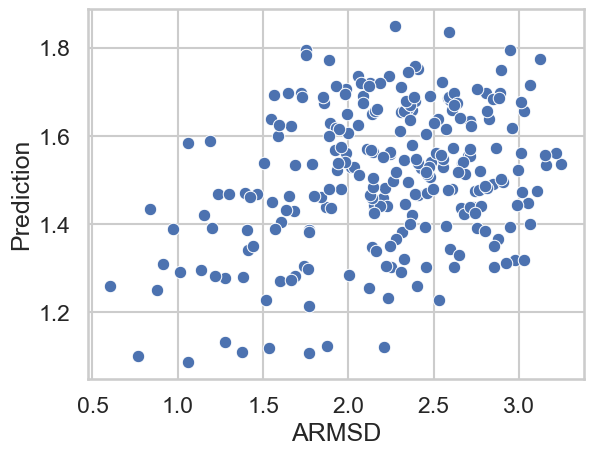

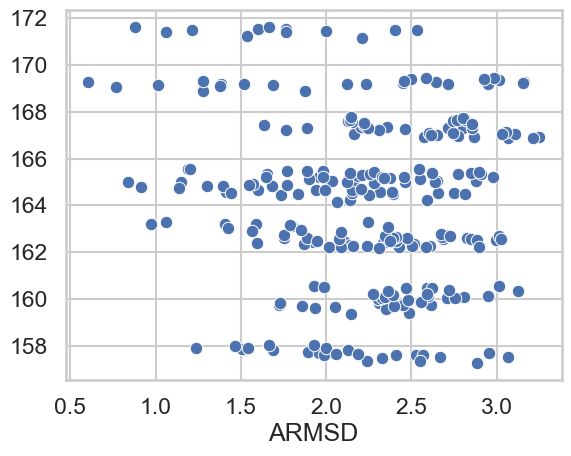

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.4084507042253521
NG2


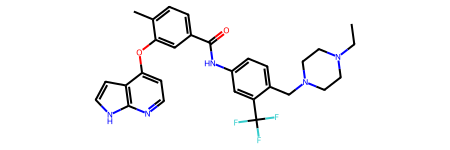

['4o91']


In [59]:
analyse_pdb('3ik3')

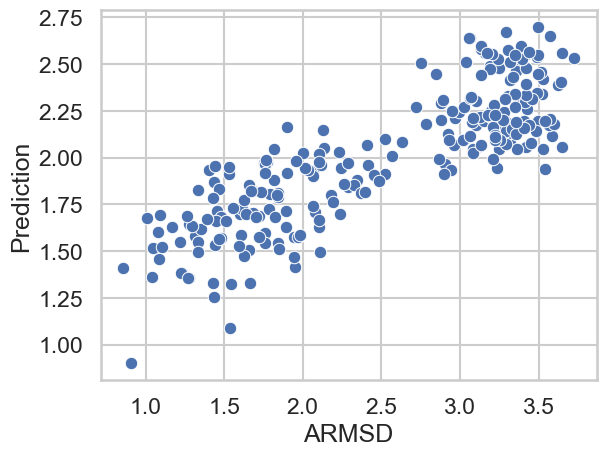

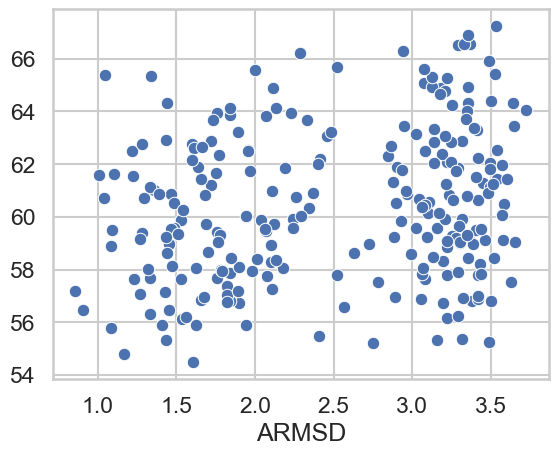

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.37254901960784315
EM7


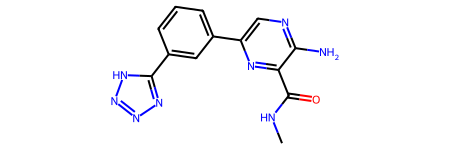

[['4anu' '2.7.1.137']
 ['4anu' '2.7.1.153']
 ['4anu' '2.7.1.154']
 ['4anu' '2.7.11.1']]


In [66]:
analyse_pdb('4dfl')

In [55]:
import torch
with torch.no_grad():
    model.show_atomic_contributions(gen_mol, save_dir='3ivh')

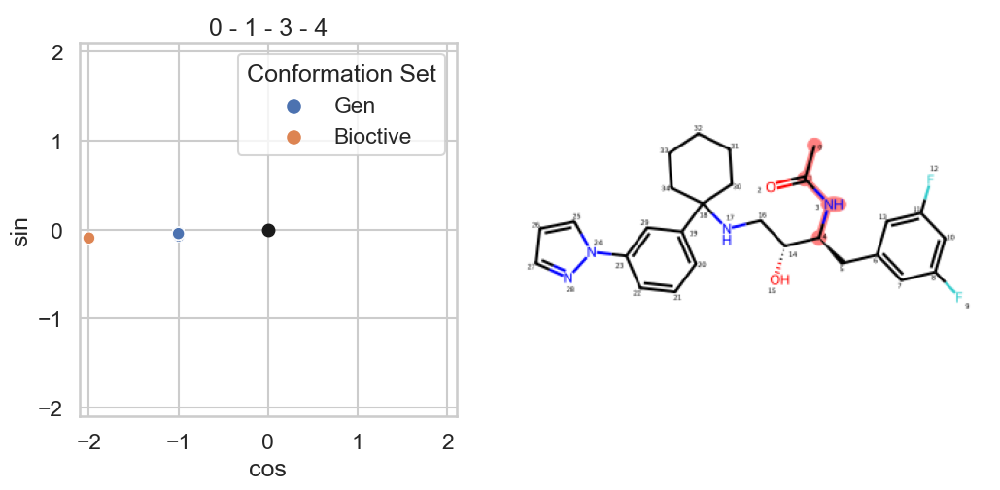

<Figure size 640x480 with 0 Axes>

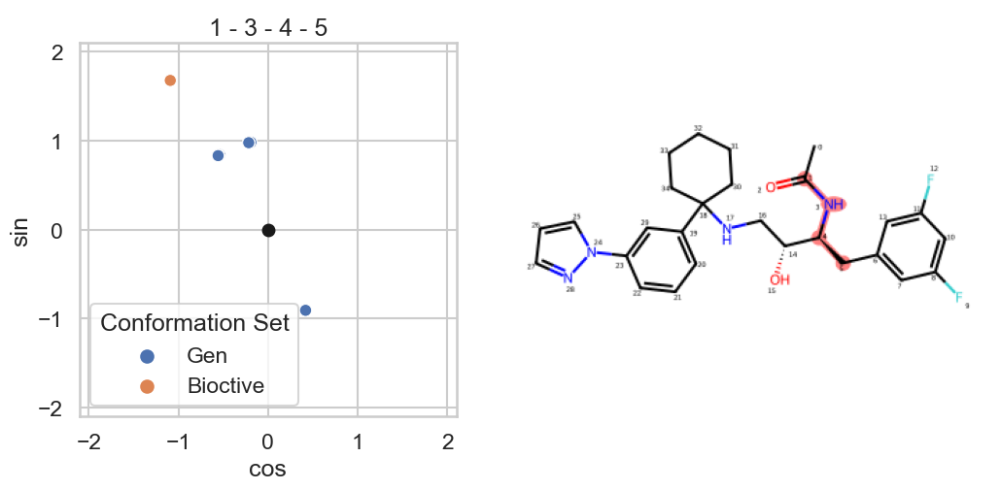

<Figure size 640x480 with 0 Axes>

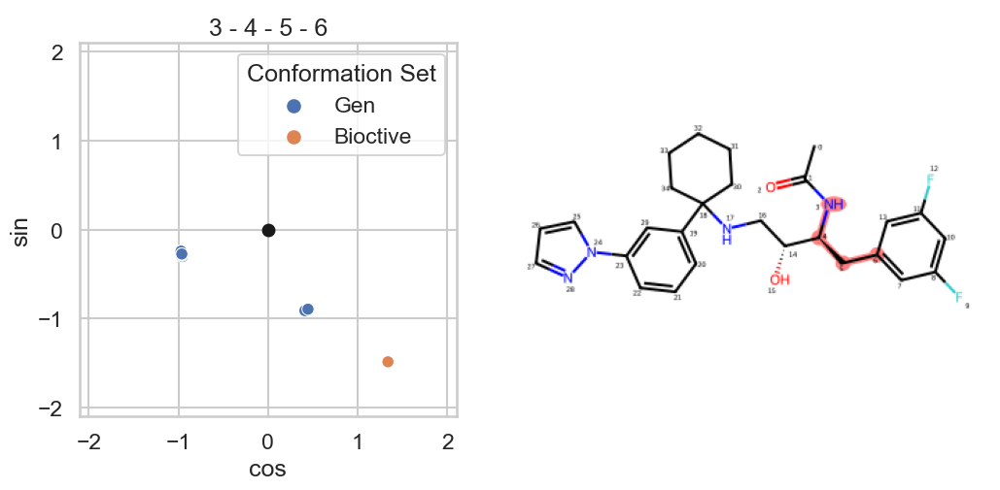

<Figure size 640x480 with 0 Axes>

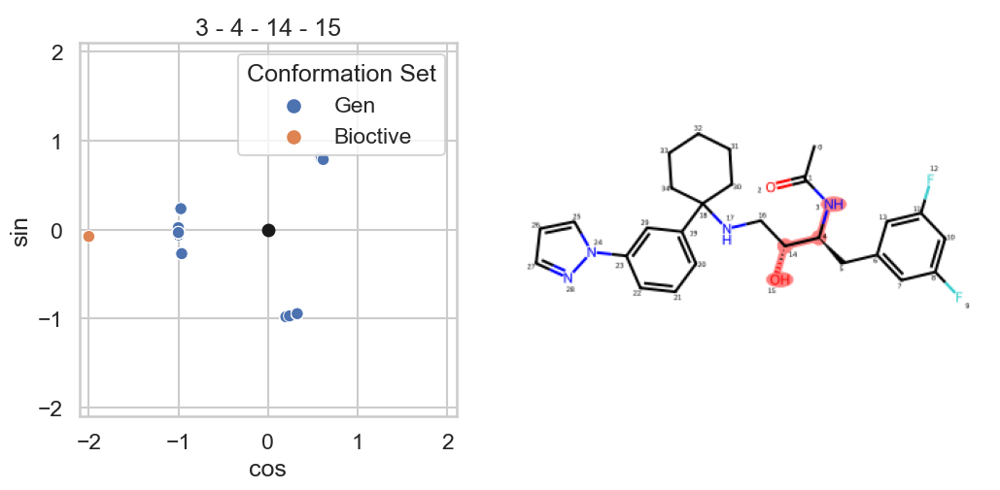

<Figure size 640x480 with 0 Axes>

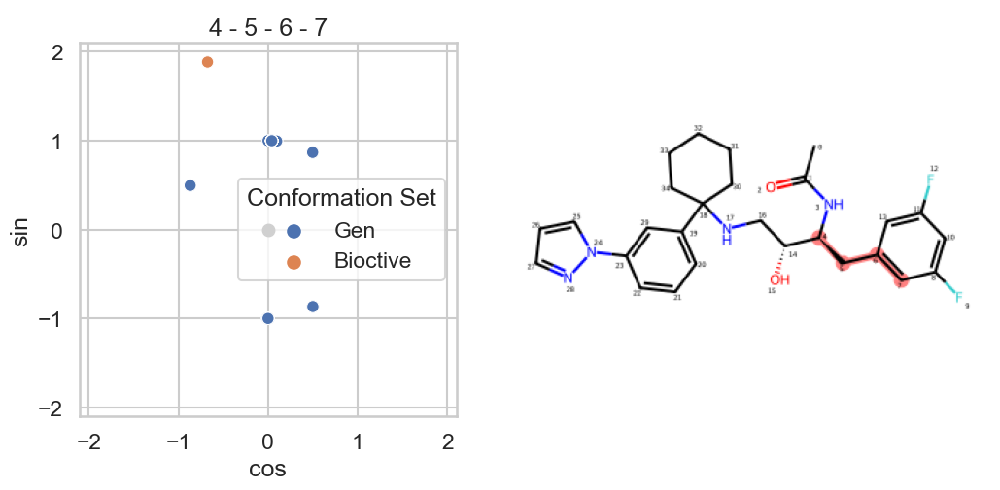

<Figure size 640x480 with 0 Axes>

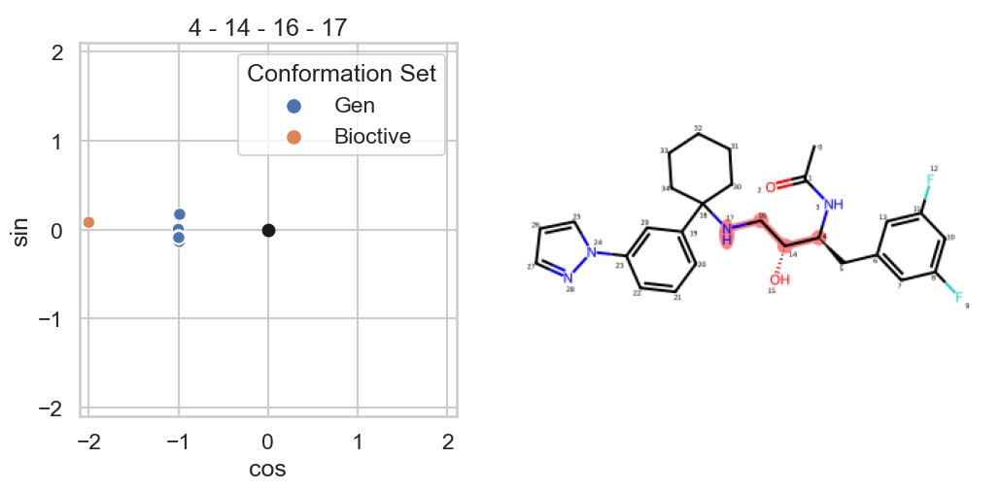

<Figure size 640x480 with 0 Axes>

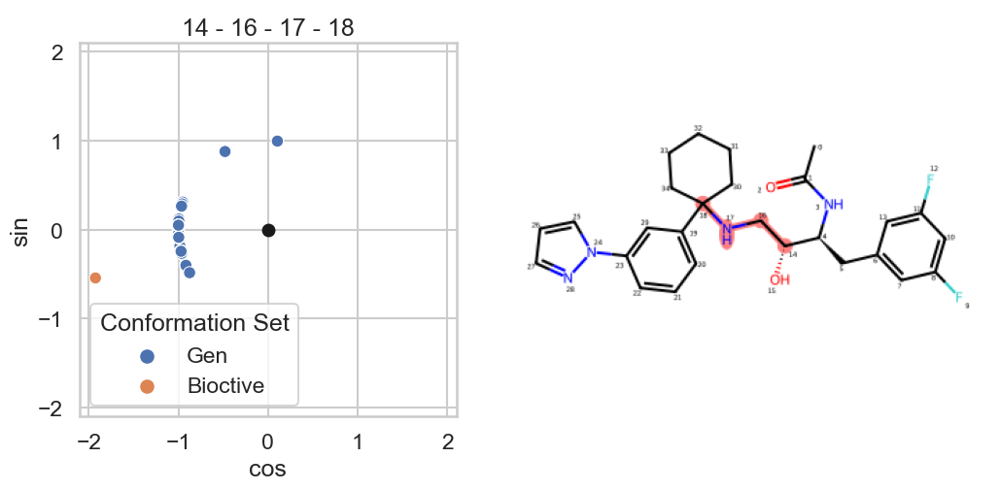

<Figure size 640x480 with 0 Axes>

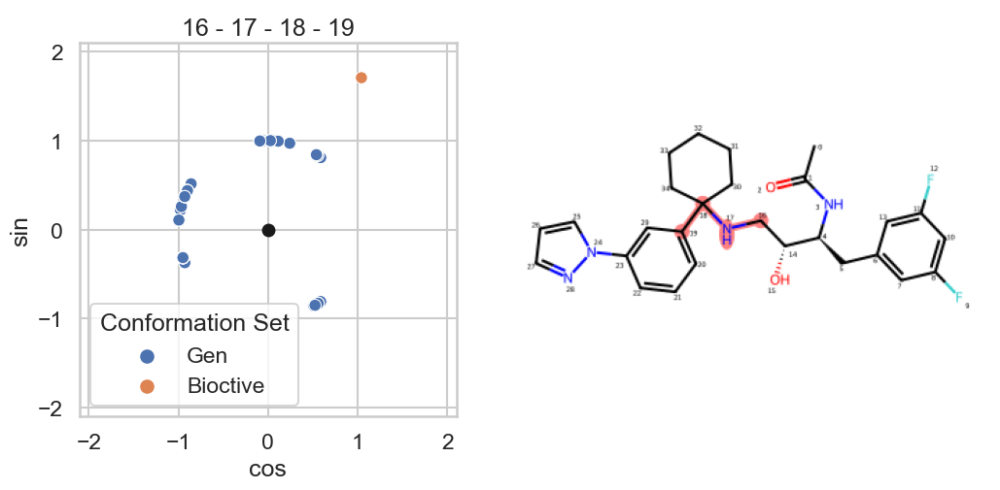

<Figure size 640x480 with 0 Axes>

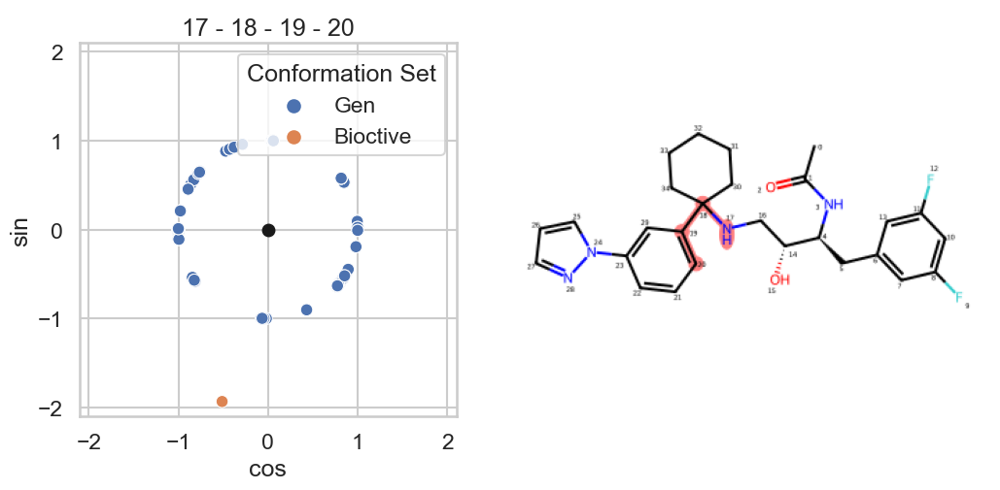

<Figure size 640x480 with 0 Axes>

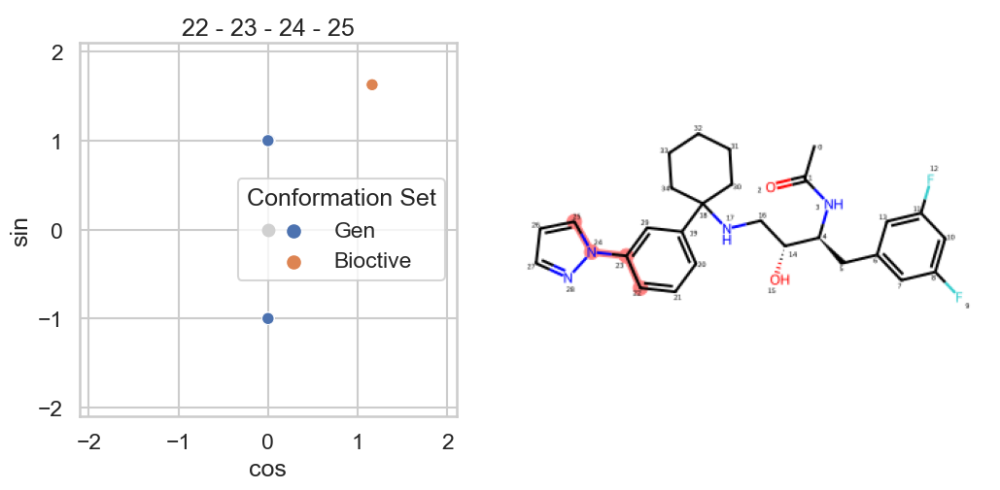

<Figure size 640x480 with 0 Axes>

In [56]:
gen_mol2 = analyze_torsions('842', '3n4l', have_bio_like=False)

In [57]:
from rdkit.Chem.rdFMCS import FindMCS
mcs = FindMCS([gen_mol, gen_mol2])

In [58]:
smarts = mcs.smartsString

In [59]:
substructure = Chem.MolFromSmarts(smarts)

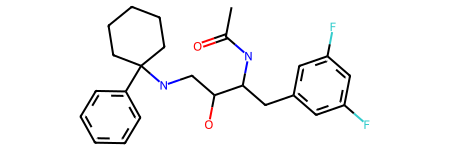

In [60]:
substructure

In [153]:
match1 = gen_mol.GetSubstructMatch(substructure)

In [154]:
match2 = gen_mol2.GetSubstructMatch(substructure)

In [155]:
d_match = {i: j for i, j in zip(match1, match2)}

In [157]:
dihedrals_idxs = ca.get_rotatable_bonds_atom_idx(gen_mol)

In [170]:
dihedrals_idxs1 = []
dihedrals_idxs2 = []
for idxs in dihedrals_idxs :
    idxs2 = []
    for i in idxs :
        if i in d_match:
            idxs2.append(d_match[i])
    if len(idxs2) == 4:
        dihedrals_idxs1.append(idxs)
        dihedrals_idxs2.append(idxs2)

In [208]:
from data.featurizer import PyGFeaturizer
from torch_geometric.data import Batch
pygf = PyGFeaturizer()


In [212]:
with torch.no_grad():
    data_list = pygf.featurize_mol(gen_mol)
    batch = Batch.from_data_list(data_list)
    ac1 = model.get_atomic_contributions(batch).numpy()
    
    data_list = pygf.featurize_mol(gen_mol2)
    batch = Batch.from_data_list(data_list)
    ac2 = model.get_atomic_contributions(batch).numpy()

In [215]:
ac1.reshape(gen_mol.GetNumAtoms(), -1)

array([[-0.14032252,  0.02562145, -0.15486254, ...,  0.02675702,
         0.21910799,  0.08009382],
       [ 0.13199703,  0.08702316,  0.17143293, ...,  0.26408687,
         0.09990578,  0.08477435],
       [ 0.20115143,  0.11693826,  0.03610457, ...,  0.09706577,
        -0.12327834,  0.24386784],
       ...,
       [ 0.08282822,  0.09474038, -0.17215976, ...,  0.13594426,
         0.02378104, -0.07904295],
       [ 0.1707253 ,  0.12472876,  0.01179509, ..., -0.16730715,
         0.10260221,  0.12192702],
       [ 0.15845548,  0.11409011,  0.15000047, ..., -0.0017143 ,
         0.10642747,  0.09440816]], dtype=float32)

In [217]:
with torch.no_grad():
    preds1 = model.get_preds_for_mol(gen_mol).numpy().squeeze()
    preds2 = model.get_preds_for_mol(gen_mol2).numpy().squeeze()

d_mol1 = {'preds': preds1, 'targets': targets}
for i, idxs in enumerate(dihedrals_idxs1):
    values = ca.get_conformers_dihedrals_deg(gen_mol, *idxs)
    d_mol1[i] = values
    
table1 = pd.DataFrame(d_mol1)

d_mol2 = {'preds': preds2}
for i, idxs in enumerate(dihedrals_idxs2):
    values = ca.get_conformers_dihedrals_deg(gen_mol2, *idxs)
    d_mol2[i] = values
    
table2 = pd.DataFrame(d_mol2)

In [222]:
n_dihedrals = len(dihedrals_idxs1)
for i in range(n_dihedrals):
    table1[i] = (table1[i] / 10).round(0)
    table2[i] = (table2[i] / 10).round(0)

In [223]:
merged_table = table1.merge(table2, on=list(range(n_dihedrals)))

In [227]:
len(merged_table)

106

<AxesSubplot:xlabel='preds_x', ylabel='preds_y'>

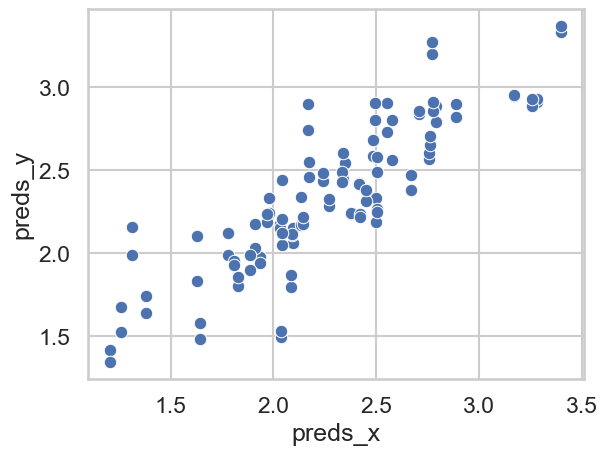

In [224]:
sns.scatterplot(data=merged_table, x='preds_x', y='preds_y')

<AxesSubplot:xlabel='targets', ylabel='preds_y'>

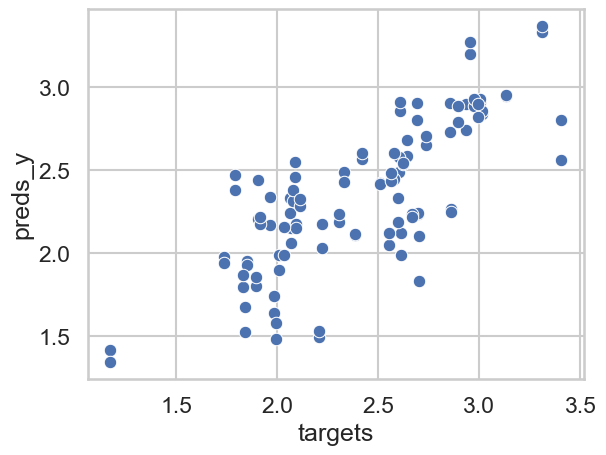

In [225]:
sns.scatterplot(data=merged_table, x='targets', y='preds_y')

In [ ]:
dihedrals_indexes = ['']

In [129]:
import torch
with torch.no_grad():
    model.show_atomic_contributions(gen_mol, save_dir='3n4l')

In [112]:
dihedrals_1 = ca.get_conformers_dihedrals_deg(gen_mol, 3,4,5,6)
dihedrals_2 = ca.get_conformers_dihedrals_deg(gen_mol, 4,14,16,17)

In [128]:
dihedrals_1

array([ -64.9787323 ,  -64.9787323 ,  -64.98298326,  -64.98298326,
        -64.9787323 ,  -64.98298326,  -64.99936512,  -64.99936512,
       -164.04361246, -164.04361246,  -65.00165209,  -64.99936512,
       -164.05257404, -164.05379807,  -64.9856078 ,  -64.9787323 ,
        -65.00209168,  -65.00165209, -164.04788283, -164.04361246,
        -64.99936512,  -64.99936512,  -64.99936512,  -64.99936512,
        -64.9787323 ,  -64.9787323 ,  -64.9856078 ,  -64.99936512,
        -64.99936512,  -63.52101727,  -63.52784169,  -64.98298326,
        -64.9787323 ,  -63.52768727,  -63.52495607, -165.7743599 ,
       -165.7743599 , -165.77927669, -165.77468752,  -63.52768727,
        -63.52875361,  -63.52143967,  -64.9787323 ,  -64.9787323 ,
        -64.9787323 ,  -64.98298326,  -64.98298326,  -64.99732901,
        -65.07742982,  -65.07742982,  -64.98298326,  -64.9852489 ,
       -164.05282019, -164.04788283, -165.75030859,  -64.9787323 ,
        -64.9787323 , -164.0487179 ,  -64.96624673,  -64.97873

In [126]:
dihedrals_1

array([ -64.9787323 ,  -64.9787323 ,  -64.98298326,  -64.98298326,
        -64.9787323 ,  -64.98298326,  -64.99936512,  -64.99936512,
       -164.04361246, -164.04361246,  -65.00165209,  -64.99936512,
       -164.05257404, -164.05379807,  -64.9856078 ,  -64.9787323 ,
        -65.00209168,  -65.00165209, -164.04788283, -164.04361246,
        -64.99936512,  -64.99936512,  -64.99936512,  -64.99936512,
        -64.9787323 ,  -64.9787323 ,  -64.9856078 ,  -64.99936512,
        -64.99936512,  -63.52101727,  -63.52784169,  -64.98298326,
        -64.9787323 ,  -63.52768727,  -63.52495607, -165.7743599 ,
       -165.7743599 , -165.77927669, -165.77468752,  -63.52768727,
        -63.52875361,  -63.52143967,  -64.9787323 ,  -64.9787323 ,
        -64.9787323 ,  -64.98298326,  -64.98298326,  -64.99732901,
        -65.07742982,  -65.07742982,  -64.98298326,  -64.9852489 ,
       -164.05282019, -164.04788283, -165.75030859,  -64.9787323 ,
        -64.9787323 , -164.0487179 ,  -64.96624673,  -64.97873

In [125]:
targets

array([2.5076475 , 1.7366779 , 2.0620692 , 2.6147258 , 1.8947173 ,
       1.1594007 , 3.00108   , 2.6407583 , 2.4217792 , 2.068094  ,
       1.7913057 , 2.5962725 , 2.8557181 , 2.9320865 , 2.0515301 ,
       2.607206  , 2.0804584 , 1.9073728 , 2.1121616 , 2.0789518 ,
       3.131539  , 2.600539  , 2.0881453 , 2.385495  , 2.0103219 ,
       2.0917742 , 1.9852047 , 2.7378833 , 2.1861877 , 2.3465433 ,
       1.6869898 , 1.1134549 , 1.8426644 , 1.9633464 , 2.551183  ,
       3.3086965 , 3.0120742 , 2.896858  , 3.4048645 , 1.729956  ,
       1.6437733 , 0.8878172 , 2.2335804 , 2.6811974 , 2.6229637 ,
       1.8506131 , 1.1754874 , 1.9109267 , 2.2236629 , 2.7034664 ,
       1.7523711 , 0.97573453, 2.7679715 , 3.1921654 , 2.9532738 ,
       2.857576  , 2.3942206 , 2.6913836 , 2.0169196 , 2.6201885 ,
       2.578085  , 1.9056531 , 2.544275  , 1.8446162 , 2.975948  ,
       2.9921556 , 2.9635024 , 2.6091604 , 2.3706675 , 2.2323194 ,
       2.6485167 , 2.5625963 , 1.9610919 , 2.3319094 , 2.63127

In [113]:
pdb_id = '3ivh'
preds = all_conf_results[pdb_id]['regression']['preds']
targets = all_conf_results[pdb_id]['regression']['targets'].numpy()

In [114]:
len(dihedrals_2)

250

<AxesSubplot:>

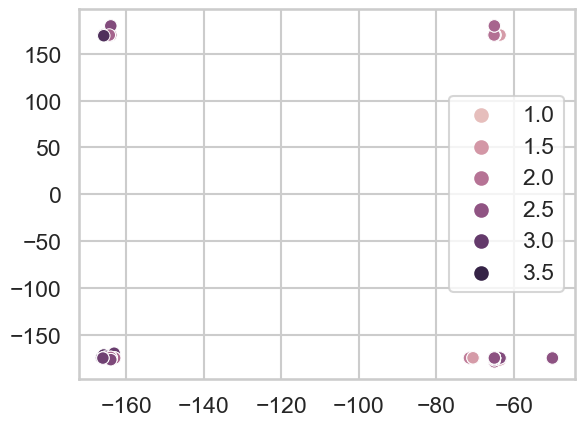

In [115]:
sns.scatterplot(x=dihedrals_1, y=dihedrals_2, hue=targets)

<AxesSubplot:>

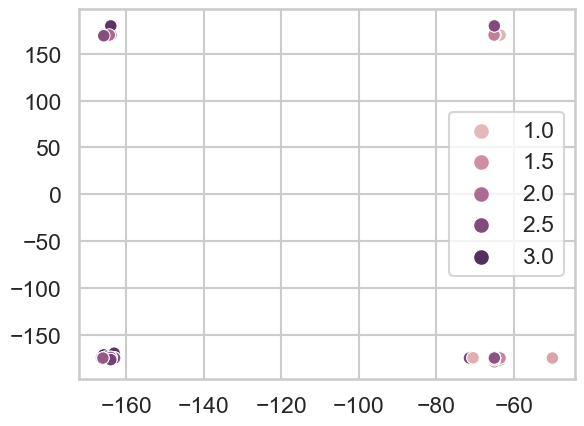

In [116]:
sns.scatterplot(x=dihedrals_1, y=dihedrals_2, hue=preds)

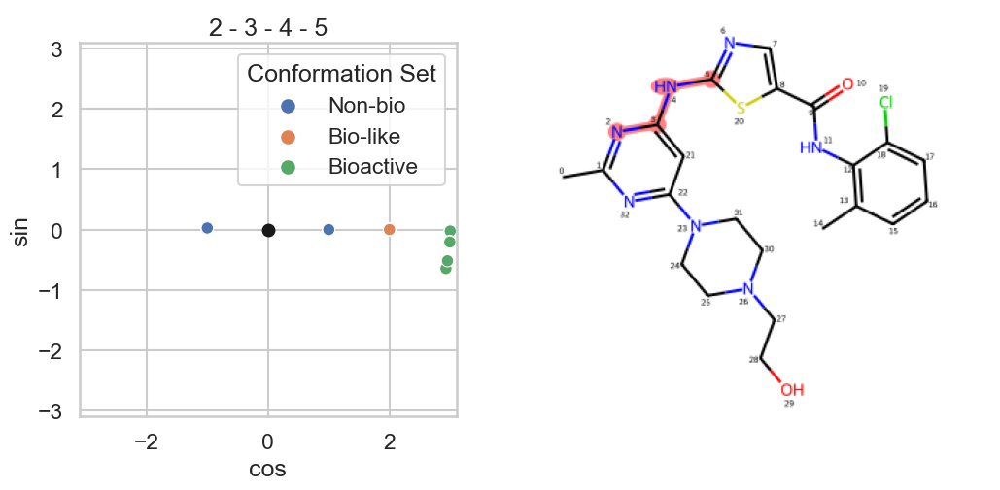

<Figure size 640x480 with 0 Axes>

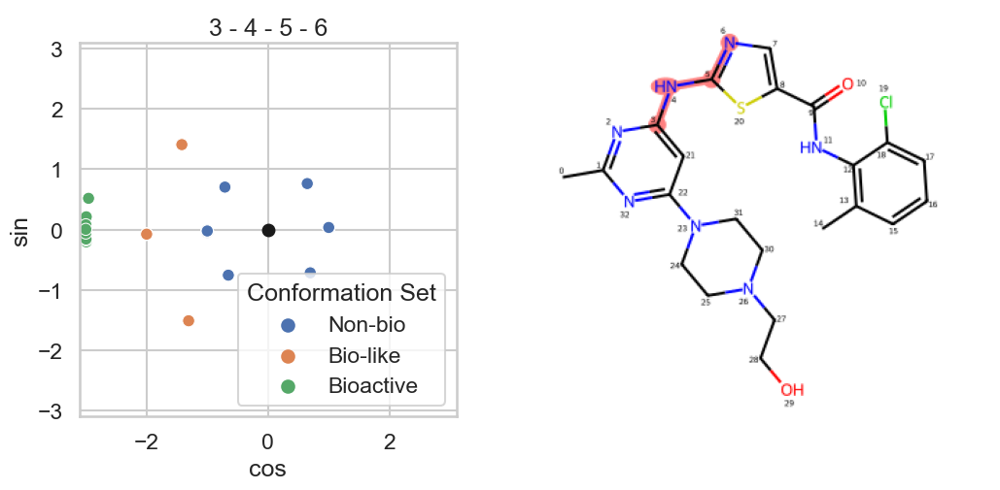

<Figure size 640x480 with 0 Axes>

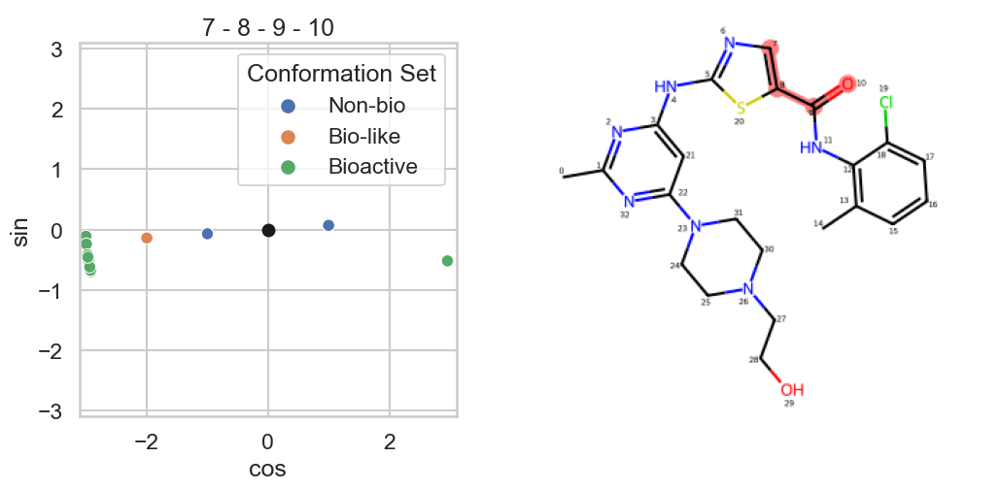

<Figure size 640x480 with 0 Axes>

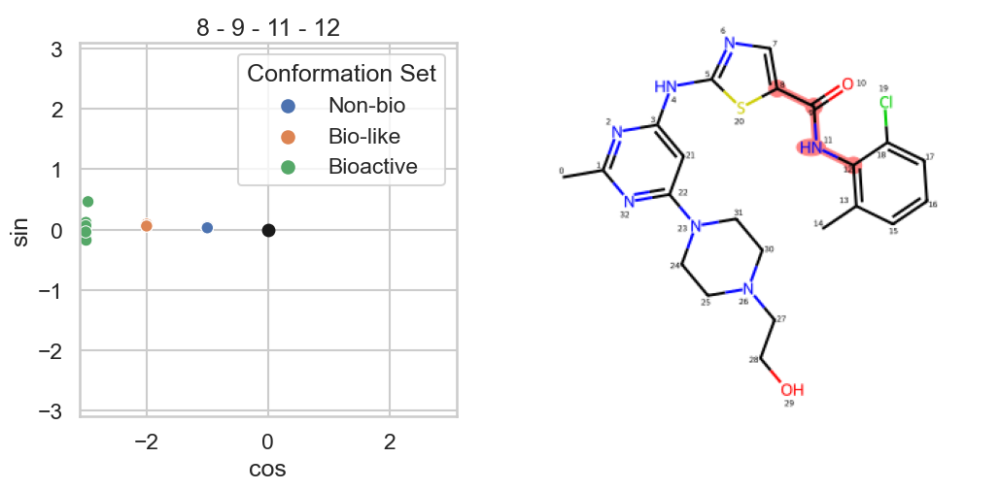

<Figure size 640x480 with 0 Axes>

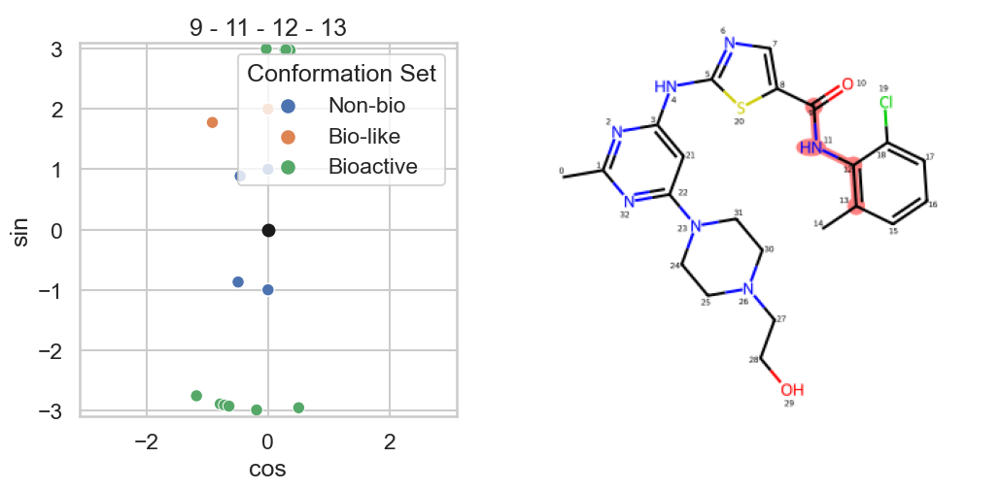

<Figure size 640x480 with 0 Axes>

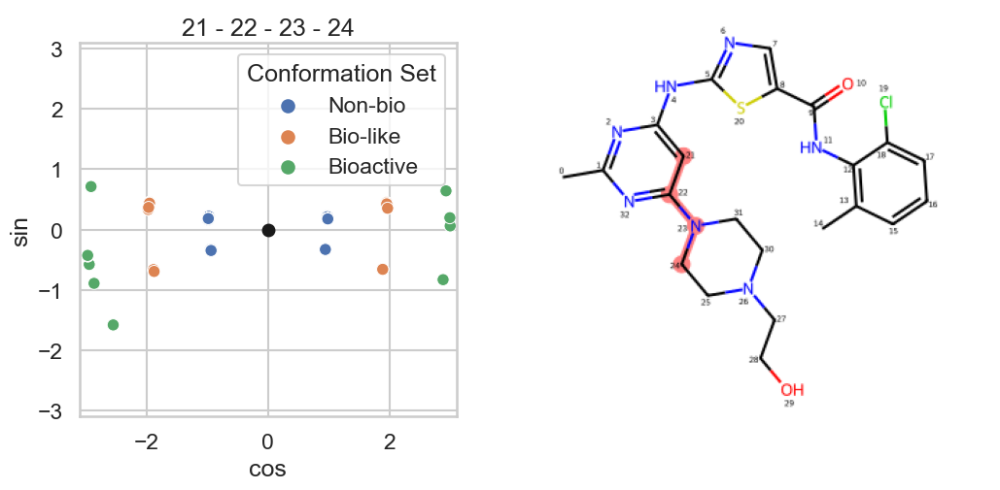

<Figure size 640x480 with 0 Axes>

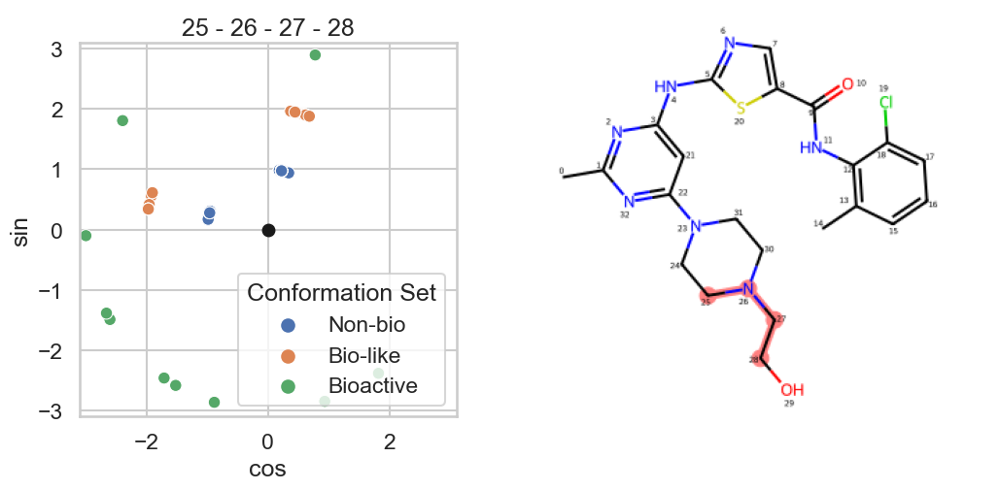

<Figure size 640x480 with 0 Axes>

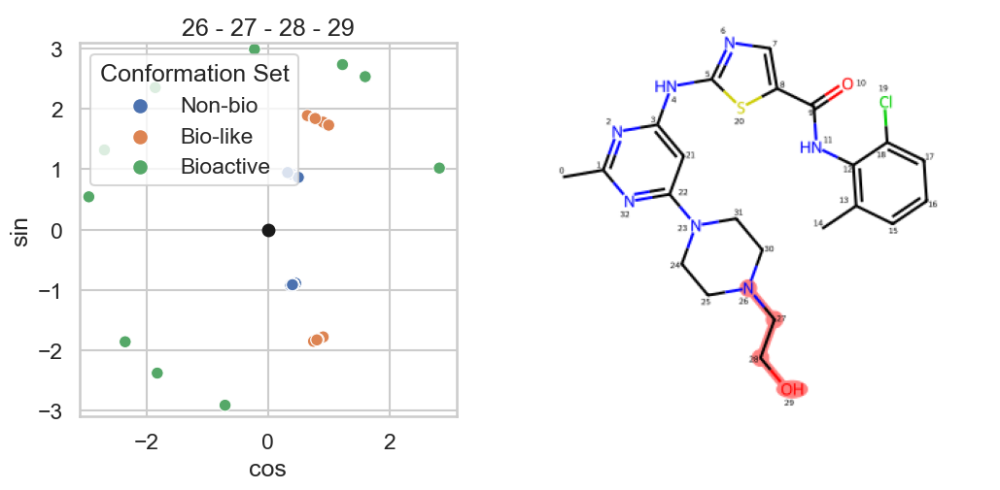

<Figure size 640x480 with 0 Axes>

In [99]:
cel_df['smiles'].values.tolist().index('O=C(O)c1cc(N=Nc2ccc(S(=O)(=O)Nc3ccccn3)cc2)ccc1O')

1

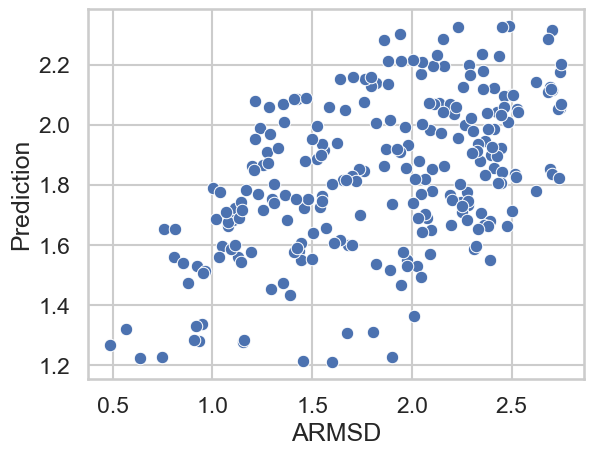

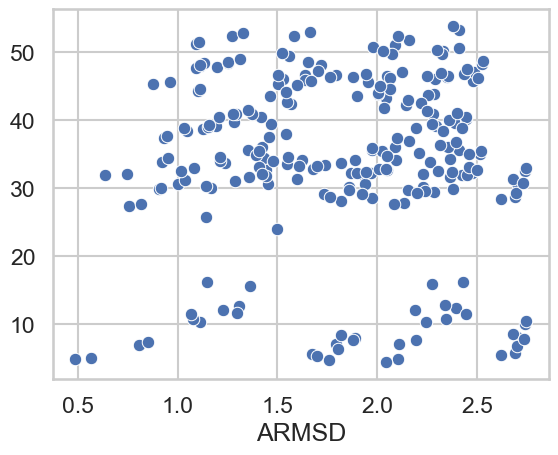

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.7808219178082192
M0Z


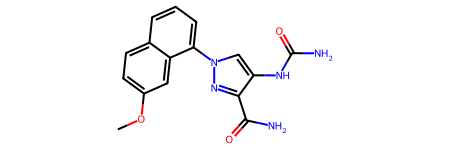

['4m0z']


In [60]:
analyse_pdb('4m14')

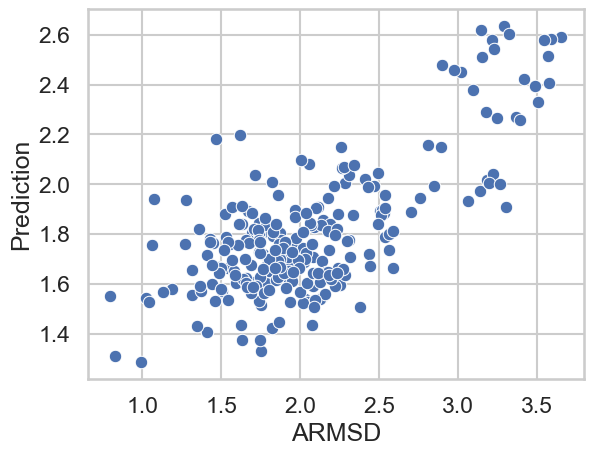

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.3492063492063492


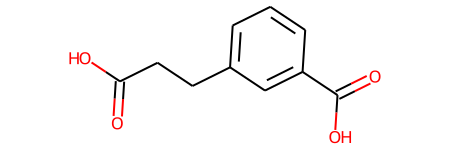

In [176]:
analyse_pdb('2ylp')

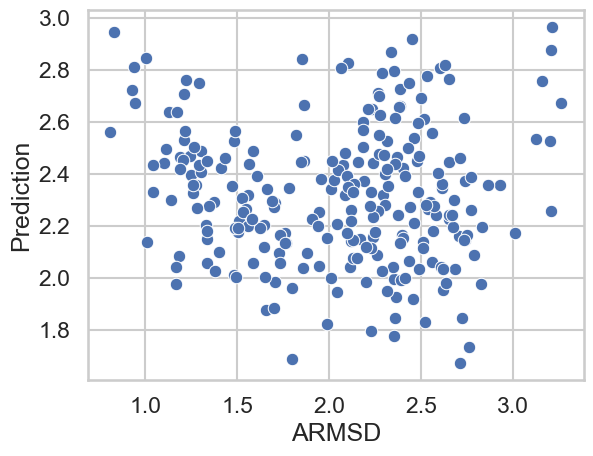

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.24074074074074073


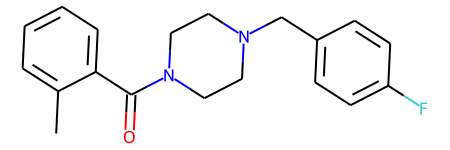

In [178]:
analyse_pdb('3hub')

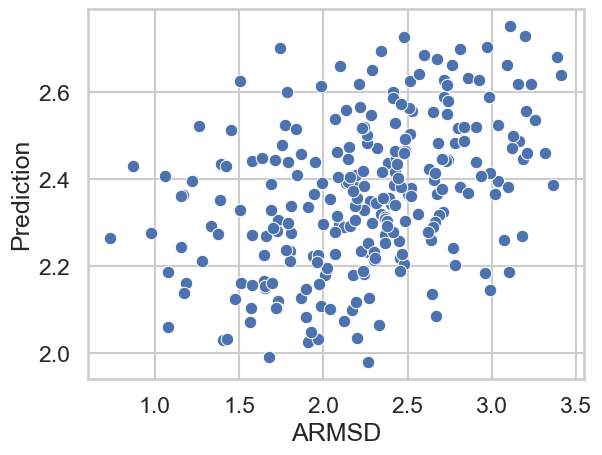

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.39473684210526316


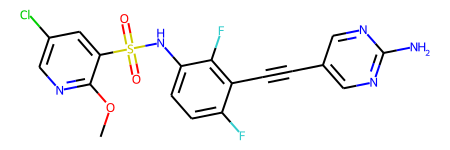

In [179]:
analyse_pdb('5x5o')

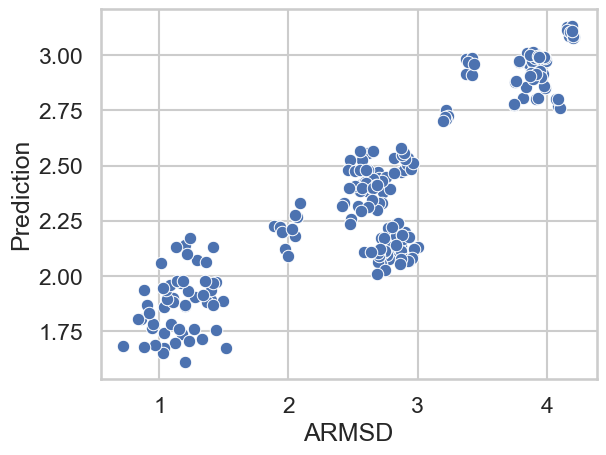

interactive(children=(BoundedIntText(value=0, description='Conformer ID:', max=249), Output()), _dom_classes=(…

0.3


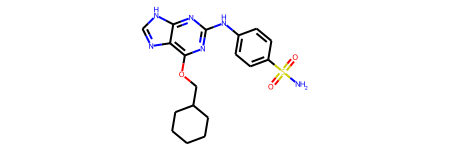

In [180]:
analyse_pdb('5nev')